# 0.0. IMPORTS

In [1]:
import math
import numpy as np
import pandas as pd
import random
import pickle
import warnings
import inflection
import seaborn as sns
import xgboost as xgb

import plotly.express as px

from geopy.geocoders import Nominatim

from scipy                  import stats as ss
from boruta                 import BorutaPy
from matplotlib             import pyplot as plt
from IPython.core.display   import HTML
from IPython.display        import Image


from sklearn.metrics        import mean_absolute_error, mean_squared_error
from sklearn.preprocessing  import RobustScaler, MinMaxScaler, LabelEncoder
from sklearn.ensemble       import RandomForestRegressor
from sklearn.linear_model   import LinearRegression, Lasso

from sklearn.model_selection import train_test_split
from sklearn                 import model_selection as ms

warnings.filterwarnings("ignore")

ModuleNotFoundError: No module named 'inflection'

## 0.1. Helper Functions

In [2]:
def jupyter_settings():
    %matplotlib inline
    %pylab inline
    plt.style.use( 'bmh' )
    plt.rcParams['figure.figsize'] = [25, 12]
    plt.rcParams['font.size'] = 24
    display( HTML( '<style>.container { width:100% !important; }</style>') )
    pd.options.display.max_columns = None
    pd.options.display.max_rows = None
    pd.set_option( 'display.expand_frame_repr', False )
    sns.set()
    
    
def mean_absolute_percentage_error( y, yhat ):
    return np.mean( np.abs( ( y - yhat) / y))
   

def ml_error(model_name, y, yhat):
    mae = mean_absolute_error(y, yhat)
    mape = mean_absolute_percentage_error( y, yhat )
    rmse = np.sqrt( mean_squared_error( y, yhat) )
    
    return pd.DataFrame ( {'Model Name': model_name,
                          'MAE': mae,
                          'MAPE': mape,
                          'RMSE': rmse }, index=[0])


def cross_validation( x_train, y_train, num_folds, model_name, model, verbose=False ):

    kfold = ms.KFold ( n_splits = num_folds, shuffle=True, random_state=32 )

    mae_list =[]
    mape_list =[]
    rmse_list = []
   
   
    i=1
    
    for  train_ix, val_ix in kfold.split( x_train, y_train ):
 
        print( 'Fold number: {}/{}'.format( i, num_folds))
        # get fold
        x_train_fold = x_train.iloc[train_ix]
        y_train_fold = y_train.iloc[train_ix]

        x_val_fold = x_train.iloc[val_ix]
        y_val_fold = y_train.iloc[val_ix]
        
        #training model
        MODEL = model.fit( x_train_fold, y_train_fold )

        #prediction
        yhat = MODEL.predict( x_val_fold )

        #metrics
        
        #performace
        m_result = ml_error( model_name, np.exp(y_val_fold) , np.exp(yhat) )
   

        #store performance of each kfold interation
        mae_list.append( m_result['MAE'] )
        mape_list.append( m_result['MAPE'] )
        rmse_list.append( m_result['RMSE'] )
  

        i = i + 1
        
    return pd.DataFrame( {'Model Name': model_name, 
                          'MAE CV': np.round( np.mean( mae_list), 2 ).astype( str ) + '+/-' + np.round( np.std( mae_list), 2 ).astype( str ),
                          'MAPE CV': np.round( np.mean( mape_list), 2 ).astype( str ) + '+/-' + np.round( np.std( mape_list), 2 ).astype( str ),
                          'RMSE CV': np.round( np.mean( rmse_list), 2 ).astype( str ) + '+/-' + np.round( np.std( rmse_list), 2 ).astype( str ) } , index=[0])

In [3]:
jupyter_settings()

Populating the interactive namespace from numpy and matplotlib


## 0.2. Loading data

In [4]:
df_raw = pd.read_csv('data/kc_house_data.csv')

# 1.0. DESCRICAO DOS DADOS

In [7]:
df1 = df_raw.copy()

In [7]:
df1.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15'],
      dtype='object')

In [5]:
df1.head(5).T

,0,1,2,3,4
id,7129300520,6414100192,5631500400,2487200875,1954400510
date,20141013T000000,20141209T000000,20150225T000000,20141209T000000,20150218T000000
price,221900,538000,180000,604000,510000
bedrooms,3,3,2,4,3
bathrooms,1,2.25,1,3,2
sqft_living,1180,2570,770,1960,1680
sqft_lot,5650,7242,10000,5000,8080
floors,1,2,1,1,1
waterfront,0,0,0,0,0
view,0,0,0,0,0


## 1.1. Data Dimensions

In [8]:
print('Number of Rows: {}'.format( df1.shape[0]))
print('Number of Cols: {}'.format( df1.shape[1]))

Number of Rows: 21613
Number of Cols: 21


## 1.2. Data Types

In [455]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21609 non-null  float64
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21612 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

## 1.3. Check NA

In [9]:
df1.isna().sum()

id               0
date             0
price            0
bedrooms         4
bathrooms        0
sqft_living      0
sqft_lot         0
floors           1
waterfront       0
view             0
condition        0
grade            0
sqft_above       0
sqft_basement    0
yr_built         0
yr_renovated     0
zipcode          0
lat              0
long             0
sqft_living15    0
sqft_lot15       0
dtype: int64

## 1.4 Fillout Na OR Drop NA

In [8]:
#Drop NA
df1.dropna(axis = 0, inplace=True)



In [458]:
#Fillout NA

print(df1['bedrooms'].value_counts())
print(df1['floors'].value_counts())

3.0     9822
4.0     6881
2.0     2758
5.0     1601
6.0      272
1.0      199
7.0       38
8.0       13
0.0       13
9.0        6
10.0       3
11.0       1
33.0       1
Name: bedrooms, dtype: int64
1.0    10678
2.0     8238
1.5     1910
3.0      613
2.5      161
3.5        8
Name: floors, dtype: int64


In [11]:
# diferença entre média e mediana para substituir valores

print('Mediana de Quartos:{}'.format(df1['bathrooms'].median()))
print('Média de Quartos:{}\n'.format(round(df1['bathrooms'].mean(),2)))

print('Mediana de Andares:{}'.format(df1['floors'].median()))
print('Média de Andares:{}'.format(round(df1['floors'].mean(),2)))

Mediana de Quartos:2.25
Média de Quartos:2.11

Mediana de Andares:1.5
Média de Andares:1.49


In [61]:
# substituir pela mediana

#df1['bedrooms'].fillna((df1['bedrooms'].median()), inplace=True)
#df1['floors'].fillna((df1['floors'].median()), inplace=True)

## 1.5 Change Types

In [11]:
df1.dtypes


id                 int64
date              object
price            float64
bedrooms         float64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object

In [9]:
df1['zipcode'] = df1['zipcode'].astype('category')
df1['date'] = pd.to_datetime( df1['date'] )

## 1.6 Descriptive Statistical

In [10]:
num_attributes = df1.select_dtypes( include=['int64','float64'] )
cat_attributes = df1.select_dtypes( exclude=['int64', 'float64', 'datetime64[ns]'] )

In [14]:
#Central Tendency - mean, median

ct1 = pd.DataFrame( num_attributes.apply( np.mean ) ).T
ct2 = pd.DataFrame( num_attributes.apply( np.median ) ).T

#Dispersion - std, min, max, range, skew, kurtosis
d1 = pd.DataFrame ( num_attributes.apply( np.std ) ).T
d2 = pd.DataFrame ( num_attributes.apply( min ) ).T
d3 = pd.DataFrame ( num_attributes.apply( max ) ).T
d4 = pd.DataFrame ( num_attributes.apply( lambda x: x.max() - x.min() ) ).T
d5 = pd.DataFrame ( num_attributes.apply( lambda x: x.skew() ) ).T
d6 = pd.DataFrame ( num_attributes.apply( lambda x: x.kurtosis() ) ).T

# concatenate
m = pd.concat( [d2, d3, d4, ct1, ct2, d1, d5, d6] ).T.reset_index()
m.columns = ( [ 'attributes', 'min', 'max', 'range', 'mean', 'median', 'std', 'skew', 'kurtosis'])

m

,attributes,min,max,range,mean,median,std,skew,kurtosis
0,id,1.000102e+06,9.900000e+09,9.899000e+09,4.580158e+09,3.904930e+09,2.876390e+09,0.243286,-1.260465
1,price,7.500000e+04,7.700000e+06,7.625000e+06,5.401446e+05,4.500000e+05,3.671397e+05,4.023943,34.583090
2,bedrooms,0.000000e+00,3.300000e+01,3.300000e+01,3.370974e+00,3.000000e+00,9.300377e-01,1.974635,49.074716
3,bathrooms,0.000000e+00,8.000000e+00,8.000000e+00,2.114819e+00,2.250000e+00,7.701503e-01,0.511246,1.280208
4,sqft_living,2.900000e+02,1.354000e+04,1.325000e+04,2.079991e+03,1.910000e+03,9.184655e+02,1.471504,5.242624
5,sqft_lot,5.200000e+02,1.651359e+06,1.650839e+06,1.510926e+04,7.620000e+03,4.142406e+04,13.058617,285.016277
6,floors,1.000000e+00,3.500000e+00,2.500000e+00,1.494285e+00,1.500000e+00,5.399851e-01,0.616383,-0.484362
7,waterfront,0.000000e+00,1.000000e+00,1.000000e+00,7.543502e-03,0.000000e+00,8.652513e-02,11.383761,127.601820
8,view,0.000000e+00,4.000000e+00,4.000000e+00,2.343576e-01,0.000000e+00,7.663802e-01,3.395261,10.889446
9,condition,1.000000e+00,5.000000e+00,4.000000e+00,3.409432e+00,3.000000e+00,6.507606e-01,1.032844,0.525775


<AxesSubplot:xlabel='price', ylabel='Density'>

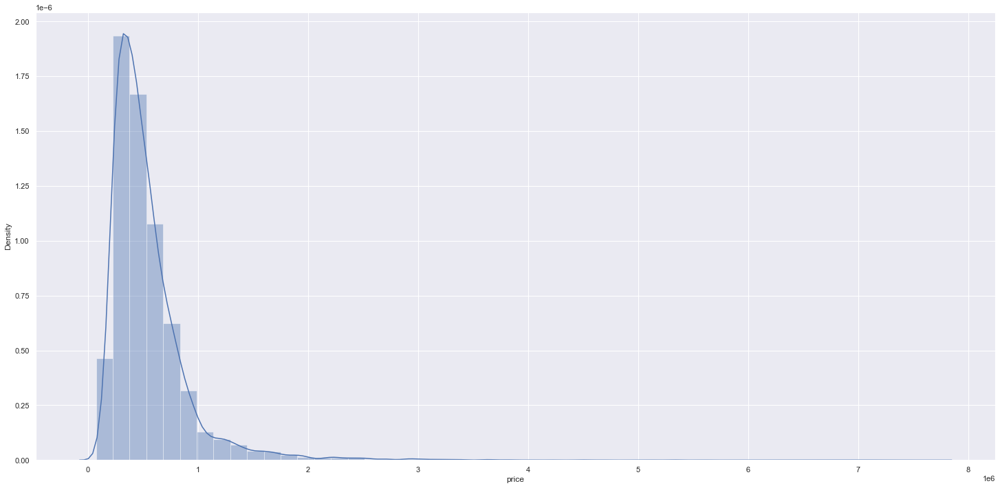

In [606]:
sns.distplot(df1['price'])

In [ ]:
#Inconsistência nos dados: Casas Com 0 Quartos, 0 Banheiros, 33 quartos e 8 Banheiros - São possiveis outliers

In [607]:
df1[(df1['bedrooms']==0) | (df1['bathrooms']==0) ]

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
875,6306400140,2014-06-12,1095000.0,0.0,0.00,3064,4764,3.5,0,2,3,7,3064,0,1990,0,98102,47.6362,-122.322,2360,4000
1149,3421079032,2015-02-17,75000.0,1.0,0.00,670,43377,1.0,0,0,3,3,670,0,1966,0,98022,47.2638,-121.906,1160,42882
3119,3918400017,2015-02-05,380000.0,0.0,0.00,1470,979,3.0,0,2,3,8,1470,0,2006,0,98133,47.7145,-122.356,1470,1399
3467,1453602309,2014-08-05,288000.0,0.0,1.50,1430,1650,3.0,0,0,3,7,1430,0,1999,0,98125,47.7222,-122.290,1430,1650
4868,6896300380,2014-10-02,228000.0,0.0,1.00,390,5900,1.0,0,0,2,4,390,0,1953,0,98118,47.5260,-122.261,2170,6000
5832,5702500050,2014-11-04,280000.0,1.0,0.00,600,24501,1.0,0,0,2,3,600,0,1950,0,98045,47.5316,-121.749,990,22549
6994,2954400190,2014-06-24,1295650.0,0.0,0.00,4810,28008,2.0,0,0,3,12,4810,0,1990,0,98053,47.6642,-122.069,4740,35061
8477,2569500210,2014-11-17,339950.0,0.0,2.50,2290,8319,2.0,0,0,3,8,2290,0,1985,0,98042,47.3473,-122.151,2500,8751
8484,2310060040,2014-09-25,240000.0,0.0,2.50,1810,5669,2.0,0,0,3,7,1810,0,2003,0,98038,47.3493,-122.053,1810,5685
9773,3374500520,2015-04-29,355000.0,0.0,0.00,2460,8049,2.0,0,0,3,8,2460,0,1990,0,98031,47.4095,-122.168,2520,8050


In [80]:
# substituir valores com 0 pela mediana ou maior frequencia 
# ou dropar valores

#substituir valores

#df1['bathrooms'] = df1['bathrooms'].replace(0,df1['bedrooms'].median())
#df1['bedrooms'] = df1['bedrooms'].replace(0,df1['bedrooms'].median())


NameError: name 'df2' is not defined

In [438]:
df1.shape

(21592, 21)

In [ ]:
# excluimos (21/21613) da base de dados. 0,1% da base de dados, oq nao vai comprometer nossos resultados

### 1.7.2 Categorical Attributes

In [463]:
cat_attributes['zipcode'].value_counts()

98103    602
98038    590
98115    582
98052    574
98117    553
98042    547
98034    545
98118    508
98006    498
98023    498
98133    494
98059    468
98058    455
98155    446
98074    441
98033    432
98027    412
98125    410
98056    405
98053    405
98001    361
98075    359
98126    354
98092    351
98144    343
98106    335
98116    330
98029    321
98004    317
98199    317
98065    310
98122    290
98146    288
98008    283
98028    283
98040    282
98003    280
98198    280
98031    274
98072    273
98168    269
98112    269
98055    268
98107    266
98136    263
98178    262
98030    256
98177    255
98166    254
98022    234
98105    229
98045    221
98002    199
98077    198
98011    195
98019    190
98108    186
98119    184
98005    168
98007    141
98188    136
98032    125
98014    124
98070    118
98109    109
98102    105
98010    100
98024     81
98148     57
98039     50
Name: zipcode, dtype: int64

# 2.0 FEATURE ENGINEERING

In [12]:
df2 = df1.copy()

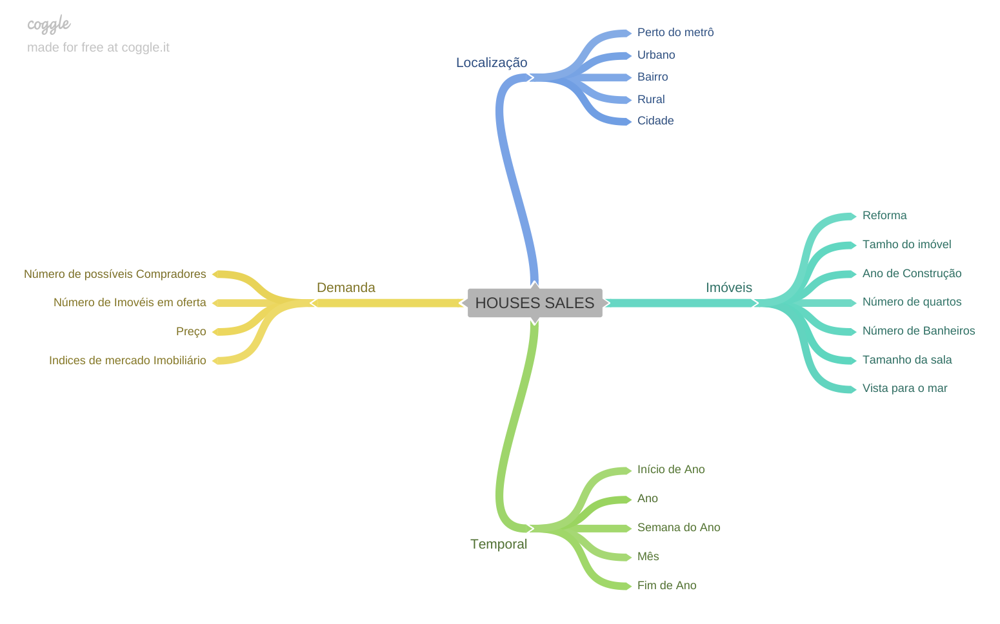

In [18]:
Image( 'img/MindMapHypothesis.png')

# 2.1 Criacao das Hipoteses

### 2.1.1 Hipoteses do imóvel

**1.** Imóveis com vista para o mar são mais caros.

**2.** Imóveis com o ano de construção apartir de 2000 apresetam notas de condições 4 e 5.

**3.** Imóveis construidos antes de 1970 tem o metro quadrado do terreno maior.

**4.** Imóveis construidos antes de 1970 tem salas maiores.

**5.** O numero Quartos é diretamente proporcional ao numero de banheiros.

**6.** 10% dos imóveis foram reformados.

**7.** Quanto maior a nota grade maior é o preço do imóvel.


### 2.1.2 Hipoteses Temporal

**1.** Imóveis que fora anunciados em 2014 são mais baratos que anunciados em 2015.

**2.** Existe uma sazonalidade de vendas mensal.

**3.** Existe uma sazonalidade de vendas na semana do ano.

**4.** Existe Imóveis que foram anunciados mais de uma vez em datas diferentes a preços diferentes.


### 2.1.3 Hipoteses de localização

**1.** Imóveis perto do metro são mais caros

**2.** Imóveis variam de preço de acordo com o código postal.

**3.** Imóveis com maior vista são mais caros.

## 2.2 Lista Final de Hipoteses

**1.** Imóveis com vista para o mar são mais caros.

**2.** Imóveis com o ano de construção apartir de 2000 apresetam notas de condições 4 e 5..

**3.** Imóveis construidos antes de 1970 tem o metro quadrado do terreno maior.

**4.** Imóveis construidos antes de 1970 tem salas maiores.

**5.** O numero Quartos é diretamente proporcional ao numero de banheiros.

**6.** Imóveis que foram  anunciados em 2014 são mais baratos que anunciados em 2015.

**7.** Existe uma sazonalidade de vendas mensal.

**8.** Existe uma sazonalidade de vendas na semana do ano.

**9.** Existe Imóveis que foram anunciados mais de uma vez em datas diferentes a preços diferentes.

**10.** Imóveis variam de preço de acordo com o código postal.

**11.** Imóveis com maior vista são mais caros

**12.** 10% dos imóveis foram reformados.

**13.** Quanto maior a nota grade maior é o preço do imóvel.


## 2.3 Feature Engineering

In [3]:
#year
df2['year'] = df2['date'].dt.year

#month
df2['month'] = df2['date'].dt.month

#day
df2['day'] = df2['date'].dt.day

#week of year
df2['week_of_year'] = df2['date'].dt.weekofyear

#year week
df2['year_week'] = df2['date'].dt.strftime( '%Y-%W' )

#year week
df2['year_month'] = df2['date'].dt.strftime( '%Y-%m' )

# se o imóvel foi renovado
df2['renovated'] = df2.apply(lambda x:  1 if x['yr_renovated'] > 0 else 0, axis=1)



NameError: name 'df2' is not defined

In [555]:
df2.head(15)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,month,day,week_of_year,year_week,year_month,renovated,road,house_number,city,county,state,neighbourhood
0,7129300520,2014-10-13,221900.0,3.0,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650,2014,10,13,42,2014-41,2014-10,0,61st Avenue South,10012,Seattle,King County,Washington,Rainier Beach
1,6414100192,2014-12-09,538000.0,3.0,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639,2014,12,9,50,2014-49,2014-12,1,Northeast 127th Street,837,Seattle,King County,Washington,NaN
2,5631500400,2015-02-25,180000.0,2.0,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062,2015,2,25,9,2015-08,2015-02,0,81st Avenue Northeast,15109,NA,King County,Washington,NaN
3,2487200875,2014-12-09,604000.0,4.0,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000,2014,12,9,50,2014-49,2014-12,0,Fauntleroy Way Southwest,9236,Seattle,King County,Washington,NaN
4,1954400510,2015-02-18,510000.0,3.0,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503,2015,2,18,8,2015-07,2015-02,0,221st Avenue Northeast,923,NA,King County,Washington,NaN
5,7237550310,2014-05-12,1225000.0,4.0,4.50,5420,101930,1.0,0,0,3,11,3890,1530,2001,0,98053,47.6561,-122.005,4760,101930,2014,5,12,20,2014-19,2014-05,0,Northeast Patterson Way,25005,NA,King County,Washington,NaN
6,1321400060,2014-06-27,257500.0,3.0,2.25,1715,6819,2.0,0,0,3,7,1715,0,1995,0,98003,47.3097,-122.327,2238,6819,2014,6,27,26,2014-25,2014-06,0,South 330th Place,533,NA,King County,Washington,NaN
7,2008000270,2015-01-15,291850.0,3.0,1.50,1060,9711,1.0,0,0,3,7,1060,0,1963,0,98198,47.4095,-122.315,1650,9711,2015,1,15,3,2015-02,2015-01,0,14th Avenue South,21421,NA,King County,Washington,Des Moines Creek
8,2414600126,2015-04-15,229500.0,3.0,1.00,1780,7470,1.0,0,0,3,7,1050,730,1960,0,98146,47.5123,-122.337,1780,8113,2015,4,15,16,2015-15,2015-04,0,Southwest 102nd Street,216,Seattle,King County,Washington,NaN
9,3793500160,2015-03-12,323000.0,3.0,2.50,1890,6560,2.0,0,0,3,7,1890,0,2003,0,98038,47.3684,-122.031,2390,7570,2015,3,12,11,2015-10,2015-03,0,232nd Place Southeast,26007,NA,King County,Washington,Katesridge


In [29]:

df2['house_number'] = 'outros'
df2['city'] ='outros'
df2['county'] = 'outros'
df2['state'] = 'outros'
df2['road'] = 'outros'
df2['neighbourhood'] = 'outros'

geolocator = Nominatim( user_agent='geoapiExercises')



for i in range( len( df2 ) ):
    
    print('Loop: {} / {}'.format(i,len(df2)))
    
    #API Request
    query = str( df2.loc[i,'lat'] ) + ',' + str( df2.loc[i, 'long'])
    response = geolocator.reverse(query, timeout=10000)
    
    print( response.raw['address'])

    if 'house_number' in response.raw['address']:
        df2.loc[i, 'house_number'] = response.raw['address']['house_number']
        
    else:
        print(i)
        
    if 'road' in response.raw['address']:
        df2.loc[i, 'road'] = response.raw['address']['road']
    
    else:
        print(i)
        
    if 'neighbourhood' in response.raw['address']:
        df2.loc[i, 'neighbourhood'] = response.raw['address']['neighbourhood']
        
    else:
        print(i)
     
    if 'city' in response.raw['address']:
         df2.loc[i, 'city'] = response.raw['address']['city']
    
    else:
        print(i)
    
    if 'county' in response.raw['address']:
        df2.loc[i, 'county'] = response.raw['address']['county']
    
    else:
        print(i)
    
    if 'state' in response.raw['address']:
        df2.loc[i, 'state'] = response.raw['address']['state']
    
    else:
        print(i)


Loop: 0 / 21592
{'house_number': '10012', 'road': '61st Avenue South', 'neighbourhood': 'Rainier Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
Loop: 1 / 21592
{'house_number': '837', 'road': 'Northeast 127th Street', 'suburb': 'Northgate', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
1
Loop: 2 / 21592
{'house_number': '15109', 'road': '81st Avenue Northeast', 'hamlet': 'Moorlands', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
2
2
Loop: 3 / 21592
{'house_number': '9236', 'road': 'Fauntleroy Way Southwest', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
3
Loop: 4 / 21592
{'house_number': '923',

{'house_number': '7349', 'road': '17th Avenue Northeast', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
34
Loop: 35 / 21592
{'house_number': '15645', 'road': 'Northeast 62nd Court', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
35
35
Loop: 36 / 21592
{'amenity': 'West Woodland Elementary School', 'road': 'Northwest 58th Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
36
36
Loop: 37 / 21592
{'house_number': '29840', 'road': '42nd Avenue South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
37
37
Loop: 38 / 21592
{'house_number': '8113', 'road': '120th Place Southeast', 

{'house_number': '27710', 'road': '201st Avenue Southeast', 'neighbourhood': 'Winterwood Estates', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
70
Loop: 71 / 21592
{'house_number': '3058', 'road': '263rd Place Southeast', 'neighbourhood': 'Tibbetts Station', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
71
Loop: 72 / 21592
{'house_number': '16111', 'road': 'Southeast 7th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
72
Loop: 73 / 21592
{'house_number': '4441', 'road': '48th Avenue Southwest', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
73
Loop: 74 / 21592
{'house_number': '10710', 'road'

{'house_number': '3598', 'road': '173rd Court Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
104
104
Loop: 105 / 21592
{'house_number': '1098', 'road': 'Northwest Honeywood Court', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
105
105
Loop: 106 / 21592
{'house_number': '719', 'road': 'North 74th Street', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
106
Loop: 107 / 21592
{'house_number': '26707', 'road': '233rd Court Southeast', 'neighbourhood': 'Fernwood Estates', 'hamlet': 'Danville', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
107
Loop: 108 / 21592
{'road': 'Chief Sealth Trail', '

{'house_number': '11700', 'road': 'Evanston Avenue North', 'hamlet': 'Bitter Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
138
Loop: 139 / 21592
{'house_number': '6026', 'road': '125th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
139
Loop: 140 / 21592
{'road': 'Northeast 156th Place', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98091', 'country': 'United States', 'country_code': 'us'}
140
140
140
Loop: 141 / 21592
{'house_number': '1816', 'road': '2nd Avenue North', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
141
Loop: 142 / 21592
{'house_number': '8485', 'road': '299th Place Southeast', 'town': 'Preston', 'county': 'King

{'house_number': '811', 'road': 'Harmony Lane', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
173
173
Loop: 174 / 21592
{'house_number': '12732', 'road': '1st Avenue Northwest', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
174
Loop: 175 / 21592
{'house_number': '12128', 'road': 'Southeast 280th Court', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
175
175
Loop: 176 / 21592
{'amenity': 'Our Lady of Guadalupe Church', 'house_number': '7000', 'road': '35th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 177 / 21592
{'house_number':

{'house_number': '24295', 'road': 'Northeast 5th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
207
207
Loop: 208 / 21592
{'house_number': '31705', 'road': '47th Court South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
208
208
Loop: 209 / 21592
{'amenity': 'Graham Hill Elementary School', 'house_number': '5149', 'road': 'South Graham Street', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 210 / 21592
{'house_number': '2616', 'road': 'South 128th Street', 'hamlet': 'Boulevard Park', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
210
210
Loop: 211 / 21592
{

{'road': 'East Lake Sammamish Trail', 'hamlet': 'Adelaide', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-6088', 'country': 'United States', 'country_code': 'us'}
241
241
241
Loop: 242 / 21592
{'house_number': '9033', 'road': '17th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 243 / 21592
{'house_number': '3307', 'road': 'M Place Southeast', 'suburb': 'Forrest Villa', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
243
243
Loop: 244 / 21592
{'house_number': '949', 'road': 'North 77th Street', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
244
Loop: 245 / 21592
{'house_number': '4424', 'road': 'Sou

{'house_number': '10908', 'road': '49th Avenue South', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
276
276
Loop: 277 / 21592
{'house_number': '1700', 'road': '36th Avenue', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
277
Loop: 278 / 21592
{'house_number': '8925', 'road': '236th Avenue Northeast', 'residential': 'Parkside', 'suburb': 'Redmond Ridge', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
278
278
Loop: 279 / 21592
{'house_number': '8227', 'road': 'Northeast 166th Street', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
279
279
Loop: 280 / 21592
{'house_number': '24224', 'road': '1

{'house_number': '2196', 'road': 'North 147th Street', 'hamlet': 'Evergreen', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
311
Loop: 312 / 21592
{'house_number': '28506', 'road': '138th Place Southeast', 'suburb': 'Lea Hill', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
312
312
Loop: 313 / 21592
{'house_number': '1022', 'road': 'North 48th Street', 'neighbourhood': 'Meridian', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 314 / 21592
{'house_number': '13700', 'road': '2nd Avenue Southwest', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
314
314
Loop: 315 / 21592
{'house_number': '8098', 'road': 

{'house_number': '8770', 'road': 'Southeast 48th Street', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
346
346
Loop: 347 / 21592
{'house_number': '20853', 'road': '2nd Place Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
347
347
Loop: 348 / 21592
{'house_number': '7011', 'road': 'Dayton Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
348
Loop: 349 / 21592
{'house_number': '5124', 'road': 'South 324th Street', 'suburb': 'West Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
349
349
Loop: 350 / 21592
{'house_number': '6609', 'road': '43rd Avenue South', 'neighbo

{'house_number': '6192', 'road': '85th Place Southeast', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
380
380
Loop: 381 / 21592
{'house_number': '17950', 'road': '145th Place Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
381
381
Loop: 382 / 21592
{'house_number': '12902', 'road': 'Southeast 158th Place', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
382
382
Loop: 383 / 21592
{'house_number': '11614', 'road': '26th Avenue Southwest', 'neighbourhood': 'Shorewood', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
383
Loop: 384 / 21592
{'house_number': '19740', 'road': '1st Avenue Northwest', 'city': 'Shoreline

{'road': 'Southeast 15th Place', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
414
414
414
Loop: 415 / 21592
{'house_number': '1713', 'road': 'North 82nd Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
415
Loop: 416 / 21592
{'house_number': '12117', 'road': 'Southeast 42nd Street', 'neighbourhood': 'Newport Shores', 'hamlet': 'Newport', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
Loop: 417 / 21592
{'house_number': '12831', 'road': 'Southeast 84th Street', 'neighbourhood': 'Olympus', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
417
Loop: 418 / 21592
{'house_number': '13518', 'road': 'Southeast 189th Place', 'neighbourhood': '

{'house_number': '16417', 'road': 'Southeast 42nd Place', 'hamlet': 'Cougar Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
448
Loop: 449 / 21592
{'highway': 'Island Crest Way & SE 58th St', 'road': 'Southeast 58th Street', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
449
449
449
Loop: 450 / 21592
{'house_number': '7934', 'road': 'Northeast 182nd Place', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
450
450
Loop: 451 / 21592
{'house_number': '14898', 'road': '137th Lane Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
451
451
Loop: 452 / 21592
{'house_number': '8398', 'road': 'Southwest 246th Stree

{'house_number': '1198', 'road': '271st Avenue SOutheast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
483
483
Loop: 484 / 21592
{'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027-5305', 'country': 'United States', 'country_code': 'us'}
484
484
484
484
Loop: 485 / 21592
{'house_number': '7721', 'road': '139th Place Northeast', 'residential': 'Strattonwood', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
485
485
Loop: 486 / 21592
{'house_number': '2470', 'road': 'Southeast 8th Place', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
486
486
Loop: 487 / 21592
{'house_number': '24622', 'road': '190th Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', '

{'house_number': '222', 'road': 'South 15th Street', 'neighbourhood': 'Talbot Hill', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
518
Loop: 519 / 21592
{'house_number': '9342', 'road': '32nd Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 520 / 21592
{'house_number': '1232', 'road': '111th Avenue Northeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
520
Loop: 521 / 21592
{'house_number': '22540', 'road': 'Northeast 92nd', 'suburb': 'Redmond Ridge', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
521
521
Loop: 522 / 21592
{'house_nu

{'house_number': '18819', 'road': '33rd Avenue South', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
552
552
Loop: 553 / 21592
{'house_number': '18196', 'road': 'Northeast 31st Street', 'residential': 'Wildtree', 'hamlet': 'Kenilworth', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
553
553
Loop: 554 / 21592
{'house_number': '19914', 'road': 'Southeast 267th Place', 'hamlet': 'Timberlane', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
554
554
Loop: 555 / 21592
{'house_number': '9071', 'road': '372nd Avenue Southeast', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
555
555
Loop: 556 / 21592
{'house_number': '19415', 'road': 'Southeast 342nd Stre

{'house_number': '46901', 'road': '276th Avenue Southeast', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
586
586
Loop: 587 / 21592
{'house_number': '17170', 'road': '114th Lane Southeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
587
587
Loop: 588 / 21592
{'road': '243rd Southeast Place', 'neighbourhood': 'Woodridge', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
588
588
Loop: 589 / 21592
{'house_number': '6710', 'road': 'South 120th Street', 'hamlet': 'Skyway', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
589
Loop: 590 / 21592
{'house_number': '1219', 'road': 'South 124th Street', 'neighbourhood': 'Beverly Park'

{'house_number': '1805', 'road': 'South State Street', 'suburb': 'Beacon Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
621
Loop: 622 / 21592
{'house_number': '7334', 'road': '51st Avenue Northeast', 'neighbourhood': 'View Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 623 / 21592
{'house_number': '2921', 'road': 'West Mansell Street', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 624 / 21592
{'house_number': '28030', 'road': '185th Place Southeast', 'neighbourhood': 'Winterwood Estates', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
624
Loop: 625 / 

{'house_number': '13704', 'road': '436th Avenue Southeast', 'hamlet': 'Tanner', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
655
655
Loop: 656 / 21592
{'house_number': '1113', 'road': 'Wildwood Boulevard Southwest', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
656
656
Loop: 657 / 21592
{'house_number': '4518', 'road': 'Northeast 171st Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
657
657
Loop: 658 / 21592
{'house_number': '11716', 'road': '16th Avenue Northeast', 'suburb': 'Northgate', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
658
Loop: 659 / 21592
{'house_number': '17200', 'road': 'Northeast 156th Court', 'town': 'Cot

{'house_number': '25813', 'road': '117th Place Southeast', 'neighbourhood': 'Fox Creek', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
690
Loop: 691 / 21592
{'house_number': '2192', 'road': '192nd Avenue Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
691
691
Loop: 692 / 21592
{'house_number': '23401', 'road': '18th Avenue South', 'neighbourhood': 'Central Des Moines', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
692
Loop: 693 / 21592
{'house_number': '18035', 'road': 'Southeast 262nd Place', 'neighbourhood': 'Covington Woods', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
693
Loop: 694 / 21592
{'house_number'

{'house_number': '518', 'road': 'Seneca Avenue Northwest', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
725
725
Loop: 726 / 21592
{'road': 'Snoqualmie Valley Trail', 'neighbourhood': 'Wilderness Rim', 'hamlet': 'Edgewick', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
726
726
Loop: 727 / 21592
{'house_number': '27912', 'road': 'Northeast 147th Place', 'residential': 'Fox Hollow Estates', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
727
727
Loop: 728 / 21592
{'house_number': '17878', 'road': '47th Place Northeast', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
728
728
Loop: 729 / 21592
{'house_number': '27101', 'road': '105th Avenue So

{'house_number': '3920', 'road': 'Northeast 10th Street', 'neighbourhood': 'President Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
759
Loop: 760 / 21592
{'house_number': '21273', 'road': 'Northeast 14th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
760
760
Loop: 761 / 21592
{'road': 'Southeast 9th Street', 'residential': 'Surrey Downs', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004-5983', 'country': 'United States', 'country_code': 'us'}
761
761
Loop: 762 / 21592
{'house_number': '26616', 'road': '197th Place Southeast', 'hamlet': 'Timberlane', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
762
762
Loop: 763 / 21592
{'house_number': '6806', 'road': '38th Av

{'house_number': '14615', 'road': 'Bear Creek Lane Northeast', 'residential': 'The Homestead', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
794
794
Loop: 795 / 21592
{'house_number': '1901', 'road': 'North 37th Street', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
795
Loop: 796 / 21592
{'road': 'Somerset Drive Southeast', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
796
796
Loop: 797 / 21592
{'house_number': '12743', 'road': '102nd Avenue Northeast', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
797
797
Loop: 798 / 21592
{'house_number': '9221', 'r

{'house_number': '442', 'road': '168th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
828
Loop: 829 / 21592
{'house_number': '34240', 'road': '42nd Avenue South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
829
829
Loop: 830 / 21592
{'house_number': '2127', 'road': 'Southwest 306th Place', 'neighbourhood': 'Adelaide', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
830
Loop: 831 / 21592
{'house_number': '22843', 'road': 'Northeast 132nd Place', 'residential': 'Meadows', 'suburb': 'Trilogy', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
831
831
Loop: 832 / 21592
{'house_number': '22843', 

{'house_number': '25018', 'road': 'Southeast 43rd Way', 'residential': 'Traditions', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
862
862
Loop: 863 / 21592
{'house_number': '4547', 'road': 'South Findlay Street', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 864 / 21592
{'house_number': '11231', 'road': 'Southeast 323rd Street', 'suburb': 'Rivers Bend', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
864
864
Loop: 865 / 21592
{'house_number': '709', 'road': '35th Avenue South', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'

{'house_number': '2411', 'road': 'Meadow Avenue North', 'neighbourhood': 'Kennydale', 'hamlet': 'Kennydale', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
896
Loop: 897 / 21592
{'house_number': '5930', 'road': '31st Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
897
Loop: 898 / 21592
{'house_number': '15805', 'road': '129th Place Southeast', 'neighbourhood': 'Fairwood West', 'hamlet': 'Maplewood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
898
Loop: 899 / 21592
{'house_number': '2202', 'road': 'Northeast 83rd Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us

{'house_number': '27425', 'road': '237th Avenue Southeast', 'neighbourhood': 'Shanlemar Meadows', 'hamlet': 'Danville', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
930
Loop: 931 / 21592
{'house_number': '1320', 'road': 'Northeast 162nd Street', 'hamlet': 'Ridgecrest', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
931
Loop: 932 / 21592
{'house_number': '13701', 'road': 'Southeast 275th Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
932
932
Loop: 933 / 21592
{'house_number': '36599', 'road': 'Southeast Fall City-Snoqualmie Road', 'hamlet': 'Spring Glen', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
933
933
Loop: 934 / 21592
{'offic

{'house_number': '3427', 'road': 'Walnut Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 965 / 21592
{'house_number': '21824', 'road': '4th Avenue South', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
965
965
Loop: 966 / 21592
{'house_number': '13722', 'road': '42nd Avenue Northeast', 'neighbourhood': 'Cedar Park', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 967 / 21592
{'house_number': '1457', 'road': 'Northeast Iris Street', 'residential': 'Huckleberry Circle', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}


{'house_number': '1901', 'road': 'Northeast 125th Street', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
997
Loop: 998 / 21592
{'house_number': '31420', 'road': '122nd Avenue Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
998
998
Loop: 999 / 21592
{'house_number': '7036', 'road': '10th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 1000 / 21592
{'house_number': '34991', 'road': 'Southeast Burrows Way', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
1000
1000
Loop: 1001 / 21592
{'house_n

{'house_number': '2325', 'road': 'Southwest 115th Street', 'neighbourhood': 'Shorewood', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
1030
Loop: 1031 / 21592
{'house_number': '9229', 'road': 'Fremont Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
1031
Loop: 1032 / 21592
{'house_number': '27435', 'road': 'Maple Ridge Way Southeast', 'neighbourhood': 'Maple Woods', 'hamlet': 'Ravensdale', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
1032
Loop: 1033 / 21592
{'house_number': '24129', 'road': 'Southeast 11th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
1033
1033
Loop: 1034 / 2

{'house_number': '20950', 'road': 'Southeast 14th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
1063
1063
Loop: 1064 / 21592
{'house_number': '6797', 'road': '121st Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
1064
Loop: 1065 / 21592
{'house_number': '10710', 'road': 'Lake City Way Northeast', 'hamlet': 'Victory Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
1065
Loop: 1066 / 21592
{'road': 'Somerset Lane Southeast', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
1066
1066
Loop: 1067 / 21592
{'house_number': '8622', 'road': 'Fauntlee Crest Southwest', 'hamlet': 'F

{'house_number': '1007', 'road': 'Southwest 306th Street', 'neighbourhood': 'Marine View Demarwood', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
1097
Loop: 1098 / 21592
{'house_number': '26024', 'road': 'Southeast 27th Street', 'neighbourhood': 'Tibbetts Station', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
1098
Loop: 1099 / 21592
{'residential': 'San Souci Condominium', 'hamlet': 'Robinswood', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '99007', 'country': 'United States', 'country_code': 'us'}
1099
1099
1099
Loop: 1100 / 21592
{'house_number': '709', 'road': '7th Street South', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
1100
1100
Loop: 1101 / 21592
{'house_number'

{'house_number': '1931', 'road': 'Garfield Street', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
1131
1131
Loop: 1132 / 21592
{'house_number': '28135', 'road': '240th Avenue Southeast', 'neighbourhood': 'Glacier Trails', 'hamlet': 'Henrys', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
1132
Loop: 1133 / 21592
{'house_number': '15510', 'road': '93rd Court Northeast', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
1133
1133
Loop: 1134 / 21592
{'house_number': '3233', 'road': 'Northeast 98th Street', 'neighbourhood': 'Lavilla', 'hamlet': 'Alicia Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 1135 / 21592
{'hou

{'house_number': '25899', 'road': 'Northeast 30th Court', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
1164
1164
Loop: 1165 / 21592
{'house_number': '1722', 'road': '11th Lane Northeast', 'residential': 'Vista Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
1165
1165
Loop: 1166 / 21592
{'house_number': '36700', 'road': 'Southeast Gravenstein Court', 'neighbourhood': 'Eagle Nest', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
1166
Loop: 1167 / 21592
{'amenity': 'Chinook Middle School', 'road': 'Northeast 19th Street', 'village': 'Clyde Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
1167
1167
1167
Loop: 1168 / 215

{'house_number': '4204', 'road': '191st Avenue Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
1198
1198
Loop: 1199 / 21592
{'house_number': '915', 'road': '6th Avenue North', 'neighbourhood': 'South Lake Union', 'suburb': 'Belltown', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
Loop: 1200 / 21592
{'house_number': '4415', 'road': 'Southwest Dakota Street', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
1200
Loop: 1201 / 21592
{'house_number': '1217', 'road': '1st Street', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
1201
1201
Loop: 1202 / 21592
{'house_number': '901

{'house_number': '5053', 'road': '37th Avenue Southwest', 'neighbourhood': 'High Point', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 1233 / 21592
{'house_number': '122', 'road': '242nd Avenue Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
1233
1233
Loop: 1234 / 21592
{'house_number': '2715', 'road': 'Northeast 21st Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
1234
1234
Loop: 1235 / 21592
{'house_number': '19730', 'road': '161st Place Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
1235
1235
Loop: 1236 / 21592
{'house_number': '32437', 'road': '190th Avenue

{'house_number': '19233', 'road': 'Southeast 234th Place', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
1266
1266
Loop: 1267 / 21592
{'house_number': '18040', 'road': 'Stone Avenue North', 'neighbourhood': 'Meridian Park', 'hamlet': 'Richmond Highlands', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
Loop: 1268 / 21592
{'house_number': '1122', 'road': '29th Avenue South', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
1268
Loop: 1269 / 21592
{'house_number': '16327', 'road': 'Inglewood Place Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
1269
1269
Loop: 1270 / 21592
{'house_number': '23764', 'r

{'house_number': '12612', 'road': 'Blakely Place Northwest', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
1299
Loop: 1300 / 21592
{'house_number': '26765', 'road': 'Northeast Stewart Street', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
1300
1300
Loop: 1301 / 21592
{'house_number': '28251', 'road': '23rd Avenue South', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
1301
1301
Loop: 1302 / 21592
{'house_number': '544', 'road': 'Northeast 84th Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
1302
Loop: 1303 / 21592
{'house_number': '739', 'road': '337th Street Southwest',

{'house_number': '5603', 'road': '167th Place Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
1334
Loop: 1335 / 21592
{'house_number': '2210', 'road': 'North 77th Street', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
1335
Loop: 1336 / 21592
{'house_number': '3924', 'road': 'Southwest 316th Street', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
1336
Loop: 1337 / 21592
{'house_number': '1406', 'road': 'North Northgate Way', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
1337
Loop: 1338 / 21592
{'house_number': '2110', 'road': '8th Ave

{'house_number': '290', 'road': 'Northeast 174th Street', 'neighbourhood': 'North City', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
Loop: 1369 / 21592
{'house_number': '22201', 'road': 'Southeast Bain Road', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
1369
1369
Loop: 1370 / 21592
{'house_number': '228', 'road': 'Southwest 132nd Street', 'neighbourhood': 'Inglesea', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
1370
Loop: 1371 / 21592
{'house_number': '9250', 'road': '2nd Avenue Northwest', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
1371
Loop: 1372 / 21592
{'house_number': '13342', 'road':

{'house_number': '1502', 'road': 'North 80th Street', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
1402
Loop: 1403 / 21592
{'house_number': '11304', 'road': 'Northeast 61st Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
1403
1403
Loop: 1404 / 21592
{'road': 'Forest Drive Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
1404
1404
Loop: 1405 / 21592
{'house_number': '12021', 'road': '64th Avenue South', 'hamlet': 'Skyway', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
1405
Loop: 1406 / 21592
{'house_number': '2344', 'road': '28th Avenue South', 'suburb': 'Mount Baker', 'city': 'Seattl

{'house_number': '12701', 'road': 'Southeast 68th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
1436
Loop: 1437 / 21592
{'house_number': '14208', 'road': 'Northeast 40th Street', 'neighbourhood': 'Overlake', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
Loop: 1438 / 21592
{'house_number': '985', 'road': 'Northeast 148th Street', 'hamlet': 'Paramount Park', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
1438
Loop: 1439 / 21592
{'house_number': '18402', 'road': 'Avondale Road Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-2866', 'country': 'United States', 'country_code': 'us'}
1439
1439
Loop: 1440 / 21592
{'house_number': '2001', 'road': 'Edmonds Drive So

{'amenity': 'Christa McAuliffe Elementary School', 'road': 'Northeast 22nd Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
1470
1470
1470
Loop: 1471 / 21592
{'house_number': '33017', 'road': '22nd Place South', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
1471
1471
Loop: 1472 / 21592
{'house_number': '4922', 'road': '43rd Avenue South', 'neighbourhood': 'Columbia', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 1473 / 21592
{'house_number': '11036', 'road': '169th Place Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
1473
1473
Loop: 1474 / 21592
{'house_number': '9821'

{'house_number': '15618', 'road': 'Southeast 178th Street', 'neighbourhood': 'Candlewood', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
1504
Loop: 1505 / 21592
{'house_number': '20225', 'road': '107th Avenue Northeast', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
1505
1505
Loop: 1506 / 21592
{'house_number': '4523', 'road': 'South Rose Street', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 1507 / 21592
{'house_number': '353', 'road': '10th Place Southeast', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
1507
1507
Loop: 1508 / 21592
{'house_number': '4227', 'road': '2

{'house_number': '29314', 'road': '35th Avenue South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
1538
1538
Loop: 1539 / 21592
{'house_number': '18134', 'road': '147th Avenue Southeast', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
1539
1539
Loop: 1540 / 21592
{'house_number': '9626', 'road': 'Northeast 129th Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
1540
1540
Loop: 1541 / 21592
{'house_number': '3506', 'road': 'Southeast 6th Street', 'neighbourhood': 'Maplewood Glen', 'hamlet': 'Maplewood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
1541
Loop: 1542 / 21592
{'house_number': '1301', 'roa

{'house_number': '3030', 'road': '37th Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 1573 / 21592
{'house_number': '4532', 'road': '13th Avenue South', 'neighbourhood': 'South Seattle', 'suburb': 'Beacon Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 1574 / 21592
{'house_number': '7940', 'road': '12th Avenue Southwest', 'neighbourhood': 'Highland Park', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 1575 / 21592
{'house_number': '14346', 'road': 'Northeast 178th Street', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_c

{'house_number': '1872', 'road': '251th Place Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
1606
1606
Loop: 1607 / 21592
{'house_number': '7103', 'road': '55th Avenue South', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 1608 / 21592
{'house_number': '24328', 'road': '118th Avenue Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
1608
1608
Loop: 1609 / 21592
{'house_number': '2709', 'road': 'East Marion Street', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
1609
Loop: 1610 / 21592
{'house_number': '3909', 'road': 'Southwest Dawson Street', 'suburb': 'De

{'amenity': 'Aegis Living', 'house_number': '4700', 'road': 'Southwest Admiral Way', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 1641 / 21592
{'house_number': '809', 'road': 'Southwest 117th Street', 'neighbourhood': 'Mount View', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
1641
Loop: 1642 / 21592
{'house_number': '2317', 'road': 'Northeast 92nd Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
1642
Loop: 1643 / 21592
{'house_number': '12654', 'road': '156th Avenue Southeast', 'neighbourhood': 'Willowbrook', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'Un

{'house_number': '18105', 'road': 'Northeast 197th Place', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
1673
1673
Loop: 1674 / 21592
{'house_number': '7032', 'road': 'Southeast 20th Street', 'neighbourhood': 'McGilvra', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
1674
Loop: 1675 / 21592
{'house_number': '19094', 'road': '18th Avenue Northeast', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
1675
Loop: 1676 / 21592
{'house_number': '15801', 'road': '63rd Avenue Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
1676
1676
Loop: 1677 / 21592
{'house_number': '1299', 'road': '121st Avenue Southeast', 'city'

{'house_number': '2561', 'road': 'Northeast 85th Street', 'neighbourhood': 'Wedgwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 1708 / 21592
{'road': '228th Southeast Avenue', 'neighbourhood': 'Pebble Creek', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98010', 'country': 'United States', 'country_code': 'us'}
1708
1708
Loop: 1709 / 21592
{'house_number': '1110', 'road': '31st Avenue', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
1709
Loop: 1710 / 21592
{'house_number': '8435', 'road': '40th Avenue Southwest', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
1710
Loop: 1711 / 21592
{'house_number': '19823', 'road': '15th Avenue Northwest', 'resid

{'house_number': '4137', 'road': '48th Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 1742 / 21592
{'house_number': '2605', 'road': 'Northeast 145th Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
1742
Loop: 1743 / 21592
{'house_number': '4434', 'road': 'Northeast 23rd Court', 'neighbourhood': 'Glencoe', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
1743
Loop: 1744 / 21592
{'house_number': '5611', 'road': '5th Avenue Northeast', 'neighbourhood': 'Meridian', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 1745 / 215

{'house_number': '32816', 'road': 'Hyde Avenue', 'hamlet': 'Morganville', 'village': 'Black Diamond', 'county': 'King County', 'state': 'Washington', 'postcode': '98010', 'country': 'United States', 'country_code': 'us'}
1775
1775
Loop: 1776 / 21592
{'house_number': '288', 'road': 'Northwest 203rd Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
1776
Loop: 1777 / 21592
{'house_number': '2101', 'road': '211th Avenue Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
1777
1777
Loop: 1778 / 21592
{'house_number': '3611', 'road': 'Southwest 331st Place', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
1778
1778
Loop: 1779 / 21592
{'house_number': '3717', 'road': 'Southwest Austin Street', 'neighbourh

{'house_number': '1414', 'road': 'East Roy Street', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
1810
Loop: 1811 / 21592
{'house_number': '2058', 'road': '86th Avenue Northeast', 'village': 'Clyde Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
1811
1811
Loop: 1812 / 21592
{'house_number': '20701', 'road': 'Northeast 3rd Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
1812
1812
Loop: 1813 / 21592
{'house_number': '16294', 'road': 'Stone Avenue North', 'neighbourhood': 'Meridian Park', 'hamlet': 'Ronald', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
Loop: 1814 / 21592
{'house_number': '17669', 'road':

{'house_number': '13738', 'road': 'Southeast 199th Place', 'neighbourhood': 'Forest Glen South', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
1843
Loop: 1844 / 21592
{'house_number': '19455', 'road': 'Normandy Park Drive Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
1844
1844
Loop: 1845 / 21592
{'house_number': '12715', 'road': 'Northeast 130th Court', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
1845
1845
Loop: 1846 / 21592
{'house_number': '8131', 'road': '49th Avenue South', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 1847 / 21592
{'house_number': '19038', 'road': 

{'house_number': '20629', 'road': '130th Avenue Southeast', 'neighbourhood': 'Shadow Run', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
1877
Loop: 1878 / 21592
{'house_number': '206', 'road': 'South 108th Place', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
1878
Loop: 1879 / 21592
{'house_number': '2969', 'road': '275th Avenue Southeast', 'residential': 'Montaine at Aldarra', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
1879
1879
Loop: 1880 / 21592
{'house_number': '81', 'road': '23rd Avenue South', 'village': 'Milton', 'county': 'Pierce County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
1880
1880
Loop: 1881 / 21592
{'house_number': '20

{'house_number': '29013', 'road': '220th Place Southeast', 'village': 'Black Diamond', 'county': 'King County', 'state': 'Washington', 'postcode': '98010', 'country': 'United States', 'country_code': 'us'}
1911
1911
Loop: 1912 / 21592
{'house_number': '14801', 'road': 'Fremont Place North', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
1912
Loop: 1913 / 21592
{'house_number': '8312', 'road': '35th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 1914 / 21592
{'house_number': '28511', 'road': '10th Avenue South', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
1914
1914
Loop: 1915 / 21592
{'house_number': '5823', 'road': 'Northeast 193rd 

{'house_number': '4019', 'road': 'Southwest 335th Place', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
1945
1945
Loop: 1946 / 21592
{'house_number': '14223', 'road': 'Southeast 179th Place', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
1946
1946
Loop: 1947 / 21592
{'road': '152nd Avenue Northeast', 'residential': 'Piedmont Apartment Homes', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
1947
1947
Loop: 1948 / 21592
{'house_number': '4338', 'road': '246th Place Southeast', 'residential': 'The Heights', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
1948
1948
Loop: 1949 / 21592

{'house_number': '12035', 'road': '33rd Avenue Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
1979
Loop: 1980 / 21592
{'house_number': '3221', 'road': 'East Morley Way', 'neighbourhood': 'Broadmoor', 'suburb': 'Washington Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
Loop: 1981 / 21592
{'house_number': '2310', 'road': 'North 58th Street', 'neighbourhood': 'Meridian', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 1982 / 21592
{'house_number': '11431', 'road': '81st Place South', 'neighbourhood': 'Bryn Mawr', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
Lo

{'house_number': '12802', 'road': '4th Avenue Southwest', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
2012
2012
Loop: 2013 / 21592
{'house_number': '11005', 'road': '86th Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
2013
2013
Loop: 2014 / 21592
{'house_number': '10413', 'road': 'Southeast 186th Place', 'neighbourhood': 'Eaglebrook', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
2014
Loop: 2015 / 21592
{'house_number': '9712', 'road': '4th Avenue Northwest', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 2016 / 21592
{'house_number': '5801', 'road

{'house_number': '16763', 'road': '2nd Avenue Northeast', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
2046
Loop: 2047 / 21592
{'house_number': '27416', 'road': '245th Avenue Southeast', 'neighbourhood': 'Maple Woods', 'hamlet': 'Ravensdale', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
2047
Loop: 2048 / 21592
{'house_number': '1736', 'road': 'Southwest 345th Place', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
2048
2048
Loop: 2049 / 21592
{'house_number': '7152', 'road': '30th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 2050 / 21592
{'house_number': '635'

{'house_number': '24307', 'road': 'Southeast 261st Place', 'neighbourhood': 'Wilderness Rim Estates', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
2079
Loop: 2080 / 21592
{'house_number': '13441', 'road': 'Adair Creek Way Northeast', 'residential': 'Skyline', 'suburb': 'Trilogy', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
2080
2080
Loop: 2081 / 21592
{'house_number': '5497', 'road': '170th Place Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
2081
Loop: 2082 / 21592
{'road': 'East Beaver Lake Way Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
2082
2082
2082
Loop: 2083 / 21592


{'house_number': '2999', 'road': '200th Avenue Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
2112
2112
Loop: 2113 / 21592
{'road': 'Southeast 57th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
2113
2113
Loop: 2114 / 21592
{'house_number': '16157', 'road': 'Northeast 136th Place', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
2114
2114
Loop: 2115 / 21592
{'house_number': '11814', 'road': 'Northeast 105th Court', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
2115
2115
Loop: 2116 / 21592
{'building': '6205', 'road': '214th Avenue Northeast', 'town': 'Union Hill-Novelty Hill', 'county': 'King County

{'house_number': '16654', 'road': '34th Avenue South', 'hamlet': 'McVan', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
2147
2147
Loop: 2148 / 21592
{'house_number': '15719', 'road': 'Southeast 160th Place', 'neighbourhood': 'Fairwood Greens', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
2148
Loop: 2149 / 21592
{'house_number': '4611', 'road': 'Southwest Maple Way', 'neighbourhood': 'Morgan Junction', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 2150 / 21592
{'house_number': '11704', 'road': 'Northeast 166th Court', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
2150
2150
Loop: 2151 / 21592
{'house

{'house_number': '1400', 'road': 'Northeast 154th Street', 'hamlet': 'Paramount Park', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
2181
Loop: 2182 / 21592
{'house_number': '11538', 'road': '19th Avenue Northeast', 'hamlet': 'Victory Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
2182
Loop: 2183 / 21592
{'house_number': '655', 'road': '213th Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
2183
2183
Loop: 2184 / 21592
{'house_number': '17387', 'road': 'Northeast 42nd Street', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
2184
2184
Loop: 2185 / 21592
{'house_number': '2001', 'road': '263rd Lane So

{'house_number': '31812', 'road': '125th Place Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
2214
2214
Loop: 2215 / 21592
{'house_number': '7815', 'road': 'Southwest 259th Place', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'postcode': '98070', 'country': 'United States', 'country_code': 'us'}
2215
2215
Loop: 2216 / 21592
{'house_number': '11233', 'road': 'Northeast 91st Street', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
2216
2216
Loop: 2217 / 21592
{'house_number': '21326', 'road': 'Southeast 277th Place', 'neighbourhood': 'Eastwood Forest', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
2217
Loop: 2218 / 21592
{'house_number': '19217', 'road': 'South

{'house_number': '2468', 'road': 'Martin Way', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
2249
2249
Loop: 2250 / 21592
{'house_number': '11009', 'road': 'Southeast 220th Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
2250
2250
Loop: 2251 / 21592
{'house_number': '9616', 'road': 'South 205th Place', 'neighbourhood': 'Stonepine', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
2251
Loop: 2252 / 21592
{'house_number': '17096', 'road': '2nd Avenue Northeast', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
2252
Loop: 2253 / 21592
{'house_number': '1818', 'road': '35th Street Southeast', 'suburb': 'Forrest Villa', 'town': 'Aub

{'house_number': '16299', 'road': '195th Place Northeast', 'hamlet': 'Cottage Lake', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
2284
2284
Loop: 2285 / 21592
{'house_number': '31607', 'road': '45th Place Southwest', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
2285
Loop: 2286 / 21592
{'house_number': '1536', 'road': 'Northeast 113th Street', 'hamlet': 'Victory Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
2286
Loop: 2287 / 21592
{'house_number': '19609', 'road': '4th Avenue South', 'neighbourhood': 'North Hill', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98148', 'country': 'United States', 'country_code': 'us'}
2287
Loop: 2

{'house_number': '4317', 'road': 'South Holden Street', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 2319 / 21592
{'house_number': '3440', 'road': 'Scenic Drive', 'suburb': 'Forrest Villa', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
2319
2319
Loop: 2320 / 21592
{'house_number': '19118', 'road': 'Kenlake Place Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
2320
2320
Loop: 2321 / 21592
{'house_number': '2920', 'road': 'Harding Street', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
2321
2321
Loop: 2322 / 21592
{'house_number': '31198', 'road': 'Southeast 85th Place', 'town': 'Pres

{'house_number': '436', 'road': 'Pullman Avenue', 'village': 'Algona', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
2352
2352
Loop: 2353 / 21592
{'house_number': '25422', 'road': '16th Place South', 'neighbourhood': 'Woodmont', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
2353
Loop: 2354 / 21592
{'building': 'Public Storage', 'road': 'Lake City Way Northeast', 'hamlet': 'Victory Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
2354
2354
Loop: 2355 / 21592
{'house_number': '15633', 'road': '8th Avenue Southwest', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
2355
2355
Loop: 2356 / 21592
{'house_number': '14219', 'road': '31st Avenue 

{'house_number': '27633', 'road': '246th Avenue Southeast', 'neighbourhood': 'Maple Woods', 'hamlet': 'Ravensdale', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
2386
Loop: 2387 / 21592
{'house_number': '36545', 'road': '31st Avenue South', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
2387
2387
Loop: 2388 / 21592
{'house_number': '8859', 'road': 'Southeast 72nd Place', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
2388
2388
Loop: 2389 / 21592
{'house_number': '1708', 'road': 'Southwest Elmgrove Street', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 2390 / 21592
{'house_number': '30804', 'road'

{'house_number': '12019 A', 'road': '25th Avenue Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
2420
Loop: 2421 / 21592
{'house_number': '29643', 'road': '2nd Avenue Southwest', 'neighbourhood': 'Mar Cheri', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
2421
Loop: 2422 / 21592
{'house_number': '3900', 'road': 'East Pine Street', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
2422
Loop: 2423 / 21592
{'house_number': '1916', 'road': 'Northeast 172nd Street', 'neighbourhood': 'North City', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
Loop: 2424 / 21592
{'house_number'

{'house_number': '3100', 'road': '68th Avenue Southeast', 'neighbourhood': 'McGilvra', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
2454
Loop: 2455 / 21592
{'house_number': '4401', 'road': 'Southwest Hill Street', 'neighbourhood': 'Admiral', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 2456 / 21592
{'house_number': '1427', 'road': 'Southwest 351st Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
2456
2456
Loop: 2457 / 21592
{'house_number': '43931', 'road': 'Southeast 143rd Street', 'hamlet': 'Riverbend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
2457
2457
Loop: 2458 / 21592
{'house_number': '13685', 'road': 'Northe

{'road': 'Southeast 18th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
2488
2488
Loop: 2489 / 21592
{'house_number': '2205', 'road': 'M Street Northeast', 'suburb': 'Rivers Bend', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
2489
2489
Loop: 2490 / 21592
{'house_number': '2205', 'road': 'M Street Northeast', 'suburb': 'Rivers Bend', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
2490
2490
Loop: 2491 / 21592
{'house_number': '2709', 'road': 'Southwest 331st Street', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
2491
Loop: 2492 / 21592
{'house_number': '624', 'road': 'Southwest 128th S

{'house_number': '1156', 'road': 'North 93rd Street', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 2523 / 21592
{'house_number': '12409', 'road': '240th Place Northeast', 'residential': 'Palisades', 'suburb': 'Trilogy', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
2523
2523
Loop: 2524 / 21592
{'house_number': '7755', 'road': '17th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 2525 / 21592
{'house_number': '7755', 'road': '17th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King Coun

{'house_number': '2212', 'road': '180th Place Northeast', 'hamlet': 'Kenilworth', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
2555
2555
Loop: 2556 / 21592
{'house_number': '2201', 'road': 'East Newton Street', 'neighbourhood': 'Montlake', 'suburb': 'Washington Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
Loop: 2557 / 21592
{'house_number': '4722', 'road': 'Somerset Avenue Southeast', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
2557
Loop: 2558 / 21592
{'house_number': '4722', 'road': 'Somerset Avenue Southeast', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
2558
Loop: 

{'house_number': '201', 'road': 'West Park Street', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
2588
2588
Loop: 2589 / 21592
{'house_number': '352', 'road': '97th Avenue Northeast', 'neighbourhood': 'Clyde', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
Loop: 2590 / 21592
{'house_number': '3907', 'road': 'Northeast 10th Street', 'neighbourhood': 'President Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
2590
Loop: 2591 / 21592
{'house_number': '11834', 'road': 'Southeast 263rd Court', 'neighbourhood': 'Seven Oaks East', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
2591
Loop: 2592 / 21592
{'house_number': '8450', 'roa

{'house_number': '6319', 'road': '20th Avenue Northeast', 'neighbourhood': 'Ravenna', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 2623 / 21592
{'house_number': '17701', 'road': '6th Avenue Northwest', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
2623
Loop: 2624 / 21592
{'house_number': '30004', 'road': '21st Avenue South', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
2624
2624
Loop: 2625 / 21592
{'house_number': '30004', 'road': '21st Avenue South', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
2625
2625
Loop: 2626 / 21592
{'house_number': '12531', 'road': '87th Place Northeast', '

{'house_number': '15827', 'road': '70th Avenue Northeast', 'hamlet': 'Moorlands', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
2656
2656
Loop: 2657 / 21592
{'house_number': '8226', 'road': 'Corliss Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 2658 / 21592
{'house_number': '2601', 'road': 'Northeast 169th Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
2658
2658
Loop: 2659 / 21592
{'house_number': '1125', 'road': 'Southwest 12th Street', 'neighbourhood': 'Forster Woods', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
2659
Loop:

{'house_number': '10618', 'road': '51st Avenue South', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
2690
Loop: 2691 / 21592
{'house_number': '317', 'road': '16th Avenue', 'neighbourhood': 'Little Saigon', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
Loop: 2692 / 21592
{'house_number': '1839', 'road': 'South 124th Street', 'hamlet': 'Boulevard Park', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
2692
2692
Loop: 2693 / 21592
{'house_number': '2107', 'road': 'Northeast 55th Street', 'suburb': 'University District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
2693
Loop: 2694 / 21592
{'house_numbe

{'house_number': '11011', 'road': '4th Avenue South', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
2724
Loop: 2725 / 21592
{'house_number': '256', 'road': '165th Avenue Northeast', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
2725
Loop: 2726 / 21592
{'house_number': '19428', 'road': '141st Avenue Southeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
2726
2726
Loop: 2727 / 21592
{'house_number': '17481', 'road': 'Northeast 34th Street', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
2727
2727
Loop: 2728 / 21592
{'house_number': '13798', 'road': '461st Place Southeast', 'h

{'house_number': '19539', 'road': '129th Place Northeast', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
2758
2758
Loop: 2759 / 21592
{'house_number': '9052', 'road': 'Burke Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 2760 / 21592
{'house_number': '764', 'road': 'North 188th Street', 'hamlet': 'Richmond Highlands', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
2760
Loop: 2761 / 21592
{'house_number': '10124', 'road': 'Northeast 112th Place', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
2761
2761
Loop: 2762 / 21592
{'hou

{'house_number': '28206', 'road': '130th Avenue Southeast', 'suburb': 'Lea Hill', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
2793
2793
Loop: 2794 / 21592
{'house_number': '25616', 'road': 'Southeast 152nd Street', 'hamlet': 'Mirrormont', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
2794
2794
Loop: 2795 / 21592
{'house_number': '30048', 'road': '107th Place Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
2795
2795
Loop: 2796 / 21592
{'house_number': '817', 'road': 'Northeast Ravenna Boulevard', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
2796
Loop: 2797 / 21592
{'hous

{'road': 'Southeast 18th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
2827
2827
Loop: 2828 / 21592
{'house_number': '6523', 'road': '40th Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 2829 / 21592
{'house_number': '4744', 'road': '44th Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 2830 / 21592
{'road': 'WA 520', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-6800', 'country': 'United States', 'country_code': 'us'}
2830
2830
2830
Loop: 2831 / 21592
{'house_number': '852', 'road': 'Northeast 83rd Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county'

{'house_number': '4814', 'road': '38th Avenue Northeast', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
2861
Loop: 2862 / 21592
{'road': 'Northeast 150th Street', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
2862
2862
2862
Loop: 2863 / 21592
{'house_number': '22821', 'road': 'Northeast 61st Street', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
2863
2863
Loop: 2864 / 21592
{'house_number': '19003', 'road': 'Southeast 416th Street', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
2864
2864
Loop: 2865 / 21592
{'house_number': '23817', 'road': '216th Place Southeast', 'hamlet': 'Wilderness Village', 'town': 'Mapl

{'house_number': '9729', 'road': 'South 212th Street', 'neighbourhood': 'Stonepine', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
2895
Loop: 2896 / 21592
{'house_number': '3131', 'road': '37th Place South', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
2896
Loop: 2897 / 21592
{'neighbourhood': 'Mercer Heights', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
2897
2897
2897
Loop: 2898 / 21592
{'house_number': '4070', 'road': '153rd Avenue Southeast', 'suburb': 'Eastgate', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
2898
Loop: 2899 / 21592
{'house_number': '9316', 'road': 'Northeast 180th Street',

{'house_number': '6399', 'road': '284th Way Northeast', 'county': 'King County', 'state': 'Washington', 'postcode': '98014', 'country': 'United States', 'country_code': 'us'}
2929
2929
Loop: 2930 / 21592
{'house_number': '19627', 'road': 'Southeast Auburn-Black Diamond Road', 'hamlet': 'One Hundred One Pines', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
2930
2930
Loop: 2931 / 21592
{'house_number': '2512', 'road': 'Northeast 7th Street', 'neighbourhood': 'Highlands Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
2931
Loop: 2932 / 21592
{'house_number': '9239', 'road': 'Ashworth Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 2933 / 21

{'house_number': '7030', 'road': 'Northeast 147th Street', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
2963
2963
Loop: 2964 / 21592
{'house_number': '729', 'road': 'North 195th Street', 'hamlet': 'Echo Lake', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
2964
Loop: 2965 / 21592
{'road': 'Tolt Pipeline Trail', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
2965
2965
2965
Loop: 2966 / 21592
{'house_number': '6051', 'road': '30th Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
2966
Loop: 2967 / 21592
{'house_number': '8215', 'road': 'Northeast 8th Street', 'neighbourhood': 'Eastland', '

{'house_number': '157', 'road': '29th Avenue', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
2997
Loop: 2998 / 21592
{'house_number': '8415', 'road': 'Rainier Place South', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 2999 / 21592
{'house_number': '23742', 'road': 'Northeast 134th Street', 'residential': 'Skyline', 'suburb': 'Trilogy', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
2999
2999
Loop: 3000 / 21592
{'house_number': '3921', 'road': 'East Madison Street', 'suburb': 'Madison Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
3000
Loop: 3001 / 21

{'house_number': '9007', 'road': '4th Avenue Northwest', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 3032 / 21592
{'house_number': '2300', 'road': '82nd Avenue Southeast', 'neighbourhood': 'Beaumont', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
3032
Loop: 3033 / 21592
{'house_number': '21135', 'road': 'Southeast 28th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
3033
3033
Loop: 3034 / 21592
{'house_number': '18229', 'road': 'Terrace Court Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
3034
3034
Loop: 3035 / 21592
{'road': 'Nor

{'house_number': '14075', 'road': '23rd Place Northeast', 'neighbourhood': 'Kenwood', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 3066 / 21592
{'house_number': '206', 'road': '32nd Avenue East', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
3066
Loop: 3067 / 21592
{'house_number': '8334', 'road': '22nd Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 3068 / 21592
{'house_number': '10517', 'road': '12th Avenue Northeast', 'hamlet': 'Victory Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_cod

{'house_number': '19411', 'road': 'Stone Avenue North', 'hamlet': 'Echo Lake', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
3099
Loop: 3100 / 21592
{'house_number': '14408', 'road': '86th Place Northeast', 'neighbourhood': 'Simonds Estates', 'hamlet': 'Inglewood', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
3100
Loop: 3101 / 21592
{'house_number': '10417', 'road': '1st Avenue South', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
3101
Loop: 3102 / 21592
{'house_number': '102', 'road': 'Southwest 115th Street', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
3102
Loop: 31

{'house_number': '42707', 'road': 'Southeast 175th Place', 'neighbourhood': 'Wilderness Rim', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
3132
Loop: 3133 / 21592
{'house_number': '21924', 'road': '234th Avenue Southeast', 'neighbourhood': 'The Highlands of Cedar River', 'hamlet': 'Dorre Don', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
3133
Loop: 3134 / 21592
{'house_number': '34520', 'road': '27th Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
3134
3134
Loop: 3135 / 21592
{'house_number': '3225', 'road': 'Walnut Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'cou

{'house_number': '24502', 'road': 'Southeast Mirrormont Drive', 'neighbourhood': 'Mirrormont', 'hamlet': 'Mirrormont', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
3166
Loop: 3167 / 21592
{'house_number': '1499', 'road': 'Northeast Katsura Street', 'residential': 'The Cottages', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
3167
3167
Loop: 3168 / 21592
{'house_number': '12012', 'road': 'Evanston Avenue North', 'hamlet': 'Bitter Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
3168
Loop: 3169 / 21592
{'house_number': '3624', 'road': '13th Avenue West', 'neighbourhood': 'Interbay', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United

{'house_number': '9855', 'road': '44th Avenue Southwest', 'hamlet': 'Endolyne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
3200
Loop: 3201 / 21592
{'house_number': '6309', 'road': '247th Avenue Northeast', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
3201
3201
Loop: 3202 / 21592
{'house_number': '2136', 'road': '42nd Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 3203 / 21592
{'house_number': '3401', 'road': 'Northeast 81st Street', 'neighbourhood': 'Wedgwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 3204 / 21592
{'h

{'amenity': 'Kamiakin Junior High School', 'road': '131st Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034-7114', 'country': 'United States', 'country_code': 'us'}
3234
3234
3234
Loop: 3235 / 21592
{'house_number': '44559', 'road': 'Southeast 151st Street', 'hamlet': 'Riverbend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
3235
3235
Loop: 3236 / 21592
{'house_number': '22117', 'road': 'Southeast 266th Place', 'neighbourhood': 'Cherokee Bay', 'hamlet': 'Cherokee Bay Park', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
3236
Loop: 3237 / 21592
{'house_number': '7343', 'road': '16th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'Un

{'house_number': '12941', 'road': 'Northeast 145th Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
3268
3268
Loop: 3269 / 21592
{'house_number': '9932', 'road': 'Northeast 26th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
3269
Loop: 3270 / 21592
{'house_number': '12533', 'road': '177th Avenue Northeast', 'residential': 'Morning Meadows', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-2866', 'country': 'United States', 'country_code': 'us'}
3270
3270
Loop: 3271 / 21592
{'house_number': '2113', 'road': 'North 53rd Street', 'neighbourhood': 'Meridian', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 3272 / 21592
{'house_number': '4742', 'road': 'Thacke

{'house_number': '6730', 'road': 'Southeast 5th Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
3302
3302
Loop: 3303 / 21592
{'house_number': '7523', 'road': '35th Avenue Northeast', 'neighbourhood': 'Wedgwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 3304 / 21592
{'house_number': '8542', 'road': '12th Avenue Northwest', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 3305 / 21592
{'house_number': '17646', 'road': 'Southeast 301st Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
3305
3305
Loop: 3306 / 21592
{'house_number': '5623', 'road': '17th A

{'house_number': '1698', 'road': '100th Place Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
3336
Loop: 3337 / 21592
{'house_number': '6431', 'road': 'Flora Avenue South', 'neighbourhood': 'Van Asselt', 'suburb': 'Georgetown', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 3338 / 21592
{'house_number': '408', 'road': '172nd Place Northeast', 'neighbourhood': 'Bretton Wood', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
Loop: 3339 / 21592
{'house_number': '2802', 'road': 'Northwest 92nd Street', 'hamlet': 'North Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
3339
Loop: 3340 / 2

{'house_number': '20627', 'road': '12th Avenue South', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
3369
3369
Loop: 3370 / 21592
{'house_number': '1745', 'road': '28th Avenue Northeast', 'residential': 'Summit Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
3370
3370
Loop: 3371 / 21592
{'road': 'Brook Trails Trail #16', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
3371
3371
3371
Loop: 3372 / 21592
{'house_number': '14315', 'road': '85th Place Northeast', 'neighbourhood': 'Simonds Estates', 'hamlet': 'Inglewood', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
3372
Loop: 3373 / 21592
{'house_number': '11032', 'road

{'house_number': '7031', 'road': '18th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 3404 / 21592
{'house_number': '755', 'road': 'Northeast 198th Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
3404
Loop: 3405 / 21592
{'house_number': '12915', 'road': '8th Avenue South', 'neighbourhood': 'Highline', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
3405
Loop: 3406 / 21592
{'house_number': '719', 'road': 'Van de Vanter Avenue', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
3406
3406
Loop: 3407 / 21592
{'house_number': '1994', 'road': 'Northea

{'house_number': '2572', 'road': '5th Avenue West', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
3437
Loop: 3438 / 21592
{'house_number': '17429', 'road': '117th Avenue Southeast', 'hamlet': 'Benson Hill', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
3438
3438
Loop: 3439 / 21592
{'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
3439
3439
3439
3439
Loop: 3440 / 21592
{'highway': 'Juanita Woodinville Way NE & NE 149th St', 'road': 'Juanita-Woodinville Way Northeast', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
3440
3440
3440
Loop: 3441 / 21592
{'house_number': '3808', 'road': '45th Avenue Southwest',

{'house_number': '10831', 'road': 'Valmay Avenue Northwest', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
3471
Loop: 3472 / 21592
{'house_number': '9616', 'road': '123rd Avenue Southeast', 'neighbourhood': 'Glencoe', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
3472
Loop: 3473 / 21592
{'house_number': '2053', 'road': 'Northeast Kenilworth Lane', 'residential': 'Terraces', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
3473
3473
Loop: 3474 / 21592
{'house_number': '19409', 'road': 'Southeast 267th Street', 'hamlet': 'Timberlane', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
3474
3474
Loop: 3475 / 2

{'road': '95th Place Southwest', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'postcode': '98070', 'country': 'United States', 'country_code': 'us'}
3504
3504
3504
Loop: 3505 / 21592
{'house_number': '2336', 'road': '82nd Avenue Southeast', 'neighbourhood': 'Beaumont', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
3505
Loop: 3506 / 21592
{'house_number': '29244', 'road': '54th Place South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
3506
3506
Loop: 3507 / 21592
{'house_number': '11447', 'road': '5th Avenue South', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
3507
Loop: 3508 / 21592
{'house_number': '19223', 'road': '92nd Avenue Northeast', 'town': 'Bothell', '

{'house_number': '4398', 'road': '171st Place Southeast', 'hamlet': 'Cougar Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
3539
Loop: 3540 / 21592
{'house_number': '1990', 'road': '216th Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
3540
3540
Loop: 3541 / 21592
{'road': 'Kanter Lane', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-4176', 'country': 'United States', 'country_code': 'us'}
3541
3541
Loop: 3542 / 21592
{'house_number': '12833', 'road': 'Southeast 301st Street', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
3542
3542
Loop: 3543 / 21592
{'house_number': '15631', 'road': 'Greenwood Avenue North', 'city': 'Shoreline', 

{'house_number': '17329', 'road': 'Southeast 265th Street', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
3574
3574
Loop: 3575 / 21592
{'house_number': '5401', 'road': 'South Fletcher Street', 'neighbourhood': 'Rainier Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 3576 / 21592
{'house_number': '32322', 'road': '18th Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
3576
3576
Loop: 3577 / 21592
{'house_number': '1305', 'road': 'Sunset Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 3578 / 21592
{'house_number': '325

{'house_number': '16400', 'road': 'Southeast 48th Place', 'hamlet': 'Cougar Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
3608
Loop: 3609 / 21592
{'house_number': '8205', 'road': '19th Avenue Northeast', 'suburb': 'University District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
3609
Loop: 3610 / 21592
{'house_number': '13259', 'road': '3rd Avenue South', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
3610
3610
Loop: 3611 / 21592
{'house_number': '7349', 'road': '24th Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 3612 / 21592
{'house_nu

{'house_number': '3826', 'road': 'Densmore Avenue North', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
3643
Loop: 3644 / 21592
{'house_number': '18975', 'road': 'Marine View Drive Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
3644
3644
Loop: 3645 / 21592
{'house_number': '11502', 'road': 'Southeast 221st Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
3645
3645
Loop: 3646 / 21592
{'house_number': '43795', 'road': 'Southeast 149th Street', 'hamlet': 'Riverbend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
3646
3646
Loop: 3647 / 21592
{'house_number': '903', 'road': 'South 317th Street', 'town'

{'house_number': '106', 'road': 'Newton Street', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
3678
Loop: 3679 / 21592
{'house_number': '4086', 'road': '85th Avenue Southeast', 'neighbourhood': 'Mercer Heights', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
3679
Loop: 3680 / 21592
{'house_number': '5203', 'road': 'South Mayflower Street', 'neighbourhood': 'Seward Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 3681 / 21592
{'house_number': '1626', 'road': 'Southwest 112th Street', 'neighbourhood': 'Shorewood', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
Loo

{'house_number': '7219', 'road': '87th Avenue Southeast', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
3712
3712
Loop: 3713 / 21592
{'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072-8018', 'country': 'United States', 'country_code': 'us'}
3713
3713
3713
3713
Loop: 3714 / 21592
{'road': 'Burke-Gilman Trail', 'hamlet': 'Sheridan Beach', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
3714
3714
3714
Loop: 3715 / 21592
{'house_number': '125', 'road': '25th Avenue East', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
3715
Loop: 3716 / 21592
{'house_number': '16638', 'road': 'Southeast 167th Avenue', 'neighbourhood': 'Woodside', 'suburb': 

{'house_number': '3425', 'road': 'South 316th Street', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
3746
3746
Loop: 3747 / 21592
{'house_number': '7053', 'road': '24th Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 3748 / 21592
{'house_number': '7053', 'road': '24th Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 3749 / 21592
{'amenity': 'Showalter Middle School', 'road': 'South 144th Street', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
3749
3749
3749
Loop: 3750 / 2159

{'house_number': '12575', 'road': 'Corliss Avenue North', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
3781
Loop: 3782 / 21592
{'house_number': '10724', 'road': 'Exeter Avenue Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
3782
Loop: 3783 / 21592
{'house_number': '9825', 'road': 'Forbes Creek Drive', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
3783
3783
Loop: 3784 / 21592
{'house_number': '17052', 'road': '34th Avenue South', 'hamlet': 'McVan', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
3784
3784
Loop: 3785 / 21592
{'house_number': '17052',

{'house_number': '15059', 'road': '29th Avenue South', 'hamlet': 'Riverton Heights', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
3814
3814
Loop: 3815 / 21592
{'house_number': '611', 'road': 'Highland Drive', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
3815
Loop: 3816 / 21592
{'house_number': '26245', 'road': '196th Place Southeast', 'hamlet': 'Timberlane', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
3816
3816
Loop: 3817 / 21592
{'residential': 'Central Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
3817
3817
3817
3817
Loop: 3818 / 21592
{'house_number': '13122', 'road': '234th Court Nort

{'house_number': '2736', 'road': 'Perry Court', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
3847
3847
Loop: 3848 / 21592
{'house_number': '5140', 'road': 'South Willow Street', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 3849 / 21592
{'house_number': '4212', 'road': 'Southeast 2nd Place', 'neighbourhood': 'South Union', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
3849
Loop: 3850 / 21592
{'house_number': '10512', 'road': '128th Avenue Northeast', 'neighbourhood': 'Snyders Corner', 'hamlet': 'Rose Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
3850
Loo

{'house_number': '32706', 'road': '5th Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
3880
3880
Loop: 3881 / 21592
{'house_number': '5555', 'road': '39th Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 3882 / 21592
{'road': 'Northeast 52nd Lane', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-4176', 'country': 'United States', 'country_code': 'us'}
3882
3882
Loop: 3883 / 21592
{'house_number': '3257', 'road': 'West Lake Sammamish Parkway Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
3883
3883
Loop: 3884 / 21592
{'house_number': '1033', 'road': 'South 262nd Place', 'neighbourhood': 'Woodmo

{'house_number': '2103', 'road': '153rd Avenue Southeast', 'hamlet': 'Robinswood', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
3914
Loop: 3915 / 21592
{'house_number': '1614', 'road': '36th Avenue', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
3915
Loop: 3916 / 21592
{'house_number': '18415', 'road': 'Southeast 224th Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
3916
3916
Loop: 3917 / 21592
{'amenity': 'Tesla STEM High School', 'house_number': '4301', 'road': '228th Avenue Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
3917
3917
Loop: 3918 / 21592
{'house_number': '7003', 'road': '26

{'house_number': '4666', 'road': '227th Place Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
3948
3948
Loop: 3949 / 21592
{'house_number': '9307', 'road': 'Northeast 32nd Street', 'village': 'Clyde Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
3949
3949
Loop: 3950 / 21592
{'house_number': '24434', 'road': 'Southeast Mirrormont Boulevard', 'neighbourhood': 'Mirrormont', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
3950
Loop: 3951 / 21592
{'house_number': '7505', 'road': 'Ravenna Avenue Northeast', 'neighbourhood': 'Ravenna', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 3952 / 21592
{'house_number': '1634', 'road': '

{'house_number': '7424', 'road': 'Dogwood Lane Southeast', 'neighbourhood': 'Fairway', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
3982
Loop: 3983 / 21592
{'house_number': '9374', 'road': 'Southwest 156th Street', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'postcode': '98070', 'country': 'United States', 'country_code': 'us'}
3983
3983
Loop: 3984 / 21592
{'house_number': '15075', 'road': 'Southeast 66th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
3984
Loop: 3985 / 21592
{'house_number': '2318', 'road': 'North 122nd Street', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
3985
Loop: 3986 / 21592
{'house_number': '32216', 'road': 'Sunny Lane', 'hamlet': '

{'house_number': '2700', 'road': 'Southwest 156th Street', 'neighbourhood': 'Seahurst', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
4015
Loop: 4016 / 21592
{'house_number': '13598', 'road': 'Northeast 12th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
4016
Loop: 4017 / 21592
{'house_number': '43808', 'road': 'Southeast 150th Street', 'hamlet': 'Riverbend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
4017
4017
Loop: 4018 / 21592
{'house_number': '9397', 'road': 'Evergreen Drive', 'residential': 'Vuecrest', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
4018
Loop: 4019 / 21592
{'house_number': '18939', 'road': 'Southeast 63rd Place',

{'house_number': '13422', 'road': '123rd Avenue Northeast', 'hamlet': 'Kingsgate', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
4049
4049
Loop: 4050 / 21592
{'house_number': '12812', 'road': 'Occidental Avenue South', 'neighbourhood': 'Beverly Park', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
4050
Loop: 4051 / 21592
{'road': 'Lake Hills Boulevard', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
4051
4051
Loop: 4052 / 21592
{'house_number': '4535', 'road': '169th Avenue Southeast', 'hamlet': 'Cougar Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
4052
Loop: 4053 / 21592
{'house_number': '35632', 'road': '52nd Avenu

{'house_number': '2024', 'road': 'Northeast 103rd Street', 'hamlet': 'Victory Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
4083
Loop: 4084 / 21592
{'house_number': '3427', 'road': '38th Avenue West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 4085 / 21592
{'amenity': 'Pine Lake Community Center', 'road': 'Southeast 20th Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
4085
4085
4085
Loop: 4086 / 21592
{'house_number': '28060', 'road': '122nd Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
4086
4086
Loop: 4087 / 21592
{'house_number

{'house_number': '4517', 'road': 'Southwest Hemlock Way', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
4117
Loop: 4118 / 21592
{'house_number': '16245', 'road': '270th Place Northeast', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
4118
4118
Loop: 4119 / 21592
{'house_number': '12317', 'road': 'Southeast 314th Place', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
4119
4119
Loop: 4120 / 21592
{'house_number': '615', 'road': 'Federal Avenue East', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
4120
Loop: 4121 / 21592
{'house_number': '1006', 'road': 'Northeast Ravenna Boulevard', '

{'house_number': '6407', 'road': 'Corliss Avenue North', 'neighbourhood': 'Meridian', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 4152 / 21592
{'house_number': '7698', 'road': '129th Avenue Southeast', 'neighbourhood': 'Olympus', 'hamlet': 'Newport Hills', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
4152
Loop: 4153 / 21592
{'house_number': '818', 'road': 'Northeast 71st Street', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
4153
Loop: 4154 / 21592
{'house_number': '9454', 'road': '15th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', '

{'highway': '8th Ave NW & NW 95th St', 'road': '8th Avenue Northwest', 'neighbourhood': 'Crown Hill', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98113', 'country': 'United States', 'country_code': 'us'}
4184
Loop: 4185 / 21592
{'house_number': '10030', 'road': '44th Avenue Southwest', 'neighbourhood': 'Arroyo Heights', 'hamlet': 'Endolyne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
Loop: 4186 / 21592
{'house_number': '3540', 'road': 'South Kenyon Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
4186
Loop: 4187 / 21592
{'house_number': '7424', 'road': '138th Place Northeast', 'residential': 'Strattonwood', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 

{'house_number': '20025', 'road': 'Southeast 206th Street', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
4217
4217
Loop: 4218 / 21592
{'house_number': '2508', 'road': 'Fairview Avenue East', 'neighbourhood': 'Eastlake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
Loop: 4219 / 21592
{'house_number': '2319', 'road': 'West Crockett Street', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
4219
Loop: 4220 / 21592
{'house_number': '9712', 'road': 'Evanston Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
4220
Loop: 4221 / 21592
{'house_number': '5531', 'road': 'Woodlaw

{'house_number': '6531', 'road': '11th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 4252 / 21592
{'house_number': '3506', 'road': 'South 244th Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
4252
4252
Loop: 4253 / 21592
{'house_number': '2578', 'road': 'Northeast 147th Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
4253
Loop: 4254 / 21592
{'house_number': '29505', 'road': '9th Place South', 'neighbourhood': 'Marine Hills', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
4254
Loop: 4255 / 21592
{'house_number': '33944', 'road':

{'house_number': '12717', 'road': 'Standring Lane Southwest', 'neighbourhood': 'Seola Beach', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
4286
Loop: 4287 / 21592
{'house_number': '815', 'road': '8th Street Southeast', 'suburb': 'South Auburn', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
4287
4287
Loop: 4288 / 21592
{'house_number': '1926', 'road': 'Lafromboise Street', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
4288
4288
Loop: 4289 / 21592
{'house_number': '1937', 'road': '3rd Avenue West', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
4289
Loop: 4290 / 21592
{'house_number': '25122', 'road': '1

{'house_number': '13517', 'road': 'Wallingford Avenue North', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
4320
Loop: 4321 / 21592
{'house_number': '2225', 'road': 'Northeast 27th Street', 'neighbourhood': 'Kennydale', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
4321
Loop: 4322 / 21592
{'house_number': '16075', 'road': 'Northeast 2nd Street', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
4322
Loop: 4323 / 21592
{'house_number': '32028', 'road': 'Northeast 155th Street', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
4323
4323
Loop: 4324 / 21592
{'house_number': '22306', 'road': 'Russell Road S

{'house_number': '35804', 'road': 'Southeast Courtney Road', 'hamlet': 'Kanaskat Junction', 'county': 'King County', 'state': 'Washington', 'postcode': '98051', 'country': 'United States', 'country_code': 'us'}
4353
4353
Loop: 4354 / 21592
{'house_number': '3611', 'road': '11th Avenue West', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
4354
Loop: 4355 / 21592
{'house_number': '2124', 'road': 'North 112th Street', 'suburb': 'Northgate', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
4355
Loop: 4356 / 21592
{'house_number': '908', 'road': 'Northwest 59th Street', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 4357 / 21592
{'house_number

{'house_number': '5117', 'road': 'South Lucile Street', 'neighbourhood': 'Columbia City', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 4387 / 21592
{'house_number': '7032', 'road': '23rd Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 4388 / 21592
{'house_number': '2020', 'road': 'Northwest 61st Street', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 4389 / 21592
{'house_number': '9641', 'road': 'South 246th Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'

{'house_number': '22728', 'road': '10th Avenue South', 'neighbourhood': 'Central Des Moines', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
4420
Loop: 4421 / 21592
{'house_number': '9109', 'road': '27th Avenue Northwest', 'hamlet': 'North Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
4421
Loop: 4422 / 21592
{'house_number': '6418', 'road': 'Northeast 153rd Street', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
4422
4422
Loop: 4423 / 21592
{'house_number': '18252', 'road': '66th Avenue Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
4423
4423
Loop: 4424 / 21592
{'house_number': '14068', 'road': 'Southeast

{'house_number': '806', 'road': 'South 36th Place', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
4454
4454
Loop: 4455 / 21592
{'house_number': '3211', 'road': 'Northwest 73rd Street', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
4455
Loop: 4456 / 21592
{'house_number': '30617', 'road': '128th Place Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
4456
4456
Loop: 4457 / 21592
{'house_number': '8002', 'road': '19th Avenue Northwest', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
4457
Loop: 4458 / 21592
{'house_number': '4531', 'road': 'South Lucile 

{'house_number': '18809', 'road': 'Southeast 292nd Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
4487
4487
Loop: 4488 / 21592
{'house_number': '26434', 'road': '161st Place Southeast', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
4488
4488
Loop: 4489 / 21592
{'house_number': '33114', 'road': '47th Avenue Southwest', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
4489
Loop: 4490 / 21592
{'house_number': '2406', 'road': 'Northwest 59th Street', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 4491 / 21592
{'house_number': '5101', 

{'house_number': '36656', 'road': '55th Place South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
4521
4521
Loop: 4522 / 21592
{'house_number': '6210', 'road': 'South 118th Place', 'hamlet': 'Skyway', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
4522
Loop: 4523 / 21592
{'house_number': '9963', 'road': 'Rainier Avenue South', 'neighbourhood': 'Rainier Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 4524 / 21592
{'house_number': '18520', 'road': '61st Place Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
4524
4524
Loop: 4525 / 21592
{'house_number': '4108', 'road': '25th Avenue Southwest', 'neighbourhoo

{'house_number': '19420', 'road': 'Normandy Park Drive Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
4556
4556
Loop: 4557 / 21592
{'house_number': '1226', 'road': 'South 130th Place', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
4557
4557
Loop: 4558 / 21592
{'house_number': '8915', 'road': '228th Way Northeast', 'residential': 'Ridgewood', 'suburb': 'Redmond Ridge', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
4558
4558
Loop: 4559 / 21592
{'house_number': '2320', 'road': '29th Avenue South', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
4559
Loop: 4560 / 21592
{'

{'house_number': '2161', 'road': 'East Interlaken Boulevard', 'neighbourhood': 'Montlake', 'suburb': 'Washington Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
Loop: 4591 / 21592
{'house_number': '2644', 'road': 'Walnut Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 4592 / 21592
{'house_number': '7302', 'road': '34th Avenue Northeast', 'neighbourhood': 'Wedgwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 4593 / 21592
{'house_number': '7937', 'road': 'Melrose Lane Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
4593
459

{'amenity': 'Magnolia United Church of Christ', 'house_number': '3555', 'road': 'West McGraw Street', 'neighbourhood': 'Carleton Park', 'hamlet': 'Magnolia Village', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 4625 / 21592
{'house_number': '7932', 'road': 'Southeast 67th Street', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
4625
4625
Loop: 4626 / 21592
{'road': 'Forest Avenue Southeast 1st', 'neighbourhood': 'Mercer Heights', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
4626
4626
Loop: 4627 / 21592
{'house_number': '3022', 'road': '37th Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126'

{'house_number': '30271', 'road': '129th Avenue Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
4658
4658
Loop: 4659 / 21592
{'house_number': '528', 'road': 'Wells Avenue North', 'neighbourhood': 'North Renton', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
4659
Loop: 4660 / 21592
{'house_number': '7159', 'road': 'Autumn Avenue Southeast', 'neighbourhood': 'Fairway', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
4660
Loop: 4661 / 21592
{'house_number': '8604', 'road': '17th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 4662 / 21592
{'

{'house_number': '1500', 'road': 'East Boston Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
4692
Loop: 4693 / 21592
{'house_number': '30430', 'road': '38th Avenue South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
4693
4693
Loop: 4694 / 21592
{'house_number': '31088', 'road': '119th Avenue Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
4694
4694
Loop: 4695 / 21592
{'road': 'Lake Hills Boulevard', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
4695
4695
Loop: 4696 / 21592
{'house_number': '1518', 'road': 'North 40th Street', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King

{'house_number': '2901', 'road': 'West Elmore Street', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 4727 / 21592
{'house_number': '16835', 'road': 'Northeast 12th Street', 'residential': 'Lochmoor', 'hamlet': 'Crossroads', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
4727
Loop: 4728 / 21592
{'house_number': '2565', 'road': 'Northeast Iverson Lane', 'residential': 'Central Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
4728
4728
Loop: 4729 / 21592
{'house_number': '23441', 'road': '130th Avenue Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
4729
472

{'house_number': '16924', 'road': '35th Avenue Southwest', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
4760
4760
Loop: 4761 / 21592
{'house_number': '20119', 'road': '14th Avenue South', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
4761
4761
Loop: 4762 / 21592
{'house_number': '16048', 'road': '104th Avenue Northeast', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
4762
4762
Loop: 4763 / 21592
{'road': '28th Avenue South', 'village': 'Lakeland South', 'county': 'King County', 'state': 'Washington', 'postcode': '98354', 'country': 'United States', 'country_code': 'us'}
4763
4763
4763
Loop: 4764 / 21592
{'road': '24th Ave NE', 'residential': 'View Ridge', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washing

{'house_number': '3637', 'road': 'Arapahoe Place West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 4795 / 21592
{'house_number': '25329', 'road': '114th Avenue Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
4795
4795
Loop: 4796 / 21592
{'house_number': '23335', 'road': 'Southeast 267th Place', 'neighbourhood': 'Fernwood Estates', 'hamlet': 'Danville', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
4796
Loop: 4797 / 21592
{'house_number': '15829', 'road': '35th Avenue Northeast', 'hamlet': 'Sheridan Beach', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_cod

{'house_number': '21636', 'road': 'Southeast 269th Street', 'neighbourhood': 'Cherokee Bay', 'hamlet': 'Cherokee Bay Park', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
4828
Loop: 4829 / 21592
{'house_number': '1112', 'road': 'South 299th Place', 'neighbourhood': 'Marine Hills', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
4829
Loop: 4830 / 21592
{'house_number': '15108', 'road': '24th Avenue Southwest', 'neighbourhood': 'Seahurst', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
4830
Loop: 4831 / 21592
{'house_number': '2606', 'road': '25th Avenue East', 'neighbourhood': 'Montlake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_

{'house_number': '4799', 'road': '328th Avenue Southeast', 'village': 'Fall City', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
4862
4862
Loop: 4863 / 21592
{'house_number': '4799', 'road': '328th Avenue Southeast', 'village': 'Fall City', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
4863
4863
Loop: 4864 / 21592
{'house_number': '26209', 'road': '43rd Place South', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
4864
4864
Loop: 4865 / 21592
{'house_number': '17026', 'road': 'Northeast 19th Street', 'residential': 'Bellewood East', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008-3439', 'country': 'United States', 'country_code': 'us'}
4865
Loop: 4866 / 21592
{'house_number': '12427', 'road': '243rd Place Northeast', '

{'house_number': '2342', 'road': '228th Avenue Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
4896
4896
Loop: 4897 / 21592
{'house_number': '16729', 'road': 'Southeast 162nd Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
4897
4897
Loop: 4898 / 21592
{'house_number': '2244', 'road': '274th Court Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
4898
4898
Loop: 4899 / 21592
{'house_number': '4191', 'road': 'Island Crest Way', 'neighbourhood': 'Mercer Heights', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
4899
Loop: 4900 / 21592
{'house_number': '18216', 'road': '183rd Avenue Northeast', 're

{'house_number': '31438', 'road': '55th Avenue South', 'suburb': 'West Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
4929
4929
Loop: 4930 / 21592
{'house_number': '32916', 'road': '30th Avenue Southwest', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
4930
Loop: 4931 / 21592
{'house_number': '2125', 'road': 'Northeast 28th Street', 'neighbourhood': 'Kennydale', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
4931
Loop: 4932 / 21592
{'house_number': '30969', 'road': '164th Avenue Southeast', 'hamlet': 'Berrydale', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
4932
4932
Loop: 4933 / 21592
{'house_number': '21

{'house_number': '6700', 'road': '17th Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
4963
Loop: 4964 / 21592
{'house_number': '15029', 'road': '61st Place Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
4964
4964
Loop: 4965 / 21592
{'house_number': '9251', 'road': '47th Avenue Southwest', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
4965
Loop: 4966 / 21592
{'house_number': '18822', 'road': 'Northeast 157th Street', 'hamlet': 'Cottage Lake', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
4966
4966
Loop: 4967 / 21592
{'house_number': '9006', 'road'

{'house_number': '9716', 'road': '33rd Avenue Southwest', 'neighbourhood': 'Arroyo Heights', 'hamlet': 'Arbor Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 4998 / 21592
{'house_number': '6028', 'road': '32nd Avenue Northeast', 'neighbourhood': 'Ravenna', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 4999 / 21592
{'house_number': '12332', 'road': '40th Avenue Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
4999
Loop: 5000 / 21592
{'house_number': '8059', 'road': 'Loyal Way Northwest', 'neighbourhood': 'Loyal Heights', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'co

{'house_number': '1514', 'road': 'Northwest 53rd Street', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
5031
Loop: 5032 / 21592
{'house_number': '1212', 'road': 'North Allen Place', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
5032
Loop: 5033 / 21592
{'house_number': '3534', 'road': '46th Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 5034 / 21592
{'house_number': '6501', 'road': '122nd Place Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
5034
Loop: 5035 / 21592
{'house_number': '2431', 'road': 'T Street Northwe

{'house_number': '27260', 'road': '33rd Place South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
5065
5065
Loop: 5066 / 21592
{'house_number': '9023', 'road': '12th Avenue Northeast', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
5066
Loop: 5067 / 21592
{'highway': 'W Mercer Way & Meadow Ln', 'road': 'West Mercer Way', 'neighbourhood': 'Mercer Heights', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
5067
5067
Loop: 5068 / 21592
{'house_number': '25400', 'road': '120th Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
5068
5068
Loop: 5069 / 21592
{'amenity': 'Spark Pizza', 'house_numb

{'house_number': '16218', 'road': 'Southeast 250th Place', 'neighbourhood': 'Crofton Hills', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
5099
Loop: 5100 / 21592
{'house_number': '11806', 'road': '79th Place South', 'neighbourhood': 'Bryn Mawr', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
Loop: 5101 / 21592
{'house_number': '4191', 'road': '209th Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
5101
5101
Loop: 5102 / 21592
{'road': 'Southeast 46th Street', 'village': 'Fall City', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
5102
5102
5102
Loop: 5103 / 21592
{'house_number': '1018', 'road': 'West Armour Street', 'neighbou

{'house_number': '119', 'road': 'Northwest 50th Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
5133
Loop: 5134 / 21592
{'house_number': '13022', 'road': '10th Avenue Northwest', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
5134
Loop: 5135 / 21592
{'house_number': '276', 'road': 'Kitsap Avenue Northeast', 'neighbourhood': 'Sienna', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
5135
Loop: 5136 / 21592
{'house_number': '18523', 'road': '73rd Avenue Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
5136
5136
Loop: 5137 / 21592
{'house_number': '1449', 'road': 'Laf

{'house_number': '29625', 'road': '232nd Avenue Southeast', 'village': 'Black Diamond', 'county': 'King County', 'state': 'Washington', 'postcode': '98010', 'country': 'United States', 'country_code': 'us'}
5167
5167
Loop: 5168 / 21592
{'house_number': '8806', 'road': 'Overlake Drive West', 'neighbourhood': 'Eastland', 'village': 'Medina', 'county': 'King County', 'state': 'Washington', 'postcode': '98039', 'country': 'United States', 'country_code': 'us'}
5168
Loop: 5169 / 21592
{'house_number': '4211', 'road': '250th Place Southeast', 'residential': 'Madison Place', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
5169
5169
Loop: 5170 / 21592
{'house_number': '3727', 'road': '38th Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'count

{'house_number': '6012', 'road': '28th Avenue Northeast', 'neighbourhood': 'Ravenna', 'suburb': 'University District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 5202 / 21592
{'house_number': '34221', 'road': '39th Avenue South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
5202
5202
Loop: 5203 / 21592
{'house_number': '1116', 'road': 'Southwest 333rd Place', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
5203
5203
Loop: 5204 / 21592
{'house_number': '14212', 'road': 'Southeast 92nd Street', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
5204
5204
Loop: 5205 / 21592
{'house_number': '16006', 'road': '175th Av

{'house_number': '916', 'road': 'Northeast 189th Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
5236
Loop: 5237 / 21592
{'house_number': '19414', 'road': '21st Avenue Northwest', 'hamlet': 'Richmond Beach', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
5237
Loop: 5238 / 21592
{'house_number': '1019', 'road': 'Northeast 153rd Court', 'hamlet': 'Paramount Park', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
5238
Loop: 5239 / 21592
{'house_number': '22123', 'road': '103rd Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
5239
5239
Loop: 5240 / 21592
{'house_number': '2032', 'road': 'South 333rd Street',

{'house_number': '334', 'road': 'Northeast 55th Street', 'neighbourhood': 'Meridian', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 5271 / 21592
{'house_number': '15446', 'road': 'Northeast 182nd Place', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
5271
5271
Loop: 5272 / 21592
{'house_number': '15008', 'road': 'Southeast Fairwood Boulevard', 'neighbourhood': 'Fairwood Greens', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
5272
Loop: 5273 / 21592
{'house_number': '8128', 'road': 'Northeast 142nd Street', 'hamlet': 'Inglewood', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'u

{'house_number': '1094', 'road': '109th Avenue Southeast', 'residential': 'Surrey Downs', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
5304
Loop: 5305 / 21592
{'house_number': '27001', 'road': 'Southeast 9th Way', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
5305
5305
Loop: 5306 / 21592
{'house_number': '2411', 'road': 'Southwest 316th Street', 'residential': 'Country Village', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
5306
5306
Loop: 5307 / 21592
{'house_number': '910', 'road': '5th Street Southeast', 'suburb': 'Downtown', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
5307
5307
Loop: 5308 / 21592
{'house_number'

{'house_number': '1606', 'road': 'North 54th Street', 'neighbourhood': 'Meridian', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 5339 / 21592
{'residential': 'Habitat For Humanity', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
5339
5339
5339
5339
Loop: 5340 / 21592
{'house_number': '711', 'road': 'South Rose Street', 'neighbourhood': 'South Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 5341 / 21592
{'house_number': '4719', 'road': '286th Place Northeast', 'county': 'King County', 'state': 'Washington', 'postcode': '98014', 'country': 'United States', 'country_code': 'us'}
5341
5341
Loop: 5342 / 21592
{'house_number': '23045', 'road': '17th Avenue South', 'neighbourhood'

{'house_number': '31309', 'road': '36th Avenue Southwest', 'neighbourhood': 'Bayview Country Estates', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
5372
Loop: 5373 / 21592
{'house_number': '11902', 'road': 'Northeast 168th Street', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
5373
5373
Loop: 5374 / 21592
{'house_number': '1798', 'road': '26th Avenue Northeast', 'residential': 'Central Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
5374
5374
Loop: 5375 / 21592
{'house_number': '23390', 'road': 'Northeast 29th Street', 'residential': 'Plateau Estates', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
5375
5375
Loop

{'house_number': '748', 'road': 'Northwest Datewood Drive', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
5406
5406
Loop: 5407 / 21592
{'house_number': '19003', 'road': 'Kenlake Place Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
5407
5407
Loop: 5408 / 21592
{'house_number': '5011', 'road': '48th Avenue South', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 5409 / 21592
{'house_number': '1735', 'road': 'Northeast 94th Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
5409
Loop: 5410 / 21592
{'house_number': '3017', 'road':

{'house_number': '2102', 'road': 'Northeast 7th Street', 'neighbourhood': 'Highlands Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
5440
Loop: 5441 / 21592
{'house_number': '15565', 'road': 'Southeast 79th Place', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
5441
5441
Loop: 5442 / 21592
{'house_number': '3812', 'road': 'Northeast 8th Court', 'neighbourhood': 'President Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
5442
Loop: 5443 / 21592
{'house_number': '16977', 'road': '199th Place Northeast', 'hamlet': 'Cottage Lake', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
5443
5443
Loop: 5444 / 21592
{'house_

{'house_number': '3043', 'road': 'South 224th Street', 'neighbourhood': 'Pacific Ridge', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
5473
Loop: 5474 / 21592
{'house_number': '2305', 'road': '41st Avenue East', 'neighbourhood': 'Edgewater Park', 'suburb': 'Madison Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
Loop: 5475 / 21592
{'house_number': '1632', 'road': 'Beacon Way Southeast', 'neighbourhood': 'Tiffany Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
5475
Loop: 5476 / 21592
{'house_number': '14710', 'road': '255th Avenue Southeast', 'hamlet': 'Mirrormont', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
5

{'house_number': '10704', 'road': '29th Place Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
5507
Loop: 5508 / 21592
{'house_number': '13898', 'road': 'Northeast 44th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
5508
Loop: 5509 / 21592
{'house_number': '510', 'road': 'Northeast 131st Place', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
5509
Loop: 5510 / 21592
{'house_number': '6556', 'road': '3rd Avenue Northwest', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
5510
Loop: 5511 / 21592
{'house_number': '26430', 'road': '227th Court 

{'house_number': '7998', 'road': '147th Avenue Northeast', 'residential': 'Greenbrier', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
5541
5541
Loop: 5542 / 21592
{'house_number': '17000', 'road': 'Northeast 34th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
5542
Loop: 5543 / 21592
{'house_number': '11507', 'road': 'Northeast 107th Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
5543
5543
Loop: 5544 / 21592
{'house_number': '3262', 'road': 'Northeast Mulberry Street', 'residential': 'Varenna', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
5544
5544
Loop: 5545 / 21592
{'house_number': '8618', 'road': 'Northea

{'house_number': '1914', 'road': 'Northeast 140th Street', 'neighbourhood': 'Kenwood', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 5576 / 21592
{'house_number': '13536', 'road': 'Northeast 188th Place', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
5576
5576
Loop: 5577 / 21592
{'house_number': '3116', 'road': 'Northeast 180th Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
5577
5577
Loop: 5578 / 21592
{'house_number': '15493', 'road': '2nd Avenue Northeast', 'hamlet': 'Paramount Park', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
5578
Loop: 5579 / 21592
{'house_number': '

{'house_number': '3415', 'road': '35th Avenue South', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
5610
Loop: 5611 / 21592
{'house_number': '205', 'road': 'South Tobin Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
5611
5611
Loop: 5612 / 21592
{'house_number': '14815', 'road': '108th Place Northeast', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
5612
5612
Loop: 5613 / 21592
{'house_number': '9022', 'road': '37th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 5614 / 21592
{'house_number': '27587', 'road': 'Southeast 

{'house_number': '26524', 'road': '19th Place South', 'neighbourhood': 'Woodmont', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
5644
Loop: 5645 / 21592
{'house_number': '2048', 'road': 'Northeast 97th Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
5645
Loop: 5646 / 21592
{'house_number': '6229', 'road': '126th Avenue Northeast', 'neighbourhood': 'Snyders Corner', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
5646
Loop: 5647 / 21592
{'road': 'Southeast 9th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
5647
5647
Loop: 5648 / 21592
{'highway': 'W Mercer Way & SE 57th Pl', 'road': '

{'house_number': '3514', 'road': 'Wallingford Avenue North', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
5679
Loop: 5680 / 21592
{'house_number': '12702', 'road': '35th Avenue Northeast', 'neighbourhood': 'Cedar Park', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 5681 / 21592
{'house_number': '30406', 'road': 'Blaine Avenue', 'residential': 'Diamond Glen', 'village': 'Black Diamond', 'county': 'King County', 'state': 'Washington', 'postcode': '98010', 'country': 'United States', 'country_code': 'us'}
5681
5681
Loop: 5682 / 21592
{'house_number': '16522', 'road': '119th Avenue Southeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
5682
5682
Loop: 5683 / 2159

{'house_number': '30520', 'road': '6th Place Southwest', 'neighbourhood': 'Marine View Demarwood', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
5713
Loop: 5714 / 21592
{'house_number': '30520', 'road': '6th Place Southwest', 'neighbourhood': 'Marine View Demarwood', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
5714
Loop: 5715 / 21592
{'house_number': '13518', 'road': '34th Avenue South', 'hamlet': 'Riverton', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
5715
5715
Loop: 5716 / 21592
{'house_number': '7936', 'road': '10th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'u

{'house_number': '14323', 'road': '23rd Place Northeast', 'neighbourhood': 'Kenwood', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 5747 / 21592
{'house_number': '14323', 'road': '23rd Place Northeast', 'neighbourhood': 'Kenwood', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 5748 / 21592
{'house_number': '998', 'road': '223rd Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
5748
5748
Loop: 5749 / 21592
{'house_number': '998', 'road': '223rd Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
5749
5749
Loop: 5750 / 21592
{'house_number':

{'house_number': '10364', 'road': 'Northeast 28th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
5781
Loop: 5782 / 21592
{'house_number': '7741', 'road': '29th Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'hamlet': 'North Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 5783 / 21592
{'house_number': '6331', 'road': '252nd Place Northeast', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
5783
5783
Loop: 5784 / 21592
{'house_number': '3812', 'road': 'Ashworth Avenue North', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
5784
Loop: 5785 / 21592
{'house_number': '1

{'house_number': '22636', 'road': '16th Avenue South', 'neighbourhood': 'Central Des Moines', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
5814
Loop: 5815 / 21592
{'house_number': '3034', 'road': 'Scenic Drive', 'suburb': 'Forrest Villa', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
5815
5815
Loop: 5816 / 21592
{'house_number': '5201', 'road': 'Delridge Way Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
5816
Loop: 5817 / 21592
{'house_number': '411', 'road': 'Erie Avenue', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
5817
Loop: 5818 / 21592
{'house_number': '21217', '

{'house_number': '1227', 'road': '111th Avenue Northeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
5848
Loop: 5849 / 21592
{'house_number': '8101', 'road': 'Northeast 120th Street', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
5849
5849
Loop: 5850 / 21592
{'house_number': '22559', 'road': 'Northeast 14th Drive', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
5850
5850
Loop: 5851 / 21592
{'house_number': '525', 'road': 'Temple Place', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
5851
Loop: 5852 / 21592
{'house_number': '125', 'road': 'North Bowdoin Place', 'suburb': 'Fremont', 'city': 'Seattle',

{'house_number': '6536', 'road': 'Sycamore Avenue Northwest', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
5882
Loop: 5883 / 21592
{'house_number': '9410', 'road': 'South 203rd Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
5883
5883
Loop: 5884 / 21592
{'house_number': '19999', 'road': '40th Court Northeast', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
5884
5884
Loop: 5885 / 21592
{'house_number': '3693', 'road': '258th Avenue Southeast', 'residential': 'The Village at Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
5885
5885
Loop: 5886 / 21592
{'house_number': '16144', '

{'house_number': '8052', 'road': '122nd Avenue Northeast', 'hamlet': 'Rose Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
5915
5915
Loop: 5916 / 21592
{'house_number': '15040', 'road': 'Northeast 204th Street', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
5916
5916
Loop: 5917 / 21592
{'house_number': '3845', 'road': 'Whitman Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
5917
Loop: 5918 / 21592
{'house_number': '20883', 'road': 'Northeast 141st Street', 'residential': 'Bear Creek Country Club', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
5918
5918
Loop: 5919 / 21592
{'hou

{'house_number': '2311', 'road': 'North 38th Street', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
5949
Loop: 5950 / 21592
{'house_number': '24024', 'road': 'Northeast 64th Court', 'residential': 'Swan Lake Estates', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
5950
5950
Loop: 5951 / 21592
{'house_number': '10022', 'road': '14th Avenue Northwest', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
5951
Loop: 5952 / 21592
{'house_number': '4602', 'road': 'South 164th Street', 'hamlet': 'McMicken Heights', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
5952
5952
Loop

{'house_number': '4522', 'road': 'Southwest Graham Street', 'neighbourhood': 'Morgan Junction', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 5984 / 21592
{'house_number': '10532', 'road': '12th Avenue Northeast', 'hamlet': 'Victory Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
5984
Loop: 5985 / 21592
{'house_number': '30801', 'road': 'Southeast 86th Street', 'town': 'Preston', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
5985
5985
Loop: 5986 / 21592
{'house_number': '715', 'road': 'Southwest 106th Street', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
5986
Loop: 5987 / 21592
{'house_number': '7333', 

{'house_number': '9169', 'road': 'Southeast 57th Street', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
6017
6017
Loop: 6018 / 21592
{'house_number': '1998', 'road': 'Northeast Katsura Street', 'residential': 'The Cottages', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
6018
6018
Loop: 6019 / 21592
{'house_number': '10815', 'road': '151st Avenue Northeast', 'residential': 'Valley Estates', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
6019
6019
Loop: 6020 / 21592
{'house_number': '13600', 'road': '20th Avenue Northeast', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
6020
Loop: 6021 / 21592
{'house_number': '27799', 'r

{'house_number': '4019', 'road': 'South 172nd Street', 'hamlet': 'McVan', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
6051
6051
Loop: 6052 / 21592
{'house_number': '3007', 'road': '31st Avenue West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 6053 / 21592
{'house_number': '17360', 'road': 'Southeast 134th Street', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
6053
6053
Loop: 6054 / 21592
{'house_number': '260', 'road': 'North Richmond Beach Road', 'hamlet': 'Richmond Highlands', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
6054
Loop: 6055 / 21

{'house_number': '18270', 'road': '240th Avenue Southeast', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
6084
6084
Loop: 6085 / 21592
{'house_number': '5625', 'road': 'Elizabeth Avenue Southeast', 'suburb': 'Lakeland Hills', 'town': 'Auburn', 'county': 'Pierce County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
6085
6085
Loop: 6086 / 21592
{'house_number': '1273', 'road': 'North 173rd Street', 'neighbourhood': 'Meridian Park', 'hamlet': 'Ronald', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
Loop: 6087 / 21592
{'road': 'Southeast 44th Way', 'hamlet': 'Cougar Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '99007', 'country': 'United States', 'country_code': 'us'}
6087
6087
Loop: 6088 / 21592
{'house_number':

{'house_number': '24875', 'road': 'Southeast 162nd Street', 'hamlet': 'Mirrormount Estates', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
6117
6117
Loop: 6118 / 21592
{'house_number': '9701', 'road': '17th Avenue Northeast', 'hamlet': 'Victory Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
6118
Loop: 6119 / 21592
{'house_number': '911', 'road': '23rd Avenue', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
6119
Loop: 6120 / 21592
{'house_number': '2812', 'road': '36th Avenue West', 'neighbourhood': 'Carleton Park', 'hamlet': 'Magnolia Village', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'u

{'house_number': '16407', 'road': 'Sylvester Road Southwest', 'neighbourhood': 'Five Corners', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
6151
Loop: 6152 / 21592
{'house_number': '25631', 'road': 'Southeast 157th Street', 'hamlet': 'Mirrormont', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
6152
6152
Loop: 6153 / 21592
{'house_number': '11410', 'road': '107th Place Northeast', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
6153
6153
Loop: 6154 / 21592
{'house_number': '350', 'road': '25th Avenue', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
6154
Loop: 6155 / 21592
{'hou

{'house_number': '25360', 'road': 'Southeast 29th Place', 'neighbourhood': 'Tibbets Station', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
6185
Loop: 6186 / 21592
{'house_number': '2305', 'road': 'North 39th Street', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
6186
Loop: 6187 / 21592
{'house_number': '34827', 'road': '27th Avenue South', 'neighbourhood': 'Emery Woods', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
6187
Loop: 6188 / 21592
{'house_number': '36451', 'road': 'Southeast Forest Street', 'neighbourhood': 'Eagle Nest', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
6188
Loop: 6189

{'house_number': '1132', 'road': 'North 92nd Street', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 6219 / 21592
{'house_number': '23309', 'road': '115th Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
6219
6219
Loop: 6220 / 21592
{'house_number': '22614', 'road': 'Southeast 270th Place', 'neighbourhood': 'Rock Creek Meadows', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
6220
Loop: 6221 / 21592
{'house_number': '122', 'road': 'Northeast 125th Street', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
6221
Loop: 6222 / 2159

{'house_number': '17046', 'road': '124th Avenue Southeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
6252
6252
Loop: 6253 / 21592
{'house_number': '8856', 'road': '42nd Avenue Southwest', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
6253
Loop: 6254 / 21592
{'house_number': '23016', 'road': 'Northeast 21st Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
6254
6254
Loop: 6255 / 21592
{'house_number': '1315', 'road': 'Southwest 158th Street', 'neighbourhood': 'Five Corners', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
6255
Loop: 6256 / 21592
{'house_number': '15100', 'road': '278th Avenue N

{'road': '137th Avenue Southeast', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
6286
6286
Loop: 6287 / 21592
{'road': 'South Bennett Drive', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
6287
6287
Loop: 6288 / 21592
{'house_number': '39199', 'road': 'Southeast 6th Street', 'neighbourhood': 'Meadowbrook', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
6288
Loop: 6289 / 21592
{'house_number': '619', 'road': '9th Avenue', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
6289
6289
Loop: 6290 / 21592
{'house_number': '19921', 'road': '123rd Place Southeast', 'town': 'Kent', 'cou

{'house_number': '18158', 'road': 'Riviera Place Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
6321
6321
Loop: 6322 / 21592
{'house_number': '5117', 'road': 'South Frontenac Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
6322
Loop: 6323 / 21592
{'house_number': '2508', 'road': 'South Andover Street', 'hamlet': 'Rainier Vista', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
6323
Loop: 6324 / 21592
{'house_number': '2525', 'road': '103rd Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
6324
Loop: 6325 / 21592
{'house_number': '18917', 'road': '72nd Court Northeast', 'town': 'Kenmore

{'house_number': '115', 'road': 'West Raye Street', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
6355
Loop: 6356 / 21592
{'house_number': '13717', 'road': 'Southeast 141st Street', 'hamlet': 'Maplewood Heights', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
6356
6356
Loop: 6357 / 21592
{'house_number': '20191', 'road': '47th Avenue Northeast', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
6357
6357
Loop: 6358 / 21592
{'house_number': '8452', 'road': 'Seward Park Avenue South', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 6359 / 21592
{'natura

{'house_number': '9258', 'road': '34th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 6390 / 21592
{'house_number': '5399', 'road': 'Northeast 201st Place', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
6390
6390
Loop: 6391 / 21592
{'house_number': '7126', 'road': '55th Avenue South', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 6392 / 21592
{'house_number': '9753', 'road': 'Northeast 127th Place', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
6392
6392
Loop: 6393 / 21592
{'house_numbe

{'house_number': '22610', 'road': 'Southeast 274th Street', 'neighbourhood': 'Elk Run', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
6422
Loop: 6423 / 21592
{'house_number': '18114', 'road': '60th Place Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
6423
6423
Loop: 6424 / 21592
{'house_number': '18114', 'road': '60th Place Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
6424
6424
Loop: 6425 / 21592
{'house_number': '16904', 'road': '236th Avenue Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
6425
6425
Loop: 6426 / 21592
{'house_number': '18739', 'road': 'Southeast 268th Street', 'ne

{'house_number': '4311', 'road': 'Linden Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
6457
Loop: 6458 / 21592
{'house_number': '32429', 'road': '50th Court Southwest', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
6458
Loop: 6459 / 21592
{'house_number': '48115', 'road': 'Southeast Mount Si Road', 'hamlet': 'Tanner', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
6459
6459
Loop: 6460 / 21592
{'house_number': '5750', 'road': '179th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
6460
Loop: 6461 / 21592
{'house_number': '12527', 'road':

{'house_number': '42559', 'road': 'Southeast 175th Place', 'neighbourhood': 'Wilderness Rim', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
6491
Loop: 6492 / 21592
{'house_number': '32110', 'road': '12th Place Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
6492
6492
Loop: 6493 / 21592
{'house_number': '327', 'road': 'Northwest 76th Street', 'neighbourhood': 'Whittier Heights', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 6494 / 21592
{'house_number': '7929', 'road': '15th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 6495 / 21592
{'house_num

{'house_number': '42383', 'road': 'Southeast 168th Street', 'neighbourhood': 'Wilderness Rim', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
6525
Loop: 6526 / 21592
{'shop': 'Cesars Salad', 'house_number': '3908', 'road': 'Aurora Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
6526
Loop: 6527 / 21592
{'house_number': '18843', 'road': '1st Place Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
6527
6527
Loop: 6528 / 21592
{'house_number': '13301', 'road': '28th Avenue Northeast', 'neighbourhood': 'Kenwood', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 6529 / 21592

{'house_number': '8914', 'road': '38th Ave Northeast', 'neighbourhood': 'Wedgwood', 'hamlet': 'Alicia Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 6559 / 21592
{'house_number': '620', 'road': 'South 27th Court', 'neighbourhood': 'Victoria Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
6559
Loop: 6560 / 21592
{'house_number': '1800', 'road': '172nd Avenue Northeast', 'residential': 'Bellewood East', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008-3439', 'country': 'United States', 'country_code': 'us'}
6560
Loop: 6561 / 21592
{'house_number': '6009', 'road': '17th Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
6561
Loop

{'house_number': '6046', 'road': '126th Avenue Northeast', 'neighbourhood': 'Snyders Corner', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
6592
Loop: 6593 / 21592
{'house_number': '12599', 'road': 'Northeast 160th Place', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
6593
6593
Loop: 6594 / 21592
{'house_number': '5627', 'road': '30th Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
6594
Loop: 6595 / 21592
{'house_number': '5108', 'road': 'Southwest 316th Place', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
6595
6595
Loop: 6596 / 21592
{'road': '247th Place Northeast', 'town': 

{'house_number': '1483', 'road': 'Northwest 77th Street', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 6628 / 21592
{'house_number': '19532', 'road': '129th Place Northeast', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
6628
6628
Loop: 6629 / 21592
{'house_number': '18098', 'road': '1st Avenue Northeast', 'neighbourhood': 'Meridian Park', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
Loop: 6630 / 21592
{'house_number': '201', 'road': 'Mount Rainier Place Northwest', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
6630
6630
Loop: 6631 / 21592
{'house_number': 

{'house_number': '1638', 'road': '236th Avenue Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
6661
6661
Loop: 6662 / 21592
{'house_number': '1625', 'road': 'Southwest 351st Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
6662
6662
Loop: 6663 / 21592
{'house_number': '7506', 'road': '32nd Avenue Northwest', 'neighbourhood': 'Sunset Hill', 'hamlet': 'Seaview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 6664 / 21592
{'house_number': '29833', 'road': '111th Avenue Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
6664
6664
Loop: 6665 / 21592
{'house_number': '17036', 

{'house_number': '9246', 'road': '30th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 6696 / 21592
{'house_number': '12422', 'road': 'Northeast 160th Street', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
6696
6696
Loop: 6697 / 21592
{'house_number': '5100', 'road': 'Northeast 10th Place', 'neighbourhood': 'Brookfield', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
6697
Loop: 6698 / 21592
{'house_number': '2717', 'road': 'Northeast 90th Street', 'neighbourhood': 'Wedgwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 6699 / 21592
{'house_

{'house_number': '8430', 'road': '8th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 6729 / 21592
{'house_number': '10918', 'road': 'Northeast 18th Place', 'neighbourhood': 'Ashwood', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
Loop: 6730 / 21592
{'house_number': '8059', 'road': 'Loyal Way Northwest', 'neighbourhood': 'Loyal Heights', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 6731 / 21592
{'house_number': '3598', 'road': '253rd Court Southeast', 'residential': 'The Arbor', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country

{'house_number': '17357', 'road': 'Dayton Avenue North', 'hamlet': 'Richmond Highlands', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
6761
Loop: 6762 / 21592
{'house_number': '11218', 'road': 'Northeast 59th Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
6762
6762
Loop: 6763 / 21592
{'house_number': '13357', 'road': 'Northeast 75th Street', 'residential': 'Strattonwood', 'hamlet': 'Rose Hill', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
6763
6763
Loop: 6764 / 21592
{'house_number': '457', 'road': 'Northeast 60th Street', 'neighbourhood': 'Meridian', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code':

{'house_number': '19020', 'road': 'Southeast Covington Sawyer Road', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
6795
6795
Loop: 6796 / 21592
{'road': '433rd Court Southeast', 'hamlet': 'Tanner', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
6796
6796
6796
Loop: 6797 / 21592
{'house_number': '2050', 'road': '94th Avenue Northeast', 'village': 'Clyde Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
6797
6797
Loop: 6798 / 21592
{'house_number': '23527', 'road': 'Southeast 243rd Place', 'neighbourhood': "Patrick's Faire", 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
6798
Loop: 6799 / 21592
{'house_number': '2308', 'road': 'South 288th Place', 'town': 'Federal Way', 'county': '

{'house_number': '8026', 'road': 'Earl Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 6830 / 21592
{'house_number': '2515', 'road': 'Monroe Court Northeast', 'neighbourhood': 'Glencoe', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
6830
Loop: 6831 / 21592
{'house_number': '14447', 'road': '168th Avenue Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
6831
6831
Loop: 6832 / 21592
{'house_number': '14033', 'road': 'Southeast 201st Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
6832
6832
Loop: 6833 / 21592
{'house_number': '33232', '

{'house_number': '831', 'road': '29th Avenue South', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
6864
Loop: 6865 / 21592
{'house_number': '7025', 'road': '28th Avenue Northeast', 'neighbourhood': 'Ravenna', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 6866 / 21592
{'house_number': '22924', 'road': 'Southeast 266th Street', 'neighbourhood': 'Wilderness Estates', 'hamlet': 'Danville', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
6866
Loop: 6867 / 21592
{'house_number': '7531', 'road': '14th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop

{'house_number': '208', 'road': 'Northwest 183rd Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
6898
Loop: 6899 / 21592
{'highway': 'SE 26th St & Richards Rd', 'road': 'Southeast 26th Street', 'neighbourhood': 'Woodridge', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005-4317', 'country': 'United States', 'country_code': 'us'}
6899
Loop: 6900 / 21592
{'house_number': '19367', 'road': '184th Place Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
6900
6900
Loop: 6901 / 21592
{'house_number': '3208', 'road': '264th Avenue Northeast', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
6901
6901
Loop: 6902 / 21592
{'house_number': '2019', 'road': '

{'house_number': '2619', 'road': '35th Avenue West', 'neighbourhood': 'Carleton Park', 'hamlet': 'Magnolia Village', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 6933 / 21592
{'house_number': '12253', 'road': '11th Avenue Northwest', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
6933
Loop: 6934 / 21592
{'road': '424th Avenue Southeast', 'hamlet': 'Riverbend', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
6934
6934
6934
Loop: 6935 / 21592
{'house_number': '9023', 'road': '25th Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'hamlet': 'North Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 6936 / 21

{'house_number': '832', 'road': '14th Avenue', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
6966
Loop: 6967 / 21592
{'house_number': '16903', 'road': '135th Place Southeast', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
6967
6967
Loop: 6968 / 21592
{'house_number': '10999', 'road': 'Southeast 28th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
6968
Loop: 6969 / 21592
{'house_number': '902', 'road': 'North 95th Street', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 6970 / 21592
{'house_number': '11921'

{'house_number': '31830', 'road': '118th Place Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
7000
7000
Loop: 7001 / 21592
{'house_number': '16918', 'road': 'Northeast 160th Place', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
7001
7001
Loop: 7002 / 21592
{'house_number': '1302', 'road': 'North 49th Street', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
7002
Loop: 7003 / 21592
{'house_number': '2416', 'road': 'Blaine Avenue Northeast', 'neighbourhood': 'Kennydale', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
7003
Loop: 7004 / 21592
{'house_number': '13436', 'roa

{'house_number': '25701', 'road': 'Southeast 32nd Place', 'neighbourhood': 'Tibbets Station', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
7034
Loop: 7035 / 21592
{'house_number': '26010', 'road': '220th Avenue Southeast', 'hamlet': 'Cherokee Bay Park', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
7035
7035
Loop: 7036 / 21592
{'house_number': '2425', 'road': 'South Holly Street', 'neighbourhood': 'Holly Park', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 7037 / 21592
{'house_number': '17822', 'road': '154th Avenue Southeast', 'neighbourhood': 'Candlewood', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country

{'road': '256th Avenue Southeast', 'neighbourhood': 'Tibbets Station', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
7068
7068
Loop: 7069 / 21592
{'house_number': '6311', 'road': '121st Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
7069
Loop: 7070 / 21592
{'house_number': '17669', 'road': 'Northeast 12th Street', 'neighbourhood': 'Bretton Wood', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
Loop: 7071 / 21592
{'house_number': '14799', 'road': 'Northeast 169th Street', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
7071
7071
Loop: 7072 / 21592
{'house_number': '6534', 'road': '

{'house_number': '13715', 'road': 'Wallingford Avenue North', 'neighbourhood': 'Meridian Park', 'hamlet': 'Evergreen', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
Loop: 7103 / 21592
{'road': 'Southeast Belvedere Way', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
7103
7103
7103
Loop: 7104 / 21592
{'house_number': '2697', 'road': '127th Avenue Northeast', 'residential': 'Cherry Crest', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
7104
Loop: 7105 / 21592
{'house_number': '13410', 'road': 'Southeast 256th Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
7105
7105
Loop: 7106 / 21592
{'house_number': '555', 'road': 'Inde

{'house_number': '2201', 'road': 'Walnut Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 7137 / 21592
{'house_number': '399', 'road': '146th Place Northeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
7137
Loop: 7138 / 21592
{'house_number': '17498', 'road': '425th Avenue Southeast', 'neighbourhood': 'Wilderness Rim', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
7138
Loop: 7139 / 21592
{'house_number': '1260', 'road': 'North 143rd Street', 'hamlet': 'Foy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
7139
Loop: 7140 / 21592
{'house_number': '264', 'road': '165t

{'house_number': '5423', 'road': 'Beach Drive Southwest', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
7170
Loop: 7171 / 21592
{'house_number': '3004', 'road': 'Northwest 59th Street', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 7172 / 21592
{'house_number': '1800', 'road': 'Pierce Avenue Southeast', 'neighbourhood': 'Tiffany Park', 'hamlet': 'Maplewood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
7172
Loop: 7173 / 21592
{'house_number': '30410', 'road': '128th Place Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code

{'road': 'Northeast 123rd Street', 'residential': 'Willowmere', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-2866', 'country': 'United States', 'country_code': 'us'}
7203
7203
7203
Loop: 7204 / 21592
{'house_number': '15605', 'road': '72nd Avenue Northeast', 'hamlet': 'Moorlands', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
7204
7204
Loop: 7205 / 21592
{'house_number': '30420', 'road': '128th Place Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
7205
7205
Loop: 7206 / 21592
{'house_number': '8822', 'road': '5th Avenue Northeast', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
7206
Loop: 7207 / 21592
{'house_number': '13

{'house_number': '14268', 'road': 'Northeast 80th Place', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
7237
7237
Loop: 7238 / 21592
{'leisure': 'Judd Creek Natural Area', 'road': 'Judd Creek Loop', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'postcode': '98070', 'country': 'United States', 'country_code': 'us'}
7238
7238
7238
Loop: 7239 / 21592
{'house_number': '22920', 'road': '112th Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
7239
7239
Loop: 7240 / 21592
{'house_number': '1137', 'road': 'Harvard Avenue East', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
7240
Loop: 7241 / 21592
{'house_number': '5630', 'road': 'Matterhorn Place Northwest', 'town': 

{'house_number': '2133', 'road': 'East Hamlin Street', 'neighbourhood': 'Montlake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
Loop: 7272 / 21592
{'house_number': '12723', 'road': '11th Avenue Northwest', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
7272
Loop: 7273 / 21592
{'house_number': '15911', 'road': '25th Avenue Southwest', 'neighbourhood': 'Gregory Heights', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
7273
Loop: 7274 / 21592
{'house_number': '2517', 'road': '31st Avenue West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 7275 / 2

{'house_number': '6519', 'road': '43rd Avenue South', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 7306 / 21592
{'house_number': '1760', 'road': 'North Northgate Way', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
7306
Loop: 7307 / 21592
{'house_number': '1059', 'road': 'Northeast 94th Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
7307
Loop: 7308 / 21592
{'house_number': '3203', 'road': 'South 194th Street', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
7308
7308
Loop: 7309 / 21592
{'house_number': '17198'

{'house_number': '4209', 'road': 'South Elmgrove Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
7339
Loop: 7340 / 21592
{'house_number': '16670', 'road': 'Southeast 40th Place', 'hamlet': 'Vasa Park', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
7340
Loop: 7341 / 21592
{'house_number': '13202', 'road': 'Southeast 234th Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
7341
7341
Loop: 7342 / 21592
{'house_number': '10322', 'road': 'Northeast 132nd Street', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
7342
7342
Loop: 7343 / 21592
{'house_number': '26965', 'road': '124th Avenue Southeast', 'neighbourhood': 'Seven 

{'house_number': '1901', 'road': '32nd Avenue West', 'neighbourhood': 'Carleton Park', 'hamlet': 'Magnolia Village', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 7374 / 21592
{'house_number': '18009', 'road': 'Southeast 279th Place', 'neighbourhood': 'Lake Winterwood', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
7374
Loop: 7375 / 21592
{'house_number': '100', 'road': 'Prospect Street', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
7375
Loop: 7376 / 21592
{'house_number': '9040', 'road': 'Mary Avenue Northwest', 'neighbourhood': 'Crown Hill', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', '

{'house_number': '1807', 'road': '17th Avenue South', 'suburb': 'Beacon Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
7406
Loop: 7407 / 21592
{'house_number': '33524', 'road': 'Southeast 44th Place', 'village': 'Fall City', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
7407
7407
Loop: 7408 / 21592
{'house_number': '18613', 'road': 'Ashworth Avenue North', 'neighbourhood': 'Meridian Park', 'hamlet': 'Echo Lake', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
Loop: 7409 / 21592
{'house_number': '12114', 'road': 'Southeast 42nd Street', 'neighbourhood': 'Newport Shores', 'hamlet': 'Newport', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}


{'house_number': '22264', 'road': 'Northeast 9th Drive', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
7440
7440
Loop: 7441 / 21592
{'house_number': '921', 'road': 'Monroe Avenue Northeast', 'neighbourhood': 'Highlands Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
7441
Loop: 7442 / 21592
{'house_number': '16625', 'road': '19th Avenue Southwest', 'neighbourhood': 'Gregory Heights', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
7442
Loop: 7443 / 21592
{'house_number': '20289', 'road': '194th Avenue Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
7443
7443
Loop: 7444 / 21592
{'house_number': '5252', 'road'

{'house_number': '604', 'road': 'Southwest 121st Street', 'neighbourhood': 'Mount View', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
7474
Loop: 7475 / 21592
{'house_number': '23805', 'road': 'Northeast 200th Street', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
7475
7475
Loop: 7476 / 21592
{'house_number': '6008', 'road': '8th Avenue Northeast', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
7476
Loop: 7477 / 21592
{'house_number': '18302', 'road': 'Northeast 101st Court', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-2866', 'country': 'United States', 'country_code': 'us'}
7477
7477
Loop: 7478 / 21592
{'house_number': '2208', 'road': 'Walnut Ave

{'house_number': '12318', 'road': 'Northeast 149th Court', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
7508
7508
Loop: 7509 / 21592
{'house_number': '14019', 'road': '36th Avenue Northeast', 'neighbourhood': 'Cedar Park', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 7510 / 21592
{'house_number': '36354', 'road': 'Southeast Isley Street', 'neighbourhood': 'Eagle Nest', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
7510
Loop: 7511 / 21592
{'house_number': '21820', 'road': 'Southeast 266th Place', 'neighbourhood': 'Cherokee Bay', 'hamlet': 'Cherokee Bay Park', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'co

{'house_number': '29834', 'road': '4th Avenue Southwest', 'neighbourhood': 'Redondo Highlands', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
7543
Loop: 7544 / 21592
{'house_number': '7801', 'road': 'Cobble Avenue Southeast', 'neighbourhood': 'Eagle Nest', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
7544
Loop: 7545 / 21592
{'house_number': '8012', 'road': '23rd Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 7546 / 21592
{'house_number': '5607', 'road': '28th Avenue Northwest', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'U

{'house_number': '931', 'road': '1st Avenue North', 'neighbourhood': 'Downtown', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
7576
Loop: 7577 / 21592
{'house_number': '2717', 'road': '60th Avenue Southwest', 'neighbourhood': 'Alki', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 7578 / 21592
{'house_number': '3838', 'road': '37th Avenue South', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
7578
Loop: 7579 / 21592
{'road': 'Lake Ballinger Way', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
7579
7579
7579
Loop: 7580 / 21592
{'house_number': '17523', 'road': '93rd Avenue Northeast', 'town': 

{'house_number': '8519', 'road': '8th Avenue Northwest', 'neighbourhood': 'Crown Hill', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 7611 / 21592
{'house_number': '2347', 'road': 'Paramount Drive', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
7611
7611
Loop: 7612 / 21592
{'house_number': '804', 'road': 'Alvord Avenue North', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
7612
7612
Loop: 7613 / 21592
{'house_number': '2221', 'road': '2nd Avenue West', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
7613
Loop: 7614 / 21592
{'house_number': '4298', 'road': '160th Avenue Southea

{'house_number': '2328', 'road': 'Delmar Drive East', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
7644
Loop: 7645 / 21592
{'house_number': '31603', 'road': '126th Avenue Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
7645
7645
Loop: 7646 / 21592
{'house_number': '16634', 'road': 'Northeast 88th Street', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
7646
7646
Loop: 7647 / 21592
{'house_number': '14521', 'road': '144th Place Southeast', 'hamlet': 'Maplewood Heights', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
7647
7647
Loop: 7648 / 21592
{'house_number': '8528', 'road': 'Nor

{'house_number': '1847', 'road': 'North 166th Street', 'neighbourhood': 'Meridian Park', 'hamlet': 'Ronald', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
Loop: 7679 / 21592
{'house_number': '25324', 'road': '38th Avenue South', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
7679
7679
Loop: 7680 / 21592
{'house_number': '24517', 'road': 'Southeast 275th Street', 'neighbourhood': 'Maple Woods', 'hamlet': 'Ravensdale', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
7680
Loop: 7681 / 21592
{'house_number': '14323', 'road': '73rd Avenue Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
7681
7681
Loop: 7682 / 21592
{'house_number': '23061', 'r

{'house_number': '499', 'road': '129th Place Northeast', 'neighbourhood': 'Belridge', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
Loop: 7713 / 21592
{'house_number': '14762', 'road': '128th Avenue Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
7713
7713
Loop: 7714 / 21592
{'house_number': '6527', 'road': '26th Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 7715 / 21592
{'house_number': '11845', 'road': 'Southeast 319th Place', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
7715
7715
Loop: 7716 / 21592
{'house_

{'house_number': '18031', 'road': '83rd Avenue Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
7746
7746
Loop: 7747 / 21592
{'house_number': '9206', 'road': 'Dibble Avenue Northwest', 'neighbourhood': 'Crown Hill', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 7748 / 21592
{'house_number': '12258', 'road': '42nd Avenue South', 'hamlet': 'Allentown', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
7748
7748
Loop: 7749 / 21592
{'house_number': '12243', 'road': '76th Avenue South', 'neighbourhood': 'Bryn Mawr', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
Loop: 7750 / 21592
{'house_number'

{'house_number': '28312', 'road': '15th Avenue South', 'neighbourhood': 'Redondo Riviera', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
7780
Loop: 7781 / 21592
{'house_number': '28312', 'road': '15th Avenue South', 'neighbourhood': 'Redondo Riviera', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
7781
Loop: 7782 / 21592
{'house_number': '7339', 'road': 'Mary Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 7783 / 21592
{'house_number': '13111', 'road': 'Southeast 278th Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
7783
7783
Loop: 778

{'house_number': '7980', 'road': '46th Avenue South', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 7815 / 21592
{'house_number': '17242', 'road': '12th Avenue Northwest', 'residential': 'Innis Arden', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
7815
Loop: 7816 / 21592
{'house_number': '8040', 'road': '21st Avenue Northwest', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
7816
Loop: 7817 / 21592
{'house_number': '11826', 'road': 'Southeast 254th Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
7817
7817
Loop: 7818 / 21592
{'house_number': '10340', 'road': 'Fis

{'house_number': '5705', 'road': '26th Avenue Northeast', 'neighbourhood': 'Ravenna', 'suburb': 'University District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 7849 / 21592
{'house_number': '2706', 'road': 'East Union Street', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
7849
Loop: 7850 / 21592
{'house_number': '19601', 'road': 'Northeast 176th Street', 'residential': 'Cottage Glen', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
7850
7850
Loop: 7851 / 21592
{'road': 'Southeast 17th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
7851
7851
7851
Loop: 7852 / 21592
{'building

{'house_number': '2215', 'road': 'South 252nd Street', 'neighbourhood': 'Woodmont', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
7882
Loop: 7883 / 21592
{'house_number': '14530', 'road': 'Southeast 261st Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
7883
7883
Loop: 7884 / 21592
{'house_number': '19516', 'road': '108th Avenue Southeast', 'city': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
7884
Loop: 7885 / 21592
{'house_number': '11711', 'road': 'Greenwood Avenue North', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
7885
Loop: 7886 / 21592
{'house_number': '4105', 'road': 'South 150th Street', 'town': 

{'house_number': '34816', 'road': '28th Place Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
7916
7916
Loop: 7917 / 21592
{'road': 'Northeast 14th Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
7917
7917
7917
Loop: 7918 / 21592
{'house_number': '12033', 'road': 'Southeast 223rd Drive', 'neighbourhood': 'Hillshire Terrace', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
7918
Loop: 7919 / 21592
{'house_number': '1425', 'road': 'Lincoln Avenue Northeast', 'neighbourhood': 'Kennydale', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
7919
Loop: 7920 / 21592
{'house_number': '17761', 'road': 'Northeast 24th Stree

{'amenity': 'Hazel Wolf K-8 STEM School', 'house_number': '11530', 'road': '12th Avenue Northeast', 'suburb': 'Northgate', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
7950
Loop: 7951 / 21592
{'house_number': '852', 'road': 'Northwest 193rd Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
7951
Loop: 7952 / 21592
{'house_number': '26083', 'road': 'Southeast 39th Way', 'residential': 'Summerwalk at Klahanie', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
7952
7952
Loop: 7953 / 21592
{'house_number': '5736', 'road': '117th Avenue Southeast', 'hamlet': 'Lake Heights', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'co

{'house_number': '29513', 'road': '63rd Court South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
7983
7983
Loop: 7984 / 21592
{'house_number': '3719', 'road': 'Southwest 100th Street', 'hamlet': 'Arbor Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
7984
Loop: 7985 / 21592
{'house_number': '5026', 'road': 'South 146th Street', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
7985
7985
Loop: 7986 / 21592
{'house_number': '20211', 'road': '14th Avenue South', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
7986
7986
Loop: 7987 / 21592
{'house_number': '10815', 'road': 'Southeast 168th Street', 'neighbourhood': 'Victoria Hi

{'house_number': '4840', 'road': '42nd Avenue Southwest', 'neighbourhood': 'Morgan Junction', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 8019 / 21592
{'house_number': '2609', 'road': 'Northeast 133rd Street', 'neighbourhood': 'Kenwood', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 8020 / 21592
{'house_number': '8352', 'road': '20th Avenue Northwest', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
8020
Loop: 8021 / 21592
{'house_number': '32841', 'road': '23rd Avenue Southwest', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States',

{'house_number': '6546', 'road': '20th Avenue Northwest', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
8052
Loop: 8053 / 21592
{'house_number': '31615', 'road': '45th Place Southwest', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
8053
Loop: 8054 / 21592
{'house_number': '11413', 'road': '109th Avenue Northeast', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
8054
8054
Loop: 8055 / 21592
{'house_number': '2525', 'road': '12th Avenue West', 'neighbourhood': 'Interbay', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
Loop: 8056 

{'house_number': '11539', 'road': '3rd Avenue Northwest', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
8086
Loop: 8087 / 21592
{'house_number': '20101', 'road': '137th Avenue Southeast', 'neighbourhood': 'Forest Glen South', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
8087
Loop: 8088 / 21592
{'house_number': '10630', 'road': '31st Avenue Southwest', 'neighbourhood': 'Arroyo Heights', 'hamlet': 'Arbor Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
Loop: 8089 / 21592
{'house_number': '10207', 'road': '56th Avenue South', 'neighbourhood': 'Rainier Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': '

{'house_number': '12104', 'road': '95th Place Northeast', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
8120
8120
Loop: 8121 / 21592
{'house_number': '8299', 'road': 'Doone Lane Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
8121
8121
Loop: 8122 / 21592
{'house_number': '326', 'road': 'North 83rd Street', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
8122
Loop: 8123 / 21592
{'house_number': '11062', 'road': '25th Avenue Southwest', 'neighbourhood': 'Shorewood', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
Loop: 8124 / 21592
{'house_number':

{'house_number': '400', 'road': 'North 156th Court', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
8155
Loop: 8156 / 21592
{'house_number': '4134', 'road': 'Southeast 1st Place', 'neighbourhood': 'South Union', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
8156
Loop: 8157 / 21592
{'house_number': '4654', 'road': '88th Avenue Southeast', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
8157
8157
Loop: 8158 / 21592
{'house_number': '7722', 'road': 'Northeast 165th Street', 'hamlet': 'Moorlands', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
8158
8158
Loop: 8159 / 21592
{'house_number': '11060', 'road': '2nd Avenue South', 

{'house_number': '22618', 'road': '133rd Place Southeast', 'neighbourhood': 'Fern Crest', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
8189
Loop: 8190 / 21592
{'house_number': '1126', 'road': 'Southwest 322nd Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
8190
8190
Loop: 8191 / 21592
{'house_number': '16610', 'road': 'Sylvester Road Southwest', 'neighbourhood': 'Five Corners', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
8191
Loop: 8192 / 21592
{'house_number': '16723', 'road': 'Southeast 251st Place', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
8192
8192
Loop: 8193 / 21592
{'house_number': '8811', 'road': '18t

{'house_number': '2157', 'road': 'North 64th Street', 'neighbourhood': 'Meridian', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 8224 / 21592
{'building': 'Kelsey House', 'road': 'Northeast 172nd Street', 'neighbourhood': 'North City', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
8224
Loop: 8225 / 21592
{'house_number': '7718', 'road': '37th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 8226 / 21592
{'house_number': '7306', 'road': 'View Lane Southwest', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
8226
Loop: 8227 

{'house_number': '25908', 'road': '128th Place Southeast', 'neighbourhood': 'Rainier View Estates', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
8257
Loop: 8258 / 21592
{'house_number': '5907', 'road': '220th Place Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
8258
8258
Loop: 8259 / 21592
{'house_number': '3256', 'road': 'South Hudson Street', 'neighbourhood': 'Columbia City', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 8260 / 21592
{'house_number': '8601', 'road': 'Aurora Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_c

{'house_number': '11802', 'road': 'Northeast 145th Street', 'hamlet': 'Kingsgate', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
8291
8291
Loop: 8292 / 21592
{'house_number': '13228', 'road': 'Southeast 236th Place', 'neighbourhood': 'Meridian Forest', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
8292
Loop: 8293 / 21592
{'house_number': '21813', 'road': '100th Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
8293
8293
Loop: 8294 / 21592
{'house_number': '14110', 'road': '175th Avenue Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
8294
8294
Loop: 8295 / 21592
{'house_number': '5205', 'road': '320th 

{'house_number': '18848', 'road': 'Northeast 49th Place', 'hamlet': 'Adelaide', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-6088', 'country': 'United States', 'country_code': 'us'}
8326
8326
Loop: 8327 / 21592
{'house_number': '10090', 'road': '177th Avenue Northeast', 'neighbourhood': 'Education Hill', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
8327
Loop: 8328 / 21592
{'house_number': '4621', 'road': '43rd Avenue South', 'neighbourhood': 'Columbia', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 8329 / 21592
{'house_number': '4621', 'road': '43rd Avenue South', 'neighbourhood': 'Columbia', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United Sta

{'house_number': '1021', 'road': 'Northeast 120th Street', 'suburb': 'Northgate', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
8359
Loop: 8360 / 21592
{'house_number': '14013', 'road': 'Ashworth Avenue North', 'hamlet': 'Foy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
8360
Loop: 8361 / 21592
{'house_number': '8202', 'road': 'California Avenue Southwest', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
8361
Loop: 8362 / 21592
{'house_number': '1916', 'road': 'East Spruce Street', 'neighbourhood': 'Little Saigon', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
Loop: 8363 

{'house_number': '13055', 'road': 'Northeast 31st Place', 'residential': 'Cherry Crest', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
8393
Loop: 8394 / 21592
{'house_number': '8412', 'road': 'Tillicum Road Southwest', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
8394
Loop: 8395 / 21592
{'house_number': '1043', 'road': '158th Place Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
8395
Loop: 8396 / 21592
{'house_number': '7435', 'road': '245th Way Northeast', 'residential': 'Elm Tree', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
8396
8396
Loop: 8397 / 21592
{'house_number'

{'house_number': '14002', 'road': '38th Avenue Northeast', 'neighbourhood': 'Cedar Park', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 8429 / 21592
{'house_number': '36802', 'road': '2nd Place Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
8429
8429
Loop: 8430 / 21592
{'house_number': '12829', 'road': 'Southeast 318th Way', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
8430
8430
Loop: 8431 / 21592
{'house_number': '8565', 'road': '261st Avenue Northeast', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98091', 'country': 'United States', 'country_code': 'us'}
8431
8431
Loop: 8432 / 21592
{'house_number'

{'house_number': '5646', 'road': '176th Place Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
8462
Loop: 8463 / 21592
{'house_number': '21598', 'road': 'Southeast 16th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
8463
8463
Loop: 8464 / 21592
{'house_number': '15641', 'road': '185th Avenue Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
8464
8464
Loop: 8465 / 21592
{'amenity': 'Islander Middle School', 'road': '82nd Avenue Southeast', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
8465
8465
8465
Loop: 8466 / 21592
{'house_number': '13019', 'road': 'Southeast 221st Place', 'neighbourho

{'house_number': '206', 'road': 'Oakesdale Avenue Southwest', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
8496
8496
Loop: 8497 / 21592
{'house_number': '12129', 'road': 'Southeast 304th Street', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
8497
8497
Loop: 8498 / 21592
{'house_number': '3415', 'road': 'West Elmore Street', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 8499 / 21592
{'house_number': '3706', 'road': 'Southwest 319th Street', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
8499
Loop: 8500 / 21592
{'

{'house_number': '25714', 'road': 'Southeast 192nd Street', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
8530
8530
Loop: 8531 / 21592
{'house_number': '1018', 'road': 'East Republican Street', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
8531
Loop: 8532 / 21592
{'house_number': '1118', 'road': '24th Avenue South', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
8532
Loop: 8533 / 21592
{'house_number': '5112', 'road': 'Southwest Charlestown Street', 'neighbourhood': 'Alki', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 8534 / 21592
{'

{'house_number': '29910', 'road': '2nd Avenue South', 'residential': 'Viewpointe at Redondo', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
8564
8564
Loop: 8565 / 21592
{'house_number': '12398', 'road': 'Southeast 46th Court', 'hamlet': 'Lake Heights', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
8565
Loop: 8566 / 21592
{'house_number': '19011', 'road': 'Southeast 283rd Street', 'neighbourhood': 'Winterwood Estates', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
8566
Loop: 8567 / 21592
{'road': 'Northeast 197th Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
8567
8567
8567
Loop: 8568 / 21592
{'house_number

{'house_number': '7530', 'road': '43rd Avenue South', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
8598
Loop: 8599 / 21592
{'house_number': '14958', 'road': '272nd Place Northeast', 'residential': "Miller's Homestead", 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
8599
8599
Loop: 8600 / 21592
{'house_number': '1036', 'road': 'Northeast 95th Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
8600
Loop: 8601 / 21592
{'house_number': '2008', 'road': '8th Avenue North', 'neighbourhood': 'Westlake', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
Loop: 8602 / 21592
{'house_number': '

{'house_number': '2613', 'road': 'Northwest 98th Street', 'hamlet': 'North Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
8632
Loop: 8633 / 21592
{'house_number': '18101', 'road': 'Northwest Montreux Drive', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
8633
8633
Loop: 8634 / 21592
{'house_number': '20556', 'road': 'Northeast 34th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
8634
8634
Loop: 8635 / 21592
{'shop': 'Sacred Rain Healing Center', 'house_number': '1100', 'road': 'Northwest 50th Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
8635
Loop: 8636 / 21592
{'house_numbe

{'house_number': '6552', 'road': '41st Avenue Southwest', 'neighbourhood': 'Morgan Junction', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 8667 / 21592
{'house_number': '2111', 'road': 'Northeast 171st Street', 'neighbourhood': 'North City', 'hamlet': 'Ridgecrest', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
Loop: 8668 / 21592
{'house_number': '16729', 'road': 'Tiger Mountain Road Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
8668
8668
Loop: 8669 / 21592
{'road': 'Northeast 24th Avenue', 'residential': 'Central Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
8669
8669
8

{'house_number': '15986', 'road': '33rd Avenue Northeast', 'hamlet': 'Sheridan Beach', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
8700
8700
Loop: 8701 / 21592
{'house_number': '2111', 'road': 'Northeast 100th Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
8701
Loop: 8702 / 21592
{'house_number': '621', 'road': '25th Avenue East', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
8702
Loop: 8703 / 21592
{'house_number': '6444', 'road': 'Carleton Avenue South', 'neighbourhood': 'Van Asselt', 'suburb': 'Georgetown', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}

{'house_number': '830', 'road': 'Stetson Avenue', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
8735
8735
Loop: 8736 / 21592
{'house_number': '20424', 'road': '128th Place Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
8736
8736
Loop: 8737 / 21592
{'house_number': '1747', 'road': 'Northwest 58th Street', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 8738 / 21592
{'house_number': '8621', 'road': 'Wabash Avenue South', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 8739 / 21592
{'house_number': '7661', 'road': '380th Avenue S

{'house_number': '18332', 'road': '222nd Way Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
8769
8769
Loop: 8770 / 21592
{'house_number': '6230', 'road': 'Ripley Lane North', 'neighbourhood': 'Newport Shores', 'hamlet': 'Hazelwood', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
Loop: 8771 / 21592
{'house_number': '832', 'road': 'Northeast 91st Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
8771
Loop: 8772 / 21592
{'house_number': '9005', 'road': '12th Avenue Southwest', 'neighbourhood': 'Highland Park', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 

{'house_number': '4435', 'road': '140th Avenue Southeast', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
8802
Loop: 8803 / 21592
{'highway': 'NE 24th St & 164th Ave NE', 'road': 'Northeast 24th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-5491', 'country': 'United States', 'country_code': 'us'}
8803
8803
Loop: 8804 / 21592
{'house_number': '5531', 'road': 'Seward Park Avenue South', 'neighbourhood': 'Seward Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 8805 / 21592
{'house_number': '535', 'road': '20th Avenue East', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
8805
Loop: 8806 / 21592
{'house_number': 

{'house_number': '2187', 'road': '215th Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
8836
8836
Loop: 8837 / 21592
{'house_number': '7825', 'road': '233rd Avenue Northeast', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
8837
8837
Loop: 8838 / 21592
{'house_number': '33266', 'road': 'Southwest 333rd Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
8838
8838
Loop: 8839 / 21592
{'house_number': '4299', 'road': '245th Avenue Southeast', 'residential': 'The Heights', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
8839
8839
Loop: 8840 / 21592
{'house_number': '24

{'house_number': '7112', 'road': '30th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 8871 / 21592
{'leisure': 'Glen Acres Golf & Country Club', 'road': 'Eldorado Lane', 'hamlet': 'Glendale', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
8871
8871
8871
Loop: 8872 / 21592
{'house_number': '1018', 'road': '140th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
8872
Loop: 8873 / 21592
{'house_number': '4301', 'road': '43rd Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 8874 / 21592
{'house_number': 

{'house_number': '16898', 'road': '426th Avenue Southeast', 'neighbourhood': 'Wilderness Rim', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
8904
Loop: 8905 / 21592
{'house_number': '41305', 'road': '250th Ave SE', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
8905
8905
Loop: 8906 / 21592
{'house_number': '3347', 'road': 'South 301st Place', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
8906
8906
Loop: 8907 / 21592
{'house_number': '11755', 'road': 'Bartlett Avenue Northeast', 'hamlet': 'Alicia Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
8907
Loop: 8908 / 21592
{'house_number': '35063', 'road': '41st Place South', 'town': 'Auburn', 'c

{'house_number': '11725', 'road': 'Northeast 102nd Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
8938
8938
Loop: 8939 / 21592
{'house_number': '17902', 'road': 'Northeast 101st Court', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
8939
8939
Loop: 8940 / 21592
{'house_number': '8618', 'road': '39th Avenue Southwest', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
8940
Loop: 8941 / 21592
{'house_number': '2730', 'road': '53rd Avenue Southwest', 'neighbourhood': 'Alki', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 8942 / 21592
{'house_number': '8607', 'road': '35th Avenue Southwest', 'ha

{'house_number': '4504', 'road': 'Northeast 55th Street', 'neighbourhood': 'Hawthorne Hills', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 8973 / 21592
{'house_number': '3449', 'road': 'Magnolia Boulevard West', 'neighbourhood': 'Carleton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 8974 / 21592
{'house_number': '8216', 'road': 'Linden Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
8974
Loop: 8975 / 21592
{'house_number': '825', 'road': '31st Avenue', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
8975
Loop: 8976 / 21592
{'hou

{'house_number': '9508', 'road': '4th Avenue Northwest', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 9006 / 21592
{'house_number': '13711', 'road': 'Southeast 251st Place', 'neighbourhood': 'Meridian Valley Country Club', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
9006
Loop: 9007 / 21592
{'house_number': '4208', 'road': '28th Place West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 9008 / 21592
{'house_number': '3719', 'road': 'Smithers Avenue South', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
9008
90

{'house_number': '11664', 'road': 'Southeast 230th Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
9039
9039
Loop: 9040 / 21592
{'house_number': '10130', 'road': 'Northeast 190th Street', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
9040
9040
Loop: 9041 / 21592
{'house_number': '4820', 'road': 'South Morgan Street', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 9042 / 21592
{'house_number': '342', 'road': 'West Lake Sammamish Parkway Southeast', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
9042
Loop: 9043 / 21592
{'house_number': '44

{'house_number': '13119', 'road': 'Southeast 282nd Way', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
9074
9074
Loop: 9075 / 21592
{'house_number': '15514', 'road': 'Southeast 43rd Street', 'hamlet': 'Cougar Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
9075
Loop: 9076 / 21592
{'house_number': '1733', 'road': 'Northeast 88th Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
9076
Loop: 9077 / 21592
{'house_number': '311', 'road': '33rd Avenue East', 'suburb': 'Denny-Blaine', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
9077
Loop: 9078 / 21592
{'house_number': '14320', 'road': '37th Avenue 

{'house_number': '10858', 'road': 'Southeast 200th Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
9108
9108
Loop: 9109 / 21592
{'house_number': '42750', 'road': 'Southeast 170th Place', 'neighbourhood': 'Wilderness Rim', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
9109
Loop: 9110 / 21592
{'house_number': '15768', 'road': 'Northeast 59th Place', 'residential': 'The Meadows', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
9110
9110
Loop: 9111 / 21592
{'house_number': '990', 'road': '163rd Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
9111
Loop: 9112 / 21592
{'house_number': '16620', 'road': 'Northeast 25th Street', 'res

{'house_number': '5038', 'road': '48th Avenue Southwest', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
9142
Loop: 9143 / 21592
{'house_number': '4638', 'road': '123rd Avenue Southeast', 'hamlet': 'Lake Heights', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
9143
Loop: 9144 / 21592
{'house_number': '8060', 'road': 'Jones Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 9145 / 21592
{'house_number': '208', 'road': 'N Street Northeast', 'suburb': 'Rivers Bend', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
9145
9145
Loop: 914

{'house_number': '830', 'road': 'Northeast 90th Street', 'neighbourhood': 'Licton Springs', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 9177 / 21592
{'house_number': '123', 'road': 'Northwest 143rd Street', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
9177
Loop: 9178 / 21592
{'house_number': '8810', 'road': 'Delridge Way Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 9179 / 21592
{'house_number': '1121', 'road': '1st Street', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
9179
9179
Loop: 9180 / 2159

{'house_number': '7519', 'road': '130th Avenue Northeast', 'neighbourhood': 'Snyders Corner', 'hamlet': 'Rose Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
9210
Loop: 9211 / 21592
{'house_number': '4025', 'road': '31st Avenue West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 9212 / 21592
{'road': 'Northeast 20th Place', 'hamlet': 'Kenilworth', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98008-3439', 'country': 'United States', 'country_code': 'us'}
9212
9212
9212
Loop: 9213 / 21592
{'house_number': '6221', 'road': '25th Avenue Northeast', 'neighbourhood': 'Ravenna', 'suburb': 'University District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'Uni

{'house_number': '10230', 'road': '125th Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
9244
9244
Loop: 9245 / 21592
{'road': 'Southwest 212th Street', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
9245
9245
9245
Loop: 9246 / 21592
{'house_number': '2933', 'road': 'West Lake Sammamish Parkway Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
9246
9246
Loop: 9247 / 21592
{'house_number': '12218', 'road': 'Southeast 26th Street', 'neighbourhood': 'Norwood Village', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
Loop: 9248 / 21592
{'house_number': '5524', 'road': 'South Morgan Street', 'neighbourhood': 'Brighton', 'city': 

{'house_number': '2026', 'road': '14th Avenue West', 'neighbourhood': 'Interbay', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
Loop: 9279 / 21592
{'house_number': '21612', 'road': '95th Place South', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
9279
9279
Loop: 9280 / 21592
{'house_number': '2342', 'road': 'North 62nd Street', 'neighbourhood': 'Meridian', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 9281 / 21592
{'house_number': '30738', 'road': '229th Place Southeast', 'village': 'Black Diamond', 'county': 'King County', 'state': 'Washington', 'postcode': '98010', 'country': 'United States', 'country_code': 'us'}
9281
9281
Loop: 9282 / 21592
{'house_number': '80

{'road': 'SE 63rd Trail', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
9312
9312
Loop: 9313 / 21592
{'house_number': '33945', 'road': '28th Place Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
9313
9313
Loop: 9314 / 21592
{'house_number': '25709', 'road': '174th Place Southeast', 'neighbourhood': 'Foxfield', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
9314
Loop: 9315 / 21592
{'house_number': '21524', 'road': 'Northeast 6th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
9315
9315
Loop: 9316 / 21592
{'house_number': '4619', 'road': '34th Avenue West', 'neighbourhood': 'Lawton Park', 'hamlet': "Lan

{'house_number': '6506', 'road': '3rd Avenue Northwest', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
9346
Loop: 9347 / 21592
{'house_number': '9509', 'road': 'Ashworth Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 9348 / 21592
{'house_number': '1754', 'road': '211th Way Northeast', 'hamlet': 'Inglewood', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
9348
9348
Loop: 9349 / 21592
{'house_number': '9169', 'road': '226th Place Northeast', 'suburb': 'Redmond Ridge', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'

{'house_number': '1034', 'road': 'Northeast 92nd Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
9380
Loop: 9381 / 21592
{'house_number': '903', 'road': 'South 314th Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
9381
9381
Loop: 9382 / 21592
{'house_number': '1491', 'road': 'Northwest 197th Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
9382
Loop: 9383 / 21592
{'house_number': '15653', 'road': '9th Avenue Southwest', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
9383
9383
Loop: 9384 / 21592
{'house_number': '6244', 'road': '1st Avenue Northwest', 'suburb': 'Phinney Ridge', 

{'house_number': '1795', 'road': '208th Place Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
9414
9414
Loop: 9415 / 21592
{'house_number': '13750', 'road': '17th Avenue Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
9415
Loop: 9416 / 21592
{'house_number': '17946', 'road': 'Riviera Place Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
9416
9416
Loop: 9417 / 21592
{'house_number': '18058', 'road': '12th Avenue Northeast', 'neighbourhood': 'North City', 'hamlet': 'Ridgecrest', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
Loop: 9418 / 21592
{'house_number': '1

{'house_number': '12635', 'road': '155th Avenue Southeast', 'neighbourhood': 'Willowbrook', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
9448
Loop: 9449 / 21592
{'house_number': '9203', 'road': 'Ashworth Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 9450 / 21592
{'house_number': '2025', 'road': 'W Street Northwest', 'suburb': 'West Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
9450
9450
Loop: 9451 / 21592
{'house_number': '24916', 'road': 'Lake Wilderness Country Club Drive Southeast', 'neighbourhood': 'Lake Wilderness Country Club', 'hamlet': 'Wilderness', 'town': 'Maple Valley', 'county': 'King County', 'state': 

{'house_number': '18501', 'road': '133rd Place Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
9481
9481
Loop: 9482 / 21592
{'house_number': '34014', 'road': 'Southeast Carmichael Street', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
9482
9482
Loop: 9483 / 21592
{'house_number': '16953', 'road': '10th Avenue Northwest', 'residential': 'Innis Arden', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
9483
Loop: 9484 / 21592
{'house_number': '23708', 'road': '237th Avenue Northeast', 'residential': 'Chandler', 'suburb': 'Redmond Ridge East', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
9484
9484

{'house_number': '26017', 'road': '189th Avenue Southeast', 'neighbourhood': 'Covington Woods', 'hamlet': 'Timberlane', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
9515
Loop: 9516 / 21592
{'house_number': '615', 'road': 'Southeast 5th Street', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
9516
9516
Loop: 9517 / 21592
{'house_number': '5114', 'road': 'Northeast 11th Court', 'neighbourhood': 'Hidden Creek', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
9517
Loop: 9518 / 21592
{'house_number': '901', 'road': '25th Street Southeast', 'neighbourhood': 'Stuck', 'suburb': 'South Auburn', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code':

{'house_number': '10840', 'road': 'Southwest Bank Road', 'hamlet': 'Cove', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'postcode': '98070', 'country': 'United States', 'country_code': 'us'}
9549
9549
Loop: 9550 / 21592
{'house_number': '1421', 'road': 'Lafromboise Street', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
9550
9550
Loop: 9551 / 21592
{'house_number': '13899', 'road': '231st Lane Northeast', 'residential': 'Olympus', 'suburb': 'Trilogy', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
9551
9551
Loop: 9552 / 21592
{'house_number': '6545', 'road': '12th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 

{'road': 'Chief Sealth Trail', 'neighbourhood': 'South Seattle', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
9583
Loop: 9584 / 21592
{'house_number': '10025', 'road': '15th Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
9584
Loop: 9585 / 21592
{'house_number': '26526', 'road': '111th Place Southeast', 'neighbourhood': 'Erin Glade', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
9585
Loop: 9586 / 21592
{'house_number': '7328', 'road': '28th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}


{'house_number': '8727', 'road': '126th Avenue Northeast', 'hamlet': 'Rose Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
9617
9617
Loop: 9618 / 21592
{'house_number': '12231', 'road': 'Densmore Avenue North', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
9618
Loop: 9619 / 21592
{'house_number': '15451', 'road': 'Southeast 142nd Place', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
9619
9619
Loop: 9620 / 21592
{'house_number': '2519', 'road': 'Southwest Brandon Street', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
9620
Loop: 9621 / 21592
{'house_number': 

{'house_number': '18903', 'road': 'Southeast 265th Street', 'neighbourhood': 'Covington Woods', 'hamlet': 'Timberlane', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
9651
Loop: 9652 / 21592
{'house_number': '1235', 'road': '22nd Avenue East', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
9652
Loop: 9653 / 21592
{'house_number': '13952', 'road': '209th Avenue Northeast', 'residential': 'Bear Creek Country Club', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
9653
9653
Loop: 9654 / 21592
{'house_number': '634', 'road': '174th Place Northeast', 'residential': 'Valley Greene', 'hamlet': 'Crossroads', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008

{'house_number': '153', 'road': '18th Avenue', 'neighbourhood': 'Little Saigon', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
Loop: 9686 / 21592
{'house_number': '18598', 'road': '2nd Avenue Northwest', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
9686
Loop: 9687 / 21592
{'house_number': '20721', 'road': '9th Avenue South', 'neighbourhood': 'North Hill', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
9687
Loop: 9688 / 21592
{'house_number': '12806', 'road': 'North Park Avenue North', 'hamlet': 'Bitter Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
9688
Loop: 9689 / 21592
{'house_numb

{'house_number': '10020', 'road': '40th Avenue Southwest', 'neighbourhood': 'Arroyo Heights', 'hamlet': 'Arbor Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
Loop: 9720 / 21592
{'house_number': '3945', 'road': 'Southwest Monroe Street', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 9721 / 21592
{'house_number': '2127', 'road': 'Southeast 8th Place', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
9721
9721
Loop: 9722 / 21592
{'house_number': '11224', 'road': 'Occidental Avenue South', 'neighbourhood': 'Beverly Park', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United Sta

{'house_number': '30004', 'road': 'Ninteen Seventy-One Court', 'hamlet': 'Ravensdale', 'county': 'King County', 'state': 'Washington', 'postcode': '98051', 'country': 'United States', 'country_code': 'us'}
9752
9752
Loop: 9753 / 21592
{'house_number': '8835', 'road': 'Northeast 138th Street', 'hamlet': 'Inglewood', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
9753
9753
Loop: 9754 / 21592
{'highway': '8th Ave NW & NW 95th St', 'road': '8th Avenue Northwest', 'neighbourhood': 'Crown Hill', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133-9145', 'country': 'United States', 'country_code': 'us'}
9754
Loop: 9755 / 21592
{'house_number': '1217', 'road': '269th Avenue Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
9755
9755
Loop: 9756 / 

{'road': '136th Place Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005-4317', 'country': 'United States', 'country_code': 'us'}
9786
9786
Loop: 9787 / 21592
{'house_number': '16103', 'road': '268th Avenue Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
9787
9787
Loop: 9788 / 21592
{'house_number': '14004', 'road': '90th Place Northeast', 'neighbourhood': 'Simonds Estates', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
9788
Loop: 9789 / 21592
{'house_number': '26501', 'road': 'Northeast Anderson Street', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
9789
9789
Loop: 9790 / 21592
{'house_number': '6455', 'road': 'South 118th Street', 'hamlet': 'Skyway', 'cit

{'house_number': '17154', 'road': 'Northeast 5th Street', 'neighbourhood': 'Bretton Wood', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
Loop: 9821 / 21592
{'house_number': '6151', 'road': '78th Avenue Southeast', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
9821
9821
Loop: 9822 / 21592
{'house_number': '2819', 'road': 'South Dawson Street', 'neighbourhood': 'Columbia City', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 9823 / 21592
{'house_number': '1217', 'road': '269th Court Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
9823
9823
Loop: 9824 / 

{'house_number': '1802', 'road': '2nd Avenue North', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
9854
Loop: 9855 / 21592
{'house_number': '150', 'road': 'Northeast 55th Street', 'neighbourhood': 'Meridian', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 9856 / 21592
{'house_number': '14437', 'road': 'Southeast 254th Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
9856
9856
Loop: 9857 / 21592
{'house_number': '1928', 'road': 'Northwest 95th Street', 'neighbourhood': 'Crown Hill', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 9858 / 21

{'house_number': '27952', 'road': '214th Avenue Southeast', 'neighbourhood': 'Eastwood Forest', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
9888
Loop: 9889 / 21592
{'house_number': '711', 'road': 'South Cloverdale Street', 'neighbourhood': 'South Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 9890 / 21592
{'house_number': '27418', 'road': '124th Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
9890
9890
Loop: 9891 / 21592
{'house_number': '511', 'road': 'Southwest 182nd Street', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
9891
9891
Loop: 9892 / 21592
{'house_number': '418', 'road': '

{'house_number': '3723', 'road': 'South Chicago Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
9922
Loop: 9923 / 21592
{'house_number': '14742', 'road': 'Southeast 45th Place', 'suburb': 'Eastgate', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
9923
Loop: 9924 / 21592
{'house_number': '21884', 'road': 'Northeast 1st Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
9924
9924
Loop: 9925 / 21592
{'house_number': '12921', 'road': '79th Place Northeast', 'hamlet': 'Finn Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
9925
9925
Loop: 9926 / 21592
{'house_number': '950', 'road': 'Northwest 63rd Street', 'subu

{'house_number': '7719', 'road': 'Fremont Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
9956
Loop: 9957 / 21592
{'house_number': '4505', 'road': 'Hampton Court', 'neighbourhood': 'Cambridge East', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
9957
Loop: 9958 / 21592
{'house_number': '20905', 'road': '120th Place Southeast', 'neighbourhood': 'Hillshire Terrace', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
9958
Loop: 9959 / 21592
{'house_number': '32315', 'road': '21st Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
9959
9959
Loop: 9960 / 21592
{'house_number': '9843', 'ro

{'leisure': 'Glendale Country Club', 'road': '130th Avenue Northeast', 'neighbourhood': 'Belridge', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
9991
Loop: 9992 / 21592
{'house_number': '1244', 'road': '168th Avenue Northeast', 'residential': 'Lochmoor', 'hamlet': 'Crossroads', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
9992
Loop: 9993 / 21592
{'house_number': '304', 'road': 'I Street Southeast', 'suburb': 'Downtown', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
9993
9993
Loop: 9994 / 21592
{'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
9994
9994
9994
9994
Loop: 9995 / 21592
{'house_number': '7949', 'road': '3

{'house_number': '4111', 'road': 'Northeast 186th Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
10025
10025
Loop: 10026 / 21592
{'house_number': '11506', 'road': 'Southeast 308th Place', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
10026
10026
Loop: 10027 / 21592
{'road': 'Curtis Drive Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
10027
10027
10027
Loop: 10028 / 21592
{'house_number': '4431', 'road': '41st Avenue South', 'neighbourhood': 'Columbia City', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 10029 / 21592
{'house_number': '9174', 'r

{'house_number': '3699', 'road': '262nd Avenue Southeast', 'neighbourhood': 'Tibbets Station', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
10059
Loop: 10060 / 21592
{'house_number': '2303', 'road': 'Northeast 10th Street', 'neighbourhood': 'Highlands Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
10060
Loop: 10061 / 21592
{'house_number': '1017', 'road': 'North 38th Street', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
10061
Loop: 10062 / 21592
{'house_number': '6533', 'road': '16th Avenue Northeast', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
10062
Loop: 10063 / 2159

{'house_number': '7001', 'road': 'Silent Creek Avenue Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
10092
10092
Loop: 10093 / 21592
{'house_number': '3780', 'road': 'Gallagher Hill Road', 'neighbourhood': 'Fortuna', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
10093
Loop: 10094 / 21592
{'house_number': '503', 'road': '254th Avenue Northeast', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
10094
10094
Loop: 10095 / 21592
{'house_number': '3832', 'road': '43rd Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 10096 / 21592
{'house_number': '16109', 'road': 'Northeast 99th 

{'house_number': '13060', 'road': 'Southeast 159th Place', 'neighbourhood': 'Fairwood West', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
10126
Loop: 10127 / 21592
{'house_number': '332', 'road': '105th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
10127
Loop: 10128 / 21592
{'house_number': '33813', 'road': '37th Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
10128
10128
Loop: 10129 / 21592
{'road': '164th Place Southeast', 'neighbourhood': 'Sammamish Heights', 'hamlet': 'Vasa Park', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '99007', 'country': 'United States', 'country_code': 'us'}
10129
Loop: 10130 / 21592
{'house_number': '17818', 'r

{'house_number': '32424', 'road': '223rd Avenue Southeast', 'hamlet': 'One Hundred One Pines', 'village': 'Black Diamond', 'county': 'King County', 'state': 'Washington', 'postcode': '98010', 'country': 'United States', 'country_code': 'us'}
10160
10160
Loop: 10161 / 21592
{'house_number': '2340', 'road': 'Magnolia Boulevard West', 'neighbourhood': 'Carleton Park', 'hamlet': 'Magnolia Village', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 10162 / 21592
{'house_number': '26014', 'road': '14th Place South', 'neighbourhood': 'Woodmont', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
10162
Loop: 10163 / 21592
{'house_number': '17323', 'road': 'Southeast 108th Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us

{'house_number': '13202', 'road': 'Southeast 339th Street', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
10194
10194
Loop: 10195 / 21592
{'house_number': '506', 'road': '21st Street Southeast', 'neighbourhood': 'Stuck', 'suburb': 'South Auburn', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
10195
Loop: 10196 / 21592
{'house_number': '8025', 'road': '18th Avenue Northeast', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
10196
Loop: 10197 / 21592
{'house_number': '23320', 'road': 'Southeast 27th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
10197
10197
Loop: 10198 / 21592
{'house_number': '12318

{'house_number': '1602', 'road': '5th Avenue North', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
10228
Loop: 10229 / 21592
{'house_number': '7898', 'road': 'Baker Avenue Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
10229
10229
Loop: 10230 / 21592
{'house_number': '14104', 'road': '119th Avenue Northeast', 'hamlet': 'Kingsgate', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
10230
10230
Loop: 10231 / 21592
{'house_number': '3029', 'road': 'Christianson Avenue', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
10231
10231
Loop: 10232 / 21592
{'house_number': '32100', 'road': '32nd Avenue

{'house_number': '1498', 'road': '235th Place Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
10262
10262
Loop: 10263 / 21592
{'house_number': '21028', 'road': 'Northeast 91st Street', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
10263
10263
Loop: 10264 / 21592
{'highway': '55th Ave NE & NE 73rd St', 'road': '55th Avenue Northeast', 'neighbourhood': 'Sand Point', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
10264
Loop: 10265 / 21592
{'house_number': '34155', 'road': 'Southeast Carmichael Street', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
10265
10265
Loop: 10266 / 21592
{'house_number': '4

{'house_number': '14127', 'road': '81st Place Northeast', 'hamlet': 'Inglewood', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
10295
10295
Loop: 10296 / 21592
{'house_number': '5906', 'road': '39th Avenue Southwest', 'neighbourhood': 'High Point', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 10297 / 21592
{'house_number': '3838', 'road': '59th Avenue Southwest', 'neighbourhood': 'Alki', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 10298 / 21592
{'house_number': '4427', 'road': '51st Avenue South', 'neighbourhood': 'Lakewood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 10299 / 215

{'house_number': '13301', 'road': 'Southeast 263rd Place', 'neighbourhood': 'Penny Lane', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
10329
Loop: 10330 / 21592
{'house_number': '17500', 'road': '184th Avenue Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
10330
10330
Loop: 10331 / 21592
{'house_number': '10794', 'road': 'Southeast 4th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
10331
Loop: 10332 / 21592
{'house_number': '1956', 'road': '26th Avenue East', 'neighbourhood': 'Montlake', 'suburb': 'Washington Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
Loop: 10333 / 21592
{'house_number': '1341

{'house_number': '6319', 'road': '16th Avenue Northeast', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
10363
Loop: 10364 / 21592
{'house_number': '2403', 'road': 'Southwest 307th Street', 'neighbourhood': 'Marine View Demarwood', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
10364
Loop: 10365 / 21592
{'house_number': '1118', 'road': 'North 146th Place', 'hamlet': 'Evergreen', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
10365
Loop: 10366 / 21592
{'house_number': '2334', 'road': 'Northwest 96th Street', 'neighbourhood': 'Crown Hill', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code

{'house_number': '5028', 'road': 'Lake Alice Road Southeast', 'village': 'Fall City', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
10397
10397
Loop: 10398 / 21592
{'house_number': '33020', 'road': '22nd Avenue Southwest', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
10398
Loop: 10399 / 21592
{'house_number': '927', 'road': 'Northwest 52nd Street', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
10399
Loop: 10400 / 21592
{'house_number': '2110', 'road': 'Southwest 173rd Place', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
10400
10400
Loop: 10401 / 21592
{'house_number': '174', 'road': 'Gle

{'house_number': '916', 'road': 'North 72nd Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
10431
Loop: 10432 / 21592
{'house_number': '9817', 'road': '31st Avenue Southwest', 'neighbourhood': 'Arroyo Heights', 'hamlet': 'Arbor Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 10433 / 21592
{'house_number': '2916', 'road': '3rd Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
10433
Loop: 10434 / 21592
{'house_number': '9221', 'road': 'Fremont Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
10434
Loop: 10435 / 21

{'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
10465
10465
10465
Loop: 10466 / 21592
{'house_number': '14633', 'road': '12th Avenue Southwest', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
10466
10466
Loop: 10467 / 21592
{'house_number': '10420', 'road': 'Northeast 131st Street', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
10467
10467
Loop: 10468 / 21592
{'house_number': '715', 'road': 'High Avenue South', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
10468
10468
Loop: 10469 / 21592
{'house_number': '10744', 'road': '62nd Avenue South', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178'

{'house_number': '11624', 'road': 'Southeast 323rd Place', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
10499
10499
Loop: 10500 / 21592
{'house_number': '13516', 'road': '181st Avenue Southeast', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
10500
10500
Loop: 10501 / 21592
{'house_number': '1904', 'road': 'South 259th Street', 'neighbourhood': 'Woodmont', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
10501
Loop: 10502 / 21592
{'house_number': '10218', 'road': 'Aqua Way South', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
10502
Loop: 10503 / 21592
{'house_num

{'house_number': '14206', 'road': '112th Avenue Northeast', 'hamlet': 'Oskams Corner', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
10532
10532
Loop: 10533 / 21592
{'house_number': '9204', 'road': 'Southeast 46th Street', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
10533
10533
Loop: 10534 / 21592
{'house_number': '357', 'road': '29th Avenue', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
10534
Loop: 10535 / 21592
{'house_number': '983', 'road': 'North 163rd Street', 'hamlet': 'Ronald', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
10535
Loop: 10536 / 21592
{'house_number': '4514', 'road': 'So

{'house_number': '14217', 'road': 'Southeast 144th Street', 'hamlet': 'Maplewood Heights', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
10566
10566
Loop: 10567 / 21592
{'house_number': '4571', 'road': '90th Avenue Southeast', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
10567
10567
Loop: 10568 / 21592
{'house_number': '11823', 'road': 'Southeast 188th Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
10568
10568
Loop: 10569 / 21592
{'house_number': '1445', 'road': '224th Avenue Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
10569
10569
Loop: 10570 / 21592
{'house_number': '7014', 'roa

{'house_number': '5811', 'road': 'Northeast 6th Street', 'neighbourhood': 'Shamrock Heights', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
10600
Loop: 10601 / 21592
{'house_number': '10605', 'road': '9th Avenue Northwest', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
10601
Loop: 10602 / 21592
{'house_number': '27503', 'road': '12th Place South', 'neighbourhood': 'Redondo Riviera', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
10602
Loop: 10603 / 21592
{'house_number': '4801', 'road': '140th Place Southeast', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
10603
Loop: 10604 / 2

{'house_number': '4806', 'road': '42nd Avenue Southwest', 'neighbourhood': 'Morgan Junction', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 10635 / 21592
{'house_number': '20208', 'road': '1st Place South', 'neighbourhood': 'North Hill', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
10635
Loop: 10636 / 21592
{'house_number': '21601', 'road': '98th Avenue South', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
10636
10636
Loop: 10637 / 21592
{'house_number': '555', 'road': 'Northeast 103rd Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
10637
Loop: 10638 / 21592
{'h

{'house_number': '4219', 'road': '51st Avenue South', 'neighbourhood': 'Lakewood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 10668 / 21592
{'house_number': '15108', 'road': '278th Avenue Northeast', 'residential': "Taylor's Ridge", 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
10668
10668
Loop: 10669 / 21592
{'house_number': '550', 'road': 'Ferndale Avenue Northeast', 'neighbourhood': 'Highlands Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
10669
Loop: 10670 / 21592
{'house_number': '2141', 'road': '10th Avenue West', 'neighbourhood': 'Interbay', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 

{'house_number': '7734', 'road': '22nd Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 10701 / 21592
{'house_number': '18815', 'road': '110th Court Southeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
10701
10701
Loop: 10702 / 21592
{'house_number': '33598', 'road': 'Southeast 43rd Place', 'village': 'Fall City', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
10702
10702
Loop: 10703 / 21592
{'house_number': '5898', 'road': '166th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
10703
Loop: 10704 / 21592
{'house_number': '10820', 'road': '11t

{'house_number': '18635', 'road': '5th Place Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
10733
10733
Loop: 10734 / 21592
{'house_number': '3223', 'road': 'Northeast 104th Street', 'hamlet': 'Alicia Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
10734
Loop: 10735 / 21592
{'house_number': '28143', 'road': '238th Avenue Southeast', 'neighbourhood': 'Glacier Trails', 'hamlet': 'Henrys', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
10735
Loop: 10736 / 21592
{'house_number': '17205', 'road': 'Southeast 142nd Street', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
10736
10736
Loop: 

{'house_number': '30111', 'road': '46th Avenue South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
10768
10768
Loop: 10769 / 21592
{'house_number': '1108', 'road': 'Tacoma Avenue Northeast', 'neighbourhood': 'President Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
10769
Loop: 10770 / 21592
{'house_number': '11738', 'road': '1st Avenue Northeast', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
10770
Loop: 10771 / 21592
{'house_number': '4615', 'road': 'South Alaska Street', 'neighbourhood': 'Columbia', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 10772 / 21592


{'house_number': '5505', 'road': 'South Wallace Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
10801
Loop: 10802 / 21592
{'house_number': '543', 'road': 'North 138th Street', 'hamlet': 'Bitter Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
10802
Loop: 10803 / 21592
{'house_number': '5671', 'road': 'South 150th Place', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
10803
10803
Loop: 10804 / 21592
{'house_number': '5232', 'road': '163rd Place Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
10804
Loop: 10805 / 21592
{'house_number': '6186', 'road': '125th Avenue Southeast', 'city': 'Bellevue', 'county': 

{'house_number': '20700', 'road': 'Northeast Inglewood Hill Road', 'hamlet': 'Inglewood', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
10835
10835
Loop: 10836 / 21592
{'house_number': '15217', 'road': '80th Avenue Northeast', 'hamlet': 'Moorlands', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
10836
10836
Loop: 10837 / 21592
{'house_number': '636', 'road': 'Northwest 53rd Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
10837
Loop: 10838 / 21592
{'house_number': '10810', 'road': '160th Avenue Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-3111', 'country': 'United States', 'country_code': 'us'}
10838
10838
Loop: 10839 / 21592
{'h

{'house_number': '106', 'road': 'Newton Street', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
10868
Loop: 10869 / 21592
{'house_number': '22519', 'road': 'Southeast 261st Street', 'neighbourhood': 'Lake Wilderness Country Club', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
10869
Loop: 10870 / 21592
{'house_number': '16612', 'road': 'Southeast 145th Street', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
10870
10870
Loop: 10871 / 21592
{'house_number': '1739', 'road': '41st Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_co

{'house_number': '23838', 'road': 'Southeast 371st Street', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
10902
10902
Loop: 10903 / 21592
{'house_number': '8257', 'road': '233rd Place Northeast', 'residential': 'The Trails', 'suburb': 'Redmond Ridge', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
10903
10903
Loop: 10904 / 21592
{'house_number': '1030', 'road': 'Northeast 71st Street', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
10904
Loop: 10905 / 21592
{'house_number': '15744', 'road': '120th Avenue Southeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
10905
10905
Loop: 10906 / 

{'house_number': '1031', 'road': '32nd Avenue East', 'suburb': 'Washington Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
10935
Loop: 10936 / 21592
{'house_number': '26601', 'road': 'Broadway Avenue Northeast', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
10936
10936
Loop: 10937 / 21592
{'house_number': '2304', 'road': 'North 44th Street', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
10937
Loop: 10938 / 21592
{'residential': 'Kirk Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
10938
10938
10938
10938
Loop: 10939 / 21592
{'house_number': '10537', 'road': 'Interlake Avenue North', 'suburb

{'house_number': '2716', 'road': 'Southwest 170th Street', 'neighbourhood': 'Gregory Heights', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
10969
Loop: 10970 / 21592
{'house_number': '1319', 'road': '165th Avenue Northeast', 'hamlet': 'Crossroads', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
10970
Loop: 10971 / 21592
{'house_number': '865', 'road': 'Southwest 345th Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
10971
10971
Loop: 10972 / 21592
{'house_number': '26903', 'road': 'Southeast 208th Street', 'hamlet': 'Atkinson', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
10972
10972
Loop: 10973 / 21592
{'hou

{'house_number': '2450', 'road': '162nd Avenue Northeast', 'residential': 'Sherwood Forest', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
11002
Loop: 11003 / 21592
{'house_number': '5431', 'road': '17th Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
11003
Loop: 11004 / 21592
{'house_number': '8031', 'road': 'South 130th Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
11004
Loop: 11005 / 21592
{'house_number': '4459', 'road': 'South Hudson Street', 'neighbourhood': 'Columbia City', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 11006 / 21592
{'h

{'house_number': '8509', 'road': 'South 117th Street', 'neighbourhood': 'Bryn Mawr', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
Loop: 11037 / 21592
{'house_number': '26503', 'road': '126th Place Southeast', 'neighbourhood': 'Stillwater Green', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
11037
Loop: 11038 / 21592
{'house_number': '7546', 'road': '36th Avenue Northeast', 'neighbourhood': 'Wedgwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 11039 / 21592
{'house_number': '13433', 'road': 'Northeast 136th Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
11039
11039
Loop: 11040 / 21592
{'house_number': '1537', 

{'house_number': '3659', 'road': 'Northeast 158th Place', 'hamlet': 'Sheridan Beach', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
11070
11070
Loop: 11071 / 21592
{'house_number': '18626', 'road': 'Southeast 265th Street', 'neighbourhood': 'Covington Woods', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
11071
Loop: 11072 / 21592
{'house_number': '20943', 'road': 'Southeast 5th Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
11072
11072
Loop: 11073 / 21592
{'house_number': '15296', 'road': '279th Place Northeast', 'residential': 'Taylor Heights', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
11073
11073
Lo

{'house_number': '7518', 'road': '24th Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 11105 / 21592
{'house_number': '9198', 'road': '226th Place Northeast', 'suburb': 'Redmond Ridge', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
11105
11105
Loop: 11106 / 21592
{'road': 'Northeast 193rd Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
11106
11106
11106
Loop: 11107 / 21592
{'house_number': '17435', 'road': 'Southeast 329th Street', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
11107
11107
Loop: 11108 / 21592
{'house_n

{'house_number': '3348', 'road': 'South 300th Place', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
11138
11138
Loop: 11139 / 21592
{'house_number': '9728', 'road': 'Mary Avenue Northwest', 'neighbourhood': 'Crown Hill', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 11140 / 21592
{'house_number': '4022', 'road': 'South 261st Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
11140
11140
Loop: 11141 / 21592
{'house_number': '10804', 'road': 'Southeast 232nd Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
11141
11141
Loop: 11142 / 21592
{'house_number': '480', 'road': 'Southwest 345th Place', 

{'house_number': '18166', 'road': 'Northeast 196th Street', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
11172
11172
Loop: 11173 / 21592
{'house_number': '26515', 'road': '201st Court Southeast', 'hamlet': 'Timberlane', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
11173
11173
Loop: 11174 / 21592
{'house_number': '12621', 'road': '104th Avenue Northeast', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
11174
11174
Loop: 11175 / 21592
{'house_number': '27615', 'road': 'Northeast 150th Place', 'residential': 'Chapman', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
11175
11175
Loop: 11176 / 21592
{'ho

{'house_number': '14609', 'road': 'Southeast 195th Place', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
11206
11206
Loop: 11207 / 21592
{'house_number': '6924', 'road': 'Ellis Avenue South', 'neighbourhood': 'Van Asselt', 'suburb': 'Georgetown', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 11208 / 21592
{'house_number': '4437', 'road': '55th Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 11209 / 21592
{'house_number': '21911', 'road': 'Northeast 141st Street', 'residential': 'Lake of the Woods', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
11209
11209
Loop:

{'house_number': '36404', 'road': 'Military Road South', 'neighbourhood': 'Jovita', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
11239
Loop: 11240 / 21592
{'house_number': '11031', 'road': '73rd Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
11240
11240
Loop: 11241 / 21592
{'house_number': '18636', 'road': 'East Spring Lake Drive Southeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
11241
11241
Loop: 11242 / 21592
{'house_number': '1734', 'road': '28th Avenue Northeast', 'residential': 'Summit Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
11242
11242
Loop: 11243 / 21592
{'house_number': '350', '

{'road': 'Durland Place Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98165', 'country': 'United States', 'country_code': 'us'}
11272
11272
Loop: 11273 / 21592
{'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-2526', 'country': 'United States', 'country_code': 'us'}
11273
11273
11273
11273
Loop: 11274 / 21592
{'house_number': '7842', 'road': 'Southeast 24th Street', 'neighbourhood': 'Beaumont', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
11274
Loop: 11275 / 21592
{'house_number': '3530', 'road': '43rd Avenue West', 'neighbourhood': 'Carleton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 11276 / 21592
{'house_number': '21265', 'road': 'Southeast 42nd Place', '

{'road': 'Southeast 52nd Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
11306
11306
Loop: 11307 / 21592
{'house_number': '24216', 'road': '234th Way Southeast', 'neighbourhood': 'Valley Green', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
11307
Loop: 11308 / 21592
{'house_number': '10406', 'road': '126th Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
11308
11308
Loop: 11309 / 21592
{'house_number': '3761', 'road': '136th Avenue Southeast', 'suburb': 'Eastgate', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
11309
Loop: 11310 / 21592
{'house_number': '1037', 'road': 'Southwest 149th Street', '

{'road': '3rd Avenue Northeast', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
11339
11339
11339
Loop: 11340 / 21592
{'house_number': '6709', 'road': 'Flora Avenue South', 'neighbourhood': 'Van Asselt', 'suburb': 'Georgetown', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 11341 / 21592
{'house_number': '5313', 'road': 'Southwest Orleans Street', 'neighbourhood': 'Alki', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 11342 / 21592
{'house_number': '8031', 'road': 'Northeast 182nd Place', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
11342
11342
Loop: 11343 / 21592
{'house_number': '26621', 

{'house_number': '10228', 'road': '18th Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
11373
Loop: 11374 / 21592
{'highway': '123rd Ave SE & SE 17th Pl', 'road': '123rd Avenue Southeast', 'neighbourhood': 'Norwood Village', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005-4317', 'country': 'United States', 'country_code': 'us'}
11374
Loop: 11375 / 21592
{'house_number': '14137', 'road': '80th Avenue Northeast', 'hamlet': 'Inglewood', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
11375
11375
Loop: 11376 / 21592
{'house_number': '11002', 'road': 'Southeast 180th Street', 'hamlet': 'Benson Hill', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': '

{'house_number': '719', 'road': '50th Street Southeast', 'suburb': 'Lakeland Hills', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
11406
11406
Loop: 11407 / 21592
{'house_number': '620', 'road': 'South 239th Street', 'neighbourhood': 'Zenith', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
11407
Loop: 11408 / 21592
{'house_number': '17308', 'road': 'Northeast 2nd Place', 'residential': 'Valley Greene', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
11408
Loop: 11409 / 21592
{'house_number': '29908', 'road': '52nd Place South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
11409
11409
Loop: 11410 / 215

{'house_number': '12234', 'road': 'Northeast 73rd Street', 'hamlet': 'Rose Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
11440
11440
Loop: 11441 / 21592
{'house_number': '1745', 'road': '140th Court Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
11441
Loop: 11442 / 21592
{'house_number': '1745', 'road': '140th Court Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
11442
Loop: 11443 / 21592
{'house_number': '4083', 'road': '152nd Avenue Southeast', 'suburb': 'Eastgate', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
11443
Loop: 11444 / 21592
{'shop': "Han's VW Repair", 'house_number': '6302', 'ro

{'house_number': '11023', 'road': 'Northeast 154th Street', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
11473
11473
Loop: 11474 / 21592
{'house_number': '7204', 'road': '54th Avenue South', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 11475 / 21592
{'house_number': '834', 'road': 'Davis Place South', 'neighbourhood': 'Little Saigon', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
Loop: 11476 / 21592
{'house_number': '2606', 'road': 'South 360th Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
11476
11476
Loop: 11477 / 21592
{'house_number': '2225', 'r

{'house_number': '11049', 'road': 'Sand Point Way Northeast', 'neighbourhood': 'Lavilla', 'hamlet': 'Inverness', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 11509 / 21592
{'house_number': '1634', 'road': 'Northeast Katsura Street', 'residential': 'The Cottages', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
11509
11509
Loop: 11510 / 21592
{'house_number': '6710', 'road': '6th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 11511 / 21592
{'house_number': '23553', 'road': 'Northeast 111th Street', 'residential': 'Chandler', 'suburb': 'Redmond Ridge East', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state':

{'house_number': '4447', 'road': '48th Avenue Southwest', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
11541
Loop: 11542 / 21592
{'house_number': '2541', 'road': '8th Avenue West', 'neighbourhood': 'Interbay', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
Loop: 11543 / 21592
{'house_number': '22412', 'road': '127th Avenue Southeast', 'neighbourhood': 'Hillshire Terrace', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
11543
Loop: 11544 / 21592
{'house_number': '14330', 'road': 'Southeast 258th Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
11544
11544
Loop: 11545 / 21592
{'ho

{'house_number': '6517', 'road': 'Dibble Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 11576 / 21592
{'house_number': '3819', 'road': 'South 176th Street', 'hamlet': 'McVan', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
11576
11576
Loop: 11577 / 21592
{'house_number': '4511 1/2', 'road': 'Northeast 55th Street', 'neighbourhood': 'Hawthorne Hills', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 11578 / 21592
{'house_number': '2707', 'road': 'South Irving Street', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
11578

{'house_number': '12589', 'road': 'Southeast 51st Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
11608
Loop: 11609 / 21592
{'house_number': '22986', 'road': 'Northeast 26th Place', 'residential': 'Plateau Estates', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
11609
11609
Loop: 11610 / 21592
{'house_number': '18160', 'road': 'Marine View Drive Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
11610
11610
Loop: 11611 / 21592
{'house_number': '8829', 'road': 'Roosevelt Way Northeast', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
11611
Loop: 11612 / 21592
{'house_number': '15

{'house_number': '2619', 'road': 'Southwest 149th Place', 'neighbourhood': 'Seahurst', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
11642
Loop: 11643 / 21592
{'house_number': '16228', 'road': '178th Place Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
11643
11643
Loop: 11644 / 21592
{'house_number': '620', 'road': 'South 198th Street', 'neighbourhood': 'North Hill', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98148', 'country': 'United States', 'country_code': 'us'}
11644
Loop: 11645 / 21592
{'road': 'Northeast 42nd Court', 'residential': 'Ridegemont East', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-5491', 'country': 'United States', 'country_code': 'us'}
11645
11645
11645
Loop: 11646 / 21592
{'house_number':

{'house_number': '22808', 'road': '96th Place South', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
11676
11676
Loop: 11677 / 21592
{'house_number': '9709', 'road': '130th Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
11677
11677
Loop: 11678 / 21592
{'house_number': '3115', 'road': 'South Norman Street', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
11678
Loop: 11679 / 21592
{'house_number': '31510', 'road': '41st Avenue Southwest', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
11679
Loop: 11680 / 21592
{'house_number': '17325', 'road': '102nd Avenue Nor

{'house_number': '1409', 'road': '2nd Avenue North', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
11710
Loop: 11711 / 21592
{'house_number': '20230', 'road': '21st Place Northwest', 'hamlet': 'Richmond Beach', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
11711
Loop: 11712 / 21592
{'house_number': '1249', 'road': 'Northwest Elford Drive', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
11712
Loop: 11713 / 21592
{'house_number': '7039', 'road': '24th Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 1171

{'house_number': '5340', 'road': 'Southwest Admiral Way', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 11744 / 21592
{'house_number': '1391', 'road': '232nd Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
11744
11744
Loop: 11745 / 21592
{'house_number': '23204', 'road': '104th Avenue Southeast', 'hamlet': 'East Hill', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
11745
11745
Loop: 11746 / 21592
{'house_number': '2538', 'road': '29th Avenue West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop:

{'house_number': '13723', 'road': '35th Avenue Northeast', 'neighbourhood': 'Cedar Park', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 11777 / 21592
{'house_number': '9316', 'road': 'South 237th Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
11777
11777
Loop: 11778 / 21592
{'house_number': '136', 'road': 'Mount Pilchuck Avenue Northwest', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
11778
11778
Loop: 11779 / 21592
{'house_number': '3013', 'road': 'West Ames Lake Drive Northeast', 'hamlet': 'Ames Lake', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
11779
11779
Loop: 11780 / 21592
{'house_nu

{'house_number': '743', 'road': 'North 90th Street', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
11809
Loop: 11810 / 21592
{'house_number': '2401', 'road': 'East Howell Street', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
11810
Loop: 11811 / 21592
{'house_number': '5215', 'road': 'Northeast 24th Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
11811
11811
Loop: 11812 / 21592
{'house_number': '16930', 'road': 'Southeast 58th St', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
11812
Loop: 11813 / 21592
{'house_number': '19705', 'road': '42nd Avenue Northeast', 'town':

{'house_number': '13805', 'road': '121st Avenue Northeast', 'hamlet': 'Kingsgate', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
11843
11843
Loop: 11844 / 21592
{'house_number': '3223', 'road': '33rd Avenue South', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
11844
Loop: 11845 / 21592
{'house_number': '14217', 'road': '117th Avenue Northeast', 'hamlet': 'Kingsgate', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
11845
11845
Loop: 11846 / 21592
{'house_number': '3610', 'road': '248th Place Southeast', 'residential': 'Lake Pointe', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}

{'house_number': '17815', 'road': '145th Avenue Southeast', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
11876
11876
Loop: 11877 / 21592
{'house_number': '5801', 'road': 'Southwest Horton Street', 'neighbourhood': 'Alki', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 11878 / 21592
{'house_number': '5958', 'road': '44th Avenue South', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 11879 / 21592
{'house_number': '825', 'road': '23rd Street Southeast', 'neighbourhood': 'Stuck', 'suburb': 'South Auburn', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code

{'building': '21311', 'road': 'Northeast 69th Court', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
11910
11910
11910
Loop: 11911 / 21592
{'house_number': '4304', 'road': 'Northeast 7th Street', 'neighbourhood': 'Orchards', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
11911
Loop: 11912 / 21592
{'house_number': '8060', 'road': 'Jones Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 11913 / 21592
{'house_number': '18836', 'road': 'Southeast 114th Place', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
11913
11913
Loop: 11914 / 21592
{'h

{'house_number': '11635', 'road': '106th Avenue Northeast', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
11944
11944
Loop: 11945 / 21592
{'house_number': '9625', 'road': '21st Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
11945
Loop: 11946 / 21592
{'house_number': '23325', 'road': 'Southeast 289th Street', 'neighbourhood': 'Greenbrier Estates II', 'village': 'Black Diamond', 'county': 'King County', 'state': 'Washington', 'postcode': '98010', 'country': 'United States', 'country_code': 'us'}
11946
Loop: 11947 / 21592
{'house_number': '11714', 'road': '9th Avenue Northeast', 'suburb': 'Northgate', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
11947


{'house_number': '7102', 'road': '46th Avenue South', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 11979 / 21592
{'house_number': '9822', 'road': '42nd Avenue Southwest', 'neighbourhood': 'Arroyo Heights', 'hamlet': 'Arbor Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 11980 / 21592
{'house_number': '1185', 'road': '165th Place Northeast', 'hamlet': 'Crossroads', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
11980
Loop: 11981 / 21592
{'house_number': '3416', 'road': 'Northeast 35th Place', 'village': 'Yarrow Point', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
119

{'house_number': '6833', 'road': '40th Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 12013 / 21592
{'house_number': '14628', 'road': '181st Avenue Southeast', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
12013
12013
Loop: 12014 / 21592
{'house_number': '14628', 'road': '181st Avenue Southeast', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
12014
12014
Loop: 12015 / 21592
{'house_number': '6710', 'road': '8th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
L

{'house_number': '15035', 'road': 'Northeast 8th Place', 'residential': 'Kelsey Creek', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
12045
Loop: 12046 / 21592
{'house_number': '10730', 'road': '1st Avenue Northwest', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
12046
Loop: 12047 / 21592
{'house_number': '431', 'road': '12th Street Southeast', 'suburb': 'South Auburn', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
12047
12047
Loop: 12048 / 21592
{'house_number': '2400', 'road': '179th Avenue Northeast', 'residential': 'Brae Moor', 'hamlet': 'Kenilworth', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
1

{'amenity': 'Woodridge Elementary School', 'road': '126th Avenue Southeast', 'neighbourhood': 'Woodridge', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005-4317', 'country': 'United States', 'country_code': 'us'}
12079
Loop: 12080 / 21592
{'house_number': '9532', 'road': '1st Avenue Northwest', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
12080
Loop: 12081 / 21592
{'house_number': '9455', 'road': '8th Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
12081
Loop: 12082 / 21592
{'house_number': '14817', 'road': 'Tiger Mountain Road Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
12082
12082
Loop: 12083 / 

{'house_number': '26513', 'road': '292nd Avenue Southeast', 'county': 'King County', 'state': 'Washington', 'postcode': '98051', 'country': 'United States', 'country_code': 'us'}
12112
12112
Loop: 12113 / 21592
{'house_number': '4814', 'road': '33rd Avenue Northeast', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
12113
Loop: 12114 / 21592
{'house_number': '425', 'road': 'South 305th Street', 'neighbourhood': 'Puget Sound Hills', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
12114
Loop: 12115 / 21592
{'house_number': '11637', 'road': 'Northeast 75th Street', 'neighbourhood': 'Snyders Corner', 'hamlet': 'Rose Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
12115
Loop: 12116 / 21592
{'house_number': '8163', 

{'house_number': '30018', 'road': '127th Place Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
12145
12145
Loop: 12146 / 21592
{'house_number': '36907', 'road': '17th Avenue South', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
12146
12146
Loop: 12147 / 21592
{'house_number': '1836', 'road': 'Northeast 16th Street', 'neighbourhood': 'Kennydale', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
12147
Loop: 12148 / 21592
{'house_number': '2150', 'road': 'North 128th Street', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
12148
Loop: 12149 / 21592
{'house_number': '2112', '

{'house_number': '14243', 'road': '92nd Avenue Northeast', 'neighbourhood': 'Simonds Estates', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
12179
Loop: 12180 / 21592
{'house_number': '14531', 'road': 'Northeast 58th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
12180
Loop: 12181 / 21592
{'house_number': '11934', 'road': 'Southeast 260th Place', 'neighbourhood': 'Seven Oaks East', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
12181
Loop: 12182 / 21592
{'house_number': '2247', 'road': 'Prescott Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 

{'house_number': '13559', 'road': 'Southeast 159th Place', 'neighbourhood': 'Fairwood West', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
12212
Loop: 12213 / 21592
{'house_number': '17370', 'road': '11th Avenue Northeast', 'neighbourhood': 'North City', 'hamlet': 'Ridgecrest', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
Loop: 12214 / 21592
{'house_number': '20635', 'road': '6th Avenue Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
12214
12214
Loop: 12215 / 21592
{'house_number': '8233', 'road': '20th Avenue Northeast', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code

{'house_number': '8918', 'road': 'Northeast 134th Street', 'hamlet': 'Finn Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
12245
12245
Loop: 12246 / 21592
{'house_number': '6200', 'road': '147th Court Northeast', 'residential': 'Wildwood Glen', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
12246
12246
Loop: 12247 / 21592
{'house_number': '35998', 'road': 'Southeast Boulder Court', 'neighbourhood': 'Crestview', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
12247
Loop: 12248 / 21592
{'house_number': '915', 'road': 'South 293rd Street', 'neighbourhood': 'Marine Hills', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}


{'house_number': '34', 'road': '3rd Avenue South', 'village': 'Algona', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
12279
12279
Loop: 12280 / 21592
{'house_number': '4710', 'road': '154th Place Southeast', 'hamlet': 'Hilltop', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
12280
Loop: 12281 / 21592
{'road': '178th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98027-5305', 'country': 'United States', 'country_code': 'us'}
12281
12281
Loop: 12282 / 21592
{'house_number': '11524', 'road': 'Meridian Avenue North', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
12282
Loop: 12283 / 21592
{'house_number': '4271', 'road': '90th Avenue Southeast', 'town': 'Mercer 

{'house_number': '3329', 'road': 'Southeast 6th Street', 'neighbourhood': 'Maplewood Glen', 'hamlet': 'Maplewood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
12313
Loop: 12314 / 21592
{'house_number': '11207', 'road': 'Marine View Drive Southwest', 'neighbourhood': 'Arroyo Heights', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
Loop: 12315 / 21592
{'house_number': '7321', 'road': '39th Avenue Northeast', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
12315
Loop: 12316 / 21592
{'house_number': '7321', 'road': '39th Avenue Northeast', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
12316
Loop: 12317 / 21592
{'house_number': '30

{'house_number': '11771', 'road': 'Vashon Highway Southwest', 'hamlet': 'Cowley', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'postcode': '98070', 'country': 'United States', 'country_code': 'us'}
12346
12346
Loop: 12347 / 21592
{'road': 'Northeast 30th Court', 'residential': 'Winchester Estates', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
12347
12347
Loop: 12348 / 21592
{'house_number': '7600', 'road': 'Ridgecrest Lane', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
12348
12348
Loop: 12349 / 21592
{'house_number': '30822', 'road': '36th Court Southwest', 'neighbourhood': 'Bayview Country Estates', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
12349
Loop: 12350 / 21592
{'house_nu

{'house_number': '4357', 'road': '13th Avenue South', 'neighbourhood': 'South Seattle', 'suburb': 'Beacon Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 12381 / 21592
{'house_number': '4671', 'road': '123rd Avenue Southeast', 'hamlet': 'Lake Heights', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
12381
Loop: 12382 / 21592
{'house_number': '4117', 'road': 'Northeast 17th Street', 'neighbourhood': 'Glencoe', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
12382
Loop: 12383 / 21592
{'house_number': '5599', 'road': '232nd Avenue Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
12383
12383
Loop: 12384 / 21592


{'house_number': '9003', 'road': '12th Avenue Northeast', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
12413
Loop: 12414 / 21592
{'house_number': '12055', 'road': '20th Avenue Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
12414
Loop: 12415 / 21592
{'house_number': '971', 'road': 'Highwood Drive Southwest', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
12415
12415
Loop: 12416 / 21592
{'house_number': '5143', 'road': 'Northeast 180th Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
12416
12416
Loop: 12417 / 21592
{'house_number': '16433', 'road': '12th

{'house_number': '1046', 'road': 'Greenwood Boulevard Southwest', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
12447
12447
Loop: 12448 / 21592
{'house_number': '11928', 'road': 'Renton Avenue South', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
12448
Loop: 12449 / 21592
{'house_number': '4325', 'road': 'Southwest 307th Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
12449
12449
Loop: 12450 / 21592
{'house_number': '17394', 'road': 'Northeast 20th Court', 'hamlet': 'Kenilworth', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
12450
12450
Loop: 12451 / 21592
{'house_number': '3698', 'road': '260th Avenue Northeast'

{'house_number': '9916', 'road': 'Northeast 157th Street', 'residential': 'Bridlewood', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
12481
12481
Loop: 12482 / 21592
{'house_number': '9521', 'road': '6th Avenue Northwest', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 12483 / 21592
{'house_number': '3501', 'road': 'Southwest 339th Place', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
12483
12483
Loop: 12484 / 21592
{'house_number': '1900', 'road': 'North 47th Street', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
12484
Loop: 12485 / 2159

{'house_number': '1812', 'road': 'Northeast 65th Street', 'neighbourhood': 'Ravenna', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 12515 / 21592
{'house_number': '1608', 'road': 'North 50th Street', 'neighbourhood': 'Meridian', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 12516 / 21592
{'house_number': '827', 'road': 'West Sunset Way', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
12516
12516
Loop: 12517 / 21592
{'house_number': '111', 'road': '13th Avenue East', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
12517
Loop: 12518 / 21592
{'

{'house_number': '3413', 'road': 'Northeast 7th Place', 'neighbourhood': 'President Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
12548
Loop: 12549 / 21592
{'house_number': '4923', 'road': 'Southwest Bruce Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
12549
Loop: 12550 / 21592
{'house_number': '10725', 'road': 'Greenwood Avenue North', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
12550
Loop: 12551 / 21592
{'house_number': '2811', 'road': 'Patten Place West', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
12551
Loop: 12552 / 21592
{'house_number': '12833', 'road': 'Northeast 2nd Street', '

{'house_number': '18999', 'road': 'Lago Place Northeast', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
12582
12582
Loop: 12583 / 21592
{'house_number': '28412', 'road': 'Northeast Tolt Hill Road', 'hamlet': 'Ames Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98014', 'country': 'United States', 'country_code': 'us'}
12583
12583
Loop: 12584 / 21592
{'house_number': '31361', 'road': '182nd Avenue Southeast', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
12584
12584
Loop: 12585 / 21592
{'house_number': '2022', 'road': 'South 298th Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
12585
12585
Loop: 12586 / 21592
{'house_number': '31673', 'road': 'Northeast 106th Street', 'county':

{'house_number': '328', 'road': 'Northwest 86th Street', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 12617 / 21592
{'house_number': '15966', 'road': 'Northeast Woodinville Duvall Road', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
12617
12617
Loop: 12618 / 21592
{'house_number': '2902', 'road': 'Southwest Dash Point Road', 'neighbourhood': 'Lakota', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
12618
Loop: 12619 / 21592
{'house_number': '16130', 'road': 'Valhalla Drive', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
12619
12619
Loop: 12620 / 21592
{'house

{'amenity': 'Phantom Lake Elementary School', 'road': '160th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
12649
12649
Loop: 12650 / 21592
{'house_number': '4244', 'road': 'South Rose Street', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 12651 / 21592
{'house_number': '27610', 'road': 'Southeast Mud Mountain Road', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
12651
12651
Loop: 12652 / 21592
{'house_number': '1037', 'road': 'Northwest 166th Street', 'residential': 'Innis Arden', 'hamlet': 'The Highlands', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
12652
Loop: 12653 

{'house_number': '6311', 'road': '28th Avenue Northwest', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 12684 / 21592
{'house_number': '3416', 'road': '35th Avenue Southwest', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
12684
Loop: 12685 / 21592
{'house_number': '7333', 'road': '24th Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 12686 / 21592
{'house_number': '12031', 'road': 'Northeast 67th Street', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
12686
12686
Lo

{'house_number': '7006', 'road': '123rd Avenue Southeast', 'hamlet': 'Newport Hills', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
12717
12717
Loop: 12718 / 21592
{'house_number': '2544', 'road': 'Northeast 143rd Street', 'neighbourhood': 'Kenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 12719 / 21592
{'house_number': '17910', 'road': 'Southeast 110th Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
12719
12719
Loop: 12720 / 21592
{'house_number': '3429', 'road': 'South 261st Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
12720
12720
Loop: 12721 / 21592
{'house_number': '519', 'road': 'Southwest 3

{'house_number': '6718', 'road': '21st Avenue Northwest', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
12751
Loop: 12752 / 21592
{'house_number': '22445', 'road': 'Northeast 18th Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
12752
12752
Loop: 12753 / 21592
{'house_number': '5162', 'road': 'South Wallace Street', 'hamlet': 'Allentown', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
12753
Loop: 12754 / 21592
{'road': '175th Avenue Northeast', 'residential': 'Pitcairn', 'hamlet': 'Kenilworth', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98008-3439', 'country': 'United States', 'country_code': 'us'}
12754
12754
12754
Loop: 12755 / 21592
{'house_number'

{'house_number': '16125', 'road': 'Southeast 259th Court', 'neighbourhood': 'Fairfield', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
12784
Loop: 12785 / 21592
{'house_number': '8519', 'road': 'Dallas Avenue South', 'neighbourhood': 'South Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 12786 / 21592
{'house_number': '3020', 'road': 'Southwest Thistle Street', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
12786
Loop: 12787 / 21592
{'house_number': '5609', 'road': '9th Avenue Northwest', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
12787
Loop: 12788 / 21592
{'roa

{'house_number': '4248', 'road': 'Northeast 174th Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
12818
12818
Loop: 12819 / 21592
{'house_number': '4607', 'road': 'Southwest Hill Street', 'neighbourhood': 'Admiral', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 12820 / 21592
{'house_number': '14940', 'road': 'Northeast 11th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
12820
Loop: 12821 / 21592
{'house_number': '32214', 'road': '5th Avenue', 'neighbourhood': 'Lawson Hill Estates', 'village': 'Black Diamond', 'county': 'King County', 'state': 'Washington', 'postcode': '98010', 'country': 'United States', 'country_code': 'us'}
12821
Loop: 12822 / 21592
{'house_number': '2085', 'road': '

{'house_number': '13549', 'road': 'Wallingford Avenue North', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
12852
Loop: 12853 / 21592
{'house_number': '361', 'road': '111th Avenue Southeast', 'residential': 'Surrey Downs', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
12853
Loop: 12854 / 21592
{'house_number': '5369', 'road': 'Forest Avenue Southeast', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
12854
12854
Loop: 12855 / 21592
{'house_number': '5602', 'road': 'South Avon Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
12855
Loop: 12856 / 21592
{'house_number': '10426', 'road': '59th A

{'house_number': '7019', 'road': '13th Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
12886
Loop: 12887 / 21592
{'house_number': '1034', 'road': 'Northeast 92nd Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
12887
Loop: 12888 / 21592
{'house_number': '1356', 'road': '30th Avenue South', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
12888
Loop: 12889 / 21592
{'house_number': '7945', 'road': '14th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 12890 / 21592
{'house_number': '6527

{'house_number': '11726', 'road': 'Northeast 141st Street', 'hamlet': 'Kingsgate', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
12920
12920
Loop: 12921 / 21592
{'house_number': '4251', 'road': 'South 160th Street', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
12921
12921
Loop: 12922 / 21592
{'house_number': '15338', 'road': 'Corliss Place North', 'hamlet': 'Evergreen', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
12922
Loop: 12923 / 21592
{'house_number': '22908', 'road': '101st Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
12923
12923
Loop: 12924 / 21592
{'house_number': '4514', 'road': 'South 181st Str

{'house_number': '321', 'road': 'West Garfield Street', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
12954
Loop: 12955 / 21592
{'house_number': '8714', 'road': '169th Place Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
12955
12955
Loop: 12956 / 21592
{'house_number': '1007', 'road': 'Northwest Richmond Beach Road', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
12956
Loop: 12957 / 21592
{'house_number': '12428', 'road': '12th Avenue South', 'hamlet': 'Boulevard Park', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
12957
12957
Loop: 12958 / 21592
{'house_number': '5317', 'road': '7th Avenue

{'house_number': '7730', 'road': '14th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 12988 / 21592
{'house_number': '27815', 'road': 'Southeast Mud Mountain Road', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
12988
12988
Loop: 12989 / 21592
{'house_number': '32311', 'road': '8th Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
12989
12989
Loop: 12990 / 21592
{'house_number': '9039', 'road': '18th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 12991 / 21592
{'house_

{'house_number': '5008', 'road': '27th Avenue South', 'hamlet': 'Rainier Vista', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
13021
Loop: 13022 / 21592
{'house_number': '21706', 'road': 'Monument Road Southwest', 'hamlet': 'Chautauqua', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'postcode': '98070', 'country': 'United States', 'country_code': 'us'}
13022
13022
Loop: 13023 / 21592
{'house_number': '812', 'road': 'North 46th Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
13023
Loop: 13024 / 21592
{'house_number': '15599', 'road': 'Northeast 188th Place', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
13024
13024
Loop: 13025 / 21592
{'house_number': '24251'

{'amenity': 'Chinese Assembly of God Church', 'house_number': '4971', 'road': '19th Avenue South', 'neighbourhood': 'South Seattle', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 13056 / 21592
{'house_number': '9320', 'road': '53rd Avenue South', 'neighbourhood': 'Rainier Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 13057 / 21592
{'house_number': '104', 'road': 'North 49th Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
13057
Loop: 13058 / 21592
{'house_number': '321', 'road': 'Newton Street', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'c

{'house_number': '9032', 'road': 'Northeast 176th Street', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
13088
13088
Loop: 13089 / 21592
{'house_number': '1432', 'road': 'Palm Avenue Southwest', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
13089
Loop: 13090 / 21592
{'house_number': '23017', 'road': 'Southeast 281st Court', 'neighbourhood': 'Diamond Hills', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
13090
Loop: 13091 / 21592
{'house_number': '8020', 'road': '39th Avenue Northeast', 'neighbourhood': 'Wedgwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 13092 / 21592
{'house_number': '10819', 'road': '102nd A

{'house_number': '20012', 'road': '35th Avenue South', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
13122
13122
Loop: 13123 / 21592
{'house_number': '2159', 'road': 'Sahalee Drive West', 'hamlet': 'Inglewood', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
13123
13123
Loop: 13124 / 21592
{'house_number': '26210', 'road': '46th Avenue South', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
13124
13124
Loop: 13125 / 21592
{'house_number': '27899', 'road': 'Northeast 153rd Place', 'residential': 'Taylor Heights', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
13125
13125
Loop: 13126 / 21592
{'house_number': '8001', 'road': '25th Aven

{'house_number': '7943', 'road': '13th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 13156 / 21592
{'house_number': '13229', 'road': '120th Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
13156
13156
Loop: 13157 / 21592
{'house_number': '5717', 'road': '59th Avenue Northeast', 'neighbourhood': 'Windermere', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 13158 / 21592
{'house_number': '2620', 'road': '110th Avenue Northeast', 'neighbourhood': 'Ashwood', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
Loop: 13159 / 21592
{'house_number': '3033', '

{'house_number': '13341', 'road': 'Northeast 135th Street', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
13188
Loop: 13189 / 21592
{'house_number': '14445', 'road': '26th Avenue South', 'hamlet': 'Riverton Heights', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
13189
13189
Loop: 13190 / 21592
{'house_number': '9930', 'road': 'Northeast 197th Street', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
13190
13190
Loop: 13191 / 21592
{'house_number': '8718', 'road': 'Linden Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
13191
Loop: 13192 / 21592
{'house_number': '20515',

{'house_number': '7339', 'road': '43rd Avenue South', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
13222
Loop: 13223 / 21592
{'house_number': '271', 'road': 'Northeast 8th Street', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
13223
13223
Loop: 13224 / 21592
{'house_number': '5931', 'road': '35th Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
13224
Loop: 13225 / 21592
{'house_number': '13902', 'road': '240th Avenue Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
13225
13225
Loop: 13226 / 21592
{'house_number': '906', 'road': '25th Avenue', 'suburb': 'Madison Valley', 'ci

{'house_number': '5906', 'road': '114th Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
13255
13255
Loop: 13256 / 21592
{'house_number': '8100', 'road': 'Green Lake Drive North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
13256
Loop: 13257 / 21592
{'house_number': '12677', 'road': 'Southeast 52nd Street', 'hamlet': 'Lake Heights', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
13257
Loop: 13258 / 21592
{'house_number': '2918', 'road': 'West McGraw Street', 'neighbourhood': 'Carleton Park', 'hamlet': 'Magnolia Village', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 13259 / 215

{'house_number': '14044', 'road': '22nd Avenue Northeast', 'neighbourhood': 'Kenwood', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 13289 / 21592
{'house_number': '4448', 'road': 'South Frontenac Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
13289
Loop: 13290 / 21592
{'house_number': '1404', 'road': 'Southwest 107th Street', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
13290
Loop: 13291 / 21592
{'house_number': '7065', 'road': '27th Avenue Southwest', 'neighbourhood': 'High Point', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 13292

{'road': '14th Avenue South', 'retail': 'Pavilions Center II', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003-4983', 'country': 'United States', 'country_code': 'us'}
13321
13321
13321
Loop: 13322 / 21592
{'house_number': '4103', 'road': '259th Avenue Southeast', 'residential': 'The Willows', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
13322
13322
Loop: 13323 / 21592
{'house_number': '845', 'road': 'Index Court Northeast', 'neighbourhood': 'Highlands Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
13323
Loop: 13324 / 21592
{'house_number': '1087', 'road': 'Northeast 200th Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
13324
Loop: 13325 / 21592
{'house_num

{'house_number': '2341', 'road': 'North 63rd Street', 'neighbourhood': 'Meridian', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 13355 / 21592
{'house_number': '5702', 'road': '26th Avenue Northwest', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 13356 / 21592
{'house_number': '32604', 'road': '108th Place Southeast', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
13356
13356
Loop: 13357 / 21592
{'house_number': '12205', 'road': 'Northeast 73rd Street', 'hamlet': 'Rose Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
13357
13357
Loop:

{'house_number': '16219', 'road': 'Southeast 29th Street', 'neighbourhood': 'Sammamish Heights', 'hamlet': 'Vasa Park', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
Loop: 13389 / 21592
{'house_number': '11304', 'road': 'Northeast 61st Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
13389
13389
Loop: 13390 / 21592
{'house_number': '7434', 'road': 'Winona Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
13390
Loop: 13391 / 21592
{'house_number': '2400', 'road': 'South 359th Street', 'neighbourhood': 'Emery Woods', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
13391
Loop: 13392 / 

{'road': 'Highland Drive', 'hamlet': 'Hilltop', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
13422
13422
Loop: 13423 / 21592
{'house_number': '13236', 'road': 'Southeast 260th Street', 'neighbourhood': 'Stillwater Green', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
13423
Loop: 13424 / 21592
{'house_number': '21661', 'road': 'Southeast 265th Way', 'neighbourhood': 'Cherokee Bay', 'hamlet': 'Cherokee Bay Park', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
13424
Loop: 13425 / 21592
{'house_number': '7948', 'road': '17th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loo

{'house_number': '5516', 'road': '33rd Avenue South', 'neighbourhood': 'Columbia City', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 13456 / 21592
{'house_number': '216', 'road': '20th Avenue', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
13456
Loop: 13457 / 21592
{'house_number': '14103', 'road': '80th Avenue Northeast', 'hamlet': 'Inglewood', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
13457
13457
Loop: 13458 / 21592
{'house_number': '3324', 'road': '279th Avenue Northeast', 'hamlet': 'Ames Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
13458
13458
Loop: 13459 / 21592

{'house_number': '9237', 'road': 'Linden Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
13489
Loop: 13490 / 21592
{'house_number': '16778', 'road': 'Northeast 169th Court', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
13490
13490
Loop: 13491 / 21592
{'house_number': '1101', 'road': 'Northeast 165th Street', 'hamlet': 'Ridgecrest', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
13491
Loop: 13492 / 21592
{'house_number': '2442', 'road': 'Southwest 329th Street', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
13492
Loop: 13493 / 21592
{'house_number':

{'house_number': '3190', 'road': 'Northeast Marquette Lane', 'residential': 'Kirk Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
13523
13523
Loop: 13524 / 21592
{'house_number': '9335', 'road': 'Northeast 30th Street', 'village': 'Clyde Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
13524
13524
Loop: 13525 / 21592
{'house_number': '14821', 'road': '12th Avenue Southwest', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
13525
13525
Loop: 13526 / 21592
{'house_number': '17400', 'road': '11th Avenue Northeast', 'neighbourhood': 'North City', 'hamlet': 'Ridgecrest', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
Loop: 13527 / 21592
{'ho

{'house_number': '7311', 'road': '39th Avenue Southwest', 'neighbourhood': 'High Point', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 13557 / 21592
{'house_number': '14032', 'road': '6th Avenue South', 'neighbourhood': 'Highline', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
13557
Loop: 13558 / 21592
{'shop': 'Auto Service', 'road': 'Southwest Holden Street', 'neighbourhood': 'High Point', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
13558
Loop: 13559 / 21592
{'hamlet': 'Cove', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
13559
13559
13559
13559
Loop: 13560 / 21592
{'house_number': '1906', 'road': 'Southwest 328th Court', 'town': 'Federa

{'house_number': '8836', 'road': '1st Avenue Northeast', 'neighbourhood': 'Licton Springs', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 13591 / 21592
{'house_number': '16764', 'road': 'Northeast 22nd Street', 'residential': 'St. Ives', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
13591
Loop: 13592 / 21592
{'house_number': '3519', 'road': 'South Leschi Place', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
13592
Loop: 13593 / 21592
{'house_number': '14405', 'road': '105th Avenue Northeast', 'neighbourhood': 'Maple Glen', 'hamlet': 'Oskams Corner', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', '

{'house_number': '531', 'road': 'Southwest 181st Street', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
13623
13623
Loop: 13624 / 21592
{'house_number': '601', 'road': 'Southwest 201st Street', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
13624
13624
Loop: 13625 / 21592
{'house_number': '3001', 'road': 'South Court Street', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
13625
Loop: 13626 / 21592
{'house_number': '3609', 'road': 'Perkins Lane West', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
13626
Loop: 13627 / 21592
{'house_number': '5524', 'road': 'South 32

{'house_number': '9505', 'road': 'Northeast 5th Street', 'neighbourhood': 'Clyde', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
Loop: 13658 / 21592
{'house_number': '9071', 'road': 'Renton Avenue South', 'neighbourhood': 'Rainier Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 13659 / 21592
{'house_number': '10511', 'road': 'Linden Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
13659
Loop: 13660 / 21592
{'house_number': '17021', 'road': '128th Avenue Southeast', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
13660
13660
Loop: 13661 / 21592
{'house_number'

{'house_number': '3330', 'road': 'M Place Southeast', 'suburb': 'Forrest Villa', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
13691
13691
Loop: 13692 / 21592
{'house_number': '4158', 'road': '187th Avenue Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
13692
13692
Loop: 13693 / 21592
{'house_number': '15990', 'road': 'Southeast 3rd Street', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
13693
Loop: 13694 / 21592
{'house_number': '4368', 'road': '243rd Avenue Southeast', 'neighbourhood': "Hunter's Ridge", 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
13694
Loop: 13695 / 21592
{'house_numbe

{'house_number': '20893', 'road': 'Southeast 18th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
13725
13725
Loop: 13726 / 21592
{'house_number': '17108', 'road': '66th Place Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
13726
13726
Loop: 13727 / 21592
{'house_number': '216', 'road': '20th Avenue South', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
13727
Loop: 13728 / 21592
{'house_number': '2166', 'road': 'North 176th Street', 'neighbourhood': 'Meridian Park', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
Loop: 13729 / 21592
{'house_number': '11625', 'road': 'Northeast 9

{'house_number': '7228', 'road': 'Northeast 190th Court', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
13758
13758
Loop: 13759 / 21592
{'house_number': '6018', 'road': '41st Avenue Southwest', 'neighbourhood': 'Morgan Junction', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 13760 / 21592
{'house_number': '7112', 'road': '45th Avenue South', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 13761 / 21592
{'house_number': '19253', 'road': '33rd Avenue South', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
13761
13761
Loop: 13762 / 21592
{'house_number': '1236', 'road'

{'house_number': '901', 'road': 'North 97th Street', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 13792 / 21592
{'house_number': '7126', 'road': 'South Sunnycrest Road', 'neighbourhood': 'Lakeridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
Loop: 13793 / 21592
{'house_number': '35183', 'road': 'Southeast Ridge Street', 'neighbourhood': 'Fairway', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
13793
Loop: 13794 / 21592
{'house_number': '26255', 'road': '124th Avenue Southeast', 'neighbourhood': 'Seven Oaks East', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}

{'house_number': '16458', 'road': 'Northeast 19th Street', 'residential': 'Bellewood East', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
13824
Loop: 13825 / 21592
{'house_number': '7310', 'road': '34th Avenue Southwest', 'neighbourhood': 'High Point', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 13826 / 21592
{'house_number': '902', 'road': 'North 79th Street', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
13826
Loop: 13827 / 21592
{'house_number': '5059', 'road': '44th Avenue South', 'neighbourhood': 'Columbia City', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'c

{'house_number': '14228', 'road': 'Southeast 286th Court', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
13858
13858
Loop: 13859 / 21592
{'house_number': '21801', 'road': 'Northeast 18th Way', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
13859
13859
Loop: 13860 / 21592
{'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98091', 'country': 'United States', 'country_code': 'us'}
13860
13860
13860
13860
Loop: 13861 / 21592
{'house_number': '13059', 'road': 'Northeast 195th Street', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
13861
13861
Loop: 13862 / 21592
{'house_number': '324', 'road': 'Northwest 48th Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 's

{'leisure': 'The Club at Snoqualmie Ridge', 'road': 'Azalea Avenue Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
13892
13892
13892
Loop: 13893 / 21592
{'house_number': '115', 'road': 'North 47th Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
13893
Loop: 13894 / 21592
{'house_number': '20424', 'road': '128th Place Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
13894
13894
Loop: 13895 / 21592
{'house_number': '10515', 'road': 'Northeast 122nd Street', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
13895
13895
Loop: 13896 / 21592
{'house_numbe

{'house_number': '18654', 'road': '108th Avenue Southeast', 'hamlet': 'Benson Hill', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
13926
13926
Loop: 13927 / 21592
{'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004-5983', 'country': 'United States', 'country_code': 'us'}
13927
13927
13927
Loop: 13928 / 21592
{'house_number': '519', 'road': 'North 104th Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
13928
Loop: 13929 / 21592
{'house_number': '223', 'road': 'Anacortes Place Northeast', 'neighbourhood': 'South Union', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
13929
Loop: 13930 / 21592
{'house_number': '5413', 'road': 'Baker Avenue Northwest', 'suburb': 'Phinney Ridge', 'ci

{'house_number': '3414', 'road': 'East Denny Way', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
13960
Loop: 13961 / 21592
{'house_number': '12324', 'road': 'Juanita Drive Northeast', 'hamlet': 'Lake Park', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
13961
13961
Loop: 13962 / 21592
{'house_number': '3628', 'road': '59th Avenue Southwest', 'neighbourhood': 'Alki', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 13963 / 21592
{'house_number': '26860', 'road': '172nd Place Southeast', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
13963
13963
Loop: 13964 / 21592
{'house_number': '12301', 'road': '25

{'house_number': '918', 'road': '18th Avenue East', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
13995
Loop: 13996 / 21592
{'house_number': '17736', 'road': '41st Avenue South', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
13996
13996
Loop: 13997 / 21592
{'road': 'Forest Drive Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
13997
13997
Loop: 13998 / 21592
{'house_number': '10409', 'road': '17th Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
13998
Loop: 13999 / 21592
{'house_number': '1608', 'road': 'North 50th Street', 'neighbourhood': 'Meridia

{'house_number': '30326', 'road': '21st Avenue Southwest', 'residential': 'Forest Cove Apartments', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
14029
14029
Loop: 14030 / 21592
{'house_number': '3018', 'road': '173rd Court Northeast', 'residential': 'Charlson Place', 'hamlet': 'Kenilworth', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
14030
14030
Loop: 14031 / 21592
{'house_number': '23411', 'road': '120th Avenue Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
14031
14031
Loop: 14032 / 21592
{'house_number': '7769', 'road': 'Greenbridge Court Southeast', 'neighbourhood': 'Eagle Nest', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 

{'house_number': '30019', 'road': '30th Avenue Southwest', 'neighbourhood': 'Lakota', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
14063
Loop: 14064 / 21592
{'house_number': '14812', 'road': 'Southeast 368th Place', 'suburb': 'Muckleshoot', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
14064
14064
Loop: 14065 / 21592
{'house_number': '430', 'road': 'West Lake Sammamish Parkway Southeast', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
14065
Loop: 14066 / 21592
{'house_number': '19536', 'road': 'Northeast 136th Street', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
14066
14066
Loop: 14067 / 21

{'house_number': '14911', 'road': '81st Avenue Northeast', 'hamlet': 'Moorlands', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
14096
14096
Loop: 14097 / 21592
{'house_number': '8541', 'road': 'South 117th Place', 'neighbourhood': 'Bryn Mawr', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
Loop: 14098 / 21592
{'house_number': '2371', 'road': 'Franklin Avenue East', 'neighbourhood': 'Eastlake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
Loop: 14099 / 21592
{'house_number': '16008', 'road': 'Southeast 170th Place', 'neighbourhood': 'Fairwood Greens', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
14099
Lo

{'house_number': '4224', 'road': '155th Place Southeast', 'suburb': 'Eastgate', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
14128
Loop: 14129 / 21592
{'house_number': '5208', 'road': 'Ravenna Avenue Northeast', 'suburb': 'University District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
14129
Loop: 14130 / 21592
{'house_number': '599', 'road': '237th Avenue Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
14130
14130
Loop: 14131 / 21592
{'house_number': '11044', 'road': 'Auburn Avenue South', 'neighbourhood': 'Lakeridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
Loop: 14132 / 21592
{'house_number': '1716

{'house_number': '1926', 'road': '11th Avenue West', 'neighbourhood': 'Interbay', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
Loop: 14162 / 21592
{'house_number': '10222', 'road': '30th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
Loop: 14163 / 21592
{'house_number': '13808', 'road': '219th Avenue Southeast', 'suburb': 'East Renton Highlands', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
14163
14163
Loop: 14164 / 21592
{'house_number': '2217', 'road': 'South 248th Street', 'neighbourhood': 'Highline', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'co

{'house_number': '743', 'road': 'North 74th Street', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
14195
Loop: 14196 / 21592
{'house_number': '17166', 'road': 'Northeast 2nd Place', 'residential': 'Valley Greene', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
14196
Loop: 14197 / 21592
{'house_number': '6817', 'road': '27th Avenue Northeast', 'neighbourhood': 'Ravenna', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 14198 / 21592
{'house_number': '16957', 'road': 'Northeast 6th Street', 'neighbourhood': 'Bretton Wood', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'count

{'house_number': '10839', 'road': '26th Avenue South', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
14229
14229
Loop: 14230 / 21592
{'house_number': '5512', 'road': '37th Avenue South', 'neighbourhood': 'Columbia City', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 14231 / 21592
{'house_number': '1123', 'road': '31st Avenue', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
14231
Loop: 14232 / 21592
{'house_number': '1384', 'road': 'Florence Street', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
14232
14232
Loop: 14233 / 21592
{'house_number': '2920', 'road': '18th Street 

{'house_number': '16100', 'road': 'Northeast Beadonhall Street', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
14262
14262
Loop: 14263 / 21592
{'house_number': '19953', 'road': 'Southeast 24th Way', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
14263
14263
Loop: 14264 / 21592
{'road': 'Northeast 35th Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
14264
14264
14264
Loop: 14265 / 21592
{'house_number': '30526', 'road': '6th Place Southwest', 'neighbourhood': 'Marine View Demarwood', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
14265
Loop: 14266 / 21592
{'house_number': '3253', 'road': '30th Avenue Southwest', '

{'house_number': '28615', 'road': '225th Avenue Southeast', 'neighbourhood': 'Rock Creek Meadows', 'hamlet': 'Cherokee Bay Park', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
14296
Loop: 14297 / 21592
{'house_number': '12410', 'road': 'Southeast 168th Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
14297
14297
Loop: 14298 / 21592
{'house_number': '3019', 'road': 'M Street Northeast', 'suburb': 'Rivers Bend', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
14298
14298
Loop: 14299 / 21592
{'house_number': '8611', 'road': '32nd Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United State

{'house_number': '10612', 'road': 'Southeast 211th Street', 'neighbourhood': 'Stonepine', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
14329
Loop: 14330 / 21592
{'road': 'Southeast 376th Street', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
14330
14330
14330
Loop: 14331 / 21592
{'house_number': '6233', 'road': '3rd Avenue Northwest', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
14331
Loop: 14332 / 21592
{'house_number': '5293', 'road': '120th Avenue Southeast', 'hamlet': 'Lake Heights', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
14332
Loop: 14333 / 21592
{'house_number': '306', 'road': 'Chelan Avenue Southeast', 'neighbourhood': 'Heather

{'house_number': '10300', 'road': 'Southwest 116th Street', 'hamlet': 'Cowley', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'postcode': '98070', 'country': 'United States', 'country_code': 'us'}
14362
14362
Loop: 14363 / 21592
{'house_number': '220', 'road': 'Garden Avenue North', 'neighbourhood': 'North Renton', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
14363
Loop: 14364 / 21592
{'house_number': '9417', 'road': '25th Avenue Northeast', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
14364
Loop: 14365 / 21592
{'house_number': '10222', 'road': '18th Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
14365
Loop: 14366 / 21592
{'house_number': '8333', 'roa

{'house_number': '21310', 'road': 'Southeast 271st Place', 'neighbourhood': 'Cherokee Bay', 'hamlet': 'Cherokee Bay Park', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
14396
Loop: 14397 / 21592
{'house_number': '5753', 'road': 'Northeast 61st Street', 'neighbourhood': 'Windermere', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 14398 / 21592
{'house_number': '7011', 'road': 'Northeast 165th Street', 'hamlet': 'Moorlands', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
14398
14398
Loop: 14399 / 21592
{'house_number': '7504', 'road': '125th Avenue Southeast', 'hamlet': 'Newport Hills', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'c

{'house_number': '28127', 'road': '231st Place Southeast', 'neighbourhood': 'Diamond Hills', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
14429
Loop: 14430 / 21592
{'house_number': '20629', 'road': '14th Avenue South', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
14430
14430
Loop: 14431 / 21592
{'house_number': '57', 'road': 'Northwest 200th Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
14431
Loop: 14432 / 21592
{'house_number': '4025', 'road': 'Dayton Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
14432
Loop: 14433 / 21592
{'house_number': '14107', 'road': '110th Avenue No

{'house_number': '1531', 'road': '32nd Avenue South', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
14463
Loop: 14464 / 21592
{'house_number': '2100', 'road': '236th Avenue Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
14464
14464
Loop: 14465 / 21592
{'house_number': '18227', 'road': '248th Avenue Southeast', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
14465
14465
Loop: 14466 / 21592
{'house_number': '18227', 'road': '248th Avenue Southeast', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
14466
14466
Loop: 14467 / 21592
{'house_number': '8433', 'road': '17th Avenue Southwest'

{'house_number': '26413', 'road': '187th Avenue Southeast', 'neighbourhood': 'Covington Woods', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
14497
Loop: 14498 / 21592
{'house_number': '1011', 'road': 'Southwest 166th Street', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
14498
14498
Loop: 14499 / 21592
{'house_number': '5206', 'road': '13th Avenue South', 'neighbourhood': 'South Seattle', 'suburb': 'Georgetown', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 14500 / 21592
{'house_number': '8041', 'road': '124th Avenue Northeast', 'hamlet': 'Rose Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
14500
14500
Loop: 1

{'house_number': '34823', 'road': '28th Place Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
14530
14530
Loop: 14531 / 21592
{'house_number': '9341', 'road': 'Northeast 20th Street', 'village': 'Clyde Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
14531
14531
Loop: 14532 / 21592
{'house_number': '3423', 'road': '33rd Avenue West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 14533 / 21592
{'house_number': '22047', 'road': 'Northeast 18th Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
14533
14533
Loop: 14534 / 21592
{'house_number': '26027', 'road': '204

{'road': '138th Avenue Southeast', 'suburb': 'Eastgate', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
14564
14564
Loop: 14565 / 21592
{'house_number': '3019', 'road': 'Garlough Avenue Southwest', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
14565
Loop: 14566 / 21592
{'house_number': '8800', 'road': 'Southeast 56th Street', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
14566
14566
Loop: 14567 / 21592
{'house_number': '10717', 'road': 'Greenwood Avenue North', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
14567
Loop: 14568 / 21592
{'house_number': '18227', 'road': 'Southeast 135th Street', 's

{'house_number': '8455', 'road': 'Delridge Way Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 14599 / 21592
{'road': '156th Place Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-6800', 'country': 'United States', 'country_code': 'us'}
14599
14599
14599
Loop: 14600 / 21592
{'house_number': '5617', 'road': 'Beach Drive Southwest', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
14600
Loop: 14601 / 21592
{'house_number': '32816', 'road': '20th Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
14601
14601
Loop: 14602 / 21592
{'house_number': '32878', 'road': 'Northeast 42nd Str

{'house_number': '312', 'road': 'Wells Avenue North', 'neighbourhood': 'North Renton', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
14632
Loop: 14633 / 21592
{'house_number': '26711', 'road': 'Southeast 276th Street', 'hamlet': 'Ravensdale', 'county': 'King County', 'state': 'Washington', 'postcode': '98051', 'country': 'United States', 'country_code': 'us'}
14633
14633
Loop: 14634 / 21592
{'house_number': '12206', 'road': 'Southeast 91st Street', 'neighbourhood': 'Olympus', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
14634
Loop: 14635 / 21592
{'house_number': '3433', 'road': 'West Ames Lake Drive Northeast', 'hamlet': 'Ames Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98014', 'country': 'United States', 'country_code': 'us'}
14635
14635
Loop: 14636 / 21592
{'house_number': '

{'house_number': '16607', 'road': 'Wallingford Avenue North', 'neighbourhood': 'Meridian Park', 'hamlet': 'Evergreen', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
Loop: 14666 / 21592
{'house_number': '27998', 'road': 'Southeast 24th Way', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
14666
14666
Loop: 14667 / 21592
{'house_number': '4812', 'road': '47th Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 14668 / 21592
{'house_number': '26501', 'road': '168th Place Southeast', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
14668
14668
Loop: 14669 

{'house_number': '13552', 'road': '16th Avenue Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
14699
Loop: 14700 / 21592
{'house_number': '1908', 'road': 'Harrington Circle Northeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
14700
14700
Loop: 14701 / 21592
{'house_number': '7489', 'road': 'Snowberry Avenue Southeast', 'neighbourhood': 'Eagle Nest', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
14701
Loop: 14702 / 21592
{'house_number': '1256', 'road': 'Southwest 146th Street', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
14702
14702
Loop: 14703 / 21592
{'house_number': '10030', 'road'

{'house_number': '3313', 'road': '181st Place Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
14732
14732
Loop: 14733 / 21592
{'house_number': '11708', 'road': 'Southeast 78th Place', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
14733
14733
Loop: 14734 / 21592
{'house_number': '77', 'road': '23rd Avenue South', 'village': 'Milton', 'county': 'Pierce County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
14734
14734
Loop: 14735 / 21592
{'house_number': '15611', 'road': '21st Avenue Southwest', 'neighbourhood': 'Seahurst', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
14735
Loop: 14736 / 21592
{'house_number': '32838', 'road': '38th Avenue South', 'town':

{'house_number': '2807', 'road': 'Garden Avenue North', 'neighbourhood': 'Kennydale', 'hamlet': 'Kennydale', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
14766
Loop: 14767 / 21592
{'house_number': '1538', 'road': 'McHugh Avenue', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
14767
14767
Loop: 14768 / 21592
{'house_number': '3283', 'road': 'Lois Lane', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
14768
14768
Loop: 14769 / 21592
{'house_number': '3719', 'road': 'Northeast 145th Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
14769
Loop: 14770 / 21592
{'house_number': '2427', 'road': 'Southwest 307th Street', 'neighbo

{'house_number': '13915', 'road': '233rd Way Southeast', 'neighbourhood': 'Four Creeks', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
14801
Loop: 14802 / 21592
{'road': '204th Place Northeast', 'hamlet': 'Inglewood', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074-3718', 'country': 'United States', 'country_code': 'us'}
14802
14802
14802
Loop: 14803 / 21592
{'road': 'West Mercer Way', 'neighbourhood': 'Mercer Heights', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
14803
14803
Loop: 14804 / 21592
{'house_number': '11310', 'road': 'Southeast 77th Place', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
14804
14804
Loop: 14805 / 21592
{'house_number': '25246', 'road': 

{'house_number': '23818', 'road': '253rd Avenue Southeast', 'hamlet': 'Arcadia', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
14834
14834
Loop: 14835 / 21592
{'road': '172nd Avenue Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-2866', 'country': 'United States', 'country_code': 'us'}
14835
14835
14835
Loop: 14836 / 21592
{'house_number': '4203', 'road': 'Southwest Manning Street', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
14836
Loop: 14837 / 21592
{'house_number': '4203', 'road': 'Southwest Manning Street', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
14837
Loop: 14838 / 21592
{'house_number': '176

{'house_number': '9309', 'road': '26th Place Northwest', 'hamlet': 'North Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
14868
Loop: 14869 / 21592
{'house_number': '13604', 'road': '84th Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
14869
14869
Loop: 14870 / 21592
{'house_number': '26607', 'road': '190th Avenue Southeast', 'neighbourhood': 'Covington Woods', 'hamlet': 'Timberlane', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
14870
Loop: 14871 / 21592
{'house_number': '20602', 'road': 'Southeast 424th Street', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
14871
14871
Loop: 14872 / 21592
{'house

{'house_number': '5531', 'road': 'South 362nd Place', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
14902
14902
Loop: 14903 / 21592
{'house_number': '2665', 'road': 'South Morgan Street', 'neighbourhood': 'Holly Park', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 14904 / 21592
{'house_number': '5313', 'road': 'Northeast 43rd Street', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 14905 / 21592
{'house_number': '7916', 'road': 'Northeast 182nd Place', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
14905
14905
Loop: 14906 / 21592
{'house_number': '3016', 'ro

{'house_number': '21810', 'road': 'Southeast 38th Place', 'hamlet': 'Pine Lake', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
14936
14936
Loop: 14937 / 21592
{'house_number': '626', 'road': 'Southwest 142nd Street', 'neighbourhood': 'Highline', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
14937
Loop: 14938 / 21592
{'house_number': '9310', 'road': 'Mitten Avenue Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
14938
14938
Loop: 14939 / 21592
{'house_number': '16998', 'road': 'Northeast 43rd Court', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
14939
14939
Loop: 14940 / 21592
{'house_number': '767', 'road': 'Oak

{'house_number': '420', 'road': 'Wilderness Park Drive Northwest', 'residential': 'Talus', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
14970
14970
Loop: 14971 / 21592
{'house_number': '15416', 'road': '146th Place Southeast', 'neighbourhood': 'Pioneer Place', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
14971
Loop: 14972 / 21592
{'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
14972
14972
14972
14972
Loop: 14973 / 21592
{'house_number': '23266', 'road': '235th Avenue Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
14973
14973
Loop: 14974 / 21592
{'house_number': '2004', 'road': 'South 284th Place', 'town': 'Fe

{'house_number': '24917', 'road': '38th Avenue South', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
15004
15004
Loop: 15005 / 21592
{'house_number': '22300', 'road': 'Northeast 17th Court', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
15005
15005
Loop: 15006 / 21592
{'house_number': '12020', 'road': '31st Avenue Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
15006
Loop: 15007 / 21592
{'house_number': '46529', 'road': 'Southeast 129th Street', 'hamlet': 'Tanner', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
15007
15007
Loop: 15008 / 21592
{'house_number': '1821', 'road': 'Northeast Kenyo

{'house_number': '7043', 'road': 'Mary Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 15039 / 21592
{'house_number': '252', 'road': 'Stevens Avenue Southwest', 'residential': 'Alaire Apartments', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
15039
15039
Loop: 15040 / 21592
{'house_number': '16529', 'road': 'Fremont Avenue North', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
15040
Loop: 15041 / 21592
{'house_number': '3337', 'road': '99th Avenue Northeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
15041
Loop: 15042 / 21592
{'house_number

{'house_number': '25729', 'road': '119th Place Southeast', 'neighbourhood': 'Seven Oaks East', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
15071
Loop: 15072 / 21592
{'house_number': '8643', 'road': '46th Avenue Southwest', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
15072
Loop: 15073 / 21592
{'house_number': '2829', 'road': 'Southwest 342nd Place', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
15073
15073
Loop: 15074 / 21592
{'house_number': '10320', 'road': 'Northeast 125th Place', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
15074
15074
Loop: 15075 / 21592
{'house_number'

{'road': 'Lake to Lake Trail', 'neighbourhood': 'Sammamish Heights', 'hamlet': 'Robinswood', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '99007', 'country': 'United States', 'country_code': 'us'}
15105
Loop: 15106 / 21592
{'house_number': '16843', 'road': 'Northeast 176th Street', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
15106
15106
Loop: 15107 / 21592
{'house_number': '3918', 'road': 'Northeast 178th Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
15107
15107
Loop: 15108 / 21592
{'house_number': '135', 'road': 'Northeast 147th Street', 'hamlet': 'Paramount Park', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
15108
Loop: 15109 / 21592
{'house_number': 

{'house_number': '9658', 'road': 'Southeast 7th Street', 'neighbourhood': 'Moorland', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
Loop: 15140 / 21592
{'house_number': '6714', 'road': '35th Place South', 'neighbourhood': 'Holly Park', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 15141 / 21592
{'house_number': '2620', 'road': '140th Avenue Northeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
15141
Loop: 15142 / 21592
{'house_number': '12353', 'road': 'Southeast 42nd Street', 'hamlet': 'Newport', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
15142
Loop: 15143 / 21592
{'house_number':

{'house_number': '704', 'road': '177th Lane Northeast', 'neighbourhood': 'Bretton Wood', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
Loop: 15174 / 21592
{'house_number': '2301', 'road': 'California Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 15175 / 21592
{'house_number': '11847', 'road': '68th Avenue South', 'hamlet': 'Skyway', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
15175
Loop: 15176 / 21592
{'house_number': '2419', 'road': 'Southwest 319th Place', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
15176
15176
Loop: 15177 / 21592
{'hou

{'house_number': '12020', 'road': 'Northeast 68th Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
15207
15207
Loop: 15208 / 21592
{'house_number': '3163', 'road': '211th Avenue Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
15208
15208
Loop: 15209 / 21592
{'house_number': '3216', 'road': 'Northwest Esplanade', 'hamlet': 'North Beach', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
15209
Loop: 15210 / 21592
{'house_number': '16123', 'road': '167th Avenue Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
15210
15210
Loop: 15211 / 21592
{'house_number': '8805', 'road': 'Northeast 118th Place', 's

{'house_number': '37739', 'road': 'Auburn Enumclaw Road Southeast', 'suburb': 'Muckleshoot', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
15241
15241
Loop: 15242 / 21592
{'house_number': '6116', 'road': '34th Avenue Northwest', 'neighbourhood': 'Sunset Hill', 'hamlet': 'Seaview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 15243 / 21592
{'house_number': '31607', 'road': '44th Avenue South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
15243
15243
Loop: 15244 / 21592
{'house_number': '23975', 'road': 'Southeast 7th Court', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
15244
15244
Loop: 15245 / 21592
{'house_number':

{'house_number': '15909', 'road': '71st Avenue Northeast', 'hamlet': 'Moorlands', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
15275
15275
Loop: 15276 / 21592
{'house_number': '3945', 'road': 'Southwest Elmgrove Street', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 15277 / 21592
{'house_number': '18917', 'road': '53rd Avenue Northeast', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
15277
15277
Loop: 15278 / 21592
{'house_number': '1224', 'road': '9th Avenue West', 'neighbourhood': 'Interbay', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 

{'house_number': '122', 'road': 'Northeast 64th Street', 'neighbourhood': 'Meridian', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 15310 / 21592
{'house_number': '8414', 'road': 'South 121st Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
15310
Loop: 15311 / 21592
{'house_number': '26411', 'road': '7th Place South', 'neighbourhood': 'Woodmont', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
15311
Loop: 15312 / 21592
{'house_number': '11730', 'road': 'Greenwood Avenue North', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
15312
Loop: 15313 / 21592
{'house_number': 

{'house_number': '5509', 'road': 'Southwest Campbell Place', 'neighbourhood': 'Alki', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 15344 / 21592
{'house_number': '25756', 'road': '215th Court Southeast', 'neighbourhood': 'Maple Downs', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
15344
Loop: 15345 / 21592
{'house_number': '19305', 'road': 'Burke Avenue North', 'hamlet': 'Echo Lake', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
15345
Loop: 15346 / 21592
{'house_number': '34403', 'road': '30th Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
15346
15346
Loop: 15347 

{'house_number': '1944', 'road': 'Southwest 166th Street', 'neighbourhood': 'Gregory Heights', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
15377
Loop: 15378 / 21592
{'house_number': '1402', 'road': 'Jefferson Avenue', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
15378
15378
Loop: 15379 / 21592
{'house_number': '31450', 'road': '122nd Avenue Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
15379
15379
Loop: 15380 / 21592
{'amenity': 'Tyee Middle School', 'road': '135th Place Southeast', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
15380
15380
Loop: 15381 / 21592
{'house

{'house_number': '14630', 'road': 'Southeast 140th Street', 'hamlet': 'Maplewood Heights', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
15410
15410
Loop: 15411 / 21592
{'house_number': '5443', 'road': 'Kirkwood Place North', 'commercial': 'Tangletown', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
15411
Loop: 15412 / 21592
{'house_number': '13842', 'road': 'Somerset Lane Southeast', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
15412
Loop: 15413 / 21592
{'house_number': '4649', 'road': '159th Avenue Southeast', 'hamlet': 'Cougar Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States',

{'house_number': '3951', 'road': 'South Morgan Street', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 15444 / 21592
{'house_number': '12064', 'road': '8th Avenue South', 'neighbourhood': 'Highline', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
15444
Loop: 15445 / 21592
{'house_number': '481', 'road': 'Janet Avenue Northeast', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
15445
15445
Loop: 15446 / 21592
{'house_number': '15972', 'road': '82nd Place Northeast', 'hamlet': 'Moorlands', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
15446
15446
Loop: 15447 / 21592
{

{'house_number': '12699', 'road': 'Southeast 73rd Place', 'hamlet': 'Newport Hills', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
15477
15477
Loop: 15478 / 21592
{'amenity': 'Benjamin Rush Elementary School', 'road': 'Bridle Crest Trail', 'commercial': 'Microsoft Redwest Campus', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-6800', 'country': 'United States', 'country_code': 'us'}
15478
15478
15478
Loop: 15479 / 21592
{'house_number': '1318', 'road': '29th Avenue South', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
15479
Loop: 15480 / 21592
{'house_number': '33101', 'road': 'Northeast 4th Lane', 'county': 'King County', 'state': 'Washington', 'postcode': '98014', 'country': 'United States', 'country_code': 'us'}
15480
15480
Loop: 15481 / 2

{'house_number': '3615', 'road': '57th Place Southwest', 'neighbourhood': 'Alki', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 15511 / 21592
{'house_number': '4491', 'road': '258th Avenue Southeast', 'residential': 'The Willows', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
15511
15511
Loop: 15512 / 21592
{'house_number': '9221', 'road': 'Fremont Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
15512
Loop: 15513 / 21592
{'house_number': '1927', 'road': '5th Street', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
15513
15513
Loop: 15514 / 

{'house_number': '1226', 'road': 'Northwest 118th Street', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
15544
Loop: 15545 / 21592
{'house_number': '2110', 'road': 'South 248th Street', 'neighbourhood': 'Highline', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
15545
Loop: 15546 / 21592
{'house_number': '23640', 'road': '266th Avenue Southeast', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
15546
15546
Loop: 15547 / 21592
{'house_number': '3299', 'road': '174th Avenue Northeast', 'hamlet': 'Kenilworth', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
15547
15547
Loop: 15548 / 21592
{'house_number'

{'house_number': '27988', 'road': '152nd Avenue Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
15577
15577
Loop: 15578 / 21592
{'house_number': '14600', 'road': 'Northeast 173rd Street', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
15578
15578
Loop: 15579 / 21592
{'house_number': '4039', 'road': '45th Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 15580 / 21592
{'house_number': '28808', 'road': 'Southeast Mud Mountain Road', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
15580
15580
Loop: 15581 / 21592
{'house_number': '3226', 'road':

{'house_number': '33807', 'road': '149th Avenue Southeast', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
15611
15611
Loop: 15612 / 21592
{'house_number': '14531', 'road': 'Northeast 58th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
15612
Loop: 15613 / 21592
{'house_number': '7621', 'road': 'Overlake Drive West', 'neighbourhood': 'Eastland', 'village': 'Medina', 'county': 'King County', 'state': 'Washington', 'postcode': '98039', 'country': 'United States', 'country_code': 'us'}
15613
Loop: 15614 / 21592
{'house_number': '154', 'road': 'South Henderson Street', 'neighbourhood': 'South Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 15615 / 21592
{'house_number': '4014', 'road': 'Letitia Avenue 

{'house_number': '230', 'road': 'South 199th Street', 'neighbourhood': 'North Hill', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98148', 'country': 'United States', 'country_code': 'us'}
15644
Loop: 15645 / 21592
{'house_number': '8641', 'road': '134th Court Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
15645
15645
Loop: 15646 / 21592
{'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '20798038', 'country': 'United States', 'country_code': 'us'}
15646
15646
15646
15646
Loop: 15647 / 21592
{'house_number': '6013', 'road': '17th Avenue Northwest', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
15647
Loop: 15648 / 21592
{'house_number': '1518', 'road': 'Parkside Drive East', 'neighbourhood': 'Broadmoor', 'su

{'house_number': '4954', 'road': 'Southwest 329th Way', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
15677
Loop: 15678 / 21592
{'house_number': '5965', 'road': '21st Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
15678
Loop: 15679 / 21592
{'house_number': '15551', 'road': '61st Avenue Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
15679
15679
Loop: 15680 / 21592
{'house_number': '36815', 'road': '249th Avenue Southeast', 'hamlet': 'Kummer', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
15680
15680
Loop: 15681 / 21592
{'house_number': '189

{'residential': "Kaelin's Gate", 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
15711
15711
15711
15711
Loop: 15712 / 21592
{'house_number': '7317', 'road': 'Vashon Place Southwest', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
15712
Loop: 15713 / 21592
{'house_number': '34234', 'road': '30th Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
15713
15713
Loop: 15714 / 21592
{'house_number': '13003', 'road': '13th Avenue Northwest', 'suburb': 'Broadview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
15714
Loop: 15715 / 21592
{'house_number': '6500', 'road': 'Phinney Avenue North', 'suburb': 'Phinney Ridge', 

{'house_number': '3876', 'road': '50th Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 15746 / 21592
{'house_number': '22401', 'road': 'Sweeney Road Southeast', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
15746
15746
Loop: 15747 / 21592
{'house_number': '8805', 'road': 'North 205th Street - 244th Street Southwest', 'town': 'Edmonds', 'county': 'King County', 'state': 'Washington', 'postcode': '98026', 'country': 'United States', 'country_code': 'us'}
15747
15747
Loop: 15748 / 21592
{'house_number': '16925', 'road': 'Southeast 328th Place', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
15748
15748
Loop: 15749 / 21592
{'house_number': '8595', 'road': 'South

{'house_number': '5728', 'road': '238th Place Northeast', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
15779
15779
Loop: 15780 / 21592
{'house_number': '253', 'road': 'Northwest Alder Court', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
15780
15780
Loop: 15781 / 21592
{'house_number': '11027', 'road': '35th Avenue Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
15781
Loop: 15782 / 21592
{'house_number': '11750', 'road': '12th Avenue Northeast', 'suburb': 'Northgate', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
15782
Loop: 15783 / 21592
{'house_number': '11750', 'road': '1

{'house_number': '2133', 'road': '204th Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
15812
15812
Loop: 15813 / 21592
{'house_number': '19720', 'road': '133rd Avenue Southeast', 'neighbourhood': 'Forest Trails', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
15813
Loop: 15814 / 21592
{'house_number': '10820', 'road': '157th Avenue Northeast', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
15814
15814
Loop: 15815 / 21592
{'house_number': '658', 'road': '174th Place Northeast', 'residential': 'Valley Greene', 'hamlet': 'Crossroads', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
15815
Loop: 15816 / 21592
{'hou

{'house_number': '6344', 'road': '37th Avenue Southwest', 'neighbourhood': 'High Point', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 15847 / 21592
{'house_number': '12723', 'road': '22nd Avenue Northeast', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
15847
Loop: 15848 / 21592
{'house_number': '4523', 'road': 'Cascadia Avenue South', 'neighbourhood': 'Columbia City', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 15849 / 21592
{'house_number': '30915', 'road': '37th Place Southwest', 'neighbourhood': 'Bayview Country Estates', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': '

{'house_number': '10324', 'road': 'Midvale Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
15879
Loop: 15880 / 21592
{'house_number': '6729', 'road': 'Shaffer Avenue South', 'neighbourhood': 'Holly Park', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 15881 / 21592
{'house_number': '3227', 'road': 'Whalley Place West', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
15881
Loop: 15882 / 21592
{'house_number': '474', 'road': 'Northeast 151st Street', 'hamlet': 'Paramount Park', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
15882
Loop: 15

{'house_number': '5126', 'road': 'Keystone Place North', 'commercial': 'Tangletown', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
15912
Loop: 15913 / 21592
{'house_number': '11198', 'road': 'Northeast 38th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
15913
Loop: 15914 / 21592
{'house_number': '814', 'road': 'West Argand Street', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
15914
Loop: 15915 / 21592
{'house_number': '12930', 'road': '475th Avenue Southeast', 'hamlet': 'Tanner', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
15915
15915
Loop: 15916 / 21592
{'house_

{'house_number': '8820', 'road': 'Northeast 160th Place', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
15947
15947
Loop: 15948 / 21592
{'house_number': '1831', 'road': '12th Avenue West', 'neighbourhood': 'Interbay', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
Loop: 15949 / 21592
{'house_number': '27329', 'road': '227th Place Southeast', 'neighbourhood': 'Elk Run', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
15949
Loop: 15950 / 21592
{'house_number': '13319', 'road': '1st Avenue Northeast', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
15950
Loop: 15951 / 21592
{'hou

{'house_number': '463', 'road': 'Pasco Place Northeast', 'neighbourhood': 'Windwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
15980
Loop: 15981 / 21592
{'house_number': '898', 'road': '216th Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
15981
15981
Loop: 15982 / 21592
{'house_number': '898', 'road': '216th Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
15982
15982
Loop: 15983 / 21592
{'house_number': '20690', 'road': 'Southeast 24th Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
15983
15983
Loop: 15984 / 21592
{'house_number': '9029', 'road': 'Northeast 134th Street', 'ha

{'house_number': '24092', 'road': 'Adair Creek Way Northeast', 'residential': 'Cedar Heights', 'suburb': 'Trilogy', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
16014
16014
Loop: 16015 / 21592
{'house_number': '20682', 'road': 'Northeast 25th Court', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
16015
16015
Loop: 16016 / 21592
{'house_number': '31414', 'road': '122nd Avenue Southeast', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
16016
16016
Loop: 16017 / 21592
{'house_number': '1648', 'road': '233rd Place Northeast', 'neighbourhood': 'Autumn Wind', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_

{'building': 'Cooper Square', 'house_number': '8745', 'road': 'Greenwood Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
16047
Loop: 16048 / 21592
{'road': 'Southeast 44th Way', 'hamlet': 'Cougar Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '99007', 'country': 'United States', 'country_code': 'us'}
16048
16048
Loop: 16049 / 21592
{'road': 'Southeast 44th Street', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
16049
16049
Loop: 16050 / 21592
{'house_number': '15014', 'road': '66th Court Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
16050
16050
Loop: 16051 / 21592
{'house_number': '9018', 'road': 'Northeas

{'house_number': '705', 'road': '17th Avenue', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
16079
16079
Loop: 16080 / 21592
{'house_number': '26919', 'road': 'Southeast 160th Street', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
16080
16080
Loop: 16081 / 21592
{'house_number': '2234', 'road': 'Northwest 198th Street', 'hamlet': 'Richmond Beach', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
16081
Loop: 16082 / 21592
{'house_number': '12978', 'road': '179th Avenue Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
16082
16082
Loop: 16083 / 21592
{'house_number': '901', 'road': '18th Avenue', 'suburb': 'Centr

{'house_number': '13354', 'road': 'Northeast 104th Street', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
16113
16113
Loop: 16114 / 21592
{'house_number': '808', 'road': 'Northwest 193rd Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
16114
Loop: 16115 / 21592
{'house_number': '17517', 'road': '163rd Place Southeast', 'neighbourhood': 'Fairwood Greens', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
16115
Loop: 16116 / 21592
{'house_number': '16314', 'road': 'Southeast 261st Court', 'neighbourhood': 'Crofton Hills', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
16116
Loop: 16117 / 21592
{'hous

{'house_number': '223', 'road': 'Northwest 56th Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
16146
Loop: 16147 / 21592
{'house_number': '8539', 'road': 'South 124th Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
16147
Loop: 16148 / 21592
{'building': 'SHAG Boulevard Place', 'road': 'Northeast 183rd Street', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98041', 'country': 'United States', 'country_code': 'us'}
16148
16148
16148
Loop: 16149 / 21592
{'house_number': '12833', 'road': 'Northeast 101st Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
16149
16149
Loop: 16150 / 21592
{'house_number': '4253', 'road': 'Regal Avenue Northeast

{'house_number': '4557', 'road': '55th Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 16181 / 21592
{'house_number': '11023', 'road': 'Crestwood Drive South', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
16181
Loop: 16182 / 21592
{'house_number': '9336', 'road': '46th Avenue Southwest', 'hamlet': 'Endolyne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
16182
Loop: 16183 / 21592
{'house_number': '25205', 'road': '29th Avenue South', 'neighbourhood': 'Midway', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
16183
Loop: 16184 / 21592
{'house_number': '11002', 'road': 'Northea

{'house_number': '8410', 'road': 'Northeast 124th Street', 'hamlet': 'Finn Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
16214
16214
Loop: 16215 / 21592
{'house_number': '6918', 'road': '30th Avenue South', 'neighbourhood': 'Holly Park', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
Loop: 16216 / 21592
{'house_number': '24698', 'road': 'Southeast 24th Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
16216
16216
Loop: 16217 / 21592
{'house_number': '14301', 'road': 'Interurban Avenue South', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
16217
16217
Loop: 16218 / 21592
{'house_number

{'house_number': '26929', 'road': 'Southeast 22nd Way', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
16247
16247
Loop: 16248 / 21592
{'house_number': '10561', 'road': 'Southeast 24th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
16248
Loop: 16249 / 21592
{'house_number': '7744', 'road': 'Northeast 14th Street', 'village': 'Medina', 'county': 'King County', 'state': 'Washington', 'postcode': '98039', 'country': 'United States', 'country_code': 'us'}
16249
16249
Loop: 16250 / 21592
{'house_number': '4710', 'road': 'South Dawson Street', 'neighbourhood': 'Columbia City', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 16251 / 21592
{'house_number': '21236', 'road': 'Southeas

{'house_number': '11653', 'road': 'Northeast 30th Place', 'residential': 'Bellmeade', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
16281
Loop: 16282 / 21592
{'house_number': '1067', 'road': 'East Blaine Street', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
16282
Loop: 16283 / 21592
{'road': '80th Avenue Northeast', 'village': 'Hunts Point', 'county': 'King County', 'state': 'Washington', 'postcode': '98039', 'country': 'United States', 'country_code': 'us'}
16283
16283
16283
Loop: 16284 / 21592
{'house_number': '1656', 'road': 'North 196th Place', 'hamlet': 'Echo Lake', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
16284
Loop: 16285 / 21592
{'road': 'Southeast 52nd Place', 'hamlet': '

{'house_number': '22508', 'road': 'Southeast 47th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
16315
16315
Loop: 16316 / 21592
{'house_number': '4582', 'road': '88th Avenue Southeast', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
16316
16316
Loop: 16317 / 21592
{'house_number': '16011', 'road': '6th Avenue Southwest', 'neighbourhood': 'Five Corners', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
16317
Loop: 16318 / 21592
{'house_number': '419', 'road': 'Federal Avenue East', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
16318
Loop: 16319 / 21592
{'house_number': '8511', 'road': '170

{'house_number': '10622', 'road': 'Northeast 107th Place', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
16349
16349
Loop: 16350 / 21592
{'house_number': '1920', 'road': 'North 40th Street', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
16350
Loop: 16351 / 21592
{'house_number': '8770', 'road': '233rd Place Northeast', 'residential': 'The Trails', 'suburb': 'Redmond Ridge', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
16351
16351
Loop: 16352 / 21592
{'house_number': '31450', 'road': '12th Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
16352
16352
Loop: 16353 / 

{'house_number': '15921', 'road': 'Southeast 262nd Place', 'neighbourhood': 'Fairfield', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
16383
Loop: 16384 / 21592
{'house_number': '12228', 'road': 'Northeast 80th Street', 'hamlet': 'Rose Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
16384
16384
Loop: 16385 / 21592
{'house_number': '2517', 'road': '2nd Avenue West', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
16385
Loop: 16386 / 21592
{'road': 'Renton Issaquah Road Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027-2604', 'country': 'United States', 'country_code': 'us'}
16386
16386
16386
Loop: 16387 / 21592
{'house_number': '12927', '

{'house_number': '21192', 'road': 'Northeast 42nd Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
16416
16416
Loop: 16417 / 21592
{'house_number': '929', 'road': 'Sturgus Avenue South', 'neighbourhood': 'Little Saigon', 'suburb': 'Yesler Terrace', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
Loop: 16418 / 21592
{'house_number': '17251', 'road': 'Northeast 2nd Place', 'residential': 'Valley Greene', 'hamlet': 'Lake Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
16418
Loop: 16419 / 21592
{'house_number': '6902', 'road': '56th Avenue South', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
16419
Loop: 16420 / 215

{'house_number': '14788', 'road': '31st Avenue Northeast', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
16450
Loop: 16451 / 21592
{'house_number': '22227', 'road': '126th Place Southeast', 'neighbourhood': 'Hillshire Terrace', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
16451
Loop: 16452 / 21592
{'house_number': '1310', 'road': 'G Street Southeast', 'suburb': 'South Auburn', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
16452
16452
Loop: 16453 / 21592
{'house_number': '13454', 'road': '95th Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
16453
16453
Loop: 16454 / 21592
{'house_number': '26718', 'road': '19

{'house_number': '814', 'road': 'Northwest 52nd Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
16484
Loop: 16485 / 21592
{'house_number': '506', 'road': 'Wells Avenue North', 'neighbourhood': 'North Renton', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
16485
Loop: 16486 / 21592
{'house_number': '16458', 'road': 'Southeast 9th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
16486
Loop: 16487 / 21592
{'house_number': '14407', 'road': 'Southeast 274th Court', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
16487
16487
Loop: 16488 / 21592
{'house_number': '16321', 'road': '120th Avenue South

{'house_number': '11598', 'road': '103rd Avenue Southwest', 'residential': 'Vashon Heights', 'hamlet': 'Cowley', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'postcode': '98070', 'country': 'United States', 'country_code': 'us'}
16518
16518
Loop: 16519 / 21592
{'house_number': '4213', 'road': 'South Kenyon Street', 'neighbourhood': 'Dunlap', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 16520 / 21592
{'house_number': '2767', 'road': '24th Avenue East', 'neighbourhood': 'Montlake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
Loop: 16521 / 21592
{'house_number': '18210', 'road': '133rd Avenue Southeast', 'neighbourhood': 'Forest Estates', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'coun

{'house_number': '3445', 'road': 'Northwest 65th Street', 'neighbourhood': 'Sunset Hill', 'hamlet': 'Seaview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 16553 / 21592
{'house_number': '11423', 'road': '107th Place Northeast', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
16553
16553
Loop: 16554 / 21592
{'house_number': '10416', 'road': 'Southeast 301st Street', 'suburb': 'Rivers Bend', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
16554
16554
Loop: 16555 / 21592
{'house_number': '1220', 'road': 'South 120th Street', 'neighbourhood': 'Beverly Park', 'hamlet': 'Boulevard Park', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United Stat

{'house_number': '12614', 'road': 'Southeast 169th Place', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
16585
16585
Loop: 16586 / 21592
{'house_number': '15912', 'road': '252nd Avenue Southeast', 'hamlet': 'Mirrormont', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
16586
16586
Loop: 16587 / 21592
{'house_number': '5518', 'road': '35th Avenue Northeast', 'neighbourhood': 'Ravenna', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 16588 / 21592
{'house_number': '598', 'road': 'Northwest 175th Court', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
16588
Loop: 16589 / 21592
{'house_number': '1310', 'road': '29th Avenue Sout

{'house_number': '4839', 'road': 'Delridge Way Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
16619
Loop: 16620 / 21592
{'house_number': '19615', 'road': '109th Court Northeast', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
16620
16620
Loop: 16621 / 21592
{'house_number': '3101', 'road': 'Northeast 149th Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
16621
Loop: 16622 / 21592
{'house_number': '24503', 'road': '128th Place Southeast', 'neighbourhood': 'Kensington Heights', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
16622
Loop: 16623 / 21592
{'house_number': '260022', 'road': 'Southe

{'house_number': '19912', 'road': 'North Park Avenue North', 'hamlet': 'Echo Lake', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
16653
Loop: 16654 / 21592
{'house_number': '27492', 'road': '254th Place Southeast', 'residential': 'Maple Ridge Highlands', 'hamlet': 'Ravensdale', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
16654
16654
Loop: 16655 / 21592
{'road': 'Southwest Cowan Road', 'residential': 'Vashon Heights', 'hamlet': 'Biloxi', 'town': 'Vashon', 'county': 'King County', 'state': 'Washington', 'postcode': '98386', 'country': 'United States', 'country_code': 'us'}
16655
16655
16655
Loop: 16656 / 21592
{'house_number': '6617', 'road': 'Holly Place Southwest', 'neighbourhood': 'Morgan Junction', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'coun

{'house_number': '8052', 'road': '19th Avenue Northwest', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
16686
Loop: 16687 / 21592
{'house_number': '11712', 'road': 'Southeast 256th Place', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
16687
16687
Loop: 16688 / 21592
{'house_number': '19217', 'road': '15th Avenue Northeast', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
16688
Loop: 16689 / 21592
{'house_number': '13106', 'road': 'Northeast 108th Street', 'hamlet': 'Firloch', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
16689
16689
Loop: 16690 / 21592
{'house_number': '18098', 'road': '15th Avenue N

{'road': 'Southeast 18th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
16720
16720
Loop: 16721 / 21592
{'house_number': '10526', 'road': 'Northeast 139th Street', 'neighbourhood': 'Maple Glen', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
16721
Loop: 16722 / 21592
{'house_number': '1688', 'road': 'Pine View Drive Northwest', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
16722
16722
Loop: 16723 / 21592
{'house_number': '8002', 'road': '40th Avenue Northeast', 'neighbourhood': 'Wedgwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 16724 / 21592
{'house_number': '26505', 'road': '197th Place Southeast', 'h

{'road': 'Northeast 186th Place', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
16754
16754
16754
Loop: 16755 / 21592
{'house_number': '1600', 'road': 'Northwest 80th Street', 'neighbourhood': 'Whittier Heights', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 16756 / 21592
{'house_number': '357', 'road': 'Northwest 88th Street', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 16757 / 21592
{'house_number': '1016', 'road': 'Northwest Inneswood Drive', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
16757
16757
Loop: 16758 / 21592
{'house

{'house_number': '6057', 'road': '42nd Avenue Southwest', 'neighbourhood': 'Morgan Junction', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 16789 / 21592
{'house_number': '4263', 'road': '202nd Avenue Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
16789
16789
Loop: 16790 / 21592
{'house_number': '18920', 'road': 'Marine View Drive Southwest', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
16790
16790
Loop: 16791 / 21592
{'house_number': '7323', 'road': '16th Avenue Northeast', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
16791
Loop: 16792 / 21592
{

{'house_number': '131', 'road': '22nd Avenue East', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
16821
Loop: 16822 / 21592
{'amenity': 'Kenmore Middle School', 'house_number': '20323', 'road': '66th Avenue Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
16822
16822
Loop: 16823 / 21592
{'house_number': '63929', 'road': 'Northeast Index Creek Road', 'county': 'King County', 'state': 'Washington', 'postcode': '98224', 'country': 'United States', 'country_code': 'us'}
16823
16823
Loop: 16824 / 21592
{'house_number': '12504', 'road': 'Northeast 137th Place', 'hamlet': 'Kingsgate', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
16824
16824
Loop: 16825 / 21592
{'house_number': '5270'

{'house_number': '9733', 'road': '130th Avenue Northeast', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
16855
16855
Loop: 16856 / 21592
{'house_number': '1910', 'road': 'East Fir Street', 'neighbourhood': 'Little Saigon', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
Loop: 16857 / 21592
{'house_number': '637', 'road': 'Northwest 88th Street', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 16858 / 21592
{'house_number': '24299', 'road': 'Northeast 14th Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
16858
16858
Loop: 16859 / 21

{'house_number': '24806', 'road': '10th Avenue South', 'neighbourhood': 'Zenith', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
16888
Loop: 16889 / 21592
{'house_number': '31000', 'road': 'Southeast 85th Place', 'town': 'Preston', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
16889
16889
Loop: 16890 / 21592
{'road': 'Southeast 50th Street', 'hamlet': 'Hilltop', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
16890
16890
Loop: 16891 / 21592
{'house_number': '3849', 'road': 'Cascadia Avenue South', 'neighbourhood': 'Columbia City', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 16892 / 21592
{'house_number': '8921

{'house_number': '486', 'road': 'West Riverside Drive', 'town': 'Skykomish', 'county': 'King County', 'state': 'Washington', 'postcode': '98288', 'country': 'United States', 'country_code': 'us'}
16922
16922
Loop: 16923 / 21592
{'house_number': '621', 'road': '25th Avenue East', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
16923
Loop: 16924 / 21592
{'road': '237th Place Northeast', 'residential': 'Parkside', 'suburb': 'Redmond Ridge', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
16924
16924
16924
Loop: 16925 / 21592
{'house_number': '403', 'road': 'West Prospect Street', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
16925
Loop: 16926 / 21592
{'house_number': '21798',

{'house_number': '20410', 'road': '104th Avenue Southeast', 'neighbourhood': 'Stonepine', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
16957
Loop: 16958 / 21592
{'house_number': '7314', 'road': '126th Place Southeast', 'hamlet': 'Newport Hills', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
16958
16958
Loop: 16959 / 21592
{'house_number': '565', 'road': 'Elma Avenue Northeast', 'neighbourhood': 'Blueberry Place', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
16959
Loop: 16960 / 21592
{'house_number': '6547', 'road': '3rd Avenue Northwest', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
16960
Loop: 169

{'house_number': '2662', 'road': 'Southwest 332nd Street', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
16990
Loop: 16991 / 21592
{'house_number': '462', 'road': 'Northeast 148th Street', 'hamlet': 'Paramount Park', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
16991
Loop: 16992 / 21592
{'house_number': '32643', 'road': '39th Place Southwest', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
16992
Loop: 16993 / 21592
{'house_number': '18698', 'road': 'Northwest Cervinia Court', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
16993
16993
Loop: 16994 / 21592


{'house_number': '8731', 'road': 'Northeast 144th Court', 'neighbourhood': 'Simonds Estates', 'hamlet': 'Inglewood', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
17024
Loop: 17025 / 21592
{'house_number': '21225', 'road': '14th Avenue South', 'neighbourhood': 'Des Moines Creek', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
17025
Loop: 17026 / 21592
{'house_number': '7597', 'road': 'Shangri-La Way Northwest', 'residential': 'Talus', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
17026
17026
Loop: 17027 / 21592
{'house_number': '454', 'road': 'Southwest Forest Drive', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
17027


{'house_number': '13205', 'road': '173rd Avenue Southeast', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
17058
17058
Loop: 17059 / 21592
{'house_number': '1605', 'road': 'North Northgate Way', 'suburb': 'Northgate', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
17059
Loop: 17060 / 21592
{'house_number': '10802', 'road': 'Northeast 187th Street', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
17060
17060
Loop: 17061 / 21592
{'house_number': '115', 'road': 'Raye Street', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
17061
Loop: 17062 / 21592
{'house_number': '8215', 'road': 'Stone Avenue

{'house_number': '3245', 'road': 'South 137th Street', 'hamlet': 'Riverton', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
17092
17092
Loop: 17093 / 21592
{'house_number': '10719', 'road': 'Northeast 189th Street', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
17093
17093
Loop: 17094 / 21592
{'house_number': '7209', 'road': '122nd Avenue Southeast', 'hamlet': 'Newport Hills', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
17094
17094
Loop: 17095 / 21592
{'house_number': '1006', 'road': 'South 286th Place', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
17095
17095
Loop: 17096 / 21592
{'house_number': '29806', 'road': 

{'house_number': '17109', 'road': '139th Place Southeast', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
17126
17126
Loop: 17127 / 21592
{'house_number': '904', 'road': 'Martin Luther King Junior Way', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
17127
Loop: 17128 / 21592
{'house_number': '3210', 'road': 'Northwest 58th Street', 'neighbourhood': 'Sunset Hill', 'hamlet': 'Seaview', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 17129 / 21592
{'house_number': '3110', 'road': 'Southwest 339th Street', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}

{'house_number': '9531', 'road': 'South 204th Place', 'neighbourhood': 'Stonepine', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
17159
Loop: 17160 / 21592
{'house_number': '14246', 'road': 'Southeast 77th Street', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
17160
17160
Loop: 17161 / 21592
{'house_number': '16561', 'road': '164th Avenue Northeast', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
17161
17161
Loop: 17162 / 21592
{'house_number': '18531', 'road': '61st Place Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
17162
17162
Loop: 17163 / 21592
{'house_number': '527', 'road': 'South Donovan Street', 'n

{'house_number': '2575', 'road': 'Northwest 193rd Place', 'hamlet': 'Richmond Beach', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
17193
Loop: 17194 / 21592
{'house_number': '30020', 'road': '43rd Place South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
17194
17194
Loop: 17195 / 21592
{'house_number': '23923', 'road': '114th Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
17195
17195
Loop: 17196 / 21592
{'house_number': '15218', 'road': 'Maplewild Avenue Southwest', 'neighbourhood': 'Seahurst', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
17196
Loop: 17197 / 21592
{'house_number': '31027', 'road': '150th Av

{'house_number': '46010', 'road': 'Southeast 137th Street', 'hamlet': 'Tanner', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
17228
17228
Loop: 17229 / 21592
{'building': '7617', 'road': '196th Avenue Northeast', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-6088', 'country': 'United States', 'country_code': 'us'}
17229
17229
17229
Loop: 17230 / 21592
{'house_number': '130', 'road': 'Louis Thompson Road Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
17230
17230
Loop: 17231 / 21592
{'house_number': '21521', 'road': 'Southeast 255th Court', 'neighbourhood': 'Cedar Downs', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
17231
Loop: 17232 / 21592
{'house_number': '16

{'house_number': '16350', 'road': '130th Avenue Southeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
17262
17262
Loop: 17263 / 21592
{'house_number': '1733', 'road': 'Anacortes Avenue Northeast', 'neighbourhood': 'Glencoe', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
17263
Loop: 17264 / 21592
{'house_number': '4037', 'road': '30th Avenue West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 17265 / 21592
{'house_number': '1001', 'road': '240th Way Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
17265
17265
Loop: 17266 / 21592
{'house_number': '6519',

{'house_number': '1011', 'road': 'Southwest 118th Street', 'neighbourhood': 'Mount View', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
17296
Loop: 17297 / 21592
{'house_number': '24506', 'road': 'Southeast 43rd Place', 'neighbourhood': "Hunter's Ridge", 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
17297
Loop: 17298 / 21592
{'house_number': '2239', 'road': 'Northeast Marion Lane', 'residential': 'Villaggio', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
17298
17298
Loop: 17299 / 21592
{'house_number': '13253', 'road': '228th Place Northeast', 'residential': 'Meadows', 'suburb': 'Trilogy', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053',

{'house_number': '733', 'road': '1st Avenue North', 'neighbourhood': 'Downtown', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
17329
Loop: 17330 / 21592
{'house_number': '32077', 'road': 'Northeast 24th Street', 'county': 'King County', 'state': 'Washington', 'postcode': '98014', 'country': 'United States', 'country_code': 'us'}
17330
17330
Loop: 17331 / 21592
{'house_number': '4298', 'road': '255th Place Southeast', 'residential': 'Heatherwood', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
17331
17331
Loop: 17332 / 21592
{'house_number': '4309', 'road': 'Southwest Concord Street', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
17332
Loop: 17333 / 21592
{'house_number': 

{'house_number': '401', 'road': 'North 180th Street', 'hamlet': 'Richmond Highlands', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
17363
Loop: 17364 / 21592
{'house_number': '8008', 'road': 'Meridian Avenue North', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
17364
Loop: 17365 / 21592
{'house_number': '12736', 'road': '35th Avenue Northeast', 'neighbourhood': 'Cedar Park', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 17366 / 21592
{'house_number': '4550', 'road': 'Latona Avenue Northeast', 'neighbourhood': 'Meridian', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', '

{'house_number': '2213', 'road': 'Northeast 8th Street', 'neighbourhood': 'Highlands Park', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
17397
Loop: 17398 / 21592
{'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
17398
17398
17398
17398
Loop: 17399 / 21592
{'house_number': '7618', 'road': '8th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 17400 / 21592
{'house_number': '815', 'road': '10th Street Northeast', 'suburb': 'Downtown', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
17400
17400
Loop: 17401 / 21592
{'house_number': '8531', 'road': '12

{'house_number': '120', 'road': 'Northwest 82nd Street', 'neighbourhood': 'Whittier Heights', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 17431 / 21592
{'house_number': '15746', 'road': 'Southeast 26th Street', 'suburb': 'Eastgate', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
17431
Loop: 17432 / 21592
{'house_number': '29612', 'road': '2nd Avenue Southwest', 'neighbourhood': 'Mar Cheri', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
17432
Loop: 17433 / 21592
{'house_number': '4222', 'road': 'South 288th Place', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
17433
17433
Loop: 17434 / 21592


{'house_number': '2419', 'road': 'Southwest Barton Street', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
17464
Loop: 17465 / 21592
{'house_number': '1729', 'road': 'South Hinds Street', 'suburb': 'Beacon Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
17465
Loop: 17466 / 21592
{'house_number': '17542', 'road': 'Southeast 259th Place', 'neighbourhood': 'Foxfield', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
17466
Loop: 17467 / 21592
{'house_number': '8519', 'road': 'Fremont Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
17467
Loop: 17468 / 21592
{'house_numb

{'house_number': '12207', 'road': 'Corliss Avenue North', 'suburb': 'Haller Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
17498
Loop: 17499 / 21592
{'house_number': '1314', 'road': 'South 7th Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
17499
17499
Loop: 17500 / 21592
{'house_number': '6727', 'road': '17th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 17501 / 21592
{'house_number': '122', 'road': 'Northwest 77th Street', 'neighbourhood': 'Whittier Heights', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Lo

{'house_number': '15411', 'road': 'Southeast 4th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
17531
Loop: 17532 / 21592
{'house_number': '14461', 'road': '156th Avenue Northeast', 'hamlet': 'Hollywood Hill', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
17532
17532
Loop: 17533 / 21592
{'house_number': '17652', 'road': 'Northeast 138th Street', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
17533
17533
Loop: 17534 / 21592
{'house_number': '14698', 'road': 'Southeast 82nd Court', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
17534
17534
Loop: 17535 / 21592
{'house_number': '1605', 'road': 'South 245th Pl

{'house_number': '8735', 'road': '12th Avenue Northwest', 'neighbourhood': 'Crown Hill', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 17566 / 21592
{'house_number': '7980', 'road': 'Southeast 24th Street', 'neighbourhood': 'Beaumont', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
17566
Loop: 17567 / 21592
{'house_number': '23538', 'road': 'Northeast 185th Place', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
17567
17567
Loop: 17568 / 21592
{'house_number': '3739', 'road': 'Southwest Monroe Street', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_

{'house_number': '14886', 'road': '128th Avenue Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
17599
17599
Loop: 17600 / 21592
{'house_number': '13688', 'road': 'Northeast 202nd Street', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
17600
17600
Loop: 17601 / 21592
{'house_number': '10250', 'road': '416th Avenue Southeast', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
17601
17601
Loop: 17602 / 21592
{'house_number': '804', 'road': 'Northeast 100th Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
17602
Loop: 17603 / 21592
{'house_number': '8580', 'road': '30th Avenue Northwest', 'neighbourhood': 

{'house_number': '5012', 'road': '26th Avenue Southwest', 'neighbourhood': 'Youngstown', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 17634 / 21592
{'house_number': '7709', 'road': '13th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 17635 / 21592
{'house_number': '11125', 'road': '112th Avenue Northeast', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
17635
17635
Loop: 17636 / 21592
{'house_number': '16458', 'road': 'Southeast 57th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
17636
Lo

{'house_number': '2399', 'road': 'Northwest 201st Street', 'hamlet': 'Richmond Beach', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
17667
Loop: 17668 / 21592
{'house_number': '9173', 'road': '228th Way Northeast', 'suburb': 'Redmond Ridge', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
17668
17668
Loop: 17669 / 21592
{'road': 'Klahanie Community Trail', 'neighbourhood': 'Tibbetts Station', 'hamlet': 'Klahanie', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
17669
17669
Loop: 17670 / 21592
{'house_number': '23465', 'road': 'Southeast 54th Place', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
17670
17670
L

{'building': 'Thornton Creek Apartments', 'house_number': '514', 'road': 'Northeast 103rd Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
17701
Loop: 17702 / 21592
{'house_number': '7524', 'road': '34th Avenue Northwest', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 17703 / 21592
{'highway': '21st Ave SW & SW 330th St', 'road': '21st Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
17703
17703
17703
Loop: 17704 / 21592
{'house_number': '1712', 'road': '35th Avenue', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'coun

{'house_number': '323', 'road': 'Southwest Dash Point Road', 'retail': 'Dash Point Village', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
17734
17734
Loop: 17735 / 21592
{'house_number': '14214', 'road': 'Northeast 73rd Street', 'residential': 'Woodford', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-4176', 'country': 'United States', 'country_code': 'us'}
17735
17735
Loop: 17736 / 21592
{'house_number': '8412', 'road': 'Tillicum Road Southwest', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
17736
Loop: 17737 / 21592
{'house_number': '6238', 'road': '160th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
17737
Loop: 17738 / 21592


{'house_number': '6921', 'road': '51st Avenue South', 'neighbourhood': 'Brighton', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 17768 / 21592
{'house_number': '4432', 'road': '30th Avenue West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 17769 / 21592
{'house_number': '16910', 'road': 'Woodside Drive Southeast', 'neighbourhood': 'Woodside', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
17769
Loop: 17770 / 21592
{'house_number': '16272', 'road': '8th Avenue Northeast', 'neighbourhood': 'North City', 'hamlet': 'Paramount Park', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 

{'house_number': '1931', 'road': 'Wells Street', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
17800
17800
Loop: 17801 / 21592
{'house_number': '168', 'road': 'South 192nd Place', 'neighbourhood': 'North Hill', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98148', 'country': 'United States', 'country_code': 'us'}
17801
Loop: 17802 / 21592
{'house_number': '1217', 'road': '24th Avenue East', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
17802
Loop: 17803 / 21592
{'house_number': '20221', 'road': '107th Avenue Northeast', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
17803
17803
Loop: 17804 / 21592
{'house_number': '118', 'road': 'North 76th Street', '

{'house_number': '16183', 'road': 'Southeast 42nd Place', 'hamlet': 'Cougar Hills', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
17835
Loop: 17836 / 21592
{'house_number': '1333', 'road': 'Northwest Norcross Way', 'hamlet': 'Blue Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
17836
Loop: 17837 / 21592
{'house_number': '11748', 'road': 'Sand Point Way Northeast', 'neighbourhood': 'Lavilla', 'hamlet': 'Inverness', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 17838 / 21592
{'house_number': '31966', 'road': '36th Avenue Southwest', 'neighbourhood': 'Twin Lakes', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
1

{'house_number': '4691', 'road': '238th Way Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
17869
17869
Loop: 17870 / 21592
{'house_number': '7510', 'road': '45th Avenue Southwest', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
17870
Loop: 17871 / 21592
{'house_number': '2848', 'road': 'Northeast 183rd Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
17871
17871
Loop: 17872 / 21592
{'house_number': '2122', 'road': 'Sahalee Drive East', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
17872
17872
Loop: 17873 / 21592
{'house_number': '10120', 'road': '34th Avenue Southwest', 'neighbourhood': 'High Poi

{'house_number': '12462', 'road': '2nd Place Southwest', 'neighbourhood': 'Beverly Park', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
17903
Loop: 17904 / 21592
{'house_number': '8328', 'road': '14th Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 17905 / 21592
{'amenity': 'Bastyr Center for Natural Health', 'house_number': '3670', 'road': 'Stone Way North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
17905
Loop: 17906 / 21592
{'house_number': '16301', 'road': 'Northeast 198th Street', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_

{'house_number': '4629', 'road': 'Gay Avenue West', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
17936
Loop: 17937 / 21592
{'house_number': '4900', 'road': '32nd Avenue Northeast', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
17937
Loop: 17938 / 21592
{'house_number': '2401', 'road': 'Southwest 149th Place', 'neighbourhood': 'Seahurst', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
17938
Loop: 17939 / 21592
{'house_number': '4017', 'road': 'Midvale Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
17939
Loop: 17940 / 21592
{'house_number': '3334', 'road': 'Southwest 334th

{'house_number': '11029', 'road': 'Northeast 197th Street', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
17970
17970
Loop: 17971 / 21592
{'house_number': '6502', 'road': '22nd Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 17972 / 21592
{'house_number': '2492', 'road': 'Southwest Webster Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
17972
Loop: 17973 / 21592
{'house_number': '17847', 'road': 'Northeast 95th Court', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
17973
17973
Loop: 17974 / 21592
{'house_number': '15480', 'road': '287th Avenu

{'house_number': '4720', 'road': 'Northeast 45th Street', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 18005 / 21592
{'house_number': '1686', 'road': '232nd Avenue Northeast', 'neighbourhood': 'Autumn Wind', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
18005
Loop: 18006 / 21592
{'house_number': '2201', 'road': 'Northwest 204th Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98177', 'country': 'United States', 'country_code': 'us'}
18006
Loop: 18007 / 21592
{'house_number': '2432', 'road': 'Northwest 61st Street', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 18008 / 21592
{

{'house_number': '715', 'road': 'West Florentia Place', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
18037
Loop: 18038 / 21592
{'house_number': '8580', 'road': '85th Avenue Southeast', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
18038
18038
Loop: 18039 / 21592
{'house_number': '123', 'road': 'Southwest 186th Street', 'village': 'Normandy Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
18039
18039
Loop: 18040 / 21592
{'highway': 'Delridge Way SW & SW Brandon St', 'road': 'Delridge Way Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106-1499', 'country': 'United States', 'country_code': 'us'}
18040
18040
Loop: 18041 / 21592
{'house

{'house_number': '18135', 'road': '168th Way Southeast', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
18070
18070
Loop: 18071 / 21592
{'amenity': 'Anderson House', 'road': '12th Avenue Northeast', 'neighbourhood': 'North City', 'hamlet': 'Ridgecrest', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
18071
Loop: 18072 / 21592
{'house_number': '14720', 'road': '114th Avenue Northeast', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
18072
18072
Loop: 18073 / 21592
{'house_number': '24510', 'road': '15th Avenue South', 'neighbourhood': 'Zenith', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
18073
Loop: 180

{'house_number': '20105', 'road': '130th Avenue Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
18103
18103
Loop: 18104 / 21592
{'house_number': '23611', 'road': '100th Avenue Southeast', 'hamlet': 'East Hill', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
18104
18104
Loop: 18105 / 21592
{'house_number': '1033', 'road': 'South 316th Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
18105
18105
Loop: 18106 / 21592
{'house_number': '5825', 'road': 'South 122nd Street', 'hamlet': 'Skyway', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
18106
Loop: 18107 / 21592
{'house_number': '18523', 'road': '132nd Place S

{'house_number': '4417', 'road': 'South 175th Street', 'hamlet': 'McVan', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
18136
18136
Loop: 18137 / 21592
{'house_number': '4838', 'road': 'South Orcas Street', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 18138 / 21592
{'house_number': '14937', 'road': '20th Avenue Southwest', 'neighbourhood': 'Seahurst', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
18138
Loop: 18139 / 21592
{'house_number': '4399', 'road': '279th Avenue Northeast', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
18139
18139
Loop: 18140

{'house_number': '120', 'road': 'Northwest 49th Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
18170
Loop: 18171 / 21592
{'house_number': '5233', 'road': 'Martin Luther King Junior Way South', 'neighbourhood': 'Columbia City', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 18172 / 21592
{'house_number': '29140', 'road': '42nd Avenue South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
18172
18172
Loop: 18173 / 21592
{'house_number': '6834', 'road': 'Northeast 153rd Place', 'hamlet': 'Moorlands', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
18173
18173
Loop:

{'house_number': '2826', 'road': '21st Avenue West', 'neighbourhood': 'Interbay', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 18204 / 21592
{'house_number': '2366', 'road': '72nd Avenue Southeast', 'neighbourhood': 'McGilvra', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
18204
Loop: 18205 / 21592
{'house_number': '2976', 'road': '230th Avenue Northeast', 'residential': 'Plateau Estates', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
18205
18205
Loop: 18206 / 21592
{'house_number': '2032', 'road': '166th Place Northeast', 'residential': 'St. Ives', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code'

{'house_number': '3408', 'road': '33rd Avenue South', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
18236
Loop: 18237 / 21592
{'house_number': '2855', 'road': '36th Avenue West', 'neighbourhood': 'Carleton Park', 'hamlet': 'Magnolia Village', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 18238 / 21592
{'house_number': '5323', 'road': '229th Avenue Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
18238
18238
Loop: 18239 / 21592
{'house_number': '29624', 'road': '47th Avenue South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
18239
18239
Loop: 18240 / 21592
{'house_number': '18626', 'r

{'house_number': '4518', 'road': 'Northeast 171st Street', 'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
18270
18270
Loop: 18271 / 21592
{'house_number': '14327', 'road': '24th Avenue Northeast', 'neighbourhood': 'Kenwood', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
Loop: 18272 / 21592
{'house_number': '9734', 'road': '241st Terrace Northeast', 'residential': 'Deveron', 'suburb': 'Redmond Ridge East', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
18272
18272
Loop: 18273 / 21592
{'house_number': '19527', 'road': '61st Avenue Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code':

{'house_number': '8998', 'road': 'McIntosh Court Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
18303
18303
Loop: 18304 / 21592
{'house_number': '31931', 'road': '53rd Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
18304
18304
Loop: 18305 / 21592
{'house_number': '2899', 'road': '234th Avenue Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
18305
18305
Loop: 18306 / 21592
{'house_number': '19007', 'road': 'Southeast 260th Street', 'neighbourhood': 'Covington Woods', 'hamlet': 'Timberlane', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
18306
Loop: 18307 / 21592
{'house_number':

{'house_number': '9120', 'road': 'Ravenna Avenue Northeast', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
18336
Loop: 18337 / 21592
{'house_number': '16309', 'road': 'Southeast 251st Street', 'neighbourhood': 'Crofton Hills', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
18337
Loop: 18338 / 21592
{'house_number': '3498', 'road': '259th Court Southeast', 'neighbourhood': 'Tibbets Station', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
18338
Loop: 18339 / 21592
{'house_number': '1834', 'road': 'Northeast 96th Street', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
18339
Loop:

{'house_number': '8008', 'road': '39th Avenue Northeast', 'neighbourhood': 'Wedgwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 18370 / 21592
{'house_number': '12324', 'road': 'Northeast 100th Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
18370
18370
Loop: 18371 / 21592
{'house_number': '32224', 'road': '13th Place Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
18371
18371
Loop: 18372 / 21592
{'house_number': '8666', 'road': '236th Avenue Northeast', 'residential': 'Parkside', 'suburb': 'Redmond Ridge', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
18372
18372
Loop: 18373 / 

{'house_number': '2356', 'road': '16th Avenue South', 'suburb': 'Beacon Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
18403
Loop: 18404 / 21592
{'house_number': '33305', 'road': '41st Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
18404
18404
Loop: 18405 / 21592
{'house_number': '7138', 'road': '17th Avenue Southwest', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
18405
Loop: 18406 / 21592
{'house_number': '2525', 'road': 'East McGraw Street', 'neighbourhood': 'Montlake', 'suburb': 'Washington Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
Loop: 18407 / 21592
{'house_number': '6368', 'road'

{'house_number': '5606', 'road': '8th Avenue Northeast', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
18438
Loop: 18439 / 21592
{'house_number': '29830', 'road': 'South 299th Place', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
18439
18439
Loop: 18440 / 21592
{'house_number': '13527', 'road': '231st Place Southeast', 'neighbourhood': 'Four Creeks', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
18440
Loop: 18441 / 21592
{'house_number': '15702', 'road': 'Southeast 67th Place', 'hamlet': 'Coal Creek', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
18441
Loop: 18442 / 21592
{'hous

{'house_number': '5011', 'road': '37th Avenue Northeast', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
18471
Loop: 18472 / 21592
{'house_number': '2717', 'road': '44th Avenue Southwest', 'neighbourhood': 'Admiral', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 18473 / 21592
{'house_number': '3213', 'road': 'Whalley Place West', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
18473
Loop: 18474 / 21592
{'house_number': '5526', 'road': '34th Avenue Northeast', 'neighbourhood': 'Ravenna', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 18475 / 21592
{'road': 'Bridle Crest 

{'house_number': '23607', 'road': 'Northeast 72nd Street', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
18505
18505
Loop: 18506 / 21592
{'house_number': '6004', 'road': 'Northeast 1st Place', 'neighbourhood': 'Maplewood Estates', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
18506
Loop: 18507 / 21592
{'house_number': '10748', 'road': '16th Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
18507
Loop: 18508 / 21592
{'house_number': '608', 'road': '5th Street Southeast', 'suburb': 'Downtown', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
18508
18508
Loop: 18509 / 21592
{'

{'house_number': '2604', 'road': '175th Avenue Northeast', 'residential': 'Sammamish Forest Manors', 'hamlet': 'Kenilworth', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
18539
18539
Loop: 18540 / 21592
{'house_number': '2111', 'road': 'East John Street', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
18540
Loop: 18541 / 21592
{'house_number': '34952', 'road': 'Southeast Kinsey Street', 'neighbourhood': 'Fairway', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
18541
Loop: 18542 / 21592
{'house_number': '781', 'road': 'Jasmine Place Northwest', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
18542


{'house_number': '3854', 'road': '51st Avenue Southwest', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
18573
Loop: 18574 / 21592
{'house_number': '19100', 'road': 'Southeast 174th Street', 'hamlet': 'Cedar Mountain', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
18574
18574
Loop: 18575 / 21592
{'house_number': '12007', 'road': '24th Avenue South', 'hamlet': 'Latona', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
18575
18575
Loop: 18576 / 21592
{'house_number': '34818', 'road': 'Rhododendron Drive Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
18576
18576
Loop: 18577 / 21592
{'house_numb

{'house_number': '8627', 'road': 'Fauntlee Crest Southwest', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
18606
Loop: 18607 / 21592
{'house_number': '32523', 'road': '8th Avenue Southwest', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
18607
18607
Loop: 18608 / 21592
{'house_number': '1624', 'road': '39th Avenue East', 'neighbourhood': 'Edgewater Park', 'suburb': 'Madison Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
Loop: 18609 / 21592
{'house_number': '327', 'road': 'Northwest 88th Street', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'

{'house_number': '2616', 'road': 'Northwest 63rd Street', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 18640 / 21592
{'house_number': '5225', 'road': 'South Mayflower Street', 'neighbourhood': 'Seward Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 18641 / 21592
{'house_number': '4111', 'road': '1st Avenue Northwest', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
18641
Loop: 18642 / 21592
{'house_number': '8401', 'road': '374th Place Southeast', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
18642
18642
Loop: 18643 / 21592
{'house_number': '4144', 'road'

{'house_number': '31314', 'road': '168th Way Southeast', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
18673
18673
Loop: 18674 / 21592
{'house_number': '1675', 'road': '218th Court Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
18674
18674
Loop: 18675 / 21592
{'house_number': '407', 'road': 'North 62nd Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
18675
Loop: 18676 / 21592
{'house_number': '1711', 'road': '32nd Avenue South', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
18676
Loop: 18677 / 21592
{'house_number': '13829', 'road': '29th Avenue South', 'h

{'house_number': '10607', 'road': '2nd Place Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
18707
Loop: 18708 / 21592
{'house_number': '30841', 'road': '7th Avenue Southwest', 'neighbourhood': 'Marine View Demarwood', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
18708
Loop: 18709 / 21592
{'house_number': '26922', 'road': '226th Place Southeast', 'neighbourhood': 'Rock Creek Meadows', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
18709
Loop: 18710 / 21592
{'house_number': '3242', 'road': '44th Avenue West', 'neighbourhood': 'Carleton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United St

{'house_number': '4024', 'road': '236th Avenue Northeast', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
18740
18740
Loop: 18741 / 21592
{'house_number': '2732', 'road': '124th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98005', 'country': 'United States', 'country_code': 'us'}
18741
Loop: 18742 / 21592
{'house_number': '4705', 'road': 'South Mead Street', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 18743 / 21592
{'house_number': '4705', 'road': 'South Mead Street', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 18744 /

{'house_number': '18701', 'road': '171st Place Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
18774
18774
Loop: 18775 / 21592
{'house_number': '15200', 'road': '287th Avenue Northeast', 'residential': 'Legacy Ridge', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
18775
18775
Loop: 18776 / 21592
{'house_number': '9610', 'road': '8th Avenue Northeast', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
18776
Loop: 18777 / 21592
{'house_number': '26804', 'road': '127th Avenue Southeast', 'neighbourhood': 'Stillwater Green', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
18777
Loop: 18778 / 21592
{'ho

{'road': 'Burke-Gilman Trail', 'neighbourhood': 'Lavilla', 'hamlet': 'Inverness', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98165', 'country': 'United States', 'country_code': 'us'}
18808
Loop: 18809 / 21592
{'house_number': '20863', 'road': 'Southeast 18th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
18809
18809
Loop: 18810 / 21592
{'house_number': '9808', 'road': 'Northeast 204th Place', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98011', 'country': 'United States', 'country_code': 'us'}
18810
18810
Loop: 18811 / 21592
{'house_number': '2458', 'road': '246th Place Northeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
18811
18811
Loop: 18812 / 21592
{'house_number': '4204', 'road': '134th Avenue Northeast', 'city':

{'house_number': '8621', 'road': 'Vashon View Southwest', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
18842
Loop: 18843 / 21592
{'house_number': '28210', 'road': '27th Avenue South', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98003', 'country': 'United States', 'country_code': 'us'}
18843
18843
Loop: 18844 / 21592
{'house_number': '3402', 'road': '35th Avenue Southwest', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
18844
Loop: 18845 / 21592
{'house_number': '9807', 'road': '22nd Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
18845
Loop: 18846 / 21592
{'house_number': '6848', 'roa

{'house_number': '1930', 'road': '5th Avenue West', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
18876
Loop: 18877 / 21592
{'house_number': '373', 'road': 'Southeast Bush Street', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
18877
18877
Loop: 18878 / 21592
{'house_number': '13019', 'road': 'Southeast 188th Place', 'neighbourhood': 'Boulevard Place', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
18878
Loop: 18879 / 21592
{'house_number': '19483', 'road': 'Northeast 120th Street', 'hamlet': 'White', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
18879
18879
Loop: 1

{'house_number': '7542', 'road': 'Roosevelt Way Northeast', 'suburb': 'Maple Leaf', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
18910
Loop: 18911 / 21592
{'house_number': '2290', 'road': '229th Avenue Northeast', 'residential': 'Plateau Estates', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
18911
18911
Loop: 18912 / 21592
{'house_number': '32818', 'road': '181st Avenue Southeast', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
18912
18912
Loop: 18913 / 21592
{'house_number': '30030', 'road': '45th Court South', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
18913
18913
Loop: 18914 / 21592
{'house_number': '25929', 'road': '

{'house_number': '5502', 'road': '7th Avenue Northwest', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
18944
Loop: 18945 / 21592
{'house_number': '12567', 'road': 'Southeast 231st Street', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
18945
18945
Loop: 18946 / 21592
{'house_number': '14917', 'road': '164th Place Southeast', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
18946
18946
Loop: 18947 / 21592
{'house_number': '5005', 'road': 'Nathan Avenue Southeast', 'suburb': 'Lakeland Hills', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
18947
18947
Loop: 18948 / 21592
{'house_number': '7608'

{'house_number': '9451', 'road': '8th Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
18977
Loop: 18978 / 21592
{'house_number': '19808', 'road': 'Southeast Covington Sawyer Road', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
18978
18978
Loop: 18979 / 21592
{'house_number': '23329', 'road': '208th Avenue Southeast', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
18979
18979
Loop: 18980 / 21592
{'town': 'Lake Forest Park', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
18980
18980
18980
18980
Loop: 18981 / 21592
{'house_number': '1812', 'road': '37th Avenue East', 'suburb': 'Madison Park', 'city': 'Se

{'house_number': '21203', 'road': '212th Avenue Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
19011
19011
Loop: 19012 / 21592
{'house_number': '2122', 'road': 'Southwest 316th Street', 'residential': 'Country Village', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
19012
19012
Loop: 19013 / 21592
{'house_number': '16609', 'road': 'Northeast 18th Street', 'residential': 'Bellewood East', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
19013
Loop: 19014 / 21592
{'house_number': '2703', 'road': 'Northeast 137th Street', 'neighbourhood': 'Kenwood', 'suburb': 'Lake City', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'u

{'house_number': '43610', 'road': '244th Avenue Southeast', 'town': 'Enumclaw', 'county': 'King County', 'state': 'Washington', 'postcode': '98022', 'country': 'United States', 'country_code': 'us'}
19044
19044
Loop: 19045 / 21592
{'house_number': '142', 'road': '11th Street Southeast', 'suburb': 'South Auburn', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
19045
19045
Loop: 19046 / 21592
{'house_number': '3837', 'road': '156th Avenue Southeast', 'suburb': 'Eastgate', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
19046
Loop: 19047 / 21592
{'house_number': '14807', 'road': '279th Lane Northeast', 'residential': "Kaelin's Gate", 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
19047
19047
Loop: 19048 / 21592
{'house_numb

{'house_number': '530', 'road': 'Southwest 336th Street', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
19077
19077
Loop: 19078 / 21592
{'house_number': '7760', 'road': '10th Avenue Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 19079 / 21592
{'house_number': '321', 'road': 'Newton Street', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
19079
Loop: 19080 / 21592
{'house_number': '7106', 'road': 'Sylvan Lane Southwest', 'neighbourhood': 'Morgan Junction', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 19081 / 21592
{'house_number': '23220', 'ro

{'house_number': '21914', 'road': '29th Avenue South', 'neighbourhood': 'Pacific Ridge', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
19111
Loop: 19112 / 21592
{'house_number': '13443', 'road': 'Southeast 43rd Place', 'hamlet': 'Somerset', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
19112
Loop: 19113 / 21592
{'house_number': '936', 'road': '36th Avenue', 'suburb': 'Madrona', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
19113
Loop: 19114 / 21592
{'house_number': '10930', 'road': 'Southeast 172nd Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
19114
19114
Loop: 19115 / 21592
{'house_number': '27622', 'road': '237

{'house_number': '1871', 'road': 'North 198th Street', 'hamlet': 'Echo Lake', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
19145
Loop: 19146 / 21592
{'house_number': '15621', 'road': 'Northeast 160th Street', 'hamlet': 'Hollywood Hill', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
19146
19146
Loop: 19147 / 21592
{'house_number': '316', 'road': '9th Avenue North', 'village': 'Algona', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
19147
19147
Loop: 19148 / 21592
{'house_number': '890', 'road': 'Riverside Drive Southeast', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
19148
19148
Loop: 19149 / 21592
{'house_number': '5306', 'road': '2

{'house_number': '20016', 'road': 'Northeast 177th Street', 'residential': 'Cottage Glen', 'town': 'Cottage Lake', 'county': 'King County', 'state': 'Washington', 'postcode': '98077', 'country': 'United States', 'country_code': 'us'}
19179
19179
Loop: 19180 / 21592
{'house_number': '10254', 'road': '26th Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
19180
Loop: 19181 / 21592
{'road': '156th Avenue Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
19181
19181
Loop: 19182 / 21592
{'house_number': '4714', 'road': 'Thackeray Place Northeast', 'neighbourhood': 'Meridian', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_code': 'us'}
Loop: 19183 / 21592
{'hou

{'house_number': '1521', 'road': '179th Place Northeast', 'residential': "Tam o'Shanter", 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98008', 'country': 'United States', 'country_code': 'us'}
19213
Loop: 19214 / 21592
{'house_number': '35804', 'road': 'Southeast Fall City-Snoqualmie Road', 'hamlet': 'Spring Glen', 'county': 'King County', 'state': 'Washington', 'postcode': '98024', 'country': 'United States', 'country_code': 'us'}
19214
19214
Loop: 19215 / 21592
{'house_number': '11516', 'road': 'Northeast 95th Street', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
19215
19215
Loop: 19216 / 21592
{'house_number': '841', 'road': '83rd Avenue Northeast', 'neighbourhood': 'Eastland', 'village': 'Medina', 'county': 'King County', 'state': 'Washington', 'postcode': '98039', 'country': 'United States', 'country_code': 'us'}
19216
Loop: 19217 / 21592
{'house_number

{'house_number': '1213', 'road': 'Aurora Avenue North', 'neighbourhood': 'South Lake Union', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98109', 'country': 'United States', 'country_code': 'us'}
Loop: 19248 / 21592
{'house_number': '3650', 'road': 'Whitman Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
19248
Loop: 19249 / 21592
{'house_number': '636', 'road': 'Northwest 83rd Street', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 19250 / 21592
{'house_number': '4243', 'road': '51st Avenue Northeast', 'neighbourhood': 'Laurelhurst', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98105', 'country': 'United States', 'country_co

{'house_number': '11318', 'road': '8th Avenue Northeast', 'suburb': 'Northgate', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98125', 'country': 'United States', 'country_code': 'us'}
19280
Loop: 19281 / 21592
{'house_number': '2674', 'road': 'Northeast 203rd Street', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
19281
Loop: 19282 / 21592
{'house_number': '9801', 'road': 'Northeast 124th Street', 'suburb': 'Juanita', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
19282
19282
Loop: 19283 / 21592
{'house_number': '25718', 'road': '163rd Avenue Southeast', 'neighbourhood': 'Fairfield', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
19283
Loop: 19284 / 21592
{'house_number': '3215'

{'house_number': '5604', 'road': '125th Lane Northeast', 'residential': 'Kirkland Hunt Club', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
19314
19314
Loop: 19315 / 21592
{'house_number': '2357', 'road': 'Northwest 85th Street', 'neighbourhood': 'Loyal Heights', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 19316 / 21592
{'house_number': '2357', 'road': 'Northwest 85th Street', 'neighbourhood': 'Loyal Heights', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 19317 / 21592
{'house_number': '1829', 'road': 'North 55th Street', 'commercial': 'Tangletown', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postco

{'house_number': '18438', 'road': 'Southeast 135th Street', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
19347
19347
Loop: 19348 / 21592
{'house_number': '3647', 'road': 'Greenwood Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
19348
Loop: 19349 / 21592
{'house_number': '4350', 'road': '30th Avenue West', 'neighbourhood': 'Lawton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 19350 / 21592
{'house_number': '221', 'road': '2nd Avenue Southwest', 'village': 'Pacific', 'county': 'King County', 'state': 'Washington', 'postcode': '98047', 'country': 'United States', 'country_code': 'us'}
19350
19350
Loop: 19351 / 21592
{'house_number':

{'house_number': '1003', 'road': '1st Street Southeast', 'suburb': 'Downtown', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
19380
19380
Loop: 19381 / 21592
{'house_number': '5701', 'road': '37th Street Southeast', 'suburb': 'Muckleshoot', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
19381
19381
Loop: 19382 / 21592
{'building': 'Lakeview', 'road': 'Northeast 64th Street', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98015', 'country': 'United States', 'country_code': 'us'}
19382
19382
Loop: 19383 / 21592
{'house_number': '24718', 'road': 'Southeast Mirrormont Drive', 'neighbourhood': 'Mirrormont', 'hamlet': 'Mirrormont', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_cod

{'house_number': '16113', 'road': 'Issaquah Hobart Road Southeast', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
19414
19414
Loop: 19415 / 21592
{'house_number': '16251', 'road': '114th Avenue Southeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98055', 'country': 'United States', 'country_code': 'us'}
19415
19415
Loop: 19416 / 21592
{'house_number': '4510', 'road': 'Northeast 60th Street', 'neighbourhood': 'Hawthorne Hills', 'suburb': 'University District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 19417 / 21592
{'house_number': '4810', 'road': 'South 168th Street', 'hamlet': 'McMicken Heights', 'town': 'SeaTac', 'county': 'King County', 'state': 'Washington', 'postcode': '98188', 'country': 'United States', 'country_code': 'us'}
19417
19417
Loop: 19418 /

{'house_number': '3001', 'road': '43rd Avenue West', 'neighbourhood': 'Carleton Park', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 19448 / 21592
{'house_number': '14822', 'road': 'Northeast 16th Street', 'residential': 'Chevy Chase', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98007', 'country': 'United States', 'country_code': 'us'}
19448
Loop: 19449 / 21592
{'house_number': '12641', 'road': 'Southeast 158th Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
19449
19449
Loop: 19450 / 21592
{'house_number': '9545', 'road': 'Northeast 18th Street', 'village': 'Clyde Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
19450
19450
Loop: 19451 / 21592
{'house_number':

{'house_number': '10611', 'road': '22nd Avenue Southwest', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
19481
Loop: 19482 / 21592
{'house_number': '405', 'road': 'Clark Avenue North', 'neighbourhood': 'Downtown', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
19482
Loop: 19483 / 21592
{'house_number': '18714', 'road': '56th Avenue Northeast', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
19483
19483
Loop: 19484 / 21592
{'house_number': '1302', 'road': 'North 34th Street', 'neighbourhood': 'Kennydale', 'hamlet': 'Kennydale', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
19484
Loop: 19485 / 21592
{'house_

{'house_number': '515', 'road': '27th Avenue', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
19515
Loop: 19516 / 21592
{'house_number': '6250', 'road': 'Northeast 182nd Street', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
19516
19516
Loop: 19517 / 21592
{'house_number': '6601', 'road': 'Northeast 153rd Place', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
19517
19517
Loop: 19518 / 21592
{'house_number': '4107', 'road': '39th Avenue South', 'neighbourhood': 'Columbia City', 'suburb': 'Mount Baker', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 19519 / 21592
{'house_number': '13250', 'road': '6th Av

{'house_number': '2138', 'road': 'Montvale Place West', 'neighbourhood': 'Carleton Park', 'hamlet': 'Magnolia Village', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
Loop: 19550 / 21592
{'house_number': '14913', 'road': '57th Avenue South', 'town': 'Tukwila', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
19550
19550
Loop: 19551 / 21592
{'house_number': '1110', 'road': '26th Avenue South', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
19551
Loop: 19552 / 21592
{'house_number': '15877', 'road': 'Northeast 66th Place', 'residential': 'The Meadows', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052', 'country': 'United States', 'country_code': 'us'}
19552
19552
Loop: 19553 / 21592
{

{'house_number': '8286', 'road': '384th Avenue Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
19582
19582
Loop: 19583 / 21592
{'house_number': '7028', 'road': '20th Avenue Northwest', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
19583
Loop: 19584 / 21592
{'house_number': '21222', 'road': '1st Avenue South', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98198', 'country': 'United States', 'country_code': 'us'}
19584
19584
Loop: 19585 / 21592
{'house_number': '1397', 'road': 'Northeast 168th Street', 'neighbourhood': 'North City', 'hamlet': 'Ridgecrest', 'city': 'Shoreline', 'county': 'King County', 'state': 'Washington', 'postcode': '98155', 'country': 'United States', 'country_code': 'us'}
Loop: 19586 / 21592
{'house_number': '

{'house_number': '27467', 'road': '211th Court Southeast', 'neighbourhood': 'The Reserve at Maple Valley', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
19616
Loop: 19617 / 21592
{'house_number': '23668', 'road': 'Northeast 15th Place', 'neighbourhood': 'Autumn Wind', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
19617
Loop: 19618 / 21592
{'house_number': '10415', 'road': '316th Avenue Northeast', 'county': 'King County', 'state': 'Washington', 'postcode': '98014', 'country': 'United States', 'country_code': 'us'}
19618
19618
Loop: 19619 / 21592
{'house_number': '25637', 'road': '109th Avenue Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
19619
19619
Loop: 19620 / 21592
{'house_number': '23251', 'roa

{'house_number': '9918', 'road': 'Northeast 145th Street', 'neighbourhood': 'Stonehedge Village', 'town': 'Bothell', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
19649
Loop: 19650 / 21592
{'hamlet': 'Lake Park', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
19650
19650
19650
19650
Loop: 19651 / 21592
{'house_number': '8509', 'road': 'South 114th Street', 'neighbourhood': 'Lakeridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98178', 'country': 'United States', 'country_code': 'us'}
Loop: 19652 / 21592
{'house_number': '2096', 'road': 'Northwest Boulder Way Drive', 'residential': 'Talus', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
19652
19652
Loop: 19653 / 21592
{'house_number': '165', 'road

{'house_number': '4083', 'road': 'Letitia Avenue South', 'neighbourhood': 'Columbia City', 'hamlet': 'Rainier Vista', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 19684 / 21592
{'house_number': '721', 'road': 'North 95th Street', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
19684
Loop: 19685 / 21592
{'house_number': '209', 'road': '18th Avenue East', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
19685
Loop: 19686 / 21592
{'house_number': '4317', 'road': 'Southwest Raymond Street', 'neighbourhood': 'Morgan Junction', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 1

{'house_number': '1732', 'road': '27th Avenue', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
19717
Loop: 19718 / 21592
{'house_number': '5918', 'road': 'Northeast 199th Street', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
19718
19718
Loop: 19719 / 21592
{'amenity': 'Sip', 'road': 'Park Drive Northeast', 'retail': 'Grand Ridge Plaza', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
19719
19719
19719
Loop: 19720 / 21592
{'house_number': '811', 'road': 'North Motor Place', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
19720
Loop: 19721 / 21592
{'house_number': '5650', 'road': '

{'house_number': '5410', 'road': 'Greenwood Avenue North', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
19750
Loop: 19751 / 21592
{'house_number': '1508', 'road': 'California Avenue Southwest', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
19751
Loop: 19752 / 21592
{'house_number': '8475', 'road': 'Stone Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 19753 / 21592
{'house_number': '28119', 'road': '225th Place Southeast', 'neighbourhood': 'Maple Glen', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
19753
Loop: 19754 

{'house_number': '2351', 'road': 'Northeast Natalie Way', 'residential': 'Villaggio', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
19783
19783
Loop: 19784 / 21592
{'house_number': '310', 'road': '21st Avenue', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
19784
Loop: 19785 / 21592
{'house_number': '9321', 'road': 'Ash Southeast Avenue', 'residential': 'Eagle Point', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
19785
19785
Loop: 19786 / 21592
{'house_number': '8838', 'road': 'Stone Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code

{'house_number': '3075', 'road': 'Southwest Morgan Street', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
19817
Loop: 19818 / 21592
{'house_number': '14280', 'road': '284th Place Northeast', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
19818
19818
Loop: 19819 / 21592
{'house_number': '22736', 'road': '129th Place Southeast', 'neighbourhood': 'Shadowbrook Ridge', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
19819
Loop: 19820 / 21592
{'house_number': '33018', 'road': '44th Avenue South', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
19820
19820
Loop: 19821 / 21592
{'house_number': '5508', 'road': 'Frank

{'house_number': '4407', 'road': '40th Avenue Southwest', 'neighbourhood': 'Morgan Junction', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 19851 / 21592
{'house_number': '9112', 'road': '45th Avenue Southwest', 'hamlet': 'Fauntleroy', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
19851
Loop: 19852 / 21592
{'house_number': '14610', 'road': 'Southeast 113th Street', 'suburb': 'East Renton Highlands', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
19852
19852
Loop: 19853 / 21592
{'house_number': '24712', 'road': '102nd Place Southeast', 'hamlet': 'East Hill', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
19853
19853
L

{'house_number': '603', 'road': '22nd Avenue', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
19883
Loop: 19884 / 21592
{'house_number': '8532', 'road': 'Northeast 135th Street', 'hamlet': 'Finn Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
19884
19884
Loop: 19885 / 21592
{'house_number': '3832', 'road': 'Ashworth Avenue North', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
19885
Loop: 19886 / 21592
{'road': 'Southeast Vaughn Street', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
19886
19886
19886
Loop: 19887 / 21592
{'house_number': '1102', 'road': '5th Street

{'house_number': '27116', 'road': '138th Place Southeast', 'neighbourhood': 'View Ridge', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
19917
Loop: 19918 / 21592
{'house_number': '223', 'road': 'Shangri-La Way Northwest', 'residential': 'Talus', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
19918
19918
Loop: 19919 / 21592
{'house_number': '8614', 'road': '117th Avenue Southeast', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
19919
19919
Loop: 19920 / 21592
{'house_number': '27433', 'road': '211th Court Southeast', 'neighbourhood': 'The Reserve at Maple Valley', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
19920
Loop

{'house_number': '3528', 'road': 'Southwest 172nd Street', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
19950
19950
Loop: 19951 / 21592
{'house_number': '902', 'road': 'Southwest 339th Street', 'residential': 'Wynstone', 'town': 'Federal Way', 'county': 'King County', 'state': 'Washington', 'postcode': '98023', 'country': 'United States', 'country_code': 'us'}
19951
19951
Loop: 19952 / 21592
{'house_number': '10594', 'road': 'Southeast 20th Street', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
19952
Loop: 19953 / 21592
{'residential': 'Forest Ridge', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
19953
19953
19953
19953
Loop: 19954 / 21592
{'house_number': '4065', 'road': 'Martin Luther King Junior Way South', 'h

{'house_number': '3245', 'road': '57th Avenue Southwest', 'neighbourhood': 'Alki', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 19985 / 21592
{'house_number': '6410', 'road': '34th Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
19985
Loop: 19986 / 21592
{'road': 'Northeast 124th Terrace', 'residential': 'Palisades', 'suburb': 'Trilogy', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
19986
19986
19986
Loop: 19987 / 21592
{'house_number': '126', 'road': '27th Avenue East', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
19987
Loop: 19988 / 21592
{'house_number'

{'house_number': '306', 'road': 'West Olympic Place', 'neighbourhood': 'Lower Queen Anne', 'suburb': 'Queen Anne', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
Loop: 20018 / 21592
{'house_number': '123', 'road': 'Northwest 77th Street', 'neighbourhood': 'Whittier Heights', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 20019 / 21592
{'house_number': '28021', 'road': 'Northeast 147th Circle', 'residential': 'Fox Hollow Estates', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
20019
20019
Loop: 20020 / 21592
{'house_number': '2626', 'road': 'Yale Avenue East', 'neighbourhood': 'Eastlake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'Unit

{'house_number': '8169', 'road': 'Northeast Juanita Drive', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
20051
20051
Loop: 20052 / 21592
{'house_number': '7448', 'road': '4th Avenue Northeast', 'suburb': 'Green Lake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
20052
Loop: 20053 / 21592
{'road': 'Northeast 123rd Street', 'residential': 'Willowmere', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-2866', 'country': 'United States', 'country_code': 'us'}
20053
20053
20053
Loop: 20054 / 21592
{'house_number': '29105', 'road': '123rd Way Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
20054
20054
Loop: 20055 / 21592
{'house_number': '5517', 'road': 'Udall Avenue Southeas

{'house_number': '1141', 'road': '26th Avenue', 'suburb': 'Madison Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
20085
Loop: 20086 / 21592
{'house_number': '21737', 'road': 'Southeast 299th Way', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
20086
20086
Loop: 20087 / 21592
{'house_number': '6839', 'road': '126th Avenue Northeast', 'neighbourhood': 'Snyders Corner', 'hamlet': 'Rose Hill', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
20087
Loop: 20088 / 21592
{'house_number': '7542', 'road': '24th Avenue Northwest', 'neighbourhood': 'Loyal Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loo

{'house_number': '5012', 'road': 'Delridge Way Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
20118
Loop: 20119 / 21592
{'house_number': '409', 'road': 'Pasco Place Northeast', 'neighbourhood': 'Windwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
20119
Loop: 20120 / 21592
{'house_number': '29414', 'road': 'Northeast 64th Way', 'town': 'Carnation', 'county': 'King County', 'state': 'Washington', 'postcode': '98014', 'country': 'United States', 'country_code': 'us'}
20120
20120
Loop: 20121 / 21592
{'house_number': '5314', 'road': 'Northeast 17th Place', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
20121
20121
Loop: 20122 / 21592
{'house_number': '4139', 'road': '55th Avenue Southw

{'house_number': '12427', 'road': 'Northeast 171st Place', 'hamlet': 'Woodinville Junction', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
20151
20151
Loop: 20152 / 21592
{'house_number': '8892', 'road': 'Venn Avenue Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
20152
20152
Loop: 20153 / 21592
{'house_number': '24939', 'road': 'Southeast Issaquah Fall City Road', 'neighbourhood': "Hunter's Ridge", 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
20153
Loop: 20154 / 21592
{'house_number': '514', 'road': 'Field Place Northeast', 'neighbourhood': 'Hidden Creek', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
201

{'house_number': '10824', 'road': '237th Avenue Northeast', 'residential': 'Chandler', 'suburb': 'Redmond Ridge East', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
20184
20184
Loop: 20185 / 21592
{'house_number': '35160', 'road': 'Southeast Brinkley Street', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
20185
20185
Loop: 20186 / 21592
{'road': '137th Way Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030-7940', 'country': 'United States', 'country_code': 'us'}
20186
20186
20186
Loop: 20187 / 21592
{'house_number': '627', 'road': 'Ilwaco Place Northeast', 'neighbourhood': 'Hidden Creek', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
20187
Loop: 20188 / 2

{'road': '248th Place Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
20218
20218
20218
Loop: 20219 / 21592
{'house_number': '10217', 'road': 'Aurora Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
20219
Loop: 20220 / 21592
{'house_number': '1443', 'road': '29th Place Northeast', 'residential': 'Wisteria Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
20220
20220
Loop: 20221 / 21592
{'house_number': '5527', 'road': 'Elaine Avenue Southeast', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
20221
20221
Loop: 20222 / 21592
{'house_number': '13315', 'road': 'Southeast 273rd Stre

{'house_number': '1124', 'road': '29th Avenue South', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
20252
Loop: 20253 / 21592
{'house_number': '26734', 'road': '196th Avenue Southeast', 'hamlet': 'Timberlane', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
20253
20253
Loop: 20254 / 21592
{'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
20254
20254
20254
20254
Loop: 20255 / 21592
{'house_number': '4818', 'road': 'South Holly Street', 'neighbourhood': 'Brighton', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 20256 / 21592
{'house_number': '4839', 'road': 'Delridge Way Sout

{'house_number': '1726', 'road': '17th Avenue', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
20286
Loop: 20287 / 21592
{'house_number': '3637', 'road': 'Phinney Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
20287
Loop: 20288 / 21592
{'house_number': '3801', 'road': '202nd Place Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
20288
20288
Loop: 20289 / 21592
{'house_number': '15784', 'road': 'Southeast 164th Place', 'neighbourhood': 'Fairwood Greens', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
20289
Loop: 20290 / 21592
{'building

{'house_number': '7306', 'road': 'Northeast 120th Place', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98034', 'country': 'United States', 'country_code': 'us'}
20319
20319
Loop: 20320 / 21592
{'house_number': '12005', 'road': '173rd Place Northeast', 'residential': 'Hillbrooke Crest', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-2866', 'country': 'United States', 'country_code': 'us'}
20320
20320
Loop: 20321 / 21592
{'house_number': '133', 'road': '12th Avenue', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
20321
20321
Loop: 20322 / 21592
{'house_number': '3801', 'road': '202nd Place Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
20322
20322
Loop: 20323 / 21592
{'house_number': '436', 'road': '10th Avenue', 'town':

{'house_number': '19818', 'road': '129th Avenue Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
20352
20352
Loop: 20353 / 21592
{'house_number': '1300', 'road': 'Northeast Hickory Lane', 'residential': 'Sunset Walk', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
20353
20353
Loop: 20354 / 21592
{'house_number': '9001', 'road': 'Brinkley Avenue Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
20354
20354
Loop: 20355 / 21592
{'house_number': '6215', 'road': 'Northeast 1st Street', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
20355
20355
Loop: 20356 / 21592
{'amenity': 'Pacific Cascade Middle School', 

{'house_number': '20996', 'road': 'Southeast 7th Street', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074', 'country': 'United States', 'country_code': 'us'}
20386
20386
Loop: 20387 / 21592
{'house_number': '5507', 'road': '5th Avenue Northwest', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
20387
Loop: 20388 / 21592
{'house_number': '333', 'road': 'Northeast Darby Lane', 'residential': 'West Highlands Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
20388
20388
Loop: 20389 / 21592
{'house_number': '6046', 'road': '41st Avenue Southwest', 'neighbourhood': 'Morgan Junction', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}

{'leisure': 'Wetherill Nature Preserve', 'road': 'Hunts Point Lane', 'village': 'Hunts Point', 'county': 'King County', 'state': 'Washington', 'postcode': '98039', 'country': 'United States', 'country_code': 'us'}
20420
20420
20420
Loop: 20421 / 21592
{'house_number': '6466', 'road': 'High Point Drive Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
20421
Loop: 20422 / 21592
{'house_number': '707', 'road': 'North 94th Street', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
20422
Loop: 20423 / 21592
{'house_number': '13716', 'road': '160th Avenue Southeast', 'suburb': 'East Renton Highlands', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
20423
20423
Loop: 20424 / 2

{'house_number': '8836', 'road': 'Midvale Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 20454 / 21592
{'residential': 'West Highlands Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
20454
20454
20454
20454
Loop: 20455 / 21592
{'house_number': '9219', 'road': 'Interlake Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 20456 / 21592
{'house_number': '9239', 'road': 'Interlake Avenue North', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States

{'house_number': '5621', 'road': 'Udall Avenue Southeast', 'suburb': 'Lakeland Hills', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
20486
20486
Loop: 20487 / 21592
{'house_number': '6026', 'road': '44th Avenue Southwest', 'neighbourhood': 'Morgan Junction', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98136', 'country': 'United States', 'country_code': 'us'}
Loop: 20488 / 21592
{'house_number': '12417', 'road': '2nd Place Southwest', 'neighbourhood': 'Beverly Park', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98146', 'country': 'United States', 'country_code': 'us'}
20488
Loop: 20489 / 21592
{'house_number': '3413', 'road': 'Meridian Avenue North', 'suburb': 'Wallingford', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98015', 'country': 'United States', 'country_code': 'us'}
20489
Loop: 20490 

{'house_number': '1520', 'road': '12th Avenue South', 'suburb': 'International District/Chinatown', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
20519
Loop: 20520 / 21592
{'amenity': 'Full Gospel Pentecostal Federated Church', 'house_number': '5071', 'road': 'Delridge Way Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
20520
Loop: 20521 / 21592
{'road': '231st Place Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
20521
20521
20521
Loop: 20522 / 21592
{'house_number': '123', 'road': 'North 103rd Street', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
20522
Loo

{'house_number': '10312', 'road': 'Linden Avenue North', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98133', 'country': 'United States', 'country_code': 'us'}
20553
Loop: 20554 / 21592
{'house_number': '9956', 'road': '244th Place Northeast', 'suburb': 'Redmond Ridge East', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
20554
20554
Loop: 20555 / 21592
{'office': 'SHA Rental Office', 'house_number': '6558', 'road': '35th Avenue Southwest', 'neighbourhood': 'High Point', 'hamlet': 'Westwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 20556 / 21592
{'house_number': '1207', 'road': 'Northwest 73rd Street', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington

{'leisure': 'The Club at Snoqualmie Ridge', 'road': 'Azalea Avenue Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
20586
20586
20586
Loop: 20587 / 21592
{'road': 'Northeast 117th Way', 'residential': 'Greystone', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-3111', 'country': 'United States', 'country_code': 'us'}
20587
20587
20587
Loop: 20588 / 21592
{'house_number': '20160', 'road': '134th Avenue Northeast', 'town': 'Woodinville', 'county': 'King County', 'state': 'Washington', 'postcode': '98072', 'country': 'United States', 'country_code': 'us'}
20588
20588
Loop: 20589 / 21592
{'house_number': '2831', 'road': 'South Genesee Street', 'hamlet': 'Rainier Vista', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
20589
Loop: 20590 / 21592
{'house_number': '6

{'house_number': '23985', 'road': 'Northeast 100th Street', 'residential': 'Deveron', 'suburb': 'Redmond Ridge East', 'town': 'Union Hill-Novelty Hill', 'county': 'King County', 'state': 'Washington', 'postcode': '98053', 'country': 'United States', 'country_code': 'us'}
20619
20619
Loop: 20620 / 21592
{'house_number': '26830', 'road': '227th Place Southeast', 'neighbourhood': 'Rock Creek Meadows', 'hamlet': 'Danville', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
20620
Loop: 20621 / 21592
{'house_number': '4008', 'road': 'Linden Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
20621
Loop: 20622 / 21592
{'house_number': '34176', 'road': 'Southeast Mahonia Street', 'residential': 'Eagle Point', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'pos

{'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98027-5305', 'country': 'United States', 'country_code': 'us'}
20653
20653
20653
20653
Loop: 20654 / 21592
{'house_number': '3444', 'road': 'Northeast Madison Way', 'residential': 'Magnolia Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
20654
20654
Loop: 20655 / 21592
{'road': 'Newport Way Northwest', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027-5305', 'country': 'United States', 'country_code': 'us'}
20655
20655
20655
Loop: 20656 / 21592
{'house_number': '5614', 'road': 'Bennett Avenue Southeast', 'suburb': 'Lakeland Hills', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
20656
20656
Loop: 20657 / 21592
{'house_number': '2956', 'road': 'Kennewick Place Northeast', 'neighbourhoo

{'house_number': '8803', 'road': '38th Avenue South', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
20686
Loop: 20687 / 21592
{'house_number': '19375', 'road': '114th Place Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98031', 'country': 'United States', 'country_code': 'us'}
20687
20687
Loop: 20688 / 21592
{'house_number': '1701', 'road': 'Redmond Court Northeast', 'neighbourhood': 'Glencoe', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
20688
Loop: 20689 / 21592
{'house_number': '111', 'road': 'South 192nd Street', 'neighbourhood': 'North Hill', 'town': 'Des Moines', 'county': 'King County', 'state': 'Washington', 'postcode': '98148', 'country': 'United States', 'country_code': 'us'}
20689
Loop: 20690 / 21592
{'house_number': '169', 'road': '18th Avenue', 'neigh

{'house_number': '27828', 'road': '47th Place South', 'residential': 'Woodbrook North', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98001', 'country': 'United States', 'country_code': 'us'}
20720
20720
Loop: 20721 / 21592
{'house_number': '2008', 'road': 'Yale Avenue East', 'neighbourhood': 'Eastlake', 'suburb': 'Capitol Hill', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
Loop: 20722 / 21592
{'house_number': '2099', 'road': 'Northwest Boulder Way Drive', 'residential': 'Talus', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
20722
20722
Loop: 20723 / 21592
{'house_number': '4067', 'road': 'Letitia Avenue South', 'neighbourhood': 'Columbia City', 'hamlet': 'Rainier Vista', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': '

{'house_number': '15348', 'road': 'Southeast 160th Place', 'neighbourhood': 'Fairwood Greens', 'suburb': 'Fairwood', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98058', 'country': 'United States', 'country_code': 'us'}
20753
Loop: 20754 / 21592
{'house_number': '9428', 'road': 'Ash Southeast Avenue', 'residential': 'Eagle Point', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
20754
20754
Loop: 20755 / 21592
{'house_number': '16496', 'road': 'Southeast 66th Street', 'hamlet': 'Coal Creek', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
20755
Loop: 20756 / 21592
{'house_number': '12425', 'road': 'Southeast 259th Place', 'neighbourhood': 'Seven Oaks East', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'cou

{'house_number': '27216', 'road': '104th Avenue Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
20785
20785
Loop: 20786 / 21592
{'house_number': '4055', 'road': 'Martin Luther King Junior Way South', 'hamlet': 'Rainier Vista', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}
20786
Loop: 20787 / 21592
{'house_number': '11503', 'road': 'Southeast 302nd Court', 'suburb': 'Lea Hill', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
20787
20787
Loop: 20788 / 21592
{'house_number': '6531', 'road': '168th Place Southeast', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98006', 'country': 'United States', 'country_code': 'us'}
20788
Loop: 20789 / 21592
{'house_number': '22442', 'road': 'So

{'house_number': '802', 'road': 'Southwest 96th Place', 'suburb': 'White Center', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
20818
Loop: 20819 / 21592
{'house_number': '1920 C', 'road': 'Southwest Brandon Street', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
20819
Loop: 20820 / 21592
{'house_number': '1439', 'road': '29th Place Northeast', 'residential': 'Wisteria Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
20820
20820
Loop: 20821 / 21592
{'house_number': '2117', 'road': 'West Ruffner Street', 'suburb': 'Magnolia', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98199', 'country': 'United States', 'country_code': 'us'}
20821
Loop: 20822 / 21592
{'h

{'house_number': '25926', 'road': '35th Place South', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98032', 'country': 'United States', 'country_code': 'us'}
20852
20852
Loop: 20853 / 21592
{'house_number': '31060', 'road': '222nd Way Southeast', 'neighbourhood': 'The Ridge at Lake Sawyer', 'village': 'Black Diamond', 'county': 'King County', 'state': 'Washington', 'postcode': '98010', 'country': 'United States', 'country_code': 'us'}
20853
Loop: 20854 / 21592
{'house_number': '5600', 'road': 'Northeast 8th Place', 'neighbourhood': 'Claremont', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
20854
Loop: 20855 / 21592
{'house_number': '1325', 'road': '49th Street Northeast', 'residential': 'Trail Run', 'suburb': 'North Auburn', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
20855


{'house_number': '516', 'road': 'Butte Avenue Southeast', 'village': 'Pacific', 'county': 'King County', 'state': 'Washington', 'postcode': '98047', 'country': 'United States', 'country_code': 'us'}
20885
20885
Loop: 20886 / 21592
{'house_number': '2215', 'road': 'Northwest Moraine Place', 'residential': 'Talus', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
20886
20886
Loop: 20887 / 21592
{'house_number': '11606', 'road': '26th Avenue South', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
20887
20887
Loop: 20888 / 21592
{'house_number': '8610', 'road': 'Northeast 155th Street', 'town': 'Kenmore', 'county': 'King County', 'state': 'Washington', 'postcode': '98028', 'country': 'United States', 'country_code': 'us'}
20888
20888
Loop: 20889 / 21592
{'house_number': '21421', 'road': 'Southeast 289th Way', 'nei

{'house_number': '194', 'road': '34th Avenue East', 'suburb': 'Denny-Blaine', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98112', 'country': 'United States', 'country_code': 'us'}
20918
Loop: 20919 / 21592
{'house_number': '402', 'road': 'Seneca Court Northwest', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98057', 'country': 'United States', 'country_code': 'us'}
20919
20919
Loop: 20920 / 21592
{'house_number': '1137', 'road': 'North 94th Street', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 20921 / 21592
{'house_number': '6446', 'road': 'High Point Drive Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
20921
Loop: 20922 / 21592
{'house_numb

{'house_number': '13517', 'road': 'Southeast 253rd Place', 'neighbourhood': 'Heather Glen', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
20951
Loop: 20952 / 21592
{'house_number': '392', 'road': 'Slater Street South', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
20952
20952
Loop: 20953 / 21592
{'road': '430th Place Southeast', 'neighbourhood': 'Wilderness Rim', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
20953
20953
Loop: 20954 / 21592
{'leisure': 'Ashford Chase Community Playground', 'road': 'Northeast 9th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98074-3718', 'country': 'United States', 'country_code': 'us'}
20954
20954
20954
Loop: 20955 / 21592
{'house_number': '3416', 'road': 'Northwest Market Street'

{'house_number': '312', 'road': 'Northwest Boulder Place', 'residential': 'Talus', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
20985
20985
Loop: 20986 / 21592
{'house_number': '613', 'road': '22nd Avenue', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
20986
Loop: 20987 / 21592
{'house_number': '4315', 'road': 'Southwest Seattle Street', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
20987
Loop: 20988 / 21592
{'road': 'Northeast 117th Street', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-2866', 'country': 'United States', 'country_code': 'us'}
20988
20988
20988
Loop: 20989 / 21592
{'house_number': '4081', 'road': 'Letitia Avenue South', 'neighb

{'highway': 'Douglas Ave SE & Baker Ave SE', 'road': 'Douglas Avenue Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
21018
21018
21018
Loop: 21019 / 21592
{'house_number': '8842', 'road': 'Overlake Drive West', 'neighbourhood': 'Eastland', 'village': 'Medina', 'county': 'King County', 'state': 'Washington', 'postcode': '98039', 'country': 'United States', 'country_code': 'us'}
21019
Loop: 21020 / 21592
{'house_number': '25606', 'road': '158th Place Southeast', 'neighbourhood': 'Fairfield', 'town': 'Covington', 'county': 'King County', 'state': 'Washington', 'postcode': '98042', 'country': 'United States', 'country_code': 'us'}
21020
Loop: 21021 / 21592
{'house_number': '111', 'road': 'Elise Court', 'village': 'Pacific', 'county': 'King County', 'state': 'Washington', 'postcode': '98047', 'country': 'United States', 'country_code': 'us'}
21021
21021
Loop: 21022 / 21592
{'house_number

{'house_number': '3720', 'road': 'Northeast 24th Street', 'neighbourhood': 'Glencoe', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
21052
Loop: 21053 / 21592
{'house_number': '927', 'road': 'North 97th Street', 'neighbourhood': 'Licton Springs', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
Loop: 21054 / 21592
{'house_number': '3840', 'road': 'Evanston Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
21054
Loop: 21055 / 21592
{'house_number': '34582', 'road': 'Southeast Cochrane Street', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
21055
21055
Loop: 21056 / 21592
{'l

{'house_number': '29024', 'road': '121st Way Southeast', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98092', 'country': 'United States', 'country_code': 'us'}
21086
21086
Loop: 21087 / 21592
{'house_number': '399', 'road': 'Northeast Eaton Lane', 'residential': 'West Highlands Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
21087
21087
Loop: 21088 / 21592
{'house_number': '2221', 'road': 'Northwest Hidden Lane', 'residential': 'Talus', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
21088
21088
Loop: 21089 / 21592
{'house_number': '1428', 'road': 'Northwest 64th Street', 'neighbourhood': 'Sunset Hill', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
Loop: 210

{'house_number': '1036', 'road': '43rd Court Northeast', 'suburb': 'North Auburn', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
21119
21119
Loop: 21120 / 21592
{'house_number': '6849', 'road': '51st Avenue Northeast', 'neighbourhood': 'View Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98115', 'country': 'United States', 'country_code': 'us'}
Loop: 21121 / 21592
{'amenity': 'Carlyle Condominium', 'road': 'Northeast 12th Place', 'city': 'Bellevue', 'county': 'King County', 'state': 'Washington', 'postcode': '98004', 'country': 'United States', 'country_code': 'us'}
21121
21121
Loop: 21122 / 21592
{'house_number': '6742', 'road': '38th Avenue Southwest', 'neighbourhood': 'High Point', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
Loop: 21123 / 

{'house_number': '1454', 'road': '26th Avenue Northeast', 'residential': 'Daphne Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
21154
21154
Loop: 21155 / 21592
{'house_number': '633', 'road': '4th Avenue West', 'neighbourhood': 'Lower Queen Anne', 'suburb': 'Belltown', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98119', 'country': 'United States', 'country_code': 'us'}
Loop: 21156 / 21592
{'residential': 'Manchester Court', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
21156
21156
21156
21156
Loop: 21157 / 21592
{'house_number': '13108', 'road': 'Northeast 104th Street', 'town': 'Kirkland', 'county': 'King County', 'state': 'Washington', 'postcode': '98033', 'country': 'United States', 'country_code': 'us'}
21157
21157
Loop: 21158 / 21592
{'house_number': '5638'

{'house_number': '5350', 'road': 'Northeast 16th Street', 'neighbourhood': 'Summerwind', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
21187
Loop: 21188 / 21592
{'house_number': '5115', 'road': 'Northeast 5th Place', 'neighbourhood': 'Hidden Creek', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
21188
Loop: 21189 / 21592
{'house_number': '921', 'road': '18th Avenue', 'suburb': 'Central District', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98122', 'country': 'United States', 'country_code': 'us'}
21189
Loop: 21190 / 21592
{'house_number': '10686', 'road': 'East Lake Joy Drive Northeast', 'county': 'King County', 'state': 'Washington', 'postcode': '98014', 'country': 'United States', 'country_code': 'us'}
21190
21190
Loop: 21191 / 21592
{'house_number': '1425', 'road': 'Eas

{'house_number': '3003', 'road': 'South Judkins Street', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
21220
Loop: 21221 / 21592
{'house_number': '35301', 'road': 'Southeast Venn Street', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
21221
21221
Loop: 21222 / 21592
{'house_number': '6555', 'road': '51st Avenue South', 'neighbourhood': 'Brighton', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 21223 / 21592
{'house_number': '994', 'road': 'Southeast 12th Street', 'town': 'North Bend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
21223
21223
Loop: 21224 / 21592
{'house_number': '28815', 'road': '44th Place South', 't

{'house_number': '10719', 'road': 'Southeast 279th Street', 'neighbourhood': 'Erin Glade', 'town': 'Kent', 'county': 'King County', 'state': 'Washington', 'postcode': '98030', 'country': 'United States', 'country_code': 'us'}
21255
Loop: 21256 / 21592
{'house_number': '743', 'road': 'North 71st Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
21256
Loop: 21257 / 21592
{'house_number': '4201', 'road': 'R Street Northeast', 'suburb': 'North Auburn', 'town': 'Auburn', 'county': 'King County', 'state': 'Washington', 'postcode': '98002', 'country': 'United States', 'country_code': 'us'}
21257
21257
Loop: 21258 / 21592
{'house_number': '4215', 'road': 'Renton Avenue South', 'neighbourhood': 'Columbia City', 'hamlet': 'Rainier Vista', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98108', 'country': 'United States', 'country_code': 'us'}

{'house_number': '6336', 'road': 'East Mercer Way', 'town': 'Mercer Island', 'county': 'King County', 'state': 'Washington', 'postcode': '98040', 'country': 'United States', 'country_code': 'us'}
21289
21289
Loop: 21290 / 21592
{'house_number': '4219', 'road': 'Whitman Avenue North', 'suburb': 'Fremont', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
21290
Loop: 21291 / 21592
{'house_number': '625', 'road': 'Kitsap Avenue Northeast', 'neighbourhood': 'Shamrock Heights', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
21291
Loop: 21292 / 21592
{'house_number': '369', 'road': 'Shangri-La Way Northwest', 'residential': 'Talus', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
21292
21292
Loop: 21293 / 21592
{'house_number':

{'house_number': '15223', 'road': 'Uplands Way Southeast', 'hamlet': 'Riverbend', 'county': 'King County', 'state': 'Washington', 'postcode': '98045', 'country': 'United States', 'country_code': 'us'}
21323
21323
Loop: 21324 / 21592
{'house_number': '1455', 'road': '29th Place Northeast', 'residential': 'Wisteria Park', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
21324
21324
Loop: 21325 / 21592
{'house_number': '2480', 'road': 'Northwest Stoney Creek Drive', 'residential': 'Talus', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98027', 'country': 'United States', 'country_code': 'us'}
21325
21325
Loop: 21326 / 21592
{'house_number': '7121', 'road': 'Shinkle Place Southwest', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
21326
Loop: 21327 / 21592
{'house_number': '1039'

{'house_number': '9002', 'road': 'Southeast Venn Street', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
21357
21357
Loop: 21358 / 21592
{'house_number': '6638', 'road': 'High Point Drive Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
21358
Loop: 21359 / 21592
{'house_number': '13858', 'road': '163rd Place Southeast', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
21359
21359
Loop: 21360 / 21592
{'house_number': '513', 'road': 'North 46th Street', 'suburb': 'Phinney Ridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98103', 'country': 'United States', 'country_code': 'us'}
21360
Loop: 21361 / 21592
{'house_number': '1033', 'road': 'Laforest Drive

{'house_number': '1018', 'road': 'South 130th Street', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98168', 'country': 'United States', 'country_code': 'us'}
21391
21391
Loop: 21392 / 21592
{'house_number': '1993', 'road': '211th Avenue Southeast', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode': '98075', 'country': 'United States', 'country_code': 'us'}
21392
21392
Loop: 21393 / 21592
{'house_number': '3667', 'road': 'Renton Avenue South', 'neighbourhood': 'Columbia City', 'hamlet': 'Rainier Vista', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
Loop: 21394 / 21592
{'house_number': '27427', 'road': '209th Court Southeast', 'neighbourhood': 'The Reserve at Maple Valley', 'town': 'Maple Valley', 'county': 'King County', 'state': 'Washington', 'postcode': '98038', 'country': 'United States', 'country_code': 'us'}
21394
Loop: 21395 / 

{'road': 'Northeast Monroe Lane', 'residential': 'Villaggio', 'town': 'Issaquah', 'county': 'King County', 'state': 'Washington', 'postcode': '98029', 'country': 'United States', 'country_code': 'us'}
21425
21425
21425
Loop: 21426 / 21592
{'house_number': '9425', 'road': 'Hebner Avenue Southeast', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
21426
21426
Loop: 21427 / 21592
{'house_number': '16188', 'road': 'Main View Lane Northeast', 'town': 'Duvall', 'county': 'King County', 'state': 'Washington', 'postcode': '98019', 'country': 'United States', 'country_code': 'us'}
21427
21427
Loop: 21428 / 21592
{'house_number': '615', 'road': 'Northwest 92nd Street', 'neighbourhood': 'Crown Hill', 'suburb': 'Greenwood', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 21429 / 21592
{'house_number': '2589', 'ro

{'house_number': '1214', 'road': 'Bradner Place South', 'suburb': 'Leschi', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98144', 'country': 'United States', 'country_code': 'us'}
21459
Loop: 21460 / 21592
{'house_number': '3933', 'road': 'South Brandon Street', 'neighbourhood': 'Columbia City', 'suburb': 'Rainier Valley', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98118', 'country': 'United States', 'country_code': 'us'}
Loop: 21461 / 21592
{'house_number': '8018', 'road': '117th PL SE', 'village': 'Newcastle', 'county': 'King County', 'state': 'Washington', 'postcode': '98056', 'country': 'United States', 'country_code': 'us'}
21461
21461
Loop: 21462 / 21592
{'house_number': '8556', 'road': 'Mary Avenue Northwest', 'neighbourhood': 'Crown Hill', 'hamlet': 'Olympic Manor', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 

{'house_number': '5138', 'road': 'Northeast 8th Street', 'neighbourhood': 'Aspenwoods', 'town': 'Renton', 'county': 'King County', 'state': 'Washington', 'postcode': '98059', 'country': 'United States', 'country_code': 'us'}
21492
Loop: 21493 / 21592
{'house_number': '2733', 'road': '78th Avenue Northeast', 'village': 'Medina', 'county': 'King County', 'state': 'Washington', 'postcode': '98039', 'country': 'United States', 'country_code': 'us'}
21493
21493
Loop: 21494 / 21592
{'residential': 'Greystone', 'town': 'Redmond', 'county': 'King County', 'state': 'Washington', 'postcode': '98052-3111', 'country': 'United States', 'country_code': 'us'}
21494
21494
21494
21494
Loop: 21495 / 21592
{'house_number': '1126', 'road': 'Northwest 56th Street', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98107', 'country': 'United States', 'country_code': 'us'}
21495
Loop: 21496 / 21592
{'house_number': '4438', 'road': '44th Avenue Southwest', 'n

{'house_number': '6332', 'road': '34th Avenue Southwest', 'suburb': 'Delridge', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98126', 'country': 'United States', 'country_code': 'us'}
21526
Loop: 21527 / 21592
{'road': 'Southeast 162nd Way', 'county': 'King County', 'state': 'Washington', 'country': 'United States', 'country_code': 'us'}
21527
21527
21527
Loop: 21528 / 21592
{'house_number': '15427', 'road': '9th Avenue Southwest', 'town': 'Burien', 'county': 'King County', 'state': 'Washington', 'postcode': '98166', 'country': 'United States', 'country_code': 'us'}
21528
21528
Loop: 21529 / 21592
{'house_number': '8605', 'road': 'Delridge Way Southwest', 'neighbourhood': 'Highland Park', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98106', 'country': 'United States', 'country_code': 'us'}
Loop: 21530 / 21592
{'road': 'Southeast 8th Place', 'town': 'Sammamish', 'county': 'King County', 'state': 'Washington', 'postcode

{'residential': 'Eagle Point', 'town': 'Snoqualmie', 'county': 'King County', 'state': 'Washington', 'postcode': '98065', 'country': 'United States', 'country_code': 'us'}
21560
21560
21560
21560
Loop: 21561 / 21592
{'house_number': '6718', 'road': 'Alonzo Avenue Northwest', 'neighbourhood': 'Whittier Heights', 'suburb': 'Ballard', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98117', 'country': 'United States', 'country_code': 'us'}
Loop: 21562 / 21592
{'house_number': '2348', 'road': 'Fairview Avenue East', 'neighbourhood': 'Eastlake', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98102', 'country': 'United States', 'country_code': 'us'}
Loop: 21563 / 21592
{'house_number': '4526', 'road': '41st Avenue Southwest', 'neighbourhood': 'Morgan Junction', 'suburb': 'West Seattle', 'city': 'Seattle', 'county': 'King County', 'state': 'Washington', 'postcode': '98116', 'country': 'United States', 'country_code': 'us'}
Loop: 

# 3.0. ANALISE EXPLORATORIA DOS DADOS

In [14]:
df3 = df2.copy()

## 3.1. Analise Univariada

### 3.1.1 Response Variable

<AxesSubplot:xlabel='price'>

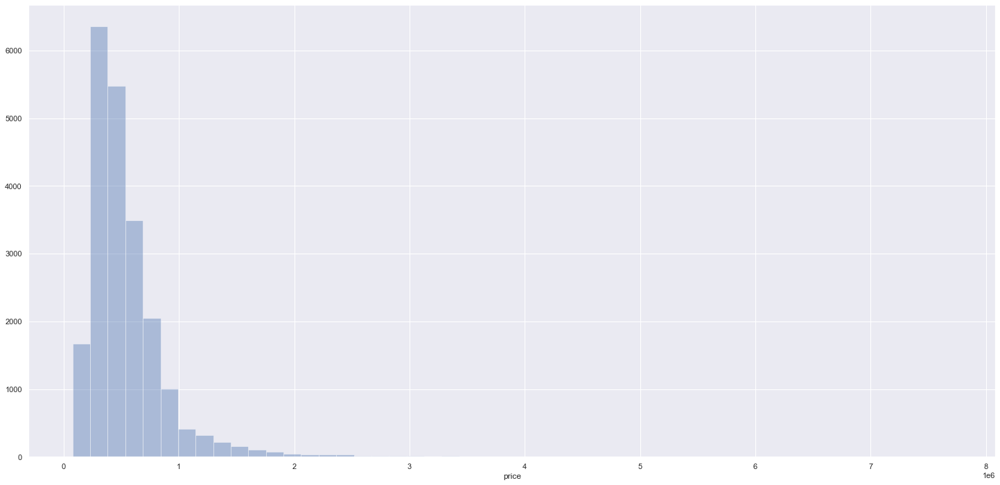

In [615]:
sns.distplot(df3['price'], kde= False)

<AxesSubplot:xlabel='price'>

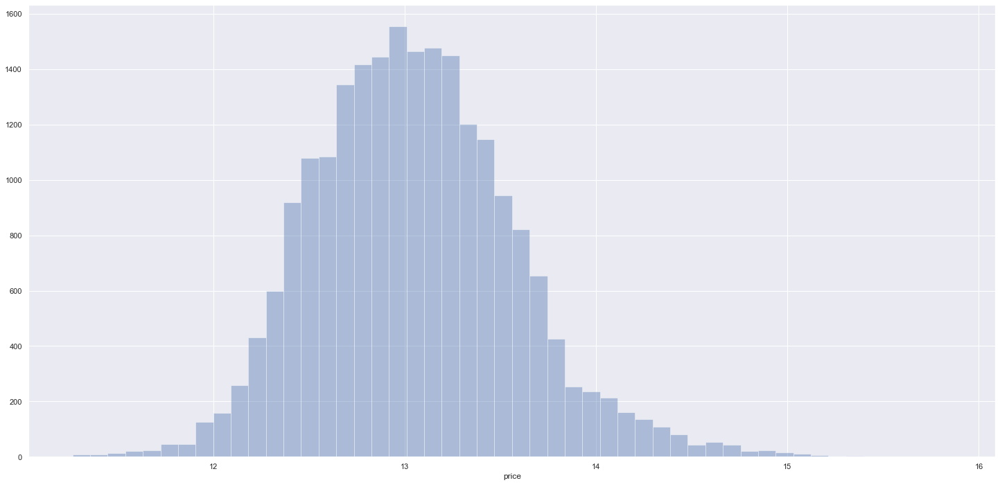

In [441]:
sns.distplot(np.log(df3['price']), kde= False)

### 3.1.2 Numerical Variable

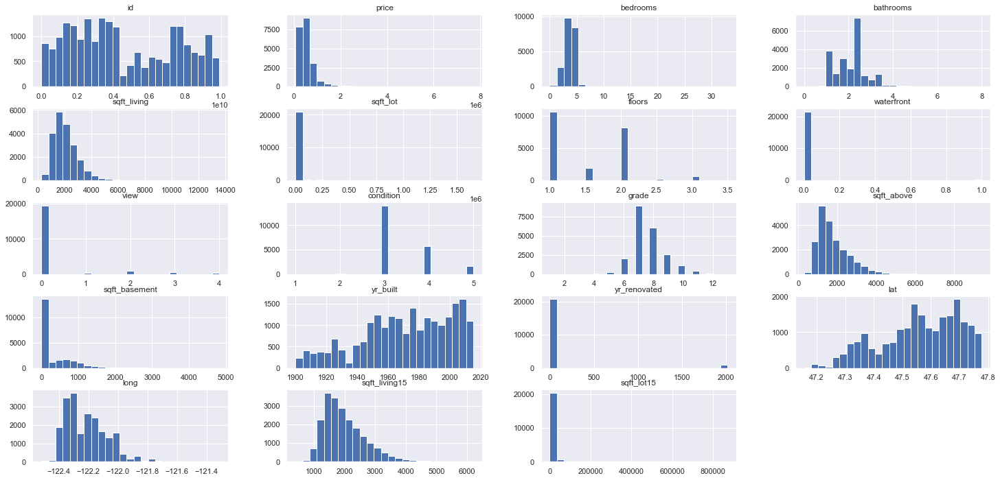

In [60]:
num_attributes.hist( bins=25);

### 3.1.3 Categorical Variable

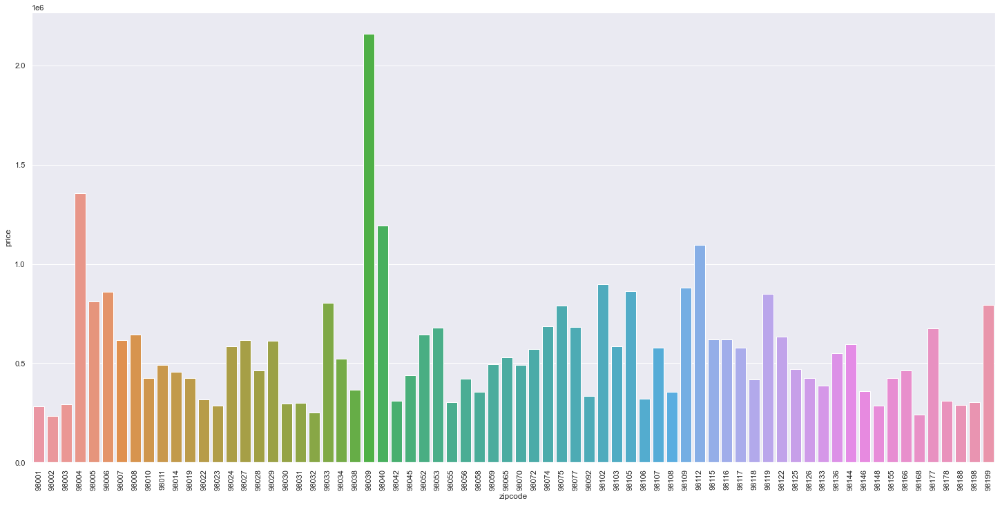

In [466]:
Zip_group = df3[['zipcode', 'price']].groupby('zipcode').mean().reset_index()
sns.barplot(x = Zip_group['zipcode'], y=Zip_group['price'])
plt.xticks(rotation=90);

## 3.2. Analise Bivariada

### H1. Imóveis com vista para o mar são mais caros
***VERDADEIRA*** Imóveis com vista para o mar são mais caros.

<AxesSubplot:xlabel='waterfront', ylabel='price'>

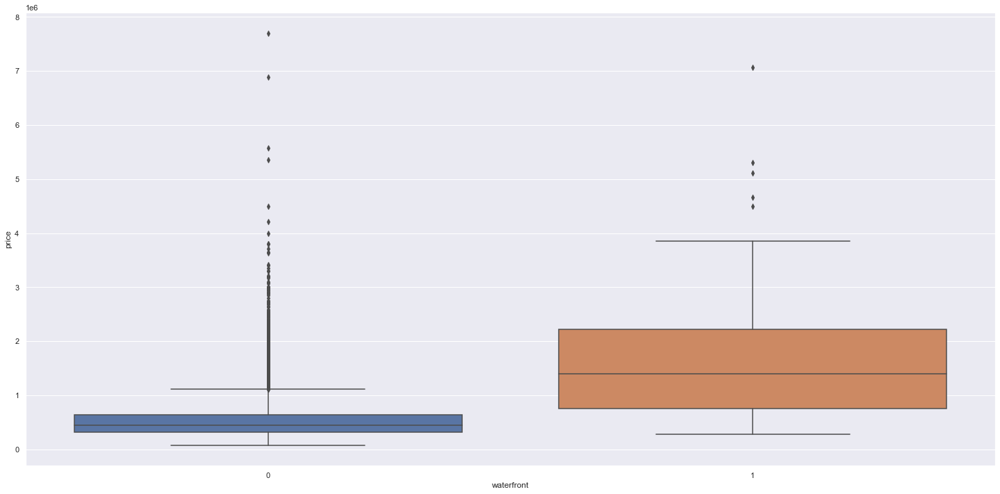

In [467]:
sns.boxplot(x="waterfront", y="price", data=df3)

In [468]:
data_mapa = df3[['id', 'lat', 'long', 'price', 'waterfront']]

In [469]:
mapa = px.scatter_mapbox( data_mapa, 
                         lat= 'lat', 
                         lon = 'long',
                         color='waterfront',
                         size='price',
                          hover_name='id',
                          hover_data=['price'],
                          color_discrete_sequence=['fuchsia'],
                          zoom = 10,
                          height=300 )

In [470]:
mapa.update_layout( mapbox_style = 'open-street-map')
mapa.update_layout( height=600, margin={'r':0, 't':0, 'l':0, 'b':0})
mapa.show()

In [ ]:
mapa.write_html( 'data/mapa_nouse_rocket.html')

In [471]:
aux = df3.copy()

Q1 = np.percentile(aux['price'], 25)  # Q1


Q2 = np.percentile(aux['price'], 50)  # median


Q3 = np.percentile(aux['price'], 75)  # Q3

print('Quartil 1 - 25%:{}\n'.format(Q1))
print('Quartil 2 - 50%:{}\n'.format(Q2))
print('Quartil 3 - 75%:{}\n'.format(Q3))


Quartil 1 - 25%:322000.0

Quartil 2 - 50%:450000.0

Quartil 3 - 75%:645000.0



In [472]:
aux['level'] = aux.apply(lambda x: '4' if x['price']>=Q3 else( '3' if x['price'] >=Q2 else( '2' if x['price'] >=Q1 else '1' )), axis=1)

In [473]:
data_mapa = aux[['id', 'lat', 'long', 'price', 'level']]

In [474]:
mapa = px.scatter_mapbox( data_mapa, 
                         lat= 'lat', 
                         lon = 'long',
                         size='price',
                         color='level',
                          hover_name='id',
                          hover_data=['price'],
                          color_continuous_scale=px.colors.cyclical.IceFire,
                          zoom = 3,
                          height=300 )

In [475]:
mapa.update_layout( mapbox_style = 'open-street-map')
mapa.update_layout( height=600, margin={'r':0, 't':0, 'l':0, 'b':0})
mapa.show()

### H2. Imóveis com o ano de construção apartir de 2000 apresetam notas de condições 4 e 5
***FALSO*** Imóveis com o ano de construção apartir de 2000 apresetam notas de condições 3.

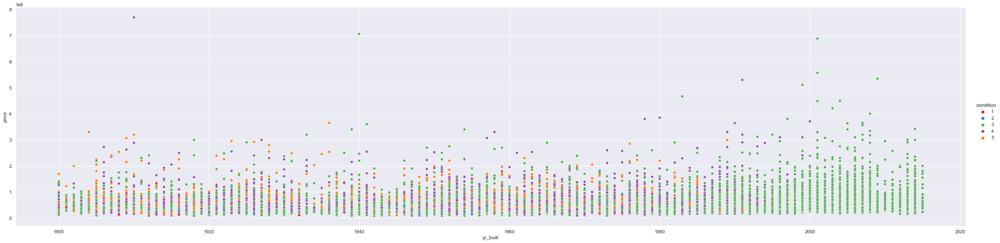

In [476]:
sns.relplot(x='yr_built', y='price', hue='condition',height=8, aspect=4, palette='Set1' ,data=df3)

### H3. Imóveis construidos antes de 1970 tem o metro quadrado do terreno maior
***FALSO*** Imóveis construidos antes de 1970 tem o metro quadrado do terreno menor

<AxesSubplot:xlabel='yr_built_binned', ylabel='sqft_lot'>

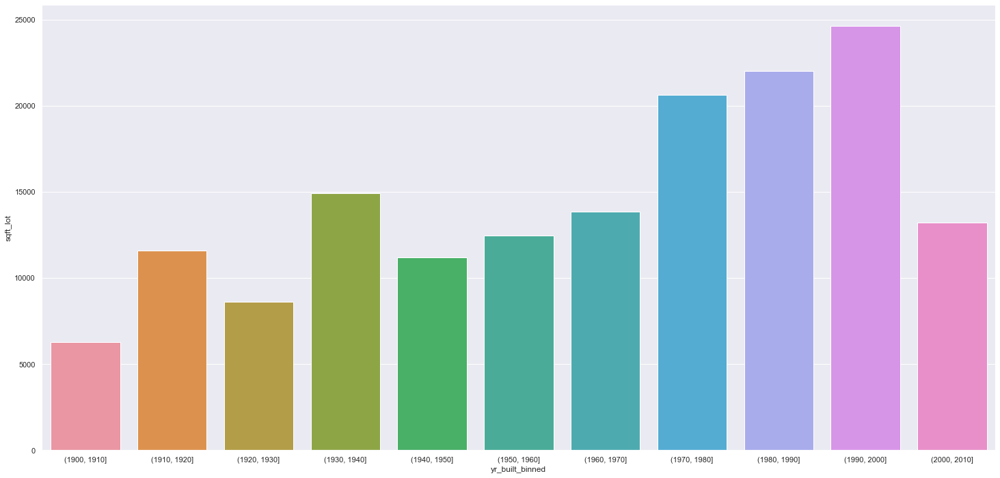

In [477]:
aux1 = df3.copy()
bins = list( np.arange(1900, 2011, 10) )
aux1['yr_built_binned'] = pd.cut( aux1['yr_built'], bins=bins )

aux2 = aux1[['yr_built_binned', 'sqft_lot']].groupby( 'yr_built_binned').mean().reset_index()

sns.barplot( x= 'yr_built_binned', y='sqft_lot', data=aux2)

### H4. Imóveis construidos antes de 1970 tem salas maiores
***Verdadeiro*** Imóveis construidos antes de 1970 tem salas maiores

<AxesSubplot:xlabel='yr_built_binned', ylabel='sqft_living'>

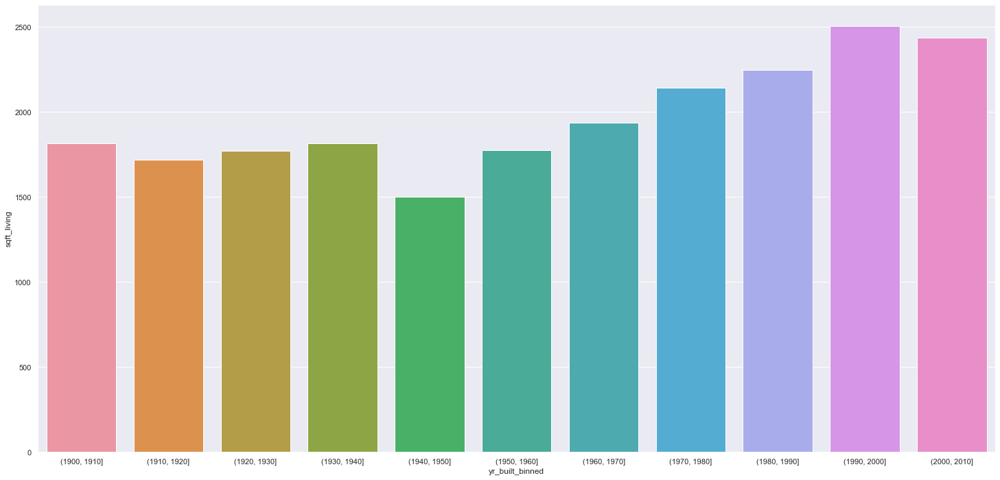

In [478]:
aux1 = df3.copy()
bins = list( np.arange(1900, 2011, 10) )
aux1['yr_built_binned'] = pd.cut( aux1['yr_built'], bins=bins )

aux2 = aux1[['yr_built_binned', 'sqft_living']].groupby( 'yr_built_binned').mean().reset_index()

sns.barplot( x= 'yr_built_binned', y='sqft_living', data=aux2)

### H5. O numero Quartos é diretamente proporcional ao numero de banheiros
***Verdadeiro*** O numero Quartos é diretamente proporcional ao numero de banheiros

<AxesSubplot:>

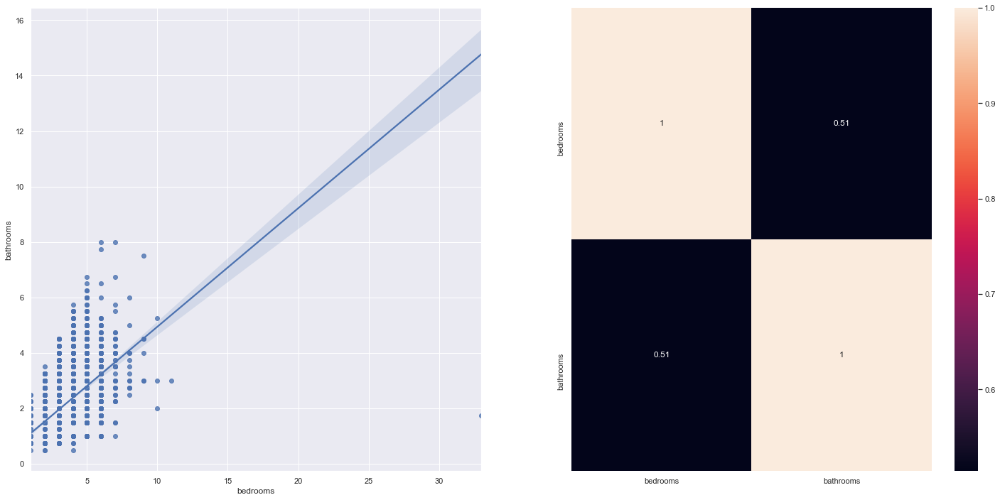

In [479]:
plt.subplot(1, 2, 1)
sns.regplot(x="bedrooms", y="bathrooms", data=df3)

plt.subplot(1, 2, 2)
sns.heatmap( df3[['bedrooms','bathrooms']].corr( method = 'pearson'), annot= True)

### H6.Imóveis que fora anunciados em 2014 são mais baratos que anunciados em 2015.
***Falso*** A média de preços é muito similar 

<AxesSubplot:xlabel='year', ylabel='price'>

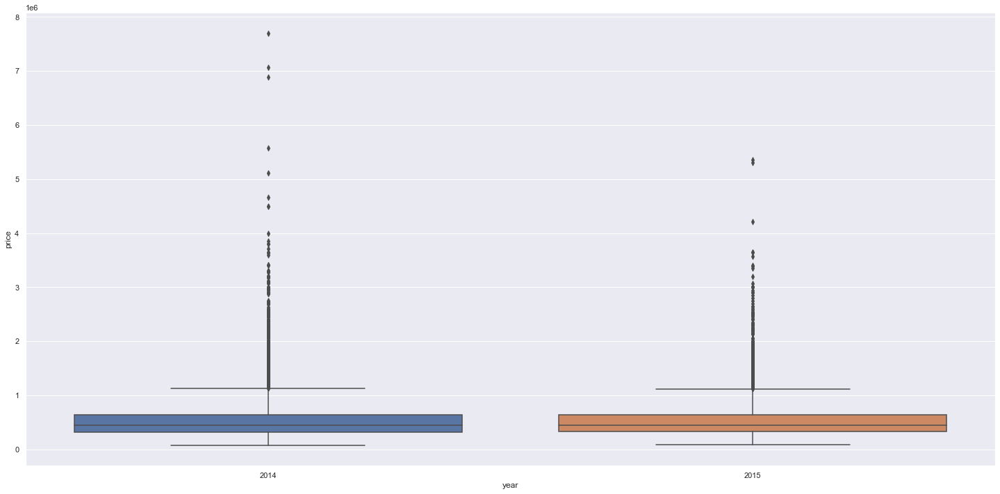

In [480]:
sns.boxplot(x="year", y="price", data=df3)

### H7. Existe uma sazonalidade de vendas mensal.
***Verdadeiro*** Existe uma sazonalidade de vendas mensal

In [481]:
aux = df3[['id', 'year_month']].groupby( 'year_month' ).count().reset_index()
aux.head(100)

,year_month,id
0,2014-05,1766
1,2014-06,2178
2,2014-07,2211
3,2014-08,1939
4,2014-09,1771
5,2014-10,1875
6,2014-11,1409
7,2014-12,1470
8,2015-01,978
9,2015-02,1247


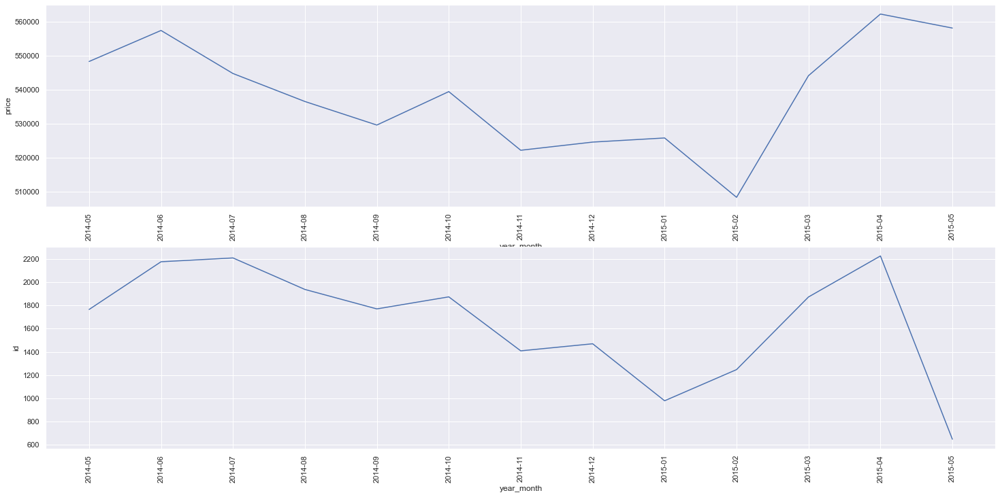

In [482]:
plt.subplot(2, 1, 1)

aux1 = df3[['year_month', 'price']].groupby( 'year_month' ).mean().reset_index()
sns.lineplot(x="year_month", y="price", data=aux1)
plt.xticks(rotation=90);

plt.subplot(2, 1, 2)

aux2 = df3[['id', 'year_month']].groupby( 'year_month' ).count().reset_index()
sns.lineplot(x="year_month", y="id", data=aux2)
plt.xticks(rotation=90);

### H8. Existe uma sazonalidade de vendas na semana do ano.
***Verdadeiro*** Existe uma sazonalidade de vendas na semana do ano

In [483]:
aux = df3[['id', 'year_week']].groupby( 'year_week' ).count().reset_index()
aux.head(100)

,year_week,id
0,2014-17,76
1,2014-18,429
2,2014-19,410
3,2014-20,483
4,2014-21,375
5,2014-22,456
6,2014-23,466
7,2014-24,537
8,2014-25,635
9,2014-26,367


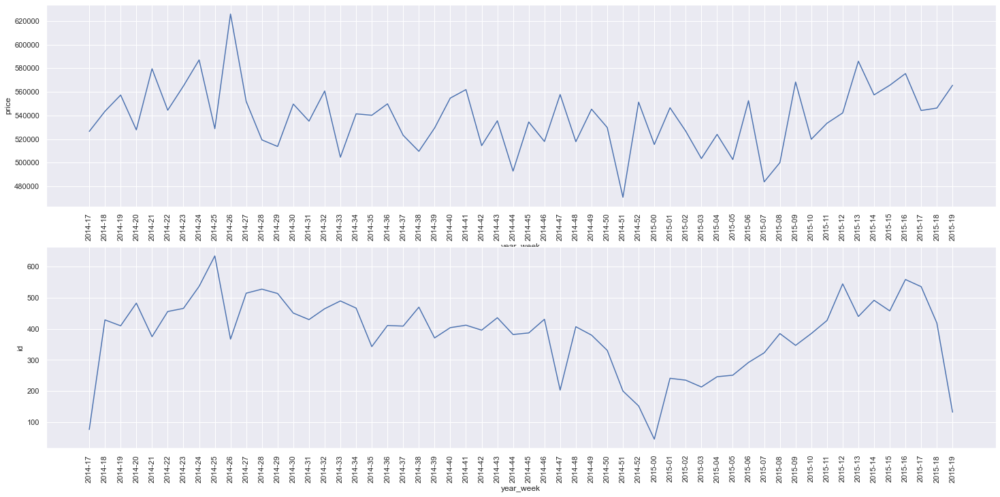

In [484]:
plt.subplot(2, 1, 1)
aux1 = df3[(df3['year_week']!='2015-20') & (df3['year_week']!='2015-21')]
aux1 = aux1[['year_week', 'price']].groupby( 'year_week' ).mean().reset_index()
sns.lineplot(x="year_week", y="price", data=aux1)
plt.xticks(rotation=90);

plt.subplot(2, 1, 2)
aux2 = df3[(df3['year_week']!='2015-20') & (df3['year_week']!='2015-21')]
aux2 = aux2[['id', 'year_week']].groupby( 'year_week' ).count().reset_index()
sns.lineplot(x="year_week", y="id", data=aux2)
plt.xticks(rotation=90);

### H9. Existe Imóveis que foram anunciados mais de uma vez em datas diferentes a preços diferentes.
***Verdadeiro*** Existe Imóveis que foram anunciados mais de uma vez em datas diferentes a preços diferentes.

In [485]:
aux = df3[df3['id'].duplicated()]

df_dup = pd.merge( df3, aux, how='left', on='id')

df_dup.dropna(axis = 0, inplace=True)

df_dup['equal'] = df_dup.apply(lambda x: 0 if x['price_x']== x['price_y'] else 1, axis=1)

df_dup = df_dup[df_dup['equal'] != 0]

df_dup=df_dup[['id', 'date_x', 'price_x', 'year_month_x', 'date_y', 'price_y', 'year_month_y']]

df_dup['diff_days']=df_dup['date_y']-df_dup['date_x']
df_dup['diff_price']=df_dup['price_y']-df_dup['price_x']

In [410]:
df_dup.head(20)

,id,date_x,price_x,year_month_x,date_y,price_y,year_month_y,diff_days,diff_price
88,6021501535,2014-07-25,430000.0,2014-07,2014-12-23,700000.0,2014-12,151 days,270000.0
308,4139480200,2014-06-18,1384000.0,2014-06,2014-12-09,1400000.0,2014-12,174 days,16000.0
319,7520000520,2014-09-05,232000.0,2014-09,2015-03-11,240500.0,2015-03,187 days,8500.0
340,3969300030,2014-07-23,165000.0,2014-07,2014-12-29,239900.0,2014-12,159 days,74900.0
366,2231500030,2014-10-01,315000.0,2014-10,2015-03-24,530000.0,2015-03,174 days,215000.0
712,8820903380,2014-07-28,452000.0,2014-07,2015-01-02,730000.0,2015-01,158 days,278000.0
818,726049190,2014-10-02,287500.0,2014-10,2015-02-18,431000.0,2015-02,139 days,143500.0
831,8682262400,2014-07-18,430000.0,2014-07,2015-05-13,419950.0,2015-05,299 days,-10050.0
1079,9834200885,2014-07-17,360000.0,2014-07,2015-04-20,550000.0,2015-04,277 days,190000.0
1122,8062900070,2014-09-09,272000.0,2014-09,2015-02-13,369000.0,2015-02,157 days,97000.0


In [387]:
print('Media da variação de preço:{}\n'.format(round(df_dup['diff_price'].mean())))
print('Media da variação de dias:{}\n'.format(df_dup['diff_days'].mean()))

Media da variação de preço:136544

Media da variação de dias:182 days 00:40:54.545454546



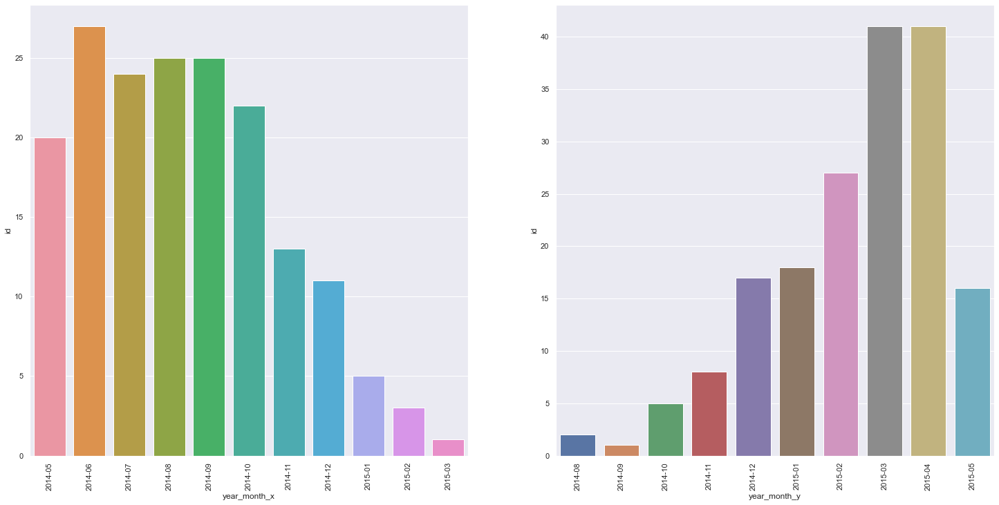

In [486]:
plt.subplot(1, 2, 1)

aux = df_dup[['id', 'year_month_x']].groupby('year_month_x').count().reset_index()
sns.barplot(x="year_month_x", y="id", data=aux)
plt.xticks(rotation=90);

plt.subplot(1, 2, 2)

aux2 = df_dup[['id', 'year_month_y']].groupby('year_month_y').count().reset_index()
sns.barplot(x="year_month_y", y="id", data=aux2)
plt.xticks(rotation=90);

### H10. Imóveis variam de preço de acordo com o código postal.
***Falso*** Existe Imóveis que foram anunciados mais de uma vez em datas diferentes a preços diferentes.

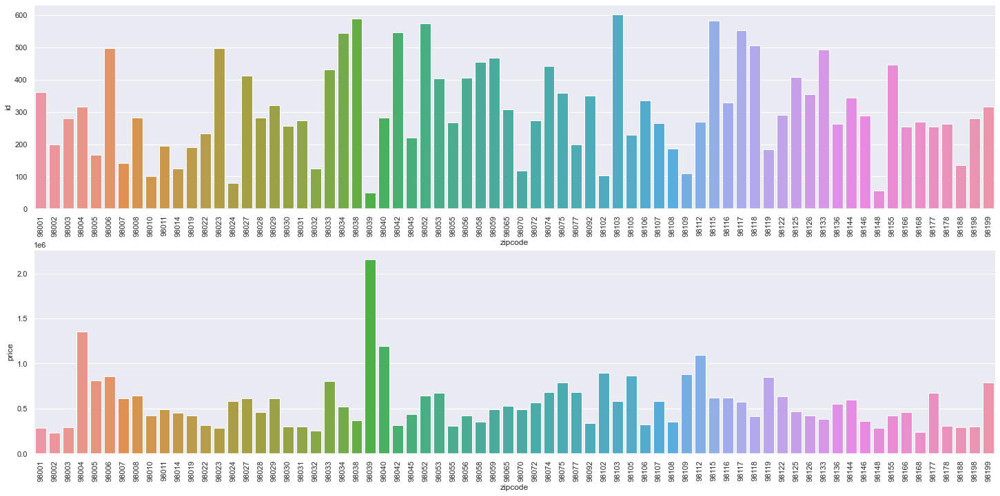

In [487]:
plt.subplot(2, 1, 1)

Zip_group = df3[['id', 'zipcode']].groupby('zipcode').count().reset_index()
sns.barplot(x = Zip_group['zipcode'], y=Zip_group['id'])
plt.xticks(rotation=90);

plt.subplot(2, 1, 2)
Zip_group = df3[['zipcode', 'price']].groupby('zipcode').mean().reset_index()
sns.barplot(x = Zip_group['zipcode'], y=Zip_group['price'])
plt.xticks(rotation=90);

### H11. Imóveis com melhor vista são mais caros.
***Verdadeiro*** Imóveis com melhor vista são mais caros.

<AxesSubplot:xlabel='view', ylabel='price'>

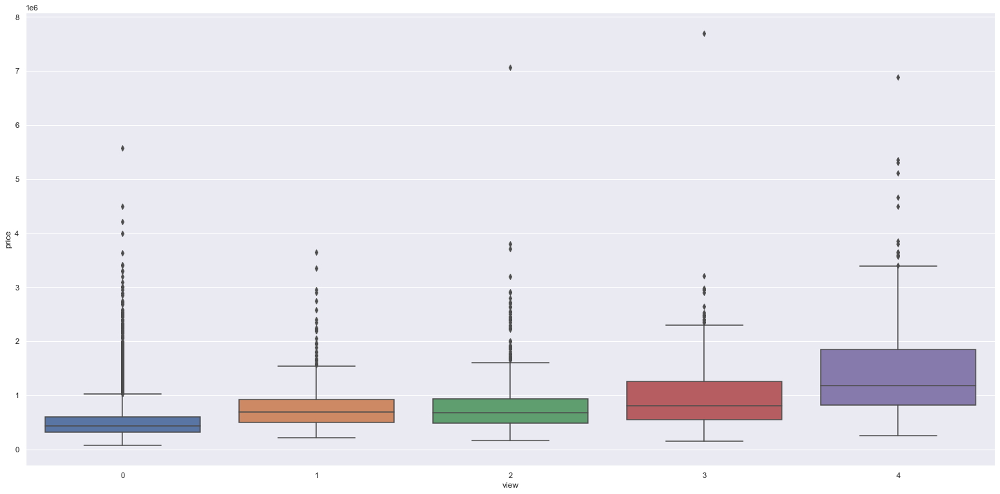

In [488]:
sns.boxplot(x='view', y='price', data=df3)

### H12. 10% dos imóveis foram reformados.
***Falso*** 4% dos imóveis foram reformados.

In [489]:
df3.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15', 'year', 'month', 'day',
       'week_of_year', 'year_week', 'year_month', 'renovated'],
      dtype='object')

In [490]:
df3['renovated'].value_counts(normalize=True)

0    0.95767
1    0.04233
Name: renovated, dtype: float64

### H13. Quanto maior a nota grade maior é o preço do imóvel.
***Verdadeiro*** Quanto maior a nota grade maior é o preço do imóvel.

<AxesSubplot:xlabel='grade', ylabel='price'>

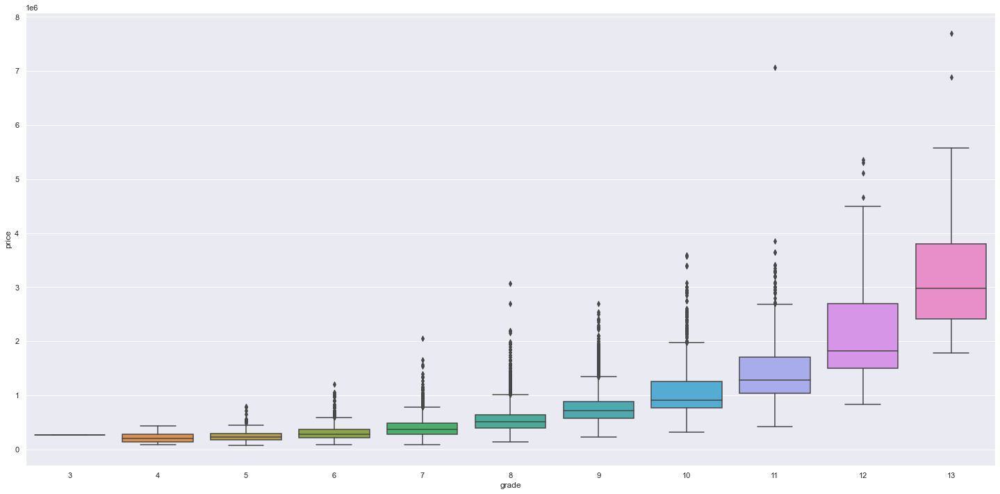

In [491]:
sns.boxplot(x='grade', y='price', data=df3)

## 3.3. Analise Multivariada

<AxesSubplot:>

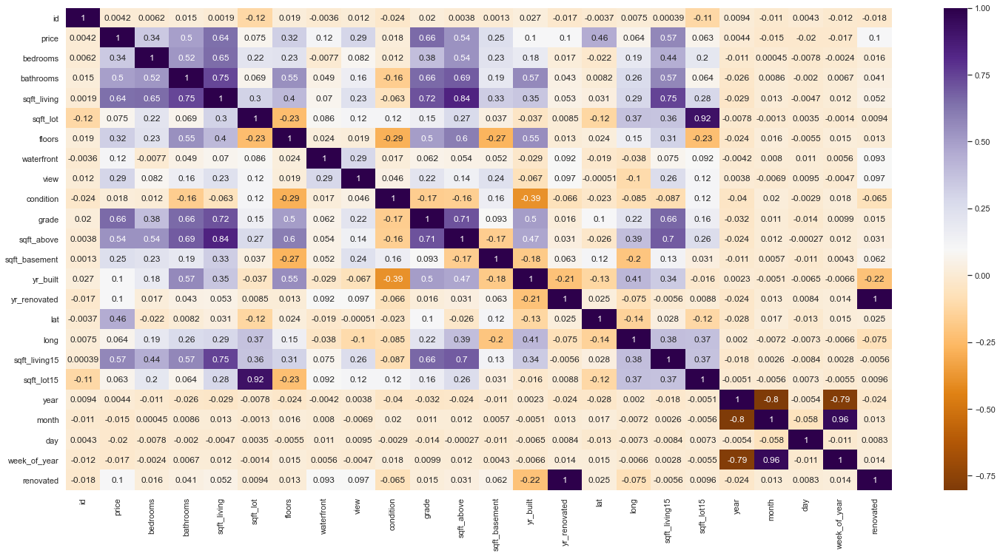

In [456]:
aux = df3.copy()

aux = aux.drop( ['zipcode'], axis=1 )
sns.heatmap(aux.corr('spearman'),cmap='PuOr', annot=True)

In [ ]:
# Variaveis com auta correlação com o preço. 

#1 sqft_living

#2 sqft_above

#3  grade

#4  bathrooms.

#5  sqft_living_15



In [ ]:
# Variaveis auto correlacionadas. 

#1 sqft_lot / sqft_living_15

#2 sqft_above / sqft_living

#3 sqft_living_15 / sqft_living

#4  grade / sqft_above

#5  sqft_living_15/ floors



# 4.0. Preparação dos Dados

In [26]:
df4 = df3.copy()

## 4.1. Normalização

## 4.2. Rescaling

In [27]:
#df4['sqft_basement'] = np.log1p(df3['sqft_basement'])

#df4['sqft_living'] = np.log(df3['sqft_living'])

#df4['sqft_living15'] = np.log(df3['sqft_living15'])

#df4['sqft_above'] = np.log(df3['sqft_above'])

#df4['sqft_lot15'] = np.log(df3['sqft_lot15'])

#df4['sqft_lot'] =  np.log(df3['sqft_lot'])



rs = RobustScaler()
mms = MinMaxScaler()


df4['bathrooms'] = rs.fit_transform( df4[['bathrooms']].values)
df4['bedrooms'] = rs.fit_transform( df4[['bedrooms']].values)
df4['sqft_living'] = rs.fit_transform( df4[['sqft_living']].values)
df4['sqft_lot'] = rs.fit_transform( df4[['sqft_lot']].values)
df4['floors'] = rs.fit_transform( df4[['floors']].values)
df4['view'] = rs.fit_transform( df4[['view']].values)                                 
df4['condition'] = rs.fit_transform( df4[['condition']].values)
df4['grade'] = rs.fit_transform( df4[['grade']].values)  
df4['lat'] = rs.fit_transform( df4[['lat']].values)
df4['long'] = rs.fit_transform( df4[['long']].values)
df4['sqft_lot15'] = rs.fit_transform( df4[['sqft_lot15']].values)
df4['sqft_above'] = rs.fit_transform( df4[['sqft_above']].values)
df4['sqft_basement'] = rs.fit_transform( df4[['sqft_basement']].values)

                                     
df4['sqft_living15'] = mms.fit_transform( df4[['sqft_living15']].values)
df4['year'] = mms.fit_transform( df4[['year']].values)                               

In [24]:
df4.columns

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'sqft_living',
       'sqft_lot', 'floors', 'waterfront', 'view', 'condition', 'grade',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated', 'zipcode',
       'lat', 'long', 'sqft_living15', 'sqft_lot15', 'year', 'month', 'day',
       'week_of_year', 'year_week', 'year_month', 'renovated'],
      dtype='object')

## 4.3 Tranformação

### 4.3.1. Enconding

In [28]:
#water front - One hot encoding

df4 = pd.get_dummies( df4, prefix=['waterfront'], columns=['waterfront'])

#renovated- One hot encoding

df4 = pd.get_dummies( df4, prefix=['renovated'], columns=['renovated'])

#zip_code

#fe = df4.groupby('zipcode').size()/len(df4)
#df4.loc[:, 'zipcode_fe'] = df4['zipcode'].map(fe)

#zip_code

#le = LabelEncoder()
#df4['zipcode'] = le.fit_transform( df4['zipcode'] )


In [20]:
df4.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,month,day,week_of_year,year_week,year_month,waterfront_0,waterfront_1,renovated_0,renovated_1
0,7129300520,2014-10-13,221900.0,3.0,1.00,1180,5650,1.0,0,3,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650,2014,10,13,42,2014-41,2014-10,1,0,1,0
1,6414100192,2014-12-09,538000.0,3.0,2.25,2570,7242,2.0,0,3,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639,2014,12,9,50,2014-49,2014-12,1,0,0,1
2,5631500400,2015-02-25,180000.0,2.0,1.00,770,10000,1.0,0,3,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062,2015,2,25,9,2015-08,2015-02,1,0,1,0
3,2487200875,2014-12-09,604000.0,4.0,3.00,1960,5000,1.0,0,5,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000,2014,12,9,50,2014-49,2014-12,1,0,1,0
4,1954400510,2015-02-18,510000.0,3.0,2.00,1680,8080,1.0,0,3,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503,2015,2,18,8,2015-07,2015-02,1,0,1,0


### 4.3.2. Response Variable

In [29]:
df4['price'] = np.log(df4['price'])

### 4.3.3. Nature Transformation

In [30]:
#month
df4['month_sin'] = df4['month'].apply( lambda x: np.sin( x * ( 2. * np.pi/12) ) )
df4['month_cos'] = df4['month'].apply( lambda x: np.cos( x * ( 2. * np.pi/12) ) )


#week of year
df4['week_of_year_sin'] = df4['week_of_year'].apply( lambda x: np.sin( x * ( 2. * np.pi/52) ) )
df4['week_of_year_cos'] = df4['week_of_year'].apply( lambda x: np.cos( x * ( 2. * np.pi/52) ) )



# 5.0 Feature Selection

In [31]:
df5 = df4.copy()

In [32]:
df5.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,year,month,day,week_of_year,year_week,year_month,waterfront_0,waterfront_1,renovated_0,renovated_1,month_sin,month_cos,week_of_year_sin,week_of_year_cos
0,7129300520,2014-10-13,12.309982,0.0,-1.666667,-0.651786,-0.348842,-0.5,0.0,0.0,0.0,-0.372549,0.000000,1955,0,98178,-0.293137,-0.128079,0.161934,-0.395344,0.0,10,13,42,2014-41,2014-10,1,0,1,0,-8.660254e-01,0.5,-0.935016,0.354605
1,6414100192,2014-12-09,13.195614,0.0,0.000000,0.589286,-0.066935,0.5,0.0,0.0,0.0,0.598039,0.714286,1951,1991,98125,0.720880,-0.433498,0.222165,0.003813,0.0,12,9,50,2014-49,2014-12,1,0,0,1,-2.449294e-16,1.0,-0.239316,0.970942
2,5631500400,2015-02-25,12.100712,-1.0,-1.666667,-1.017857,0.421444,-0.5,0.0,0.0,-1.0,-0.774510,0.000000,1933,0,98028,0.802562,-0.009852,0.399415,0.088702,1.0,2,25,9,2015-08,2015-02,1,0,1,0,8.660254e-01,0.5,0.885456,0.464723
3,2487200875,2014-12-09,13.311329,1.0,1.000000,0.044643,-0.463943,-0.5,0.0,2.0,0.0,-0.500000,1.625000,1965,0,98136,-0.246738,-0.798030,0.165376,-0.525788,0.0,12,9,50,2014-49,2014-12,1,0,1,0,-2.449294e-16,1.0,-0.239316,0.970942
4,1954400510,2015-02-18,13.142166,0.0,-0.333333,-0.205357,0.081456,-0.5,0.0,0.0,1.0,0.117647,0.000000,1987,0,98074,0.217255,0.916256,0.241094,-0.023480,1.0,2,18,8,2015-07,2015-02,1,0,1,0,8.660254e-01,0.5,0.822984,0.568065


In [33]:
cols_drop = ['date', 'month', 'day', 'week_of_year', 'year_week', 'year_month', 'yr_renovated', 'zipcode' ]
df5 = df5.drop( cols_drop, axis = 1)

In [106]:
df5.columns

Index(['id', 'price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot',
       'floors', 'view', 'condition', 'grade', 'sqft_above', 'sqft_basement',
       'yr_built', 'lat', 'long', 'sqft_living15', 'sqft_lot15', 'year',
       'waterfront_0', 'waterfront_1', 'renovated_0', 'renovated_1',
       'month_sin', 'month_cos', 'week_of_year_sin', 'week_of_year_cos'],
      dtype='object')

## 5.1 Split dataframe into training and test dataset

In [34]:
x_train, x_test, y_train, y_test = train_test_split(df5.drop('price', axis=1), df5['price'], test_size = 0.2)

In [35]:
X_test = x_test.copy()

In [36]:
cols_drop = ['id']
x_test = x_test.drop( cols_drop, axis = 1)

x_train = x_train.drop( cols_drop, axis = 1)


In [83]:
x_train.head()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,view,condition,grade,sqft_above,sqft_basement,yr_built,lat,long,sqft_living15,sqft_lot15,year,waterfront_0,waterfront_1,renovated_0,renovated_1,month_sin,month_cos,week_of_year_sin,week_of_year_cos
18958,3.0,2.00,2620,10107,1.0,3,3,7,2620,0,1982,47.4096,-122.329,1730,7812,2014,1,0,1,0,-5.000000e-01,8.660254e-01,-0.464723,0.885456
14070,5.0,3.00,2230,4400,2.0,0,3,7,1730,500,1913,47.6404,-122.325,1280,1800,2015,1,0,1,0,8.660254e-01,-5.000000e-01,0.970942,-0.239316
18174,3.0,1.00,1080,4120,1.0,0,3,7,980,100,1919,47.6771,-122.319,1280,3090,2015,1,0,1,0,1.000000e+00,6.123234e-17,0.935016,0.354605
11857,3.0,2.25,1820,8058,1.0,0,3,7,1260,560,1974,47.7241,-122.168,1850,7384,2014,1,0,1,0,5.000000e-01,-8.660254e-01,0.464723,-0.885456
7927,4.0,2.00,2350,9329,2.0,0,3,8,2350,0,1977,47.5830,-122.170,1640,9403,2014,1,0,1,0,-2.449294e-16,1.000000e+00,-0.239316,0.970942


In [84]:
print(x_train.shape)
print(x_test.shape)

(17273, 24)
(4319, 24)


## 5.2 Boruta as Feature Selector

In [37]:
X_train_n = x_train.values
Y_train_n = y_train.ravel()


# define RandomForestRegressor
rf = RandomForestRegressor( n_jobs=-1)

#define Boruta
boruta = BorutaPy( rf, n_estimators='auto', verbose=2, random_state=42 ).fit( X_train_n, Y_train_n)

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	24
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	24
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	24
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	24
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	24
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	24
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	24
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	10
Tentative: 	0
Rejected: 	14


BorutaPy finished running.

Iteration: 	9 / 100
Confirmed: 	10
Tentative: 	0
Rejected: 	14


In [38]:
cols_selected = boruta.support_.tolist()

# best feature
X_train_fs = x_train
cols_selected_boruta = X_train_fs.iloc[:, cols_selected].columns.to_list()

#not selected boruta
cols_not_selected_boruta = list( np.setdiff1d( X_train_fs.columns, cols_selected_boruta ) )

### 5.2.1 Best Feature from Boruta

In [39]:
cols_selected_boruta

['sqft_living',
 'sqft_lot',
 'view',
 'grade',
 'sqft_above',
 'yr_built',
 'lat',
 'long',
 'sqft_living15',
 'sqft_lot15']

In [29]:
cols_selected_boruta

['sqft_living',
 'sqft_lot',
 'view',
 'grade',
 'sqft_above',
 'yr_built',
 'lat',
 'long',
 'sqft_living15',
 'sqft_lot15']

In [31]:
cols_not_selected_boruta

['bathrooms',
 'bedrooms',
 'condition',
 'floors',
 'month_cos',
 'month_sin',
 'renovated_0',
 'renovated_1',
 'sqft_basement',
 'waterfront_0',
 'waterfront_1',
 'week_of_year_cos',
 'week_of_year_sin',
 'year']

## 5.3. Manual Feature Selection

In [40]:
cols_selected_boruta = [
 'sqft_living',
 'sqft_lot',
 'view',
 'grade',
 'sqft_above',
 'yr_built',
 'lat',
 'long',
 'sqft_living15',
 'sqft_lot15' ]

# 6.0. MACHINE LEARNING MODELLING

In [41]:
x_train = x_train[ cols_selected_boruta ]
x_test = x_test[ cols_selected_boruta ]

## 6.1. Linear Regression Model

In [33]:
#aplicando Log na variavel preço para normalizar

#model
lr = LinearRegression().fit( x_train, y_train)

#prediction
yhat_lr = lr.predict( x_test )


lr_result = ml_error( 'Linear Regression', np.exp(y_test) ,  np.exp(yhat_lr) )
lr_result

,Model Name,MAE,MAPE,RMSE
0,Linear Regression,116745.620272,0.209714,202784.761851


### 6.1.2 Linear Regression Model - Cross Validation

In [43]:
lr = LinearRegression().fit( x_train, y_train )

lr_SCORE = cross_validation( x_train, y_train, 5, 'Linear Regression', lr, verbose=True )

Fold number: 1/5
Fold number: 2/5
Fold number: 3/5
Fold number: 4/5
Fold number: 5/5


In [44]:
lr_SCORE

,Model Name,MAE CV,MAPE CV,RMSE CV
0,Linear Regression,118374.42+/-2212.95,0.21+/-0.0,219780.15+/-38353.71


## 6.2 Linear Regression Regularized Model - Lasso

In [47]:
lrr = Lasso(alpha=0.01).fit( x_train, y_train )

#prediction
yhat_lrr = lrr.predict( x_test )

#performance
lrr_result = ml_error( 'Linear Regression - Lasso', np.exp( y_test ), np.expm1( yhat_lrr ) )
lrr_result

,Model Name,MAE,MAPE,RMSE
0,Linear Regression - Lasso,115300.406457,0.208088,220152.98819


### 6.2.1 Lasso - Cross Validation

In [48]:
lrr = Lasso(alpha=0.01).fit( x_train, y_train )

lrr_SCORE = cross_validation( x_train, y_train , 5, 'Lasso', lrr, verbose=False)

Fold number: 1/5
Fold number: 2/5
Fold number: 3/5
Fold number: 4/5
Fold number: 5/5


In [49]:
lrr_SCORE

,Model Name,MAE CV,MAPE CV,RMSE CV
0,Lasso,117824.17+/-2206.48,0.21+/-0.0,219377.01+/-37326.62


## 6.3 Random Forest Regressor

In [38]:
# model
rf = RandomForestRegressor( n_estimators = 1000, n_jobs=-1, random_state=42 ).fit( x_train, y_train )

#prediction
yhat_rf = rf.predict( x_test)

#performance

rf_result = ml_error( 'Random Forest Regressor', np.exp( y_test), np.exp( yhat_rf))
rf_result

,Model Name,MAE,MAPE,RMSE
0,Random Forest Regressor,71647.035384,0.131439,138580.901068


In [52]:
feature_imp = pd.Series(rf.feature_importances_,index=x_train.columns).sort_values(ascending=False)
feature_imp

grade            0.349379
lat              0.293687
sqft_living      0.182071
long             0.053654
sqft_living15    0.027948
yr_built         0.025120
sqft_lot         0.019126
sqft_above       0.018217
sqft_lot15       0.017565
view             0.013234
dtype: float64

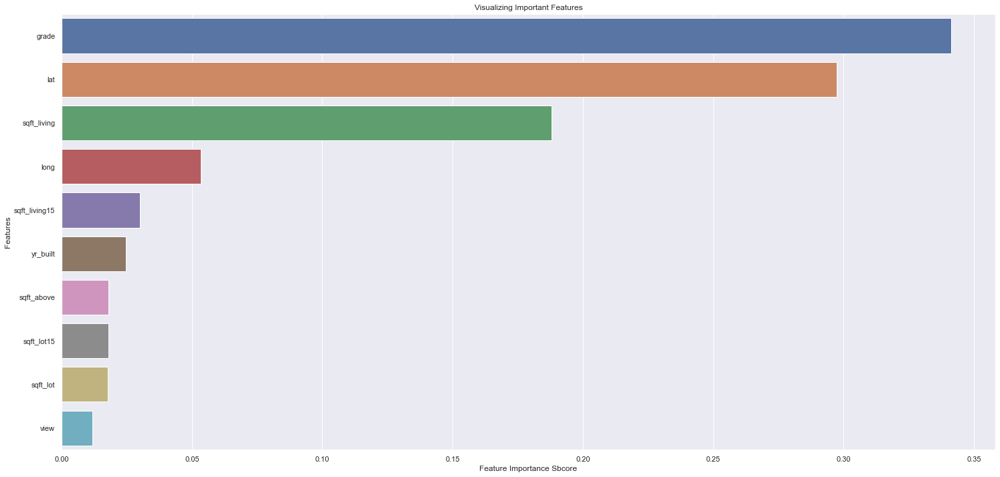

In [40]:
sns.barplot(x=feature_imp, y=feature_imp.index)
plt.xlabel('Feature Importance Sbcore')
plt.ylabel('Features')
plt.title("Visualizing Important Features")
plt.show()

### 6.3.1. Random Forest Regressor - Cross Validation

In [ ]:
rf = RandomForestRegressor( n_estimators = 3000, n_jobs=-1, random_state=42 ).fit( x_train, y_train )
 
rf_SCORE = cross_validation( x_train, y_train, 5, 'Random Forest Regressor', rf, verbose=True)

In [ ]:
rf_SCORE 

In [487]:
rf_SCORE 

,Model Name,MAE CV,MAPE CV,RMSE CV
0,Random Forest Regressor,71919.07+/-1596.78,0.13+/-0.0,136903.45+/-9015.75


## 6.4 XGBoost Regressor

In [520]:
# model
model_xgb = xgb.XGBRegressor( objective= 'reg:squarederror',
                             n_estimators = 1000, 
                             eta=0.01,
                             max_depth = 10,
                             subsample=0.7,
                             colsample_bytree=0.9 ).fit( x_train, y_train )

#prediction
yhat_xgb = model_xgb.predict( x_test )

#performance

xgb_result = ml_error( 'XGBoost Regressor', np.exp( y_test), np.exp( yhat_xgb))
xgb_result


,Model Name,MAE,MAPE,RMSE
0,XGBoost Regressor,68392.414363,0.128481,123596.420168


### 6.4.1. XGBoost Regressor - Cross Validation

In [521]:
model_xgb = xgb.XGBRegressor( objective= 'reg:squarederror',
                             n_estimators = 1000, 
                             eta=0.01,
                             max_depth = 10,
                             subsample=0.7,
                             colsample_bytree=0.9 ).fit( x_train, y_train )

xgb_SCORE = cross_validation( x_train, y_train, 5, 'XGBoost Regressor',model_xgb, verbose=True)

Fold number: 1/5
Fold number: 2/5
Fold number: 3/5
Fold number: 4/5
Fold number: 5/5


In [422]:
xgb_SCORE

,Model Name,MAE CV,MAPE CV,RMSE CV
0,XGBoost Regressor,75558.85+/-1457.88,0.14+/-0.0,139081.67+/-10190.78


## 6.5 Compare Model's Performance

### 6.5.1 Compare Model's Performance

In [527]:
modelling_result = pd.concat([ lr_result, lrr_result, rf_result, xgb_result ])
modelling_result.sort_values ( 'RMSE' )

,Model Name,MAE,MAPE,RMSE
0,XGBoost Regressor,68392.414363,0.128481,123596.420168
0,Random Forest Regressor,72667.727860,0.130455,140587.244420
0,Linear Regression,117656.631404,0.209556,197691.815168
0,Linear Regression - Lasso,120457.811005,0.221082,201120.160341


### 6.5.2 Real Performance - Cross Validation

In [533]:
modelling_result_cv = pd.concat([lr_SCORE, lrr_SCORE, rf_SCORE, xgb_SCORE ])
modelling_result_cv

,Model Name,MAE CV,MAPE CV,RMSE CV
0,Linear Regression,117654.91+/-3352.67,0.21+/-0.0,223456.58+/-41015.06
0,Lasso,120523.3+/-2906.6,0.22+/-0.01,222219.26+/-34224.2
0,Random Forest Regressor,71655.38+/-1175.54,0.13+/-0.0,139091.07+/-12870.39
0,XGBoost Regressor,69072.75+/-1424.68,0.13+/-0.0,132814.49+/-16092.13


# 7.0. HYPERPARAMETER FINE TUNING

## 7.1. Random Seach XGB

In [87]:
import random

In [88]:
param = {
        'n_estimators': [1500, 1700, 2500, 3000, 3500],
        'eta': [0.01, 0.03],
        'max_depth': [3, 5, 9],
        'subsample': [0.1, 0.5, 0.7],
        'colsample_bytree': [0.3, 0.7, 0.9],
        'min_child_weight': [3, 8, 15]
            }
MAX_EVAL = 10    

In [551]:
final_result = pd.DataFrame()

for i in range( MAX_EVAL ):
    #choose values for parameters randonly
    hp = { k: random.sample( v, 1)[0] for k, v in param.items() }
    print( hp )
    # model
    model_xgb = xgb.XGBRegressor( objective= 'reg:squarederror',
                                 n_estimators = hp['n_estimators'],
                                 eta=hp['eta'],
                                 max_depth = hp['max_depth'],
                                 subsample= hp['subsample'],
                                 colsample_bytree=hp['colsample_bytree'],
                                 min_child_weight=hp['min_child_weight'] )


    #performance

    result = cross_validation( x_train, y_train, 5, 'XGBoost Regressor', model_xgb, verbose= False)
    final_result = pd.concat( [final_result, result])

final_result

{'n_estimators': 3500, 'eta': 0.01, 'max_depth': 3, 'subsample': 0.1, 'colsample_bytree': 0.9, 'min_child_weight': 15}
Fold number: 1/5
Fold number: 2/5
Fold number: 3/5
Fold number: 4/5
Fold number: 5/5
{'n_estimators': 1700, 'eta': 0.03, 'max_depth': 9, 'subsample': 0.7, 'colsample_bytree': 0.7, 'min_child_weight': 3}
Fold number: 1/5
Fold number: 2/5
Fold number: 3/5
Fold number: 4/5
Fold number: 5/5
{'n_estimators': 3000, 'eta': 0.03, 'max_depth': 5, 'subsample': 0.1, 'colsample_bytree': 0.9, 'min_child_weight': 3}
Fold number: 1/5
Fold number: 2/5
Fold number: 3/5
Fold number: 4/5
Fold number: 5/5
{'n_estimators': 3000, 'eta': 0.03, 'max_depth': 9, 'subsample': 0.1, 'colsample_bytree': 0.9, 'min_child_weight': 15}
Fold number: 1/5
Fold number: 2/5
Fold number: 3/5
Fold number: 4/5
Fold number: 5/5
{'n_estimators': 1700, 'eta': 0.03, 'max_depth': 5, 'subsample': 0.7, 'colsample_bytree': 0.7, 'min_child_weight': 15}
Fold number: 1/5
Fold number: 2/5
Fold number: 3/5
Fold number: 4/5

,Model Name,MAE CV,MAPE CV,RMSE CV
0,XGBoost Regressor,74640.39+/-1146.86,0.14+/-0.0,137960.42+/-12180.69
0,XGBoost Regressor,69292.67+/-1235.59,0.13+/-0.0,127283.24+/-10918.71
0,XGBoost Regressor,81298.54+/-1255.82,0.15+/-0.0,152705.28+/-13486.39
0,XGBoost Regressor,83753.75+/-1095.87,0.16+/-0.0,149299.45+/-12945.65
0,XGBoost Regressor,69648.27+/-715.58,0.13+/-0.0,130867.74+/-10033.86
0,XGBoost Regressor,69961.43+/-629.39,0.13+/-0.0,132004.59+/-10084.96
0,XGBoost Regressor,73909.4+/-1497.98,0.14+/-0.0,135856.87+/-13399.92
0,XGBoost Regressor,69992.05+/-1168.22,0.13+/-0.0,131466.18+/-13501.88
0,XGBoost Regressor,77733.34+/-921.28,0.14+/-0.0,146068.27+/-9972.6
0,XGBoost Regressor,70126.04+/-738.92,0.13+/-0.0,133327.46+/-10765.66


## 7.1. Random Seach RF

In [ ]:
param = {'n_estimators': [2500, 3000, 3500],
         'max_depth': [30, 50, 100, 150],
         'min_samples_split': [30, 50, 100, 200],
         'min_samples_leaf': [ 30, 50, 100, 200],
        }
MAX_EVAL = 10 

In [ ]:
final_result = pd.DataFrame()

for i in range( MAX_EVAL ):
    #choose values for parameters randonly
    hp = { k: random.sample( v, 1)[0] for k, v in param.items() }
    print( hp )
    # model
    model_rf = RandomForestRegressor(  n_jobs=-1,
                                 n_estimators = hp['n_estimators'],
                                 max_depth = hp['max_depth'],
                                 )


    #performance

    result = cross_validation( x_train, y_train, 5, 'Random Forest', model_rf, verbose= False)
    final_result = pd.concat( [final_result, result])

final_result

## 7.2 Final Model

In [112]:
param_tuned = {
        'n_estimators': 3500 ,
        'eta': 0.01 ,
        'max_depth': 10 ,
        'subsample': 0.7,
        'colsample_bytree': 0.9 ,
        'min_child_weight': 8
            } 

In [113]:
# model
model_xgb_tuned = xgb.XGBRegressor( objective= 'reg:squarederror',
                                 n_estimators = param_tuned['n_estimators'],
                                 eta=param_tuned['eta'],
                                 max_depth = param_tuned['max_depth'],
                                 subsample= param_tuned['subsample'],
                                 colsample_bytree=param_tuned['colsample_bytree'],
                                 min_child_weight=param_tuned['min_child_weight'] ).fit(x_train, y_train)

#prediction
    
yhat_xgb_tuned = model_xgb_tuned.predict( x_test )

#performance

xgb_result_tuned = ml_error( 'XGBoost Regressor', np.exp( y_test ), np.exp( yhat_xgb_tuned ) )
xgb_result_tuned

,Model Name,MAE,MAPE,RMSE
0,XGBoost Regressor,67660.516826,0.127851,124641.830718


# 8.0. TRADUCAO E INTERPRETACAO DO ERRO

## 8.1. Machine Learning Performance 

In [338]:
df8 = X_test

In [340]:
df8['price'] = np.exp( y_test)
df8['predictions'] = np.exp( yhat_xgb_tuned )
df8['predictions'] = round(df8['predictions'])

df8['worst_scenario'] = df8['predictions'] - 67660
df8['best_scenario'] =  df8['predictions'] + 67660

df8['%_error'] = ( df8['price'] - df8['predictions']) / (df8['price'])
df8['error'] = (df8['price'] - df8['predictions']) 

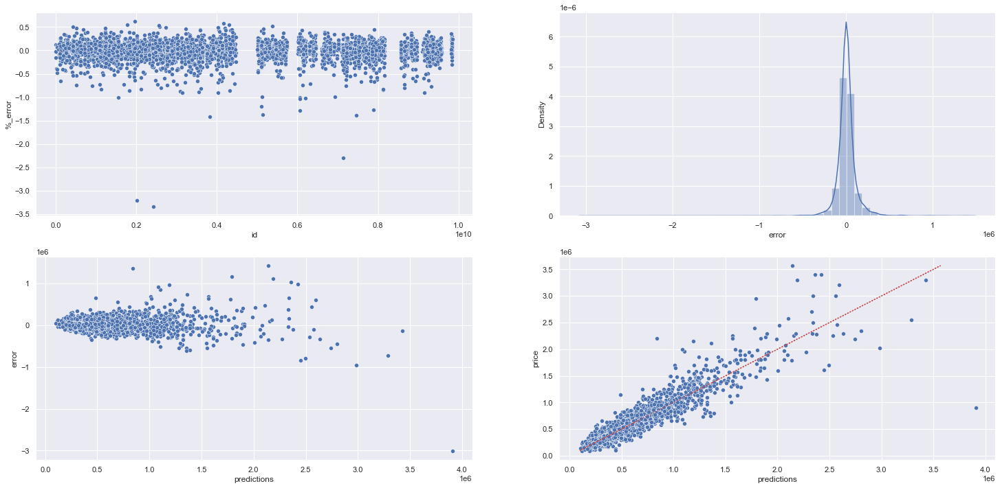

In [118]:
plt.subplot( 2, 2, 1)

sns.scatterplot(x='id', y='%_error', data = df8)

plt.subplot( 2, 2, 2)

sns.distplot( df8['error'] )

plt.subplot(2, 2, 3)
sns.scatterplot( df8['predictions'], df8['error'] )

plt.subplot(2, 2, 4)
sns.scatterplot( df8['predictions'], df8['price'] )
plt.plot(df8['price'], df8['price'], ':r')


## 8.2. Business Performance

In [511]:
aux = df8[['id', 'price', 'predictions','worst_scenario', 'best_scenario', 'error', '%_error' ]]

In [512]:
aux = aux[aux['%_error']<= -0.10]
aux = pd.merge( aux, df3, how='left', on='id')

In [513]:
Q3 = np.percentile(aux['grade'], 75) 
aux['grade_top_25%'] = aux.apply(lambda x: 'sim' if x['grade']>=Q3 else 'não', axis=1)

Q3 = np.percentile(aux['sqft_living'], 75) 
aux['sqft_living_top_25%'] = aux.apply(lambda x: 'sim' if x['sqft_living']>=Q3 else 'não', axis=1)

In [515]:
aux = aux[['id', 'price_x', 'predictions','worst_scenario', 'best_scenario', 'error', '%_error', 'grade', 'grade_top_25%', 'sqft_living', 'sqft_living_top_25%', 'zipcode', 'lat', 'long']]

In [516]:
aux_zipcode = df3[['zipcode', 'price']].groupby('zipcode').mean().reset_index()
aux_zipcode['zipcode_mean_price'] = round(aux_zipcode['price'])

In [517]:
aux = pd.merge( aux, aux_zipcode, how='left', on='zipcode')
aux = aux.drop('price', axis = 1)

In [518]:
aux = aux[['id', 'price_x', 'predictions','worst_scenario', 'best_scenario', 'error', '%_error', 'grade', 'grade_top_25%', 'sqft_living', 'sqft_living_top_25%', 'zipcode', 'zipcode_mean_price', 'lat', 'long' ]]

aux = aux[(aux['grade_top_25%']=='sim') & (aux['sqft_living_top_25%']=='sim')].sort_values(by=['zipcode_mean_price'], ascending=False)

In [519]:
aux = aux[(aux['worst_scenario']-aux['price_x']) > 100000]

In [520]:
len(aux)

85

In [521]:
aux.head(700)

,id,price_x,predictions,worst_scenario,best_scenario,error,%_error,grade,grade_top_25%,sqft_living,sqft_living_top_25%,zipcode,zipcode_mean_price,lat,long
198,3861470120,1610000.0,2447655.0,2379995.0,2515315.0,-837655.0,-0.520283,11,sim,4270,sim,98004,1355927.0,47.5951,-122.206
968,9290900160,1430000.0,1894994.0,1827334.0,1962654.0,-464994.0,-0.325171,10,sim,3380,sim,98004,1355927.0,47.6292,-122.225
938,3835500585,1900000.0,2095576.0,2027916.0,2163236.0,-195576.0,-0.102935,9,sim,4280,sim,98004,1355927.0,47.6185,-122.219
263,524059148,1600000.0,2005315.0,1937655.0,2072975.0,-405315.0,-0.253322,11,sim,4280,sim,98004,1355927.0,47.5979,-122.197
298,524059241,870000.0,1061129.0,993469.0,1128789.0,-191129.0,-0.219689,9,sim,2780,sim,98004,1355927.0,47.5950,-122.203
322,5078400160,1800000.0,2064854.0,1997194.0,2132514.0,-264854.0,-0.147141,11,sim,4400,sim,98004,1355927.0,47.6232,-122.207
605,4389201241,1945000.0,2273117.0,2205457.0,2340777.0,-328117.0,-0.168698,11,sim,4690,sim,98004,1355927.0,47.6165,-122.216
237,3317500100,998000.0,1321000.0,1253340.0,1388660.0,-323000.0,-0.323647,10,sim,3760,sim,98040,1194230.0,47.5605,-122.225
286,1924059248,870000.0,1294582.0,1226922.0,1362242.0,-424582.0,-0.488025,9,sim,4500,sim,98040,1194230.0,47.5581,-122.213
110,3622910190,895000.0,1067992.0,1000332.0,1135652.0,-172992.0,-0.193287,9,sim,2876,sim,98040,1194230.0,47.5528,-122.229


In [458]:
scnarios = aux[['price_x','predictions', 'worst_scenario', 'best_scenario']].apply( lambda x: np.sum( x ),axis = 0).reset_index().rename( columns={'index': 'Scenarios', 0:'Values'} )
scnarios['Values'] = scnarios['Values'].map( 'R${:,.2f}'.format )
scnarios

,Scenarios,Values
0,price_x,"R$90,823,490.00"
1,predictions,"R$120,332,392.00"
2,worst_scenario,"R$114,581,291.00"
3,best_scenario,"R$126,083,491.00"


In [524]:
data_mapa = aux[['id', 'lat', 'long', 'price_x']]

mapa = px.scatter_mapbox( data_mapa, 
                         lat= 'lat', 
                         lon = 'long',
                         size='price_x',
                          hover_name='id',
                          hover_data=['price_x'],
                          color_continuous_scale=px.colors.cyclical.IceFire,
                          zoom = 3,
                          height=300 )

mapa.update_layout( mapbox_style = 'open-street-map')
mapa.update_layout( height=600, margin={'r':0, 't':0, 'l':0, 'b':0})
mapa.show()

In [459]:
aux = aux[aux['grade']>=10]

In [461]:
len(aux)

48

In [460]:
scnarios = aux[['price_x','predictions', 'worst_scenario', 'best_scenario']].apply( lambda x: np.sum( x ),axis = 0).reset_index().rename( columns={'index': 'Scenarios', 0:'Values'} )
scnarios['Values'] = scnarios['Values'].map( 'R${:,.2f}'.format )
scnarios

,Scenarios,Values
0,price_x,"R$63,501,750.00"
1,predictions,"R$83,086,624.00"
2,worst_scenario,"R$79,838,950.00"
3,best_scenario,"R$86,334,310.00"


In [ ]:
 # 9.0. Business Per